<a href="https://colab.research.google.com/github/SelimSavas/segment-anything-and-yolov8/blob/main/SAMandYOLOv8video.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# YOLOv8 vs SAM Meta

## Library

In [1]:
!pip install ultralytics
!pip install supervision
!pip install roboflow

import numpy as np
import cv2
import os
import sys
import torch
from roboflow import Roboflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 530.2/530.2 kB 5.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.5/199.5 kB 10.6 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.2/56.2 kB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 6.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 6.9 MB/s eta 0:00:00
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9676 sha256=6061887380cd20e998932d621ec6a7b48a253a49bfca502a86791f6ddc5ed16a
  Stored in directory: /root/.cache/p

In [2]:
HOME = os.getcwd()
print("HOME:", HOME)

HOME: /content


In [3]:
%cd {HOME}

!{sys.executable} -m pip install 'git+https://github.com/facebookresearch/segment-anything.git'

/content
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-7bhpvvvw
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-7bhpvvvw
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 567662b0fd33ca4b022d94d3b8de896628cd32dd
  Preparing metadata (setup.py) ... done
  Created wheel for segment-anything: filename=segment_anything-1.0-py3-none-any.whl size=36610 sha256=4a5a5a8732bc0bc6eb6de81d5f282c6586a9030cb1444d84bf57ff991e520afe
  Stored in directory: /tmp/pip-ephem-wheel-cache-0lis_2gn/wheels/d5/11/03/7aca746a2c0e09f279b10436ced7175926bc38f650b736a648
Successfully built segment-anything


In [198]:
DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
MODEL_TYPE = "vit_l"

## Dataset (Roboflow)

In [5]:
rf = Roboflow(api_key="Pho4XVVaJnNcR3y3HNrK")
project = rf.workspace("team12").project("airplane-bp8fl")
dataset = project.version(2).download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics<=8.0.20 is required but found version=8.0.87, to fix: `pip install ultralytics<=8.0.20`


Extracting Dataset Version Zip to airplane-2 in yolov8:: 100%|██████████| 297/297 [00:00<00:00, 1575.57it/s]


In [193]:
IMAGE_NAME = '/content/airplane-2/test/images/00c315d7e84934bc_jpg.rf.faa540c666a1014811c24c48026bdff7.jpg'
#IMAGE_NAME = '/content/airplane-2/test/images/1c40b2c940c7cef2_jpg.rf.f68f8a03146bfcf8fd05dd917c4d1cbc.jpg'
IMG_SOURCE = cv2.imread(IMAGE_NAME)

In [195]:
%cd {HOME}
!mkdir {HOME}/weights
%cd {HOME}/weights

!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_l_0b3195.pth

/content
mkdir: cannot create directory ‘/content/weights’: File exists
/content/weights


In [196]:
CHECKPOINT_PATH = os.path.join(HOME, "weights", "sam_vit_l_0b3195.pth")
print(CHECKPOINT_PATH, "; exist:", os.path.isfile(CHECKPOINT_PATH))

/content/weights/sam_vit_l_0b3195.pth ; exist: True


## YoloV8 - Creating BBox

In [268]:
from ultralytics import YOLO

yolo_model = YOLO('yolov8x.pt')

In [174]:
img = cv2.cvtColor(IMG_SOURCE, cv2.COLOR_BGR2RGB)
results = yolo_model.predict(source=img)


0: 640x640 10 persons, 1 car, 5 airplanes, 1 boat, 98.4ms
Speed: 1.6ms preprocess, 98.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


In [175]:
boxes_class_name = np.array([])
for r in results:
    for c in r.boxes.cls:
        boxes_class_name = np.append(boxes_class_name,yolo_model.names[int(c)])
boxes_class_name

array(['airplane', 'boat', 'person', 'airplane', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'person', 'airplane', 'airplane', 'car', 'person', 'airplane'], dtype='<U32')

In [184]:
k = 0
result_np_son = np.array([])
result_class = np.array([])
result_score = np.array([])
for result in results:
    result_np = np.array(result.boxes.data.cpu())

for i in result_np:
    result_np_son = np.append(result_np_son,i[:][:-2])
    result_class = np.append(result_class,i[:][-1:])
    result_score = np.append(result_score,i[:][-2:-1])
    k += 1


boxes = result_np_son.reshape((k,4))
boxes_class = result_class.reshape((k,))
boxes_score = result_score.reshape((k,))

In [185]:
boxes_class.shape

(17,)

In [186]:
type(boxes_class)

numpy.ndarray

In [176]:
len(boxes.size())

2

## SAM - Segmentation

In [267]:
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor
import supervision as sv

sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH).to(device=DEVICE)

mask_predictor = SamPredictor(sam)

In [265]:
segmented_image = img.copy()
box_image = img.copy()
boxes_class_value = {'0':sv.Color.white(),'2':sv.Color.blue(),'4':sv.Color.red(),'5':sv.Color.blue() ,'7':sv.Color.black(),'8':sv.Color.green()}
mask_predictor.set_image(img)

boxes = result.boxes.xyxy
print('Shape of boxes array:', boxes.shape)
print('Size of boxes array:', boxes.size)
print(boxes.cpu().numpy())

Shape of boxes array: torch.Size([11, 4])
Size of boxes array: <built-in method size of Tensor object at 0x7f0946097720>
[[     687.26       242.9      977.49      372.03]
 [      711.3      253.58      803.89      289.92]
 [     1128.5      510.69      1202.9      544.59]
 [     616.83      279.75      640.39      290.22]
 [     493.69      277.69      519.96      294.19]
 [     375.61      281.37      399.94      296.21]
 [     80.701      286.68      107.03      302.07]
 [     211.31      281.15      244.84      297.75]
 [     107.66      208.63       142.7      219.56]
 [     545.23      417.19      554.89      443.18]
 [     579.44      550.25      591.98      581.92]]


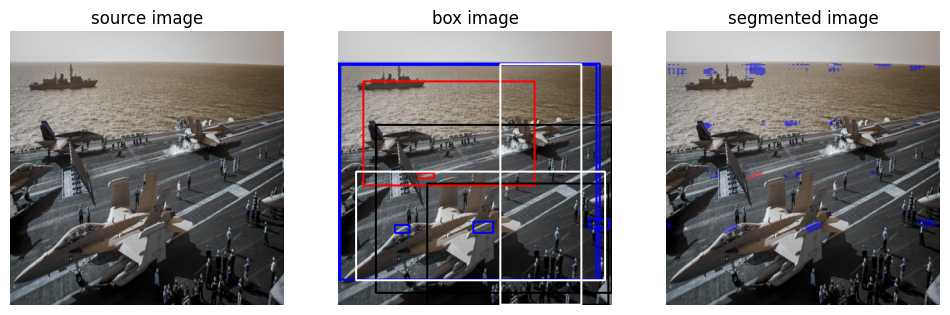

In [266]:
masks, scores, logits = mask_predictor.predict_torch(
    point_coords = None,
    point_labels = None,
    boxes = boxes * 2.5,
    multimask_output=True
)

masks = masks.cpu().numpy()

i = 0
for box in boxes.cpu().numpy():

    box_annotator = sv.BoxAnnotator(color= boxes_class_value[str(int(boxes_class[i]))], text_padding=10)
    mask_annotator = sv.MaskAnnotator(color= boxes_class_value[str(int(boxes_class[i]))])

    detections = sv.Detections(
        xyxy=sv.mask_to_xyxy(masks=masks[i]),
        mask=masks[i]
    )
    
    detections = detections[detections.area == np.max(detections.area)]
    box_image = box_annotator.annotate(scene=box_image, detections=detections, skip_label=True)
    segmented_image = mask_annotator.annotate(scene=segmented_image, detections=detections)
    i += 1
sv.plot_images_grid(
   images=[img,box_image, segmented_image],
   grid_size=(1, 3),
  titles=['source image','box image','segmented image']    
)



In [269]:
from ultralytics import YOLO

yolo_model = YOLO('yolov8x.pt')

In [270]:
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor
import supervision as sv

sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH).to(device=DEVICE)

mask_predictor = SamPredictor(sam)


0: 384x640 1 person, 4 cars, 2 airplanes, 2 trucks, 67.4ms
Speed: 0.8ms preprocess, 67.4ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[823.9368, 256.7917, 916.7207, 292.3580],
        [532.7976, 247.0211, 861.6542, 377.3103],
        [ 10.4428, 288.9133,  36.9669, 305.9656],
        [492.8008, 282.4605, 518.7126, 297.7964],
        [210.7336, 286.5463, 240.2013, 301.8958],
        [ 91.8867, 288.8287, 125.3311, 304.8544],
        [465.3997, 284.3809, 489.0869, 298.4283],
        [128.0074, 327.2731, 200.5883, 357.2324],
        [395.7120, 277.0916, 442.7043, 298.9410],
        [ 80.4428, 215.1311, 112.7177, 229.8210],
        [539.5341, 209.8881, 578.4944, 225.4897]], device='cuda:0')


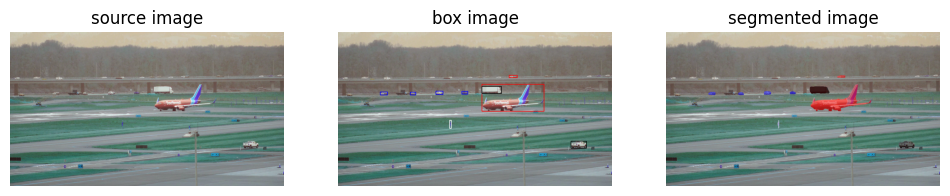


0: 384x640 1 person, 3 cars, 3 airplanes, 3 trucks, 28.8ms
Speed: 0.7ms preprocess, 28.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 674.0685,  242.9385,  966.0328,  371.3577],
        [ 671.9567,  253.2339,  764.6324,  289.1489],
        [1088.1458,  509.7930, 1161.7200,  543.8669],
        [ 520.5562,  413.6526,  530.4871,  451.1280],
        [ 457.6273,  275.6241,  491.5684,  293.3469],
        [ 339.7266,  281.0773,  363.0416,  295.3221],
        [ 577.7991,  279.3080,  605.8083,  289.7572],
        [ 197.7715,  279.6732,  231.7837,  295.1217],
        [ 799.6677,  200.9763,  839.0483,  214.1389]], device='cuda:0')


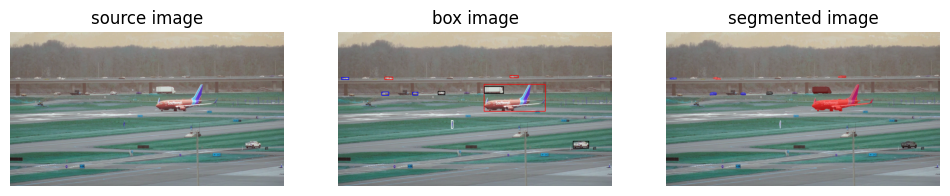


0: 384x640 1 person, 4 cars, 2 airplanes, 3 trucks, 34.4ms
Speed: 0.6ms preprocess, 34.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 679.8752,  242.9431,  971.6537,  372.2083],
        [ 682.5454,  253.7969,  773.8809,  289.6029],
        [1097.9982,  509.5460, 1171.8851,  544.1588],
        [ 803.0046,  202.1591,  841.8618,  214.7284],
        [ 468.4085,  276.4789,  499.1876,  293.5924],
        [ 349.2669,  281.0092,  373.6419,  296.3606],
        [ 528.4847,  414.0875,  538.1290,  450.8788],
        [ 218.7997,  209.5034,  257.4823,  222.4149],
        [ 204.1002,  280.0771,  237.6040,  297.7421],
        [  16.5826,  211.7189,   50.9052,  222.2924]], device='cuda:0')


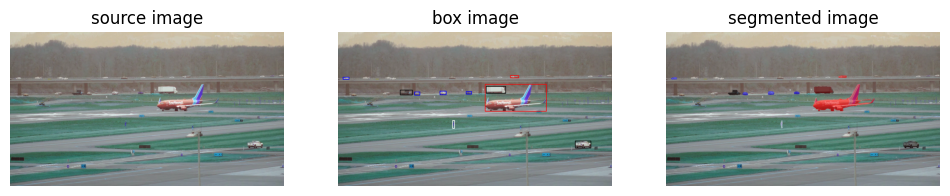


0: 384x640 5 cars, 1 airplane, 2 trucks, 34.3ms
Speed: 0.6ms preprocess, 34.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 684.6306,  242.4344,  976.0597,  371.6302],
        [ 691.7131,  253.4706,  783.7720,  289.4498],
        [1108.0134,  508.8335, 1181.8406,  543.7981],
        [ 289.9232,  270.6087,  348.1103,  295.7674],
        [ 476.3239,  276.5994,  505.5650,  293.0369],
        [ 358.2523,  280.7528,  382.9933,  295.6303],
        [ 598.2164,  279.7250,  623.7184,  289.7270],
        [ 805.6658,  202.3229,  844.4726,  213.9768],
        [ 534.9818,  414.1689,  544.9413,  445.3016],
        [  23.5005,  211.5883,   52.4690,  222.0161]], device='cuda:0')


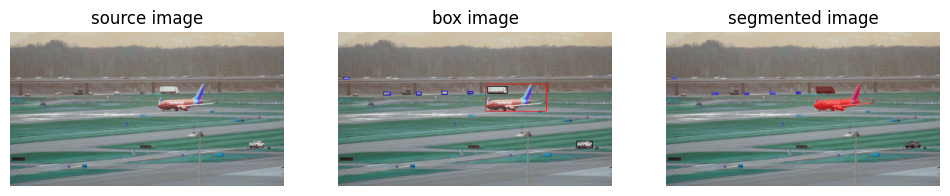


0: 384x640 1 person, 1 car, 1 airplane, 4 trucks, 28.7ms
Speed: 0.5ms preprocess, 28.7ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 687.4243,  241.7416,  977.6863,  371.5421],
        [ 698.7305,  253.2429,  791.1672,  289.1757],
        [1115.1873,  509.2746, 1189.5632,  543.6288],
        [ 483.6595,  276.7979,  511.0153,  292.4564],
        [ 365.6940,  280.5555,  389.2577,  295.1854],
        [ 211.6137,  279.6308,  245.5784,  294.5017],
        [  26.0663,  212.1383,   52.2169,  222.0184],
        [ 604.3208,  278.4049,  630.2288,  289.5370]], device='cuda:0')


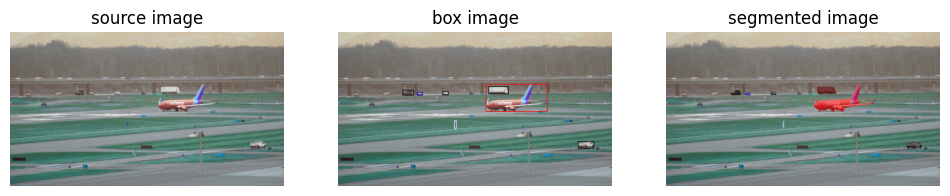


0: 384x640 1 person, 5 cars, 1 airplane, 3 trucks, 29.1ms
Speed: 0.6ms preprocess, 29.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 688.4590,  243.3298,  980.4099,  372.6739],
        [ 704.5834,  254.7355,  796.8826,  290.5427],
        [1122.5371,  510.7354, 1195.3398,  544.7644],
        [ 371.8961,  282.0962,  394.4668,  296.2669],
        [ 489.7980,  277.5269,  515.1927,  294.8627],
        [ 543.5735,  415.9050,  553.2800,  448.3087],
        [ 301.4848,  272.6192,  353.5986,  296.7455]], device='cuda:0')


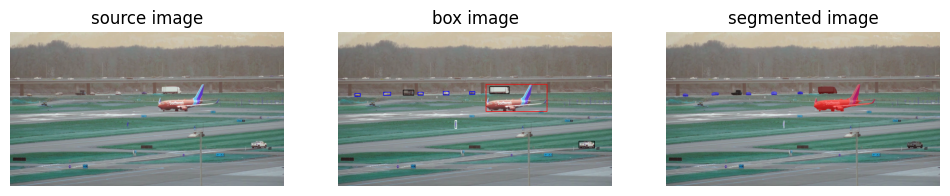


0: 384x640 1 person, 5 cars, 3 airplanes, 3 trucks, 30.2ms
Speed: 0.6ms preprocess, 30.2ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 688.8674,  243.2162,  979.8760,  372.3214],
        [ 708.4774,  254.1306,  800.7076,  290.0677],
        [1125.6917,  509.8467, 1199.1106,  544.0924],
        [ 373.9785,  281.0806,  398.4645,  296.1959],
        [ 491.6630,  277.0550,  518.5369,  294.6654],
        [ 614.1908,  279.8203,  639.6449,  290.7734],
        [ 213.0685,  280.9401,  247.1366,  297.2061],
        [ 304.0779,  271.4085,  355.4043,  296.6563],
        [ 545.1119,  415.2720,  554.8490,  445.7892],
        [  78.4020,  286.8457,  104.6115,  301.6172]], device='cuda:0')


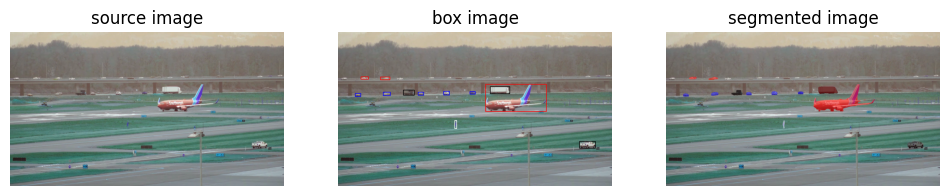


0: 384x640 1 person, 4 cars, 2 airplanes, 3 trucks, 29.4ms
Speed: 0.6ms preprocess, 29.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 687.1470,  242.6644,  976.4523,  372.2217],
        [ 710.6439,  253.8652,  803.5997,  290.0262],
        [1128.4769,  510.3616, 1203.3007,  544.6610],
        [ 616.5963,  279.2606,  641.4291,  290.4266],
        [ 493.3353,  277.4155,  520.6874,  294.3680],
        [ 304.6200,  270.9335,  358.3180,  296.9165],
        [ 374.4287,  281.4142,  400.2362,  296.3207],
        [ 195.8131,  209.1617,  241.8654,  222.7814],
        [ 211.4738,  280.7924,  245.1662,  297.4031],
        [ 544.9196,  415.2680,  554.8359,  446.2315],
        [ 107.9656,  208.6464,  142.9440,  219.7750],
        [  80.2977,  286.8033,  106.9564,  301.9127]], device='cuda:0')


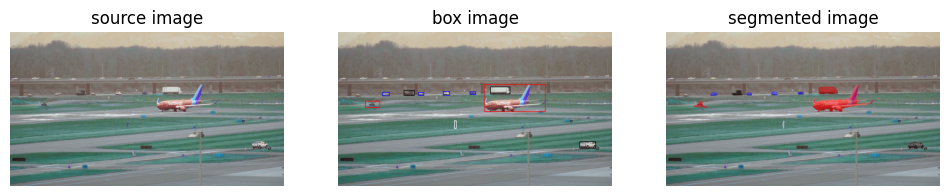


0: 384x640 4 cars, 3 airplanes, 3 trucks, 29.8ms
Speed: 2.9ms preprocess, 29.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 712.2382,  255.7766,  803.2141,  290.7529],
        [ 682.9557,  243.9708,  972.9697,  373.3704],
        [1129.2528,  511.0368, 1204.6617,  545.9466],
        [ 306.1598,  271.7230,  357.8015,  297.7888],
        [ 491.1099,  278.1949,  521.8945,  295.2850],
        [ 374.1864,  282.7534,  401.6127,  297.2982],
        [ 617.3483,  279.7956,  642.5663,  291.7360],
        [ 206.5686,  282.4087,  240.9015,  298.9471],
        [ 126.7252,  322.5951,  196.5385,  364.2547],
        [ 543.6873,  416.1014,  553.5261,  447.5064]], device='cuda:0')


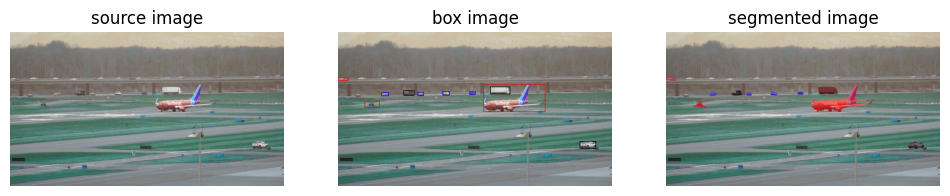


0: 384x640 4 cars, 3 airplanes, 3 trucks, 28.7ms
Speed: 0.6ms preprocess, 28.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[6.7831e+02, 2.4479e+02, 9.6955e+02, 3.7354e+02],
        [7.1190e+02, 2.5586e+02, 8.0336e+02, 2.9115e+02],
        [1.1300e+03, 5.1067e+02, 1.2056e+03, 5.4601e+02],
        [3.0587e+02, 2.7232e+02, 3.5661e+02, 2.9802e+02],
        [2.0315e+02, 2.8345e+02, 2.3647e+02, 2.9967e+02],
        [1.1451e+00, 2.1526e+02, 4.7870e+01, 2.2687e+02],
        [3.7253e+02, 2.8335e+02, 4.0114e+02, 2.9754e+02],
        [6.1566e+02, 2.8031e+02, 6.4130e+02, 2.9208e+02],
        [1.2439e+02, 3.2441e+02, 1.9375e+02, 3.6167e+02],
        [4.8972e+02, 2.7912e+02, 5.2190e+02, 2.9621e+02]], device='cuda:0')


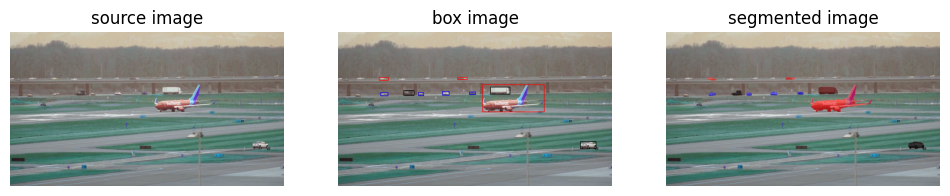


0: 384x640 6 cars, 1 airplane, 3 trucks, 37.1ms
Speed: 0.6ms preprocess, 37.1ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 674.4928,  244.8755,  967.6200,  374.4689],
        [ 711.9696,  256.2004,  803.7565,  291.9233],
        [1131.7791,  511.5190, 1205.8530,  546.3179],
        [ 305.9072,  272.3743,  355.8323,  298.0986],
        [ 199.4198,  283.4065,  232.6847,  299.6141],
        [ 375.4518,  283.9720,  401.1042,  298.1798],
        [ 192.3763,  213.0879,  239.0775,  226.0275],
        [ 488.1494,  279.4843,  521.1562,  296.4831],
        [ 614.4639,  280.6428,  641.7556,  292.7233],
        [ 557.8748,  211.5111,  605.1096,  223.0306]], device='cuda:0')


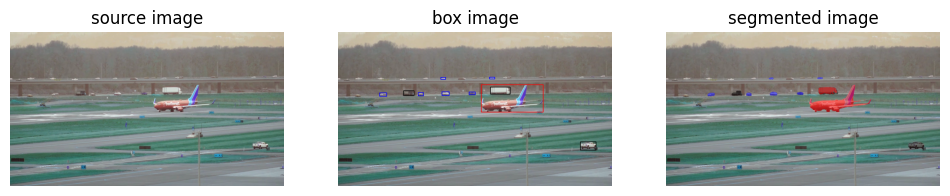


0: 384x640 1 person, 8 cars, 2 airplanes, 3 trucks, 28.8ms
Speed: 0.5ms preprocess, 28.8ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 711.9244,  256.9300,  804.5482,  292.6725],
        [ 670.3751,  245.0336,  961.6252,  375.0985],
        [1131.9319,  512.6229, 1206.7341,  548.0382],
        [ 306.4202,  273.1979,  355.9241,  298.9256],
        [ 485.7210,  280.1408,  519.9903,  296.6786],
        [ 194.2751,  283.9545,  227.5456,  299.5417],
        [ 375.5992,  284.6631,  400.0465,  298.8469],
        [ 479.9902,  213.5938,  501.4669,  221.2985],
        [ 707.4174,  211.4428,  733.1622,  219.9561],
        [ 613.7761,  281.5332,  641.2072,  294.0155]], device='cuda:0')


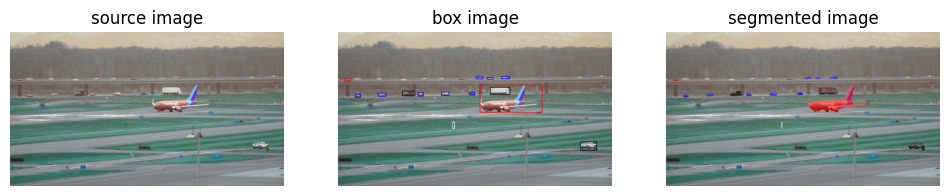


0: 384x640 1 person, 5 cars, 3 airplanes, 2 trucks, 28.8ms
Speed: 0.6ms preprocess, 28.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 664.4445,  247.2525,  956.1354,  375.9529],
        [ 711.5233,  257.5567,  803.4159,  292.8354],
        [ 483.1033,  281.5530,  518.6028,  296.8625],
        [1132.7715,  513.5048, 1206.3213,  547.3961],
        [ 373.5363,  284.8093,  399.1920,  299.4411],
        [ 189.6638,  285.9168,  222.6839,  300.0626],
        [ 615.8884,  282.2371,  640.2575,  294.5721],
        [ 764.0741,  208.2578,  800.8864,  218.7924],
        [ 300.5750,  274.7946,  354.1302,  299.5750],
        [ 644.7941,  209.5199,  675.8033,  220.4368],
        [ 534.9320,  418.8815,  545.3661,  447.2313],
        [  28.8623,  219.9528,   58.5457,  227.5658],
        [  80.0453,  290.9082,  106.1720,  305.2490],
        [ 697.6944,  212.1204,  724.5069,  220.6976]], device='cuda:0')


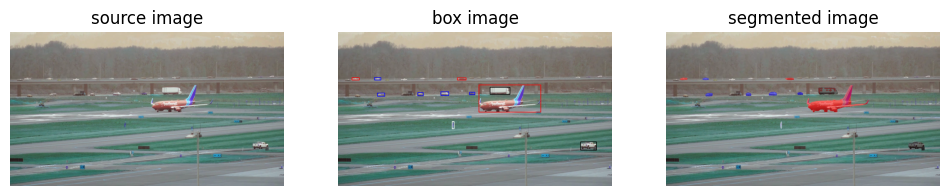


0: 384x640 1 person, 6 cars, 5 airplanes, 4 trucks, 34.1ms
Speed: 0.6ms preprocess, 34.1ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 659.1094,  246.6462,  950.7039,  375.5450],
        [ 709.6215,  257.1449,  803.5162,  292.9349],
        [ 480.8920,  280.6068,  517.5696,  296.9086],
        [1132.9399,  513.5767, 1205.8750,  546.9843],
        [ 372.7962,  284.1290,  398.4140,  299.1125],
        [ 614.7288,  281.9500,  640.4212,  294.0599],
        [ 532.5190,  417.4822,  542.3667,  447.0698],
        [  66.9576,  212.4751,  100.4648,  223.1027],
        [ 169.7949,  213.1891,  199.3151,  223.1434],
        [ 184.7377,  285.0813,  217.8463,  301.1252],
        [ 556.4538,  213.0992,  599.8526,  224.0584]], device='cuda:0')


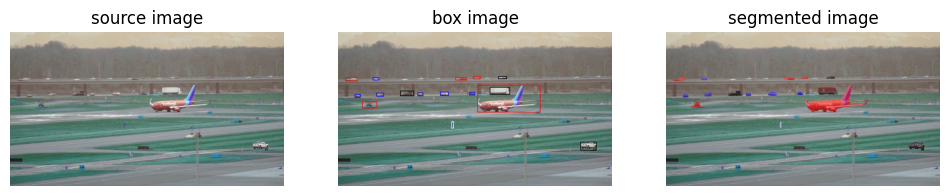


0: 384x640 6 cars, 3 airplanes, 3 trucks, 29.9ms
Speed: 0.6ms preprocess, 29.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 652.1021,  246.7249,  947.0786,  376.2603],
        [ 709.7601,  257.2382,  803.6425,  293.4641],
        [1134.2134,  514.0705, 1205.3257,  547.8935],
        [ 478.1680,  281.0455,  516.9822,  297.5883],
        [ 372.7271,  284.2288,  398.1266,  298.9547],
        [ 180.8581,  285.4316,  213.0164,  301.4260],
        [ 549.7730,  211.9791,  606.1675,  223.4955],
        [ 614.6895,  281.7002,  640.4165,  294.6157],
        [  79.6705,  291.2408,  104.8725,  304.9871],
        [ 530.8796,  418.8311,  540.0518,  447.3399],
        [ 112.4146,  325.3112,  183.1445,  357.4685],
        [ 163.3783,  214.3441,  191.9103,  223.7195],
        [ 629.9541,  209.0837,  663.9354,  220.0064],
        [ 291.4207,  274.9755,  352.8965,  299.7048],
        [  34.5882,  213.7252,   93.6792,  228.2253],
        [ 748.5320,  207.8731,  788.8823,  219.3555]], device='cuda:0')


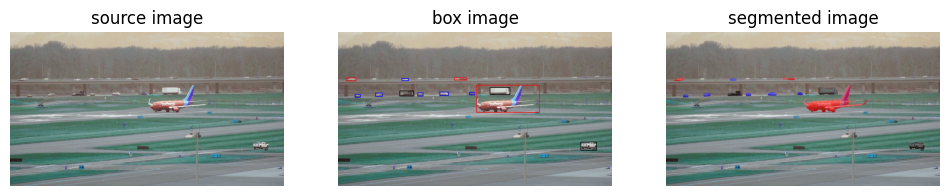


0: 384x640 6 cars, 1 airplane, 3 trucks, 31.1ms
Speed: 0.6ms preprocess, 31.1ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 647.2166,  247.3272,  943.5299,  376.3867],
        [ 709.8583,  257.6274,  803.3538,  293.8871],
        [1135.4420,  513.6675, 1208.0956,  547.7585],
        [  79.9903,  292.2503,  104.4464,  305.5981],
        [ 476.4156,  281.6921,  516.7109,  297.8382],
        [ 175.5426,  285.8063,  207.8607,  302.0844],
        [  35.1335,  213.6720,   85.5318,  228.3346],
        [ 372.9366,  285.2422,  397.8640,  299.0934],
        [ 614.2511,  282.0390,  639.8909,  295.3373],
        [ 298.6497,  216.8137,  329.2154,  226.6590],
        [ 543.8168,  213.1623,  604.6796,  223.7512],
        [ 288.0713,  275.7279,  351.6972,  300.4539]], device='cuda:0')


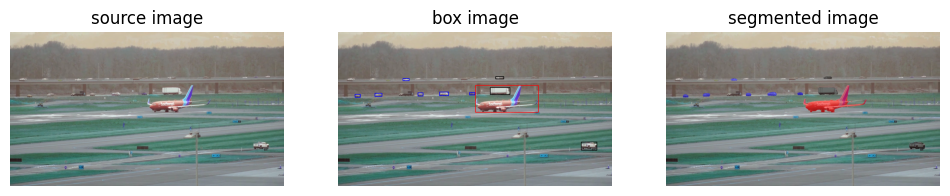


0: 384x640 1 person, 9 cars, 1 airplane, 3 trucks, 29.6ms
Speed: 0.6ms preprocess, 29.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 641.3035,  246.8400,  940.3381,  376.0660],
        [ 710.8872,  257.9557,  804.0750,  293.9017],
        [1137.1035,  514.5535, 1209.3770,  547.9592],
        [ 172.8361,  286.0669,  204.4984,  302.3332],
        [ 474.2275,  281.6695,  516.6232,  297.8190],
        [  79.9865,  292.1753,  104.4659,  305.5438],
        [ 373.0972,  285.4927,  397.6374,  299.2714],
        [ 614.5529,  282.2469,  640.3256,  295.1139],
        [ 303.8213,  216.7867,  332.7356,  226.6053],
        [ 735.2722,  207.8753,  774.2803,  219.7192]], device='cuda:0')


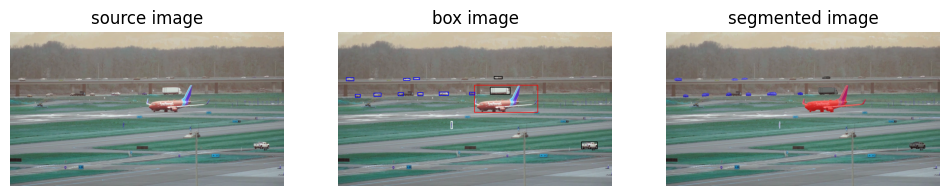


0: 384x640 1 person, 7 cars, 1 airplane, 2 trucks, 1 boat, 30.4ms
Speed: 0.7ms preprocess, 30.4ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 637.4766,  247.0295,  935.6924,  375.5170],
        [ 711.5701,  257.4655,  804.2059,  293.5702],
        [1137.9465,  513.2520, 1211.2134,  547.6365],
        [ 472.7257,  280.3284,  516.8091,  297.0579],
        [ 167.3432,  284.8678,  201.6976,  302.1932],
        [ 372.9328,  284.8472,  397.9174,  298.8961],
        [  80.0897,  291.5938,  105.2165,  304.8617],
        [ 615.0521,  282.0305,  640.0096,  294.8184],
        [ 280.5677,  283.6443,  305.5343,  299.5073],
        [  38.7454,  214.6721,   73.5102,  227.4136],
        [ 526.3184,  417.9977,  535.2344,  448.4380],
        [ 352.2023,  213.4487,  380.5160,  223.0733],
        [ 306.0624,  216.0345,  336.6714,  226.4401],
        [ 729.0771,  207.8193,  767.7080,  219.8399]], device='cuda:0')


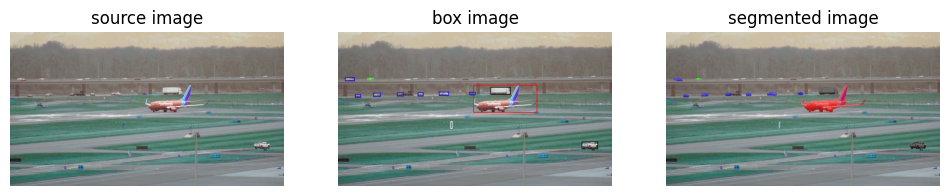


0: 384x640 1 person, 6 cars, 2 airplanes, 2 trucks, 1 boat, 30.2ms
Speed: 0.6ms preprocess, 30.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 634.5514,  247.4745,  932.5002,  376.0480],
        [ 712.7845,  257.4313,  804.6801,  293.5807],
        [1139.6948,  513.4739, 1213.0601,  548.0109],
        [ 165.5317,  285.5576,  198.6094,  302.7340],
        [ 472.2112,  281.1563,  517.2743,  297.0484],
        [ 276.5759,  283.7502,  309.0582,  299.7280],
        [ 372.9975,  284.7546,  398.4483,  298.9843],
        [ 614.6097,  282.0856,  640.8121,  294.8829],
        [  80.5536,  291.3463,  106.4249,  305.1687],
        [ 525.1787,  417.5663,  534.8599,  447.5834],
        [ 137.6473,  215.1515,  165.8225,  223.0705],
        [  33.6583,  214.0423,   77.2711,  226.4599]], device='cuda:0')


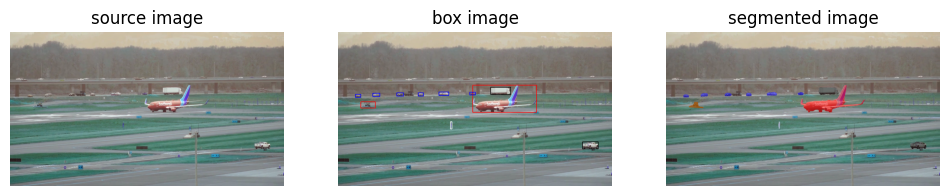


0: 384x640 1 person, 7 cars, 2 airplanes, 2 trucks, 1 boat, 29.9ms
Speed: 0.6ms preprocess, 29.9ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 629.7198,  246.9294,  929.8680,  376.3542],
        [ 713.9530,  257.7368,  804.3212,  293.7315],
        [1141.7727,  513.3944, 1215.1917,  547.5564],
        [ 471.4520,  282.0517,  517.7787,  296.6833],
        [ 162.8119,  286.2482,  195.6846,  303.0699],
        [ 374.2166,  284.6597,  398.7468,  299.0389],
        [ 273.6208,  284.3441,  307.7840,  299.9978],
        [  80.9745,  291.6959,  106.8933,  305.3985],
        [ 524.5502,  419.4095,  534.0889,  448.5100],
        [ 105.1435,  325.7603,  175.8878,  358.0761],
        [ 613.9984,  282.1130,  642.8361,  294.8717],
        [ 105.1201,  325.6516,  176.1091,  359.0102]], device='cuda:0')


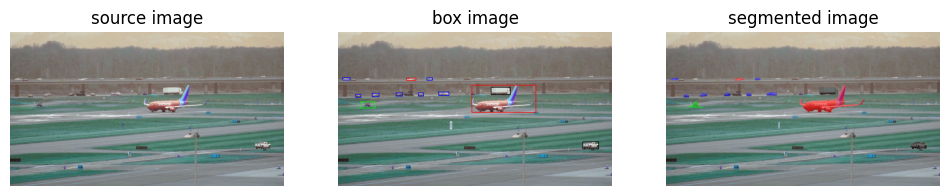


0: 384x640 1 person, 6 cars, 1 airplane, 3 trucks, 30.2ms
Speed: 0.6ms preprocess, 30.2ms inference, 7.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 626.2809,  246.2877,  927.1871,  376.3734],
        [ 714.8171,  257.6340,  805.4114,  293.9138],
        [1143.3701,  513.4718, 1217.6899,  548.5634],
        [ 159.7165,  285.9160,  191.9675,  303.3986],
        [ 271.4124,  284.3763,  302.2914,  300.6686],
        [ 523.6957,  418.6323,  533.1462,  448.4234],
        [ 470.7924,  282.0248,  518.4164,  296.8794],
        [ 374.5359,  284.6899,  399.5560,  299.3129],
        [  82.0855,  291.6297,  108.4545,  305.7594],
        [ 319.9969,  215.1499,  364.1037,  227.1387],
        [  22.7180,  213.2532,   57.3058,  223.5433],
        [ 103.8285,  325.4115,  176.8182,  357.5306],
        [ 415.3519,  215.2664,  439.9963,  224.6736]], device='cuda:0')


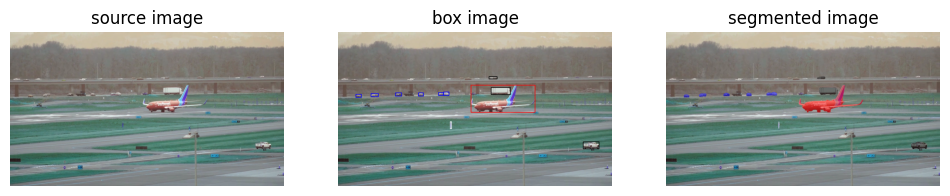


0: 384x640 1 person, 6 cars, 1 airplane, 2 trucks, 1 boat, 35.6ms
Speed: 0.7ms preprocess, 35.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 621.1081,  246.4409,  922.7903,  376.4808],
        [ 715.5627,  257.8546,  805.8879,  293.8722],
        [1145.5209,  513.1902, 1219.2516,  548.9276],
        [ 268.6797,  284.6274,  298.0159,  300.2147],
        [  83.6518,  291.9223,  109.3143,  305.4552],
        [ 155.1982,  286.6235,  189.4129,  303.2484],
        [ 522.7722,  419.5679,  531.1004,  449.5493],
        [ 493.3948,  282.3346,  518.5978,  296.0692],
        [ 374.4138,  284.9016,  400.1807,  299.6830],
        [ 704.8071,  208.1068,  743.6434,  219.9543],
        [ 469.1442,  283.8266,  492.8668,  296.8130]], device='cuda:0')


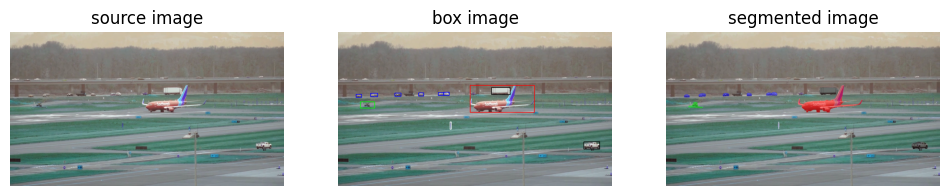


0: 384x640 1 person, 6 cars, 2 airplanes, 2 trucks, 29.6ms
Speed: 1.1ms preprocess, 29.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 617.8002,  246.9052,  919.2164,  377.0620],
        [ 717.3429,  258.1358,  804.9144,  294.0128],
        [1148.0892,  513.2628, 1222.2440,  551.8780],
        [ 492.6766,  281.8882,  519.7375,  296.9675],
        [ 467.8382,  283.9047,  494.2426,  297.4338],
        [  85.1539,  291.6594,  110.6814,  305.5679],
        [ 265.1700,  285.1081,  294.9927,  300.8521],
        [ 152.2192,  286.1460,  186.1611,  303.9441],
        [ 521.8667,  419.9578,  530.8296,  450.9240],
        [ 101.4227,  325.3529,  174.6348,  357.3133],
        [ 376.1667,  285.0170,  400.8412,  299.8360]], device='cuda:0')


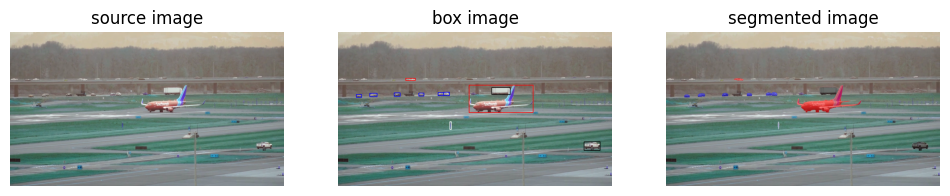


0: 384x640 1 person, 5 cars, 1 airplane, 3 trucks, 30.2ms
Speed: 2.0ms preprocess, 30.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 611.6768,  247.1220,  913.9346,  377.3672],
        [ 717.5037,  258.5079,  803.6014,  294.4415],
        [ 467.1824,  284.4353,  494.0291,  297.7544],
        [ 493.4445,  282.3697,  519.7592,  297.1983],
        [1149.2651,  513.1794, 1224.7500,  547.7212],
        [ 149.1668,  286.2791,  182.9002,  304.2449],
        [ 261.4310,  284.9459,  290.0750,  301.5166],
        [ 521.2192,  419.3773,  530.5737,  452.8002],
        [  85.7649,  291.7715,  111.0899,  305.9174],
        [ 376.6231,  285.3845,  401.3867,  299.9228],
        [ 315.3986,  215.2962,  362.0431,  226.5201]], device='cuda:0')


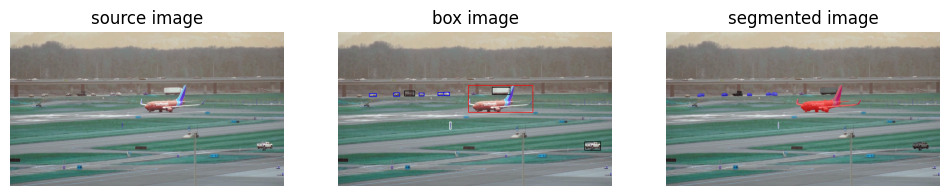


0: 384x640 1 person, 6 cars, 2 airplanes, 3 trucks, 28.6ms
Speed: 0.6ms preprocess, 28.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 608.3682,  247.2522,  911.8987,  377.2535],
        [ 494.5616,  282.0844,  520.7009,  297.0944],
        [ 466.4979,  283.9306,  493.9771,  297.9789],
        [1151.5822,  513.2436, 1226.3300,  547.2138],
        [ 719.8058,  258.2107,  803.4446,  293.6794],
        [ 146.4334,  286.4086,  180.4256,  303.8728],
        [ 259.2184,  284.0976,  288.6161,  300.9321],
        [ 521.2366,  419.6044,  529.7507,  450.5891],
        [ 378.1057,  284.8277,  402.7100,  299.9169],
        [ 309.5236,  276.1050,  358.7479,  300.1682]], device='cuda:0')


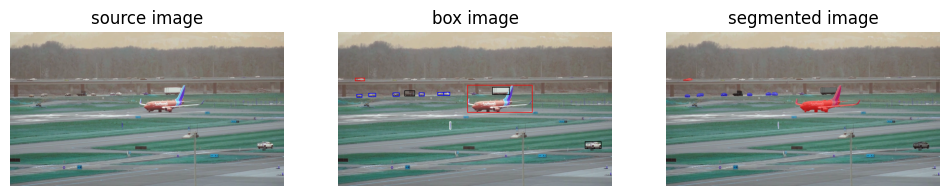


0: 384x640 1 person, 8 cars, 1 airplane, 3 trucks, 34.2ms
Speed: 0.5ms preprocess, 34.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 604.9647,  246.7685,  909.2374,  376.8410],
        [1154.3550,  512.4009, 1230.1504,  546.0725],
        [ 465.2039,  283.7871,  493.3858,  296.7705],
        [ 495.2652,  281.7314,  521.7468,  296.4868],
        [ 256.4590,  284.0163,  286.2222,  300.1090],
        [ 143.1947,  285.5301,  176.6761,  303.1014],
        [  79.4547,  215.8751,  124.9394,  226.7876],
        [ 378.9185,  284.9064,  403.1965,  299.0682],
        [ 721.0847,  257.7726,  799.6436,  293.4175],
        [ 309.1781,  274.0192,  360.5266,  300.2375],
        [  87.8483,  290.7312,  112.7304,  305.2475],
        [ 519.7734,  418.5608,  529.3818,  451.8787]], device='cuda:0')


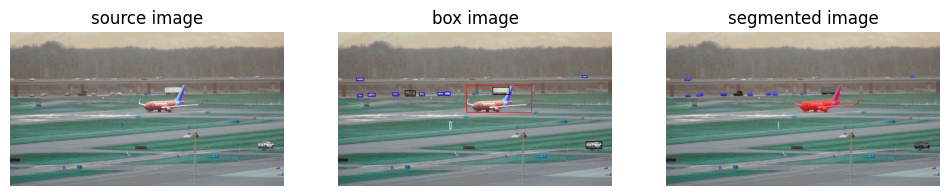


0: 384x640 1 person, 8 cars, 1 airplane, 2 trucks, 30.4ms
Speed: 0.6ms preprocess, 30.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 602.3448,  246.9755,  907.0551,  376.3478],
        [1157.6414,  511.8097, 1232.4705,  546.0973],
        [ 497.4856,  281.3163,  523.4979,  296.5181],
        [ 465.6240,  283.0535,  492.7382,  296.8206],
        [ 255.3360,  283.6413,  284.5585,  300.1673],
        [ 141.3835,  286.6052,  174.4734,  303.0405],
        [ 313.3319,  276.2101,  361.2348,  300.3640],
        [ 723.0427,  257.5280,  800.5603,  293.1546],
        [ 520.3834,  418.7626,  529.9200,  449.6581],
        [  90.1325,  291.5288,  115.8008,  304.9249],
        [ 380.0200,  284.3685,  405.6877,  299.1592],
        [  84.7887,  215.7560,  120.2809,  227.3138],
        [1141.6174,  205.8888, 1162.9058,  213.0270]], device='cuda:0')


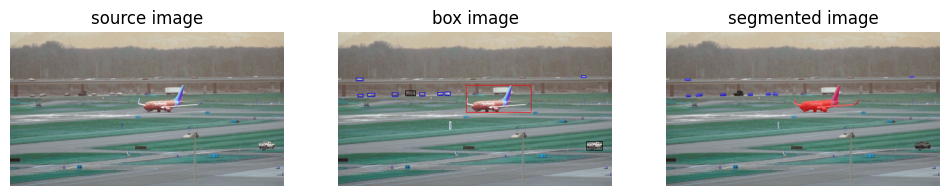


0: 384x640 1 person, 7 cars, 3 airplanes, 2 trucks, 29.9ms
Speed: 0.7ms preprocess, 29.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 597.7201,  246.7546,  904.3673,  376.8076],
        [1160.1682,  511.4592, 1236.3625,  546.3725],
        [ 465.2446,  283.2079,  491.9341,  296.7218],
        [ 498.9940,  281.3001,  524.5325,  296.6660],
        [ 314.6714,  275.2955,  362.6541,  300.3007],
        [ 252.5285,  284.0000,  282.2220,  300.2205],
        [ 138.8549,  286.6444,  172.9400,  302.9009],
        [  92.0916,  291.2139,  117.5882,  304.7587],
        [  84.0059,  215.9886,  117.7884,  226.8888],
        [1137.2637,  206.0441, 1157.7515,  212.9975],
        [ 519.8549,  418.7442,  529.4984,  449.8657],
        [ 380.6335,  284.4587,  406.9096,  299.0076]], device='cuda:0')


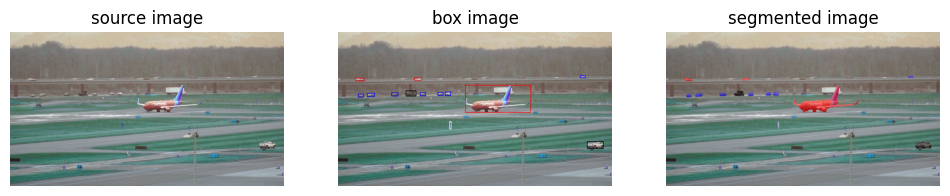


0: 384x640 1 person, 6 cars, 2 airplanes, 2 trucks, 30.0ms
Speed: 0.6ms preprocess, 30.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 594.1716,  246.9423,  902.0872,  376.4567],
        [1164.7336,  511.6056, 1239.2639,  546.6488],
        [ 465.2927,  282.5443,  491.1151,  296.8083],
        [ 499.8220,  280.3838,  526.6727,  296.6761],
        [ 250.0419,  284.1315,  281.1024,  299.9325],
        [ 136.6677,  285.7917,  171.6623,  303.3313],
        [ 316.3254,  275.1551,  364.6735,  300.1123],
        [  80.3088,  215.9955,  123.9600,  227.4933],
        [1132.5283,  205.4841, 1154.0398,  213.6119],
        [ 520.4819,  418.2147,  529.6742,  449.5405],
        [  95.1346,  291.1734,  120.2923,  304.8564],
        [ 383.9637,  284.2877,  408.6809,  298.7525],
        [ 356.9234,  214.7108,  391.5637,  225.0950]], device='cuda:0')


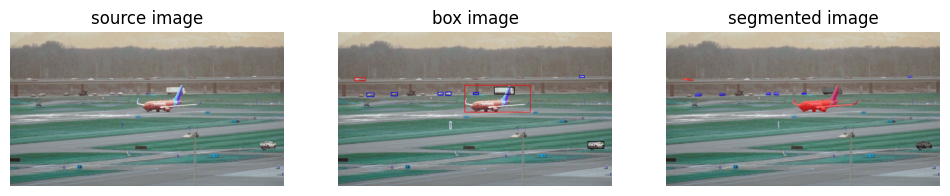


0: 384x640 1 person, 7 cars, 1 airplane, 2 trucks, 29.5ms
Speed: 0.7ms preprocess, 29.5ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 591.8178,  247.0595,  900.4625,  375.6930],
        [1167.5299,  511.0188, 1242.9188,  545.1993],
        [ 465.7228,  282.1264,  491.3350,  296.8498],
        [ 503.0607,  280.0088,  528.3593,  296.1458],
        [ 134.6690,  285.2762,  169.8691,  302.6519],
        [ 247.8476,  283.5044,  278.9498,  299.9065],
        [ 631.4683,  282.3217,  656.5378,  294.0182],
        [ 521.0867,  418.1995,  530.1245,  449.3130],
        [1129.2529,  205.1929, 1149.6799,  212.9638],
        [  74.3282,  214.7658,  128.2525,  227.5422],
        [ 729.3539,  256.3892,  826.8727,  292.2842]], device='cuda:0')


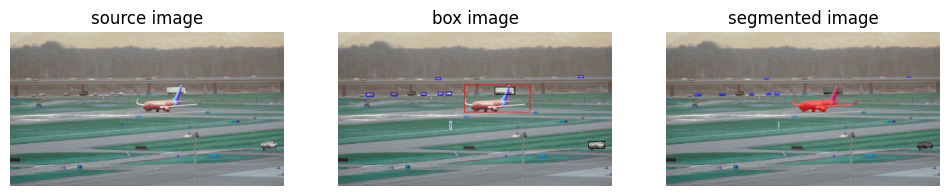


0: 384x640 2 persons, 4 cars, 1 airplane, 2 trucks, 32.4ms
Speed: 0.7ms preprocess, 32.4ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 589.8804,  246.5430,  898.6885,  376.0087],
        [ 505.0200,  280.3184,  530.6218,  296.2366],
        [ 466.7957,  281.8596,  492.3717,  296.7022],
        [ 133.7621,  285.5024,  167.0876,  302.5824],
        [1171.9475,  510.2145, 1247.3801,  547.0748],
        [ 732.6295,  256.4534,  829.6786,  292.5085],
        [ 521.3854,  418.1646,  531.0643,  450.7245],
        [ 246.9079,  283.4933,  277.6059,  299.9635],
        [1125.1245,  205.0114, 1145.7925,  213.2621],
        [ 454.0729,  214.1149,  479.2772,  223.5381],
        [ 387.3255,  284.0539,  412.4887,  298.6129]], device='cuda:0')


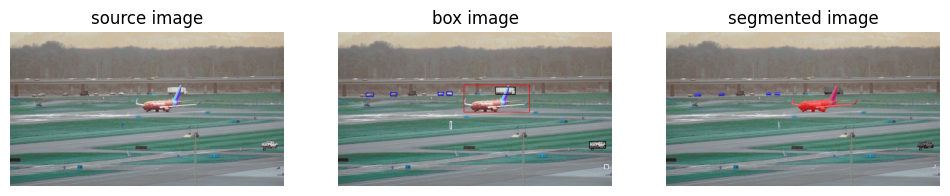


0: 384x640 2 persons, 5 cars, 1 airplane, 2 trucks, 30.1ms
Speed: 4.8ms preprocess, 30.1ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 587.4465,  247.5608,  896.1624,  376.4281],
        [1174.2625,  509.5983, 1251.1174,  544.8915],
        [ 507.1464,  280.3311,  533.0864,  296.1120],
        [ 466.9050,  281.6180,  492.7771,  296.7796],
        [ 131.0486,  285.3125,  166.3797,  302.6682],
        [ 522.2411,  417.9545,  531.2877,  446.5621],
        [ 245.5138,  283.4447,  275.8417,  299.6965],
        [ 735.9498,  257.7041,  829.0385,  292.6433],
        [1244.5483,  619.1129, 1262.2109,  639.2277]], device='cuda:0')


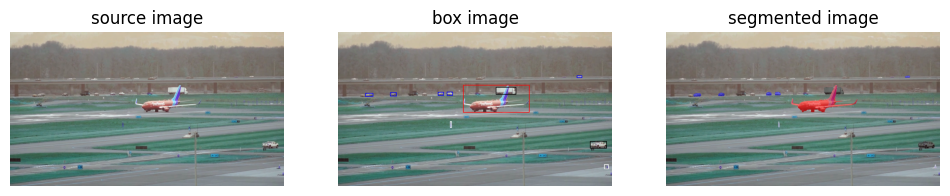


0: 384x640 2 persons, 4 cars, 1 airplane, 2 trucks, 30.0ms
Speed: 0.5ms preprocess, 30.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 584.7689,  248.9796,  895.8746,  376.1271],
        [1177.6292,  510.0123, 1255.1658,  544.6385],
        [ 509.3236,  280.4286,  535.0258,  295.9751],
        [ 467.1870,  281.3013,  493.5579,  296.9454],
        [ 243.7142,  284.1442,  273.4611,  299.6033],
        [ 737.6243,  256.8154,  830.9905,  292.7800],
        [1118.2019,  205.4819, 1137.9241,  213.4763],
        [ 128.1789,  285.6147,  164.2575,  302.8829],
        [1245.3324,  619.5345, 1263.4781,  639.4969],
        [ 523.1588,  418.5297,  531.2811,  445.4013]], device='cuda:0')


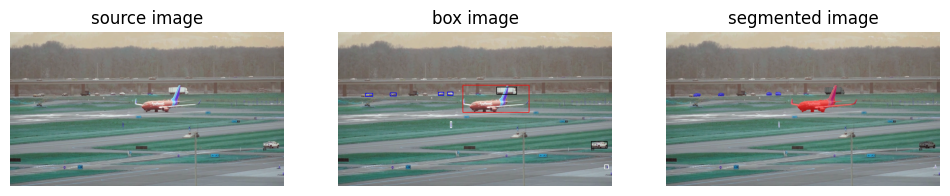


0: 384x640 1 person, 3 cars, 1 airplane, 3 trucks, 34.8ms
Speed: 0.6ms preprocess, 34.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 582.2854,  249.7502,  894.6919,  376.0878],
        [1181.7378,  510.6669, 1258.9377,  544.4430],
        [ 739.6890,  256.1713,  835.3945,  292.3876],
        [ 468.3239,  281.6015,  494.2978,  296.6746],
        [ 511.5644,  279.9744,  538.1724,  296.6229],
        [ 242.4979,  284.0181,  273.1959,  299.8077],
        [ 523.4800,  418.0140,  532.4266,  446.1080],
        [1245.7485,  619.4115, 1264.2080,  639.2911],
        [ 125.1052,  285.8549,  161.5877,  303.1706]], device='cuda:0')


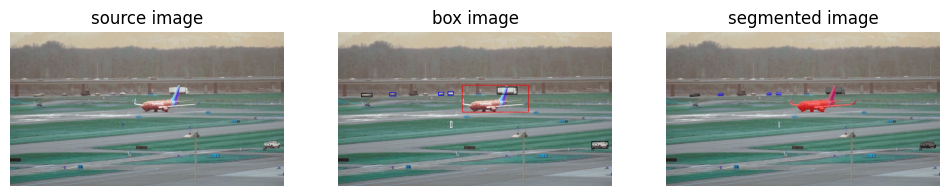


0: 384x640 3 cars, 1 airplane, 2 trucks, 29.5ms
Speed: 0.6ms preprocess, 29.5ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 579.0996,  248.7377,  893.1365,  375.7385],
        [ 742.5121,  256.3499,  836.9883,  291.7126],
        [1185.7600,  509.3123, 1262.3999,  544.5467],
        [ 513.7078,  280.4089,  539.6343,  296.3496],
        [ 468.6788,  281.6284,  494.1826,  296.8749],
        [ 241.1212,  284.3341,  271.1073,  299.8689],
        [ 523.9480,  417.8256,  533.2561,  445.6667],
        [ 109.7450,  285.6357,  160.2724,  303.6183]], device='cuda:0')


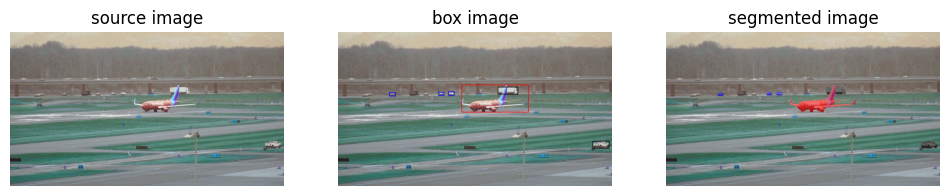


0: 384x640 1 person, 4 cars, 1 airplane, 3 trucks, 28.7ms
Speed: 0.6ms preprocess, 28.7ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 577.0506,  247.6166,  891.9692,  375.8842],
        [ 746.1830,  256.1606,  840.9554,  290.9431],
        [1189.5176,  509.6327, 1267.0469,  544.5582],
        [ 516.6260,  280.6088,  542.0209,  296.0029],
        [ 470.4005,  281.9025,  495.4307,  296.8154],
        [ 239.8739,  284.0945,  269.7318,  300.0806]], device='cuda:0')


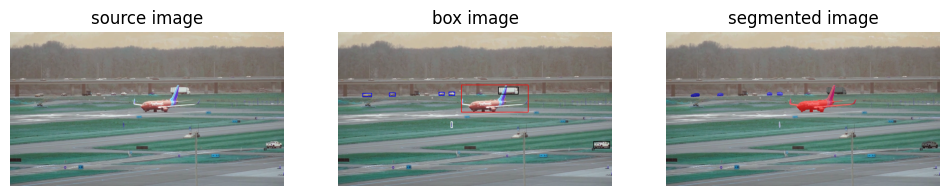


0: 384x640 5 cars, 1 airplane, 2 trucks, 32.6ms
Speed: 0.6ms preprocess, 32.6ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 575.3738,  247.0465,  890.7021,  376.0858],
        [ 749.6456,  256.7059,  843.0431,  291.3408],
        [1193.9526,  509.6887, 1270.8955,  545.1829],
        [ 239.6819,  285.6194,  267.9367,  300.2477],
        [ 471.3364,  281.8281,  496.0839,  296.5675],
        [ 518.9633,  279.9985,  545.0969,  296.3232],
        [ 115.3062,  285.6407,  157.5678,  304.0045],
        [ 115.4655,  285.7366,  157.2289,  303.8481],
        [ 526.3491,  418.2967,  535.0361,  446.2864]], device='cuda:0')


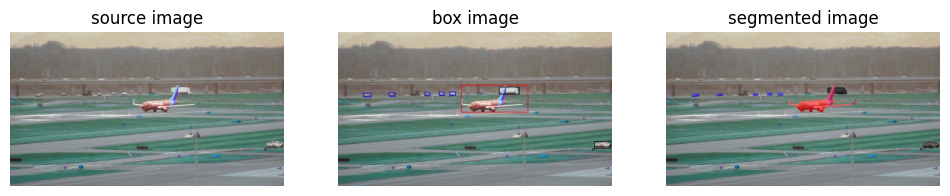


0: 384x640 7 cars, 1 airplane, 2 trucks, 31.6ms
Speed: 0.6ms preprocess, 31.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 574.0769,  247.7896,  889.8224,  375.8696],
        [1198.5322,  510.1119, 1275.7727,  544.4344],
        [ 751.1327,  256.4784,  846.5051,  291.4674],
        [ 472.4844,  281.5954,  497.6039,  296.6487],
        [ 237.9183,  284.6407,  267.0320,  300.7419],
        [ 118.5029,  286.1331,  156.1878,  303.8289],
        [ 521.0887,  279.9334,  548.5167,  296.4224],
        [ 405.1028,  284.4692,  430.4703,  298.7182]], device='cuda:0')


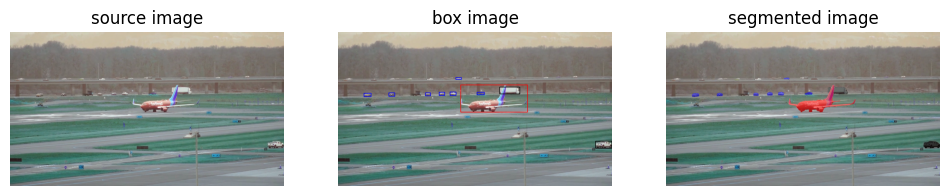


0: 384x640 1 person, 7 cars, 1 airplane, 2 trucks, 33.7ms
Speed: 1.3ms preprocess, 33.7ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 572.6288,  247.6801,  887.5219,  375.7544],
        [1202.3379,  509.3292, 1279.3081,  544.0517],
        [ 749.7628,  256.5499,  849.0563,  291.3714],
        [ 472.8412,  281.6238,  498.2942,  296.6478],
        [ 237.5048,  285.0800,  265.5658,  300.2376],
        [ 121.4794,  286.5652,  154.9722,  303.3210],
        [ 523.3006,  279.9724,  550.6331,  296.4734],
        [ 550.4711,  212.5723,  576.5804,  222.1886],
        [ 408.7521,  283.9373,  432.6537,  298.7350],
        [ 650.5383,  281.9929,  684.5256,  293.8260]], device='cuda:0')


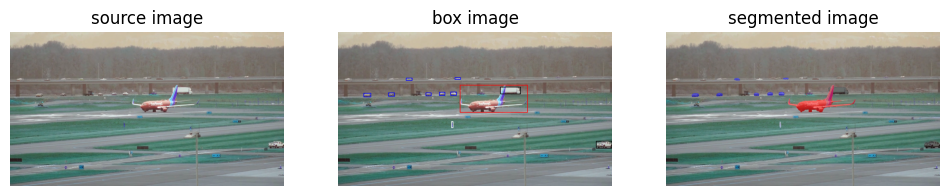


0: 384x640 1 person, 5 cars, 1 airplane, 2 trucks, 29.1ms
Speed: 0.6ms preprocess, 29.1ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 569.7549,  248.9009,  886.7971,  375.9952],
        [1206.4158,  510.1060, 1279.3044,  544.0698],
        [ 119.5434,  286.1703,  153.9550,  303.9375],
        [ 473.5923,  281.6074,  499.0536,  296.7106],
        [ 235.2099,  284.7807,  265.2371,  300.5970],
        [ 526.9888,  279.8462,  553.6541,  296.6136],
        [ 754.9427,  256.4601,  852.8468,  290.8904],
        [ 546.6868,  212.4981,  572.7084,  222.0154],
        [ 317.4003,  216.2104,  346.6926,  225.8086],
        [ 411.3571,  283.8724,  434.7037,  298.7605],
        [ 529.3665,  418.8885,  537.7812,  446.8444]], device='cuda:0')


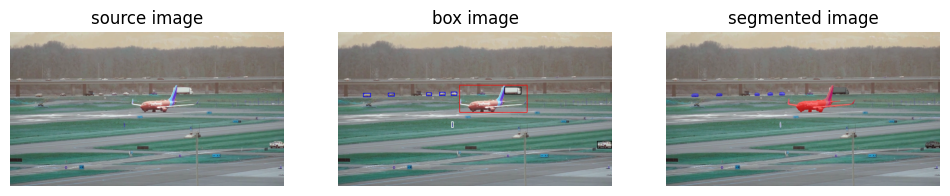


0: 384x640 1 person, 4 cars, 1 airplane, 2 trucks, 29.3ms
Speed: 0.6ms preprocess, 29.3ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 568.0110,  248.1437,  885.1448,  376.6040],
        [ 777.7922,  257.0786,  856.0198,  292.3889],
        [1210.6750,  509.6650, 1279.5398,  544.1721],
        [ 474.6321,  281.7356,  500.3868,  296.9148],
        [ 234.7856,  285.8517,  263.8177,  300.6028],
        [ 118.4703,  286.9478,  151.9618,  303.7915],
        [ 529.4156,  280.3510,  556.3361,  296.4923],
        [ 413.1566,  284.0456,  437.7415,  298.5544],
        [ 529.7986,  419.5324,  538.4706,  446.4361]], device='cuda:0')


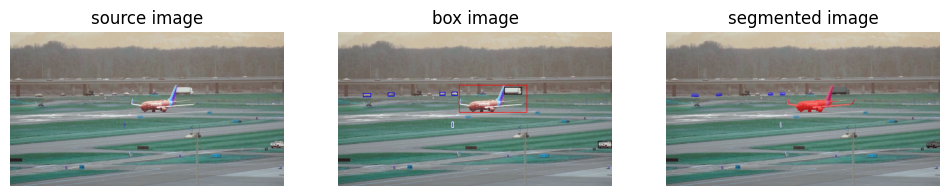


0: 384x640 4 cars, 1 airplane, 2 trucks, 30.2ms
Speed: 0.6ms preprocess, 30.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 566.0861,  248.8175,  884.5878,  376.0000],
        [1216.6387,  509.7687, 1279.6370,  543.6769],
        [ 233.7283,  285.9253,  262.0702,  300.4514],
        [ 775.3212,  256.9472,  859.7446,  291.9843],
        [ 475.7275,  281.6667,  500.9824,  296.8292],
        [ 531.7034,  280.2572,  558.0135,  296.2288],
        [ 531.0200,  418.7795,  539.5110,  445.8677],
        [ 117.8209,  287.2679,  153.2571,  303.7003]], device='cuda:0')


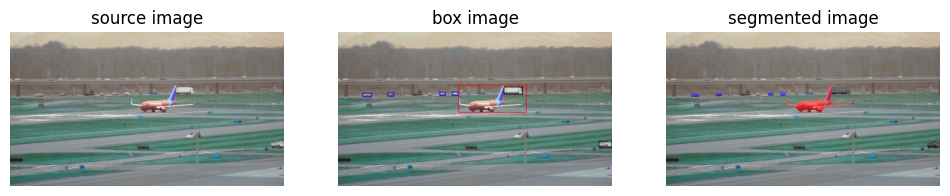


0: 384x640 4 cars, 1 airplane, 2 trucks, 30.4ms
Speed: 0.7ms preprocess, 30.4ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 564.1101,  247.3317,  882.8021,  376.5256],
        [1218.8466,  509.0757, 1279.5150,  543.7231],
        [ 774.9325,  256.8286,  861.9126,  292.1752],
        [ 476.1151,  281.5988,  501.8677,  296.8399],
        [ 115.0415,  286.6194,  156.9901,  303.8386],
        [ 232.2650,  285.0291,  260.9223,  300.1339],
        [ 534.4117,  280.1528,  560.0780,  296.1323]], device='cuda:0')


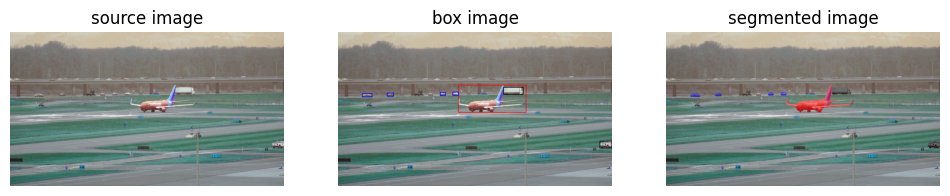


0: 384x640 3 cars, 1 airplane, 2 trucks, 29.6ms
Speed: 0.6ms preprocess, 29.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 562.0308,  246.9155,  880.5770,  376.9642],
        [ 772.6195,  257.0011,  865.0236,  292.3086],
        [1222.2328,  509.8104, 1279.5114,  543.7411],
        [ 476.7590,  282.0637,  502.1739,  296.9677],
        [ 536.6732,  280.0419,  563.0432,  296.5541],
        [ 114.0836,  287.0469,  160.1279,  304.1236],
        [ 229.4769,  285.0327,  259.6948,  300.7861]], device='cuda:0')


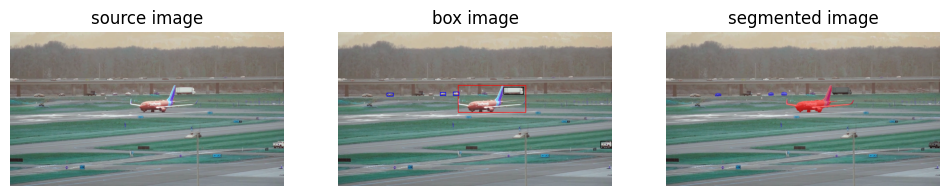


0: 384x640 1 person, 6 cars, 2 airplanes, 5 trucks, 28.8ms
Speed: 8.0ms preprocess, 28.8ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 559.1621,  246.6664,  879.4675,  376.8885],
        [ 773.1062,  257.3630,  867.1477,  292.3668],
        [1226.9517,  509.8011, 1279.5063,  543.6124],
        [ 478.2637,  282.4835,  502.7552,  297.0159],
        [ 228.6331,  285.5277,  258.5968,  300.5938],
        [ 538.4971,  279.9725,  565.3484,  296.5174]], device='cuda:0')


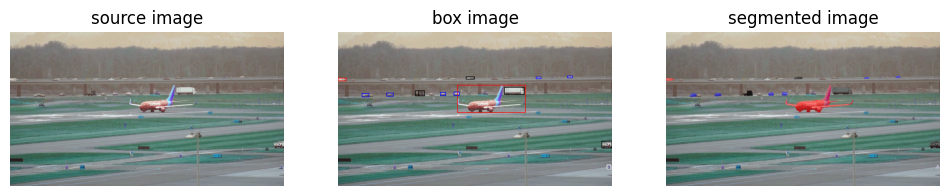


0: 384x640 5 cars, 1 airplane, 3 trucks, 31.0ms
Speed: 0.6ms preprocess, 31.0ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[7.7750e+02, 2.5717e+02, 8.7076e+02, 2.9241e+02],
        [5.5704e+02, 2.4706e+02, 8.7856e+02, 3.7712e+02],
        [1.2326e+03, 5.1156e+02, 1.2794e+03, 5.4357e+02],
        [4.7896e+02, 2.8226e+02, 5.0411e+02, 2.9689e+02],
        [2.2716e+02, 2.8519e+02, 2.5776e+02, 3.0083e+02],
        [5.4070e+02, 2.8016e+02, 5.6835e+02, 2.9658e+02],
        [1.0729e+03, 2.0618e+02, 1.0927e+03, 2.1346e+02],
        [2.3439e-01, 2.1537e+02, 3.8889e+01, 2.2779e+02],
        [1.2599e+03, 6.2085e+02, 1.2734e+03, 6.3936e+02],
        [3.6467e+02, 2.7333e+02, 4.0562e+02, 2.9897e+02],
        [1.1140e+02, 2.8711e+02, 1.4439e+02, 3.0463e+02],
        [5.9683e+02, 2.0852e+02, 6.3805e+02, 2.2050e+02],
        [3.7644e+02, 2.7387e+02, 4.0584e+02, 2.9839e+02],
        [9.2492e+02, 2.1118e+02, 9.4861e+02, 2.1811e+02]], device='cuda:0')


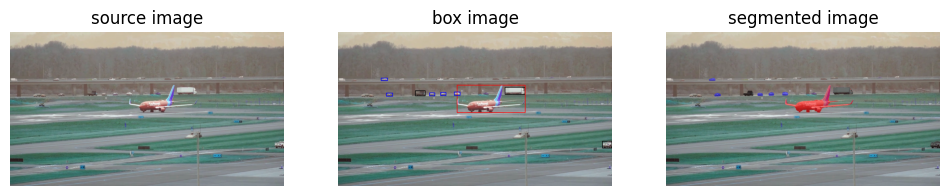


0: 384x640 5 cars, 2 airplanes, 4 trucks, 28.8ms
Speed: 0.6ms preprocess, 28.8ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 780.3262,  257.1417,  872.9844,  292.4902],
        [ 554.6272,  246.8155,  876.7976,  377.1454],
        [1235.3561,  510.4333, 1279.4630,  543.7266],
        [ 361.6011,  273.3483,  408.4183,  300.0623],
        [ 479.5816,  282.5855,  504.9117,  296.9485],
        [ 225.1656,  285.2784,  256.5889,  301.2983],
        [ 543.6307,  280.0877,  570.9072,  297.1386],
        [ 200.5411,  215.7634,  230.5268,  227.4319],
        [ 427.6641,  284.9296,  452.7922,  298.4805]], device='cuda:0')


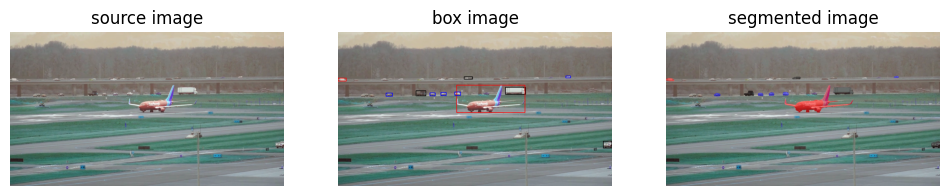


0: 384x640 4 cars, 2 airplanes, 3 trucks, 34.3ms
Speed: 0.6ms preprocess, 34.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[7.8283e+02, 2.5717e+02, 8.7688e+02, 2.9236e+02],
        [5.5268e+02, 2.4702e+02, 8.7570e+02, 3.7735e+02],
        [3.6313e+02, 2.7358e+02, 4.1087e+02, 3.0008e+02],
        [1.2389e+03, 5.1094e+02, 1.2794e+03, 5.4401e+02],
        [4.8038e+02, 2.8303e+02, 5.0536e+02, 2.9736e+02],
        [5.4551e+02, 2.7993e+02, 5.7259e+02, 2.9688e+02],
        [2.2426e+02, 2.8550e+02, 2.5503e+02, 3.0052e+02],
        [4.2957e+02, 2.8442e+02, 4.5533e+02, 2.9871e+02],
        [2.3504e-01, 2.1557e+02, 4.0867e+01, 2.2934e+02],
        [1.0655e+03, 2.0654e+02, 1.0860e+03, 2.1359e+02],
        [5.8908e+02, 2.0914e+02, 6.2857e+02, 2.2098e+02]], device='cuda:0')


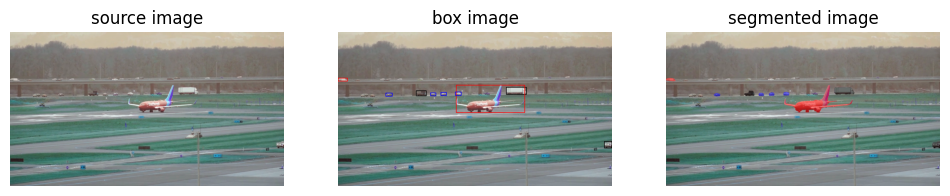


0: 384x640 5 cars, 1 airplane, 3 trucks, 28.7ms
Speed: 0.6ms preprocess, 28.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 786.1503,  257.0984,  879.7446,  292.5031],
        [ 551.1135,  246.8868,  875.6292,  377.1532],
        [ 480.6565,  283.1238,  506.3230,  297.5648],
        [1244.0734,  511.5635, 1279.4938,  543.8286],
        [ 365.0952,  273.9550,  413.4926,  299.6545],
        [ 223.8986,  285.1987,  253.9279,  300.2542],
        [ 548.8257,  279.8535,  575.5889,  296.8605],
        [   0.0000,  215.3197,   46.1061,  228.9450],
        [ 432.4095,  284.3887,  457.2649,  298.6935]], device='cuda:0')


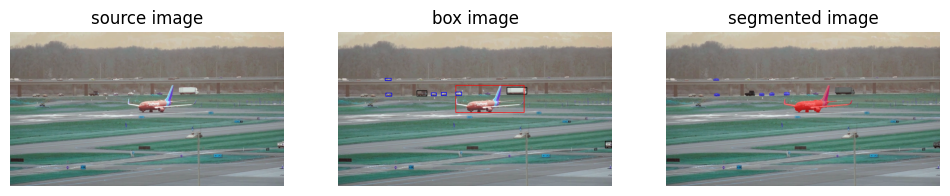


0: 384x640 7 cars, 3 airplanes, 3 trucks, 29.8ms
Speed: 0.7ms preprocess, 29.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 789.2639,  256.9741,  882.9851,  292.4846],
        [ 549.1377,  246.9516,  873.0281,  377.4458],
        [ 481.6489,  282.9506,  506.6027,  297.7169],
        [ 366.2723,  273.1955,  415.7076,  300.0005],
        [1248.1461,  511.2628, 1279.4928,  543.1395],
        [ 223.3480,  285.4772,  252.5987,  300.8698],
        [ 551.2766,  279.4679,  578.1068,  296.9690],
        [ 435.4619,  284.8461,  459.5865,  298.4768],
        [ 219.9195,  216.5448,  248.6055,  227.2481]], device='cuda:0')


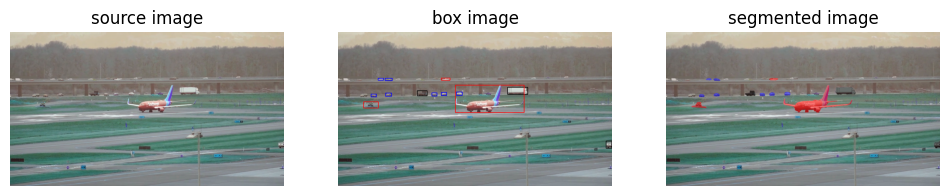


0: 384x640 6 cars, 1 airplane, 5 trucks, 35.9ms
Speed: 0.6ms preprocess, 35.9ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 792.6327,  257.1160,  885.8713,  292.4713],
        [ 547.2442,  246.8171,  872.2003,  377.5174],
        [ 222.1195,  286.0039,  250.8551,  300.4223],
        [ 482.9239,  283.1183,  508.1502,  297.6040],
        [ 368.1484,  273.5027,  417.4860,  299.8997],
        [ 553.3539,  280.3413,  580.6165,  296.9398],
        [1252.0178,  511.5525, 1279.5037,  543.0161],
        [ 437.8071,  285.3924,  462.5897,  298.4923],
        [ 118.2540,  323.4327,  190.1555,  357.0271],
        [ 481.6990,  214.6993,  524.7515,  225.4782],
        [ 219.5220,  216.1314,  253.8097,  227.3936],
        [ 155.4586,  290.5142,  179.2305,  304.4869],
        [ 188.2240,  216.5720,  210.9225,  225.0748]], device='cuda:0')


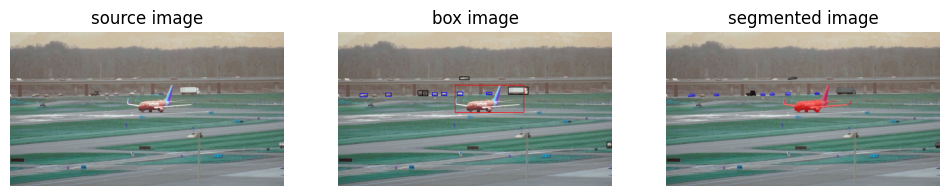


0: 384x640 7 cars, 2 airplanes, 4 trucks, 33.3ms
Speed: 0.6ms preprocess, 33.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 795.3549,  256.8142,  890.1942,  292.3170],
        [ 544.9659,  246.7396,  871.0424,  377.4746],
        [ 221.6874,  285.5462,  250.0223,  300.6368],
        [ 484.1797,  282.6812,  508.6995,  297.3432],
        [1255.6897,  513.9228, 1279.5105,  542.7653],
        [ 556.1771,  280.0410,  583.5223,  296.7227],
        [ 440.7470,  284.8099,  464.8920,  298.6205],
        [ 569.9521,  208.6505,  613.3723,  222.3392],
        [ 394.1306,  273.2175,  420.8006,  298.6777],
        [ 102.4469,  287.2004,  137.6544,  304.2251],
        [ 372.5779,  273.4967,  420.8902,  299.2406],
        [ 692.0021,  281.3834,  719.1738,  293.8460]], device='cuda:0')


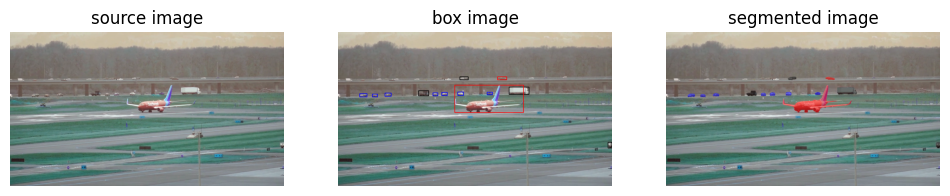


0: 384x640 6 cars, 4 airplanes, 4 trucks, 32.9ms
Speed: 0.6ms preprocess, 32.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 798.5370,  257.0254,  892.4508,  292.4900],
        [ 543.2919,  246.6230,  869.3575,  377.5486],
        [ 219.5400,  285.7170,  249.3094,  300.3284],
        [ 484.8108,  282.5591,  510.4073,  297.9502],
        [ 744.1091,  210.0429,  789.4351,  223.2902],
        [ 377.2050,  272.7962,  423.8691,  299.9800],
        [ 696.6398,  281.5980,  721.1481,  293.6187],
        [1260.3118,  514.4549, 1279.5168,  542.6777],
        [ 443.3828,  284.6667,  467.0613,  298.6919],
        [ 559.4346,  280.4502,  586.2901,  296.7535],
        [ 101.5005,  288.0220,  136.1454,  304.7172],
        [ 160.4971,  289.7487,  185.1861,  304.5994],
        [ 569.2642,  208.9134,  608.3900,  222.7818]], device='cuda:0')


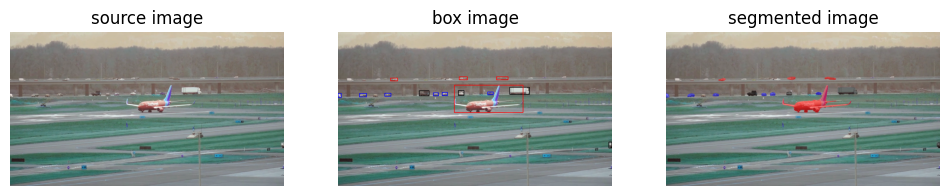


0: 384x640 8 cars, 1 airplane, 3 trucks, 30.1ms
Speed: 0.5ms preprocess, 30.1ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[8.0208e+02, 2.5709e+02, 8.9487e+02, 2.9219e+02],
        [5.4220e+02, 2.4678e+02, 8.6744e+02, 3.7752e+02],
        [2.1844e+02, 2.8572e+02, 2.4824e+02, 3.0024e+02],
        [4.8596e+02, 2.8251e+02, 5.1085e+02, 2.9822e+02],
        [3.7829e+02, 2.7298e+02, 4.2558e+02, 2.9989e+02],
        [4.4551e+02, 2.8467e+02, 4.7027e+02, 2.9846e+02],
        [7.4155e+02, 2.1023e+02, 7.9579e+02, 2.2254e+02],
        [2.4367e+02, 2.1450e+02, 2.7877e+02, 2.2898e+02],
        [9.9726e+01, 2.8794e+02, 1.3440e+02, 3.0491e+02],
        [5.6130e+02, 2.7588e+02, 5.8815e+02, 2.9610e+02],
        [6.9983e+02, 2.8050e+02, 7.2565e+02, 2.9308e+02],
        [1.2650e+03, 5.1480e+02, 1.2795e+03, 5.4172e+02],
        [5.6505e+02, 2.0874e+02, 6.0605e+02, 2.2256e+02],
        [3.3677e-02, 2.8826e+02, 1.4888e+01, 3.0553e+02]], device='cuda:0')


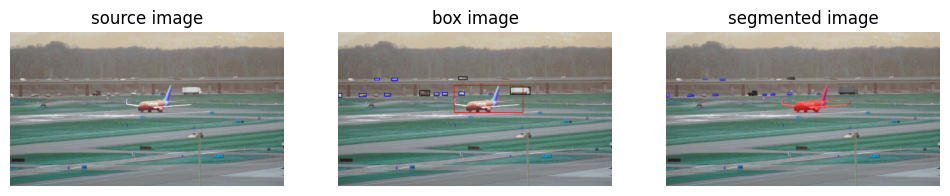


0: 384x640 6 cars, 2 airplanes, 2 trucks, 31.7ms
Speed: 0.6ms preprocess, 31.7ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


tensor([[8.0512e+02, 2.5666e+02, 8.9878e+02, 2.9226e+02],
        [5.4135e+02, 2.4677e+02, 8.6837e+02, 3.7744e+02],
        [2.1805e+02, 2.8603e+02, 2.4707e+02, 3.0100e+02],
        [4.8751e+02, 2.8267e+02, 5.1190e+02, 2.9806e+02],
        [4.4874e+02, 2.8446e+02, 4.7307e+02, 2.9866e+02],
        [9.8265e+01, 2.8708e+02, 1.3419e+02, 3.0503e+02],
        [5.6492e+02, 2.7814e+02, 5.9013e+02, 2.9593e+02],
        [2.4975e+02, 2.1568e+02, 2.7893e+02, 2.2779e+02],
        [3.8030e+02, 2.7233e+02, 4.2940e+02, 2.9963e+02],
        [5.6268e+02, 2.0913e+02, 6.0465e+02, 2.2295e+02],
        [4.8733e-03, 2.8818e+02, 1.8337e+01, 3.0586e+02],
        [1.7037e+02, 2.1614e+02, 1.9436e+02, 2.2506e+02]], device='cuda:0')


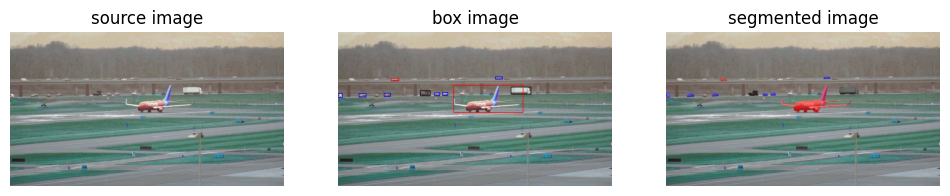


0: 384x640 1 person, 7 cars, 2 airplanes, 3 trucks, 28.7ms
Speed: 0.5ms preprocess, 28.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[808.6221, 256.7968, 900.7024, 292.0872],
        [539.3295, 246.6832, 867.0329, 377.6243],
        [216.1029, 286.0990, 245.7646, 301.6896],
        [489.0410, 282.8435, 513.4412, 297.9920],
        [383.4524, 273.3273, 431.1002, 300.0232],
        [  0.0000, 290.0109,  20.0765, 305.5388],
        [ 97.4692, 287.5389, 133.3644, 305.2579],
        [451.4686, 284.5964, 475.3716, 298.4243],
        [247.8732, 215.1964, 285.6191, 228.4032],
        [735.3332, 209.5493, 768.9423, 219.8970]], device='cuda:0')


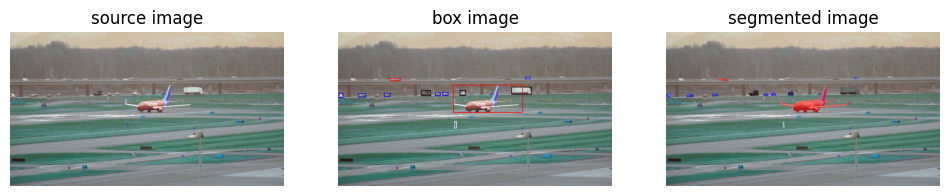


0: 384x640 1 person, 7 cars, 2 airplanes, 3 trucks, 29.1ms
Speed: 2.0ms preprocess, 29.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[811.7035, 256.7537, 904.5731, 292.3467],
        [537.3127, 247.1724, 864.6903, 377.7812],
        [490.0638, 282.6918, 514.7444, 297.8353],
        [215.6475, 286.4395, 244.0128, 301.7151],
        [386.8910, 273.2062, 433.6053, 299.9816],
        [453.9572, 284.5852, 479.1037, 298.3614],
        [544.6345, 419.8531, 554.1027, 448.1824],
        [ 96.6863, 288.2634, 130.3853, 305.0143],
        [  0.0000, 289.4214,  23.6415, 306.1504],
        [569.2074, 277.2789, 597.2422, 296.3800],
        [242.8791, 212.9020, 292.5081, 228.0034],
        [873.8553, 211.9703, 896.1594, 219.5483],
        [568.9547, 274.2421, 597.2562, 296.2591]], device='cuda:0')


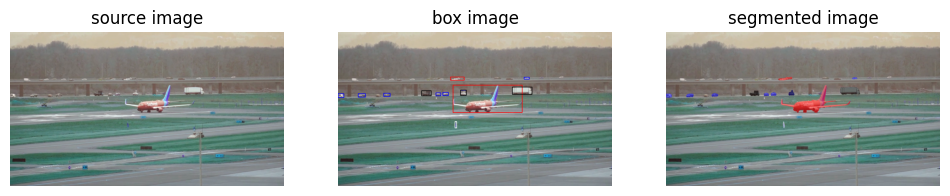


0: 384x640 1 person, 6 cars, 4 airplanes, 2 trucks, 31.8ms
Speed: 0.8ms preprocess, 31.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.3613e+02, 2.4696e+02, 8.6293e+02, 3.7796e+02],
        [8.1394e+02, 2.5669e+02, 9.0761e+02, 2.9290e+02],
        [4.9096e+02, 2.8316e+02, 5.1533e+02, 2.9787e+02],
        [3.8998e+02, 2.7335e+02, 4.3613e+02, 2.9950e+02],
        [2.1354e+02, 2.8629e+02, 2.4405e+02, 3.0249e+02],
        [5.4609e+02, 4.1980e+02, 5.5455e+02, 4.4761e+02],
        [2.9843e-01, 2.8799e+02, 2.8553e+01, 3.0630e+02],
        [9.5244e+01, 2.8857e+02, 1.2804e+02, 3.0473e+02],
        [8.6957e+02, 2.1168e+02, 8.9289e+02, 2.1941e+02],
        [5.2513e+02, 2.0976e+02, 5.8934e+02, 2.2546e+02],
        [4.5722e+02, 2.8460e+02, 4.8044e+02, 2.9874e+02],
        [5.7259e+02, 2.7383e+02, 5.9909e+02, 2.9609e+02],
        [5.7284e+02, 2.7222e+02, 5.9937e+02, 2.9592e+02]], device='cuda:0')


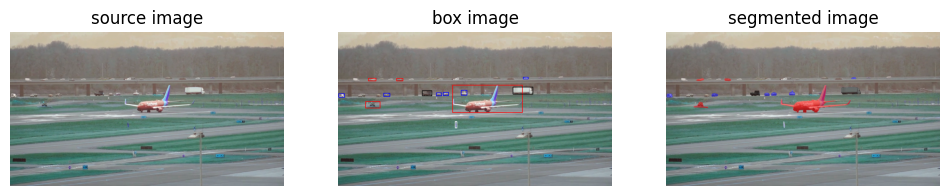


0: 384x640 1 person, 7 cars, 2 airplanes, 2 trucks, 29.8ms
Speed: 1.1ms preprocess, 29.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[535.2926, 246.4548, 864.3112, 377.4625],
        [818.2723, 256.6935, 910.8439, 292.1138],
        [492.0762, 282.3885, 516.8873, 297.4749],
        [213.2550, 286.6626, 243.0271, 302.2214],
        [459.4474, 283.7743, 483.2496, 298.6928],
        [273.1598, 210.3556, 303.9474, 228.0868],
        [  2.9255, 287.8997,  31.7031, 305.8172],
        [546.6241, 418.9191, 556.3500, 446.8661],
        [392.7833, 272.4191, 439.2388, 299.3114],
        [865.0188, 211.7159, 887.8818, 220.0720],
        [126.4475, 326.6244, 199.4695, 358.2075],
        [140.5572, 216.8505, 177.3432, 228.4510],
        [575.7651, 276.1576, 603.1249, 296.2003]], device='cuda:0')


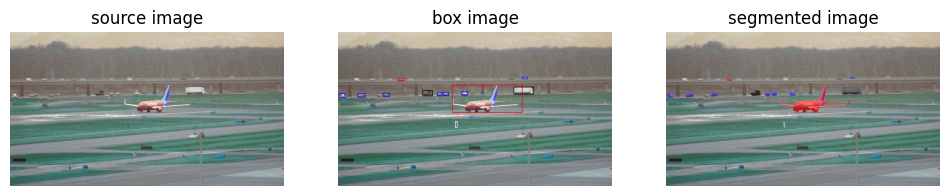


0: 384x640 1 person, 5 cars, 2 airplanes, 2 trucks, 29.9ms
Speed: 2.6ms preprocess, 29.9ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[533.9409, 246.3697, 862.4447, 377.2950],
        [820.4335, 256.3854, 915.0145, 292.2762],
        [492.8248, 281.8026, 517.6931, 296.8082],
        [  7.2890, 288.3878,  33.8666, 306.0143],
        [211.2209, 286.2294, 241.8088, 302.7424],
        [462.5011, 283.5862, 485.3594, 298.2631],
        [578.0772, 278.6941, 604.8383, 296.0240],
        [ 93.4968, 288.4855, 126.6908, 304.6296],
        [272.6010, 209.5103, 311.2830, 228.0022],
        [547.4637, 418.7185, 557.3419, 446.3763],
        [860.4371, 211.3108, 884.3535, 220.2793],
        [395.3221, 273.3202, 441.0081, 298.7733]], device='cuda:0')


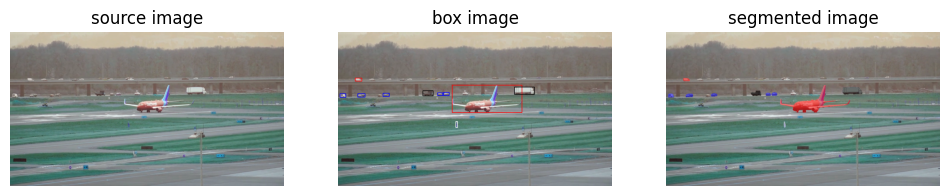


0: 384x640 1 person, 6 cars, 1 airplane, 2 trucks, 30.2ms
Speed: 0.6ms preprocess, 30.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[532.6224, 246.5513, 861.6195, 377.4009],
        [824.1744, 256.7570, 916.6947, 292.6915],
        [ 10.1162, 288.7040,  37.0496, 305.8663],
        [492.1114, 282.1371, 518.5587, 297.4226],
        [397.1066, 274.0203, 444.4437, 299.0378],
        [ 91.5144, 288.6031, 125.5683, 304.9149],
        [210.6021, 286.2290, 240.8294, 301.8572],
        [465.3922, 283.8664, 489.0463, 298.2916],
        [ 80.4379, 215.1649, 112.0623, 228.9215],
        [549.0925, 419.3107, 558.8247, 446.6140]], device='cuda:0')


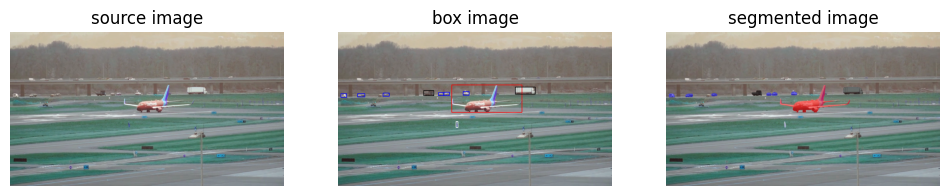


0: 384x640 1 person, 5 cars, 2 airplanes, 2 trucks, 30.2ms
Speed: 0.6ms preprocess, 30.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[531.0094, 245.9419, 862.4877, 377.0252],
        [827.6021, 256.5027, 920.9109, 291.6463],
        [ 13.9095, 289.2622,  40.4210, 305.8127],
        [493.5881, 281.9888, 520.3691, 297.0543],
        [400.3362, 272.7133, 447.7811, 298.4777],
        [211.5652, 285.7115, 240.7618, 301.2419],
        [468.8533, 283.2525, 493.1197, 298.3643],
        [ 91.5777, 288.4318, 125.2748, 304.5614],
        [550.2273, 418.6979, 560.7288, 446.3922],
        [584.7008, 278.1625, 612.5721, 295.9980]], device='cuda:0')


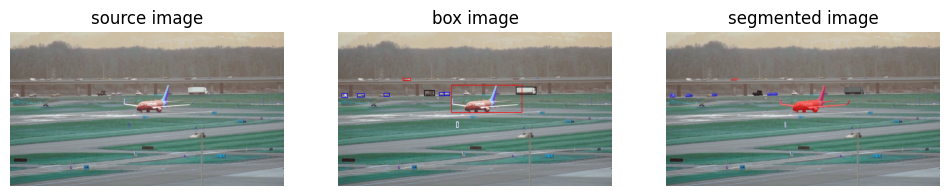


0: 384x640 1 person, 6 cars, 1 airplane, 2 trucks, 30.1ms
Speed: 0.6ms preprocess, 30.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[530.4065, 246.1914, 862.0901, 377.4495],
        [832.4534, 256.6557, 925.4440, 291.6434],
        [402.4546, 272.6540, 452.0992, 298.8433],
        [552.0366, 419.6082, 562.0129, 448.5368],
        [ 17.3109, 288.4640,  45.0216, 306.1466],
        [496.7539, 282.2770, 522.3357, 297.6439],
        [ 90.7225, 288.5237, 124.3020, 304.9870],
        [301.5902, 217.0328, 339.4462, 226.5340],
        [213.8780, 285.9623, 240.7268, 301.6014],
        [473.1313, 283.3843, 496.9982, 298.6584]], device='cuda:0')


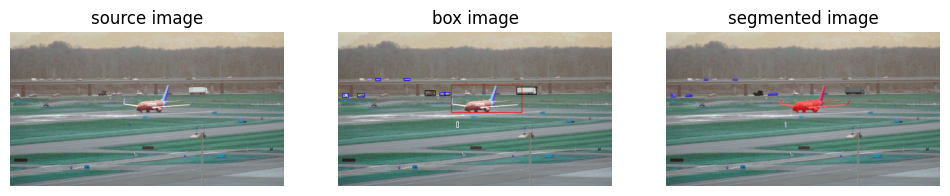


0: 384x640 1 person, 5 cars, 2 airplanes, 2 trucks, 29.9ms
Speed: 0.6ms preprocess, 29.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[529.5077, 246.0974, 861.8595, 377.5654],
        [836.3613, 256.8416, 928.6591, 291.7458],
        [403.9343, 273.2021, 455.5905, 299.2744],
        [554.1270, 419.7875, 563.2755, 447.7336],
        [ 19.8435, 288.1025,  48.9480, 306.7793],
        [498.9453, 282.6436, 524.0620, 297.9990],
        [ 89.8657, 288.3499, 124.1039, 305.1265],
        [307.6764, 217.0422, 336.4127, 226.9391],
        [475.6313, 283.5940, 500.8173, 298.6580],
        [174.9310, 217.3471, 201.0487, 228.5554]], device='cuda:0')


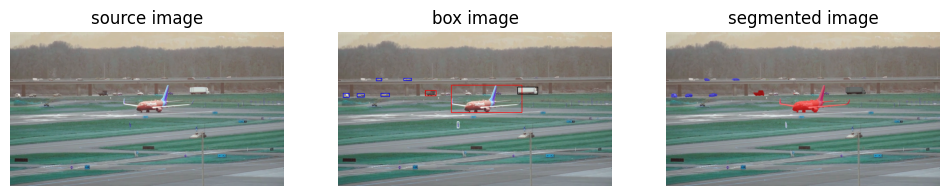


0: 384x640 1 person, 3 cars, 3 airplanes, 2 trucks, 29.2ms
Speed: 0.5ms preprocess, 29.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[530.0176, 245.5640, 862.1146, 377.3712],
        [839.8105, 256.4462, 933.3992, 290.9788],
        [178.0956, 216.5798, 203.0194, 228.7199],
        [199.9110, 285.2561, 240.3572, 303.0811],
        [ 24.1462, 287.9643,  52.3485, 306.5351],
        [306.9225, 216.0419, 343.9601, 226.3776],
        [556.2843, 419.3474, 565.9747, 446.6389],
        [ 89.5183, 287.1877, 123.5544, 304.8396],
        [404.3516, 272.5582, 458.1589, 298.4972],
        [403.4106, 272.4393, 457.8481, 298.8999]], device='cuda:0')


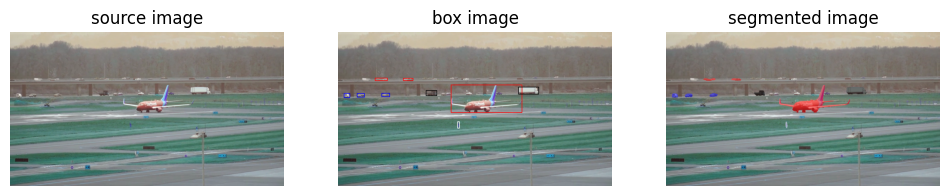


0: 384x640 1 person, 7 cars, 1 airplane, 2 trucks, 29.9ms
Speed: 0.6ms preprocess, 29.9ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[527.9684, 245.3405, 861.6381, 377.5614],
        [843.2382, 256.1588, 939.2773, 291.5569],
        [304.1031, 215.7309, 350.3622, 226.7639],
        [177.5971, 215.3547, 230.4830, 228.9635],
        [203.5758, 285.3044, 238.6032, 303.2108],
        [ 29.3006, 287.6688,  55.9340, 306.4047],
        [ 89.5315, 287.1854, 123.2797, 304.6333],
        [407.9277, 273.7507, 461.2872, 298.6885],
        [557.9144, 419.0802, 567.2220, 446.7713]], device='cuda:0')


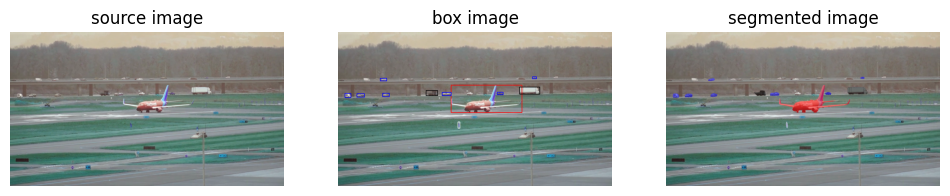


0: 384x640 1 person, 5 cars, 1 airplane, 2 trucks, 30.4ms
Speed: 0.6ms preprocess, 30.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[527.3643, 245.7502, 862.0040, 377.9333],
        [848.7671, 256.7687, 941.9651, 291.5655],
        [207.8778, 286.5270, 238.2151, 303.3075],
        [ 33.1338, 288.3370,  60.2225, 306.5186],
        [560.2311, 419.7226, 569.3080, 448.0179],
        [196.2469, 216.6332, 227.1450, 228.3766],
        [409.2074, 273.4327, 465.9367, 298.7472],
        [ 89.0401, 288.0055, 122.7646, 304.8297],
        [743.7150, 281.4568, 770.7374, 293.4263],
        [485.8460, 281.5869, 529.7778, 298.9397],
        [907.9490, 210.1810, 927.4169, 219.0283]], device='cuda:0')


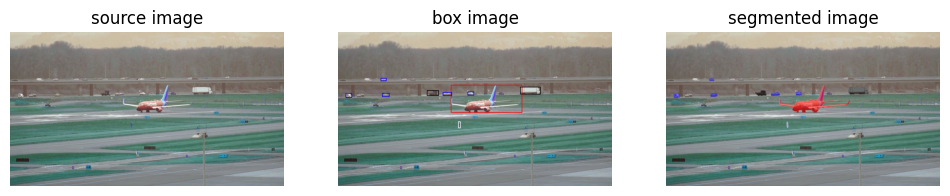


0: 384x640 1 person, 6 cars, 2 airplanes, 2 trucks, 30.0ms
Speed: 0.7ms preprocess, 30.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[527.1948, 245.9902, 862.1144, 377.7206],
        [852.2601, 256.2958, 945.7308, 291.6385],
        [207.8770, 286.2968, 238.3542, 303.2193],
        [562.7268, 420.0704, 571.4307, 447.2372],
        [ 36.7932, 288.2420,  64.2288, 306.3748],
        [200.8231, 216.6005, 225.7128, 228.6650],
        [416.7616, 273.8035, 470.9082, 298.4698],
        [606.3842, 279.6348, 633.6610, 295.7396],
        [490.6065, 281.9516, 531.7231, 298.4470]], device='cuda:0')


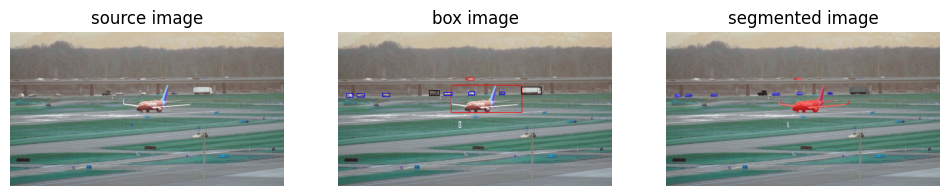


0: 384x640 1 person, 7 cars, 1 airplane, 3 trucks, 30.0ms
Speed: 0.6ms preprocess, 30.0ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[526.9366, 246.0353, 862.0944, 377.6460],
        [856.5846, 256.2667, 949.0914, 291.6589],
        [ 41.3679, 288.2310,  69.0622, 306.8797],
        [208.4134, 286.1644, 241.2990, 303.3733],
        [424.4584, 272.7592, 473.1296, 298.5611],
        [493.5952, 281.0320, 534.1553, 298.2150],
        [610.8958, 279.5734, 637.4067, 295.5235],
        [564.6423, 419.4943, 574.1011, 446.5005],
        [ 88.1277, 287.8078, 123.0793, 304.9203],
        [596.7183, 214.0929, 635.9897, 224.3862],
        [753.6382, 281.0105, 779.4730, 293.0680]], device='cuda:0')


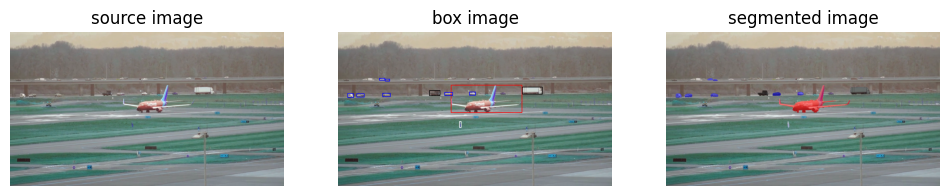


0: 384x640 4 cars, 1 airplane, 2 trucks, 32.0ms
Speed: 0.6ms preprocess, 32.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[526.6357, 246.2931, 862.3213, 378.1114],
        [861.2397, 256.1545, 954.7008, 292.3230],
        [ 46.0244, 288.0726,  72.3512, 306.6557],
        [208.5069, 286.8566, 243.3470, 303.1345],
        [566.3664, 420.1968, 576.2016, 447.2259],
        [497.1718, 281.9415, 536.2352, 298.8193],
        [497.4426, 281.9140, 536.3912, 298.7893],
        [421.9424, 273.9736, 477.1528, 297.6146],
        [614.8485, 279.7034, 641.9071, 295.8320],
        [219.5206, 220.3895, 241.2784, 229.1336],
        [ 88.3390, 288.0860, 122.9578, 305.3339],
        [194.2860, 216.4348, 218.8522, 227.4423]], device='cuda:0')


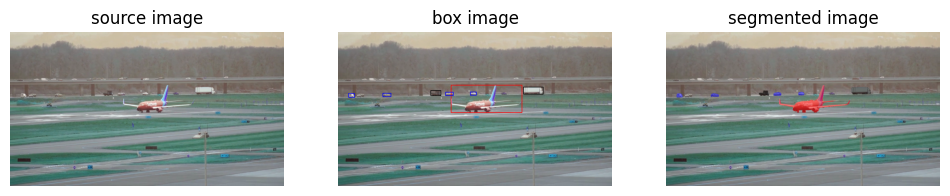


0: 384x640 3 cars, 1 airplane, 4 trucks, 29.1ms
Speed: 0.6ms preprocess, 29.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[526.4064, 246.3746, 862.5514, 378.1787],
        [866.0875, 256.2956, 958.7787, 291.7415],
        [209.0307, 286.5630, 247.5122, 303.2136],
        [619.1370, 280.3838, 645.4575, 295.5806],
        [501.6165, 281.0567, 538.5329, 298.4701],
        [432.1986, 274.1405, 480.2400, 298.1330],
        [ 49.2304, 287.5182,  77.2867, 307.1473]], device='cuda:0')


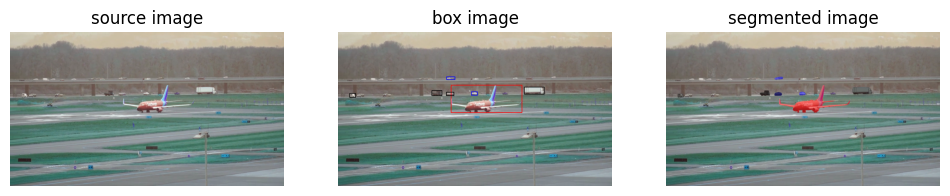


0: 384x640 4 cars, 1 airplane, 3 trucks, 30.4ms
Speed: 0.6ms preprocess, 30.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[526.6724, 246.4307, 862.9720, 378.0836],
        [870.8047, 256.3578, 962.3076, 291.0193],
        [623.9725, 279.7352, 650.4865, 295.8801],
        [438.6541, 273.5031, 486.9901, 298.3470],
        [ 54.4049, 287.2629,  81.7869, 306.7256],
        [506.8065, 281.7491, 541.3317, 298.3782],
        [506.6583, 281.5246, 541.3708, 298.4713],
        [506.7318, 209.1346, 545.8101, 222.3245]], device='cuda:0')


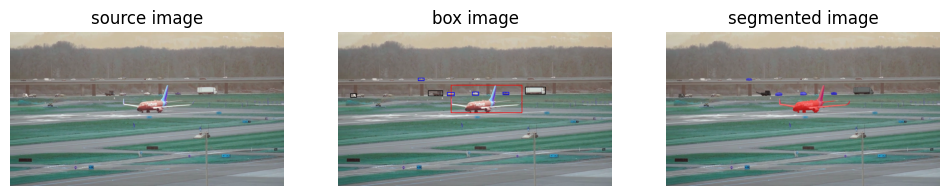


0: 384x640 1 person, 5 cars, 1 airplane, 4 trucks, 29.4ms
Speed: 0.6ms preprocess, 29.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[526.6339, 246.5107, 862.0436, 378.5803],
        [874.9297, 256.4381, 969.1880, 292.4743],
        [510.5446, 283.3123, 543.0512, 298.2799],
        [626.9780, 280.3728, 655.4509, 296.1323],
        [423.2419, 275.2781, 488.3260, 299.0753],
        [ 58.1281, 287.3673,  85.1737, 306.7919],
        [771.1263, 281.8925, 798.4994, 293.8362],
        [373.3068, 214.7859, 400.8522, 226.4639]], device='cuda:0')


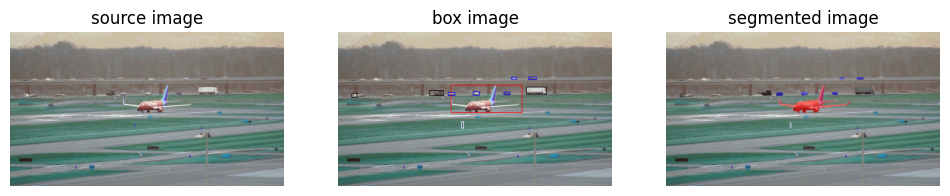


0: 384x640 1 person, 5 cars, 3 airplanes, 1 truck, 30.2ms
Speed: 0.7ms preprocess, 30.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[526.9004, 246.3300, 863.6028, 378.0974],
        [881.0966, 256.3452, 974.7577, 290.8238],
        [576.9865, 419.4363, 586.9320, 447.1319],
        [631.8846, 279.9135, 659.0714, 295.6630],
        [426.0058, 273.2435, 493.8441, 298.7482],
        [514.8220, 281.3724, 546.4644, 298.3641],
        [809.8715, 212.0048, 834.2539, 219.8146],
        [ 63.6900, 287.6768,  88.6129, 306.7173],
        [514.9243, 281.4515, 546.5126, 298.4725],
        [889.7680, 211.0678, 926.2593, 222.4791],
        [775.4616, 281.6084, 803.7132, 293.2154]], device='cuda:0')


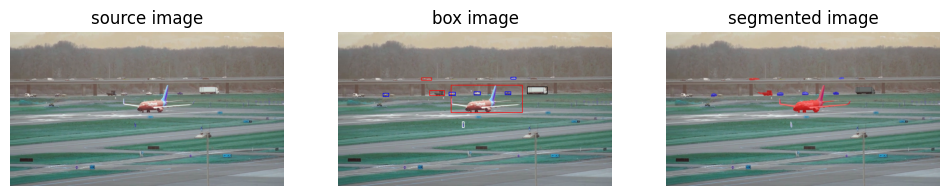


0: 384x640 4 cars, 4 airplanes, 1 truck, 30.5ms
Speed: 0.6ms preprocess, 30.5ms inference, 9.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[526.8896, 246.2057, 864.6821, 377.8540],
        [885.0398, 256.0156, 976.8196, 290.2409],
        [636.0450, 280.2880, 662.5652, 294.4091],
        [518.3311, 281.0157, 549.0278, 297.5508],
        [579.4819, 419.1771, 589.7671, 445.2451],
        [426.7369, 272.7517, 497.6938, 299.1975],
        [807.7855, 211.8713, 831.3923, 218.7430],
        [386.1845, 212.7509, 437.3962, 224.5894],
        [209.4887, 286.8542, 236.5029, 302.6312],
        [779.8721, 280.5937, 807.2983, 292.5414]], device='cuda:0')


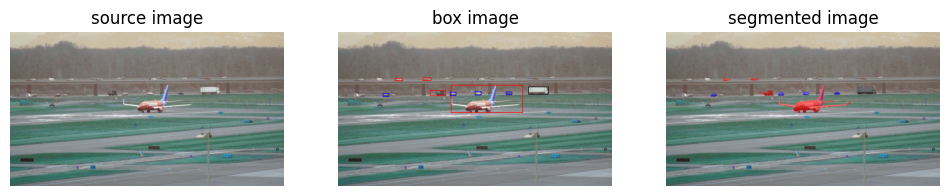


0: 384x640 1 person, 6 cars, 3 airplanes, 2 trucks, 30.9ms
Speed: 1.1ms preprocess, 30.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[527.7259, 246.3522, 865.0129, 378.0184],
        [890.6497, 256.0334, 981.9640, 290.5188],
        [429.7969, 272.7737, 503.6203, 299.2409],
        [523.9188, 281.0295, 552.0476, 298.4324],
        [210.5414, 287.1107, 238.0070, 302.8128],
        [640.9823, 280.0654, 667.7799, 295.2964],
        [265.5977, 215.7709, 301.4719, 228.3600],
        [785.7875, 281.1456, 812.1051, 293.3577],
        [395.6534, 213.2773, 434.5554, 225.6682]], device='cuda:0')


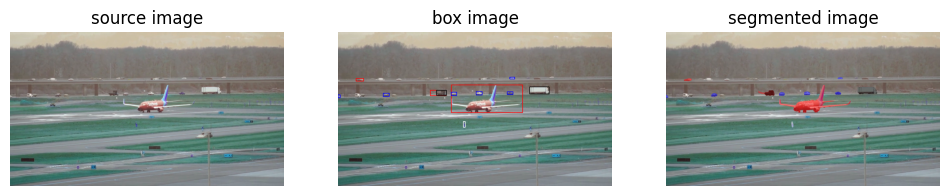


0: 384x640 1 person, 8 cars, 2 airplanes, 3 trucks, 29.5ms
Speed: 0.6ms preprocess, 29.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.2825e+02, 2.4593e+02, 8.6686e+02, 3.7776e+02],
        [8.9454e+02, 2.5592e+02, 9.8727e+02, 2.9014e+02],
        [2.1152e+02, 2.8573e+02, 2.3985e+02, 3.0245e+02],
        [5.2806e+02, 2.8114e+02, 5.5415e+02, 2.9803e+02],
        [5.8508e+02, 4.1826e+02, 5.9546e+02, 4.4491e+02],
        [4.3175e+02, 2.7260e+02, 5.0816e+02, 2.9900e+02],
        [8.0184e+02, 2.1173e+02, 8.2453e+02, 2.1936e+02],
        [8.3121e+01, 2.1680e+02, 1.2022e+02, 2.2837e+02],
        [6.4502e+02, 2.7896e+02, 6.7296e+02, 2.9461e+02],
        [7.8887e+02, 2.8072e+02, 8.1651e+02, 2.9247e+02],
        [4.6040e+02, 2.7252e+02, 5.0712e+02, 2.9825e+02],
        [1.6077e-02, 2.9427e+02, 1.0892e+01, 3.0712e+02]], device='cuda:0')


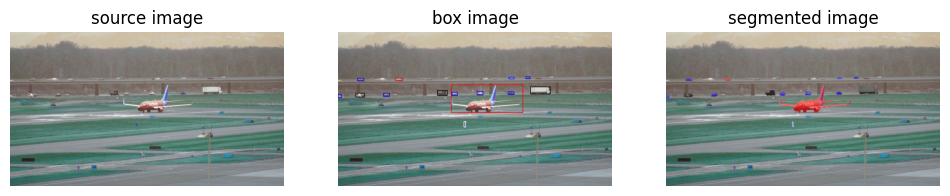


0: 384x640 7 cars, 1 airplane, 2 trucks, 33.8ms
Speed: 0.6ms preprocess, 33.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.2794e+02, 2.4604e+02, 8.6833e+02, 3.7753e+02],
        [8.9935e+02, 2.5530e+02, 9.9130e+02, 2.8980e+02],
        [5.3209e+02, 2.8139e+02, 5.5620e+02, 2.9756e+02],
        [2.1176e+02, 2.8574e+02, 2.4056e+02, 3.0234e+02],
        [9.1429e+01, 2.1691e+02, 1.1997e+02, 2.2815e+02],
        [7.9909e+02, 2.1189e+02, 8.2201e+02, 2.1930e+02],
        [8.7804e+02, 2.0967e+02, 8.9714e+02, 2.1802e+02],
        [6.4972e+02, 2.7858e+02, 6.7652e+02, 2.9424e+02],
        [7.9560e+02, 2.8072e+02, 8.2135e+02, 2.9199e+02],
        [1.4000e-02, 2.9308e+02, 1.5589e+01, 3.0737e+02],
        [5.8763e+02, 4.1853e+02, 5.9780e+02, 4.4495e+02],
        [4.6373e+02, 2.7263e+02, 5.1100e+02, 2.9810e+02],
        [2.6733e+02, 2.1531e+02, 3.0272e+02, 2.2726e+02],
        [8.2462e+01, 2.8637e+02, 1.2461e+02, 3.0521e+02]], device='cuda:0')


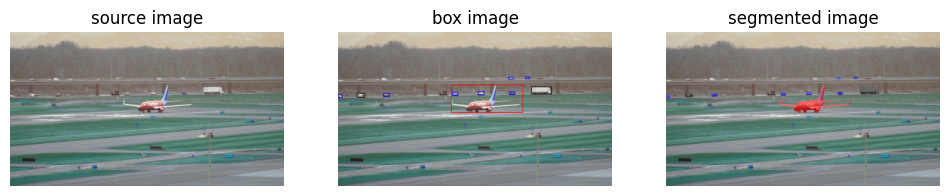


0: 384x640 1 person, 6 cars, 1 airplane, 3 trucks, 30.0ms
Speed: 0.6ms preprocess, 30.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[528.5177, 246.4825, 868.7382, 377.9407],
        [904.0210, 255.2543, 997.7079, 290.6623],
        [212.9744, 286.4672, 240.7691, 302.7501],
        [535.4924, 281.8521, 560.1436, 297.5031],
        [875.4735, 209.4816, 896.5858, 218.8971],
        [655.5075, 279.3583, 681.7441, 294.8054],
        [799.4302, 281.3354, 825.9619, 292.4884],
        [  0.0000, 293.2192,  20.4708, 307.7756],
        [795.7300, 211.6331, 819.0601, 219.4032],
        [ 87.7813, 286.8254, 124.6916, 305.5513]], device='cuda:0')


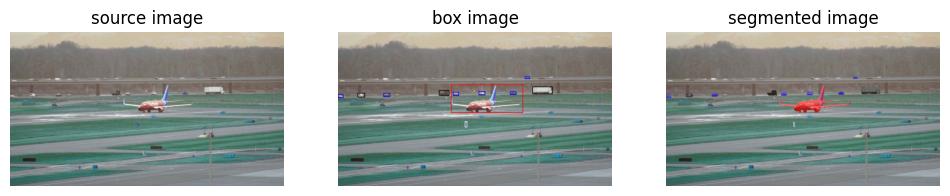


0: 384x640 1 person, 7 cars, 1 airplane, 2 trucks, 37.0ms
Speed: 0.6ms preprocess, 37.0ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 528.5313,  246.2372,  869.1448,  377.5207],
        [ 909.0736,  255.4616, 1002.9172,  290.1210],
        [ 538.0024,  281.5214,  564.3306,  297.1241],
        [ 213.5044,  286.1612,  242.4742,  302.6530],
        [ 473.3683,  272.6143,  520.1785,  297.5320],
        [ 658.5660,  278.3565,  686.9076,  294.3980],
        [ 805.0907,  280.9831,  831.4329,  291.9964],
        [ 872.9402,  209.3875,  895.7422,  219.3021],
        [   0.0000,  293.2198,   25.2959,  307.1649],
        [  92.3886,  286.7344,  124.9991,  305.3318],
        [ 592.7723,  418.8351,  602.6230,  445.1795]], device='cuda:0')


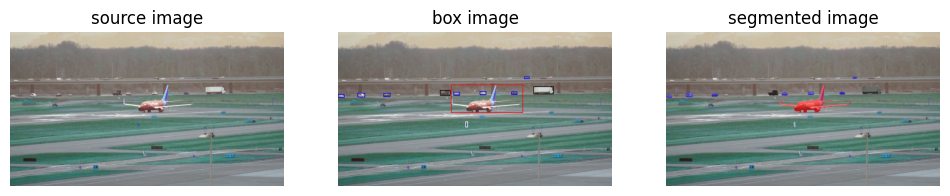


0: 384x640 1 person, 7 cars, 1 airplane, 2 trucks, 31.8ms
Speed: 0.6ms preprocess, 31.8ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 529.1174,  246.2571,  869.8042,  377.5058],
        [ 914.0713,  255.1194, 1007.1405,  289.7840],
        [ 539.9277,  281.2956,  568.3849,  297.0078],
        [ 476.4356,  272.1972,  525.0808,  297.4637],
        [ 663.6288,  278.5110,  690.6317,  294.1911],
        [   1.4579,  292.5627,   29.3558,  307.4285],
        [ 213.7397,  285.4390,  243.2919,  303.0278],
        [ 870.4360,  209.5666,  892.7515,  218.4963],
        [ 811.1367,  280.4692,  836.6193,  291.5989],
        [  92.2554,  286.2793,  126.4138,  305.0262],
        [ 595.7042,  419.0069,  605.4233,  444.9227]], device='cuda:0')


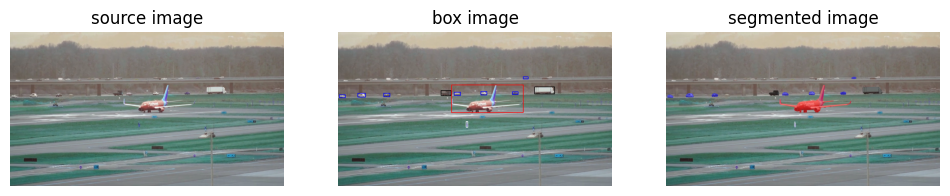


0: 384x640 4 cars, 3 airplanes, 3 trucks, 34.4ms
Speed: 0.7ms preprocess, 34.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 918.7646,  255.6624, 1011.4246,  289.9175],
        [ 529.6993,  246.5123,  869.8497,  377.7258],
        [ 480.1282,  273.1158,  528.0984,  298.3741],
        [ 543.1396,  281.6899,  572.0923,  297.6749],
        [ 814.9567,  280.7747,  840.4691,  292.2618],
        [ 668.0155,  279.3024,  695.1113,  294.4843],
        [ 213.7519,  286.4168,  242.6720,  303.2658],
        [  91.3204,  287.0252,  129.6066,  306.4346],
        [ 865.7000,  209.7189,  889.8318,  219.0577],
        [   4.3106,  292.7210,   36.7829,  307.7193],
        [ 597.9265,  418.9919,  607.2981,  444.8879]], device='cuda:0')


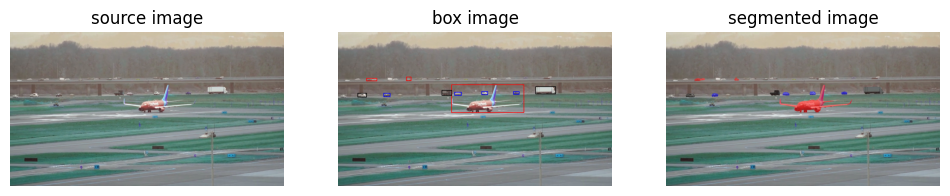


0: 384x640 7 cars, 2 airplanes, 3 trucks, 29.9ms
Speed: 0.6ms preprocess, 29.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 529.5378,  245.6208,  870.0840,  377.2278],
        [ 922.3464,  254.8499, 1017.4883,  290.0694],
        [ 213.9654,  285.8665,  244.0525,  303.0850],
        [ 672.1415,  278.4460,  699.2404,  294.4315],
        [ 819.9950,  280.0004,  846.0782,  291.3469],
        [ 545.3549,  281.7780,  577.7091,  297.1722],
        [  91.7150,  285.8423,  133.7667,  305.4461],
        [ 483.5618,  271.8331,  533.5138,  297.3953],
        [ 317.9929,  208.4406,  343.8193,  227.1322],
        [ 131.5799,  215.1261,  182.0499,  229.0722]], device='cuda:0')


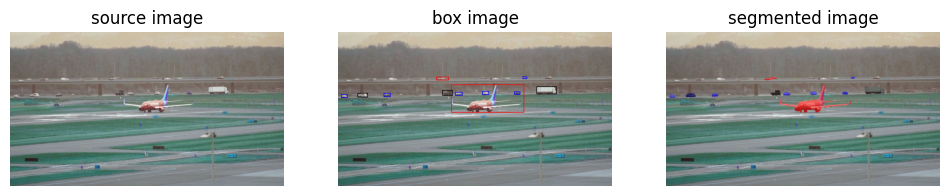


0: 384x640 8 cars, 2 airplanes, 2 trucks, 29.9ms
Speed: 0.6ms preprocess, 29.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 927.9086,  254.8074, 1021.0444,  289.7326],
        [ 530.0159,  245.2360,  870.6125,  377.2408],
        [ 823.9480,  280.4323,  849.4487,  291.3577],
        [ 213.9285,  285.9060,  244.6284,  303.1798],
        [ 547.8206,  281.6957,  580.7327,  296.8748],
        [ 488.0084,  272.3436,  536.4215,  296.7608],
        [ 676.2692,  277.6275,  704.3376,  293.5704],
        [  15.1101,  292.2474,   44.3229,  307.2131],
        [ 457.6419,  210.5140,  504.3897,  224.4088],
        [  92.2674,  286.2905,  137.9510,  304.9260],
        [  92.1199,  286.4969,  137.7355,  304.9286],
        [ 863.8712,  210.1690,  882.6239,  218.6645]], device='cuda:0')


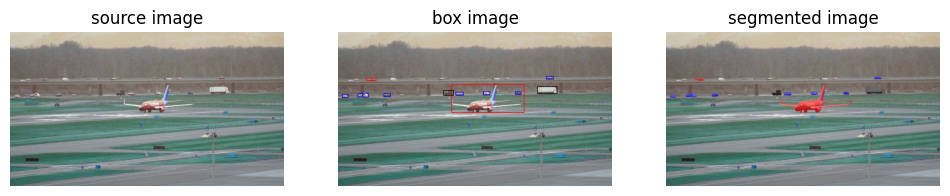


0: 384x640 1 person, 8 cars, 1 airplane, 2 trucks, 29.3ms
Speed: 0.6ms preprocess, 29.3ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 530.3875,  246.0099,  871.6645,  377.2936],
        [ 932.7047,  255.1891, 1024.0861,  289.7398],
        [ 828.5034,  280.3806,  854.3418,  291.4210],
        [  21.1973,  292.1870,   48.3240,  307.0081],
        [ 681.1805,  278.1350,  708.0690,  293.7535],
        [ 214.5758,  286.5510,  245.2565,  303.0211],
        [ 550.0088,  281.3957,  585.5537,  297.1525],
        [ 974.3920,  208.8374, 1006.0351,  220.3838],
        [ 113.4414,  287.2019,  141.6406,  304.3207],
        [ 133.3300,  215.6648,  177.7372,  228.8564],
        [ 491.9976,  272.7145,  540.5915,  297.3444],
        [  92.8542,  288.6429,  115.2771,  304.4890]], device='cuda:0')


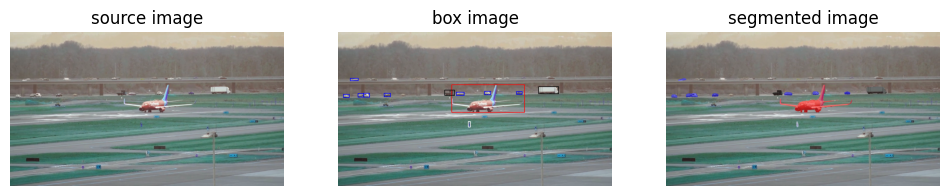


0: 384x640 1 person, 7 cars, 2 airplanes, 1 truck, 30.5ms
Speed: 0.6ms preprocess, 30.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 530.4418,  246.1049,  872.5277,  376.7527],
        [ 937.3054,  254.5333, 1030.1079,  289.4797],
        [ 833.8240,  280.0543,  859.5463,  290.8556],
        [ 215.3702,  285.8461,  245.6844,  302.8025],
        [  25.2551,  291.3418,   53.0843,  306.5021],
        [ 685.1403,  276.9218,  713.5184,  293.3804],
        [ 496.4592,  271.8430,  543.4752,  296.4359],
        [ 119.8577,  286.0494,  147.2982,  304.3098],
        [ 552.3588,  281.3192,  589.9764,  297.0752],
        [  93.0273,  288.0551,  121.2771,  304.6683],
        [  61.0846,  216.5860,   94.8746,  226.0409],
        [ 608.1093,  418.5392,  618.2191,  443.8328]], device='cuda:0')


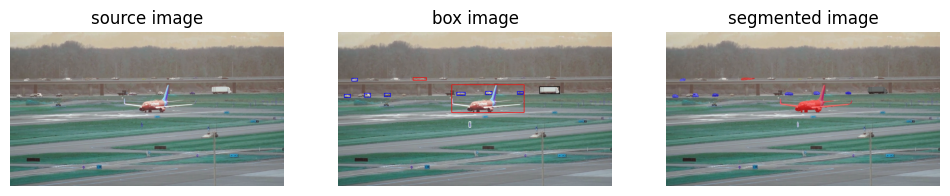


0: 384x640 1 person, 4 cars, 1 airplane, 4 trucks, 30.1ms
Speed: 0.6ms preprocess, 30.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 530.4384,  246.0380,  874.2184,  377.3251],
        [ 942.1492,  254.5419, 1035.6246,  289.1288],
        [ 838.0265,  280.1512,  864.5670,  290.7572],
        [ 216.1383,  286.1007,  246.1369,  302.7734],
        [ 351.1713,  212.0487,  414.9373,  225.3147],
        [ 610.8143,  418.4258,  620.6180,  444.5853],
        [  29.7502,  291.0957,   58.0556,  306.6700],
        [  64.2372,  216.1000,   92.2287,  228.2371],
        [ 689.5779,  277.2093,  718.9158,  293.2160],
        [ 124.6225,  286.1926,  152.6294,  304.3934],
        [ 554.6541,  281.1979,  594.5063,  297.0400]], device='cuda:0')


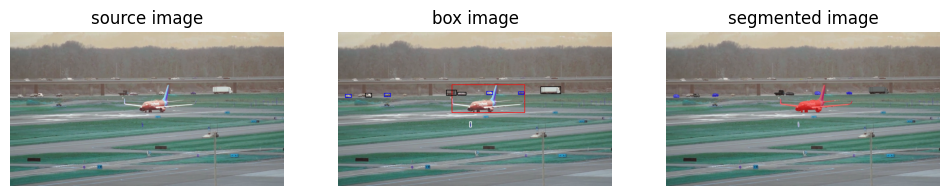


0: 384x640 1 person, 7 cars, 1 airplane, 4 trucks, 29.1ms
Speed: 0.6ms preprocess, 29.1ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 528.8431,  246.0131,  875.1681,  377.2878],
        [ 946.5829,  254.4078, 1041.2643,  289.2169],
        [ 216.0040,  285.9176,  246.4836,  302.8640],
        [ 842.2920,  279.5759,  869.8079,  290.9910],
        [ 503.0312,  271.3482,  552.8782,  296.9139],
        [ 694.4784,  276.3375,  722.2494,  293.0197],
        [  34.1282,  291.3279,   63.1889,  307.1131],
        [ 558.3329,  282.6016,  598.3155,  296.8931],
        [ 129.1467,  285.9947,  156.9389,  304.8544],
        [ 613.8157,  418.4438,  622.8561,  444.3941]], device='cuda:0')


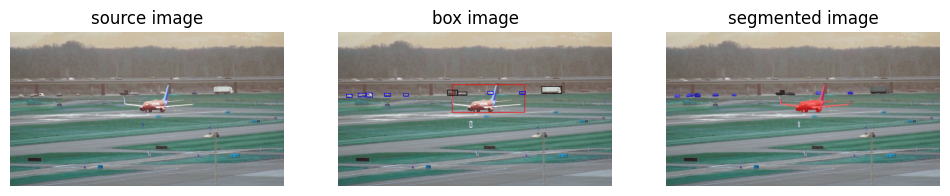


0: 384x640 1 person, 6 cars, 2 airplanes, 4 trucks, 28.9ms
Speed: 1.0ms preprocess, 28.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 531.5486,  245.0147,  875.4066,  376.9174],
        [ 952.0552,  253.8743, 1045.0151,  289.3412],
        [ 217.0802,  285.7321,  246.7141,  302.4012],
        [  39.3812,  290.9002,   67.6689,  306.7930],
        [ 511.2527,  270.4899,  556.9666,  296.4554],
        [ 698.9745,  276.4119,  724.6320,  291.7965],
        [ 616.5019,  417.4678,  626.3106,  444.7612],
        [  94.6828,  286.4279,  128.9352,  304.1420],
        [ 307.4983,  287.4371,  328.8657,  300.0284],
        [ 846.9395,  279.4590,  874.6807,  290.9816],
        [ 134.4128,  285.3633,  161.7076,  304.0583],
        [ 134.1244,  285.4538,  161.7077,  304.2479],
        [ 558.7072,  281.3267,  602.7355,  296.4397]], device='cuda:0')


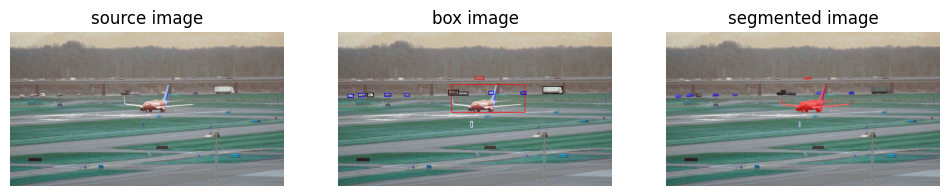


0: 384x640 1 person, 7 cars, 3 airplanes, 3 trucks, 29.6ms
Speed: 0.6ms preprocess, 29.6ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 532.0365,  243.8521,  876.3641,  377.2435],
        [ 956.5240,  253.6231, 1050.6228,  289.1567],
        [ 854.0519,  279.9368,  878.3922,  290.5256],
        [ 217.7194,  285.4090,  248.3993,  302.6867],
        [ 703.6852,  276.6449,  727.3559,  292.5567],
        [  43.8593,  290.7565,   73.1543,  307.2322],
        [ 311.3997,  287.3484,  333.6754,  300.3884],
        [ 619.4385,  418.1020,  628.7252,  444.2462],
        [ 638.6881,  208.6696,  683.0956,  221.3675],
        [  94.9101,  286.5377,  130.2225,  304.1301],
        [ 137.9957,  285.5076,  166.6365,  303.9664],
        [ 515.1667,  272.1030,  562.0156,  296.6749],
        [ 562.9999,  280.8849,  607.2213,  297.1292]], device='cuda:0')


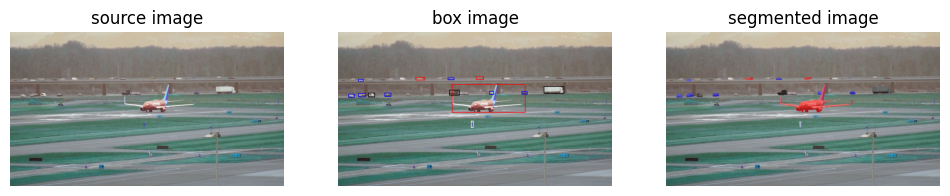


0: 384x640 1 person, 5 cars, 1 airplane, 4 trucks, 29.9ms
Speed: 0.6ms preprocess, 29.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 533.7265,  244.2872,  878.1501,  376.9155],
        [ 961.5978,  253.3874, 1055.3802,  289.0746],
        [ 218.2529,  285.5109,  248.7581,  302.5069],
        [  48.1808,  290.6740,   77.7621,  307.0560],
        [ 858.0706,  279.2601,  884.3880,  290.3020],
        [ 708.5951,  276.5413,  728.5817,  291.5138],
        [ 142.7623,  285.2736,  171.6257,  304.0961],
        [ 511.9350,  213.9544,  542.9973,  223.1634],
        [ 519.4359,  271.3635,  567.8671,  296.2105],
        [ 622.1866,  416.8101,  631.4042,  444.9265],
        [ 644.7495,  208.9011,  681.1251,  221.2001],
        [ 360.9109,  211.5384,  408.3488,  225.1891],
        [  94.8766,  285.6970,  130.5436,  304.3808],
        [  94.9399,  219.9065,  119.8841,  228.8834]], device='cuda:0')


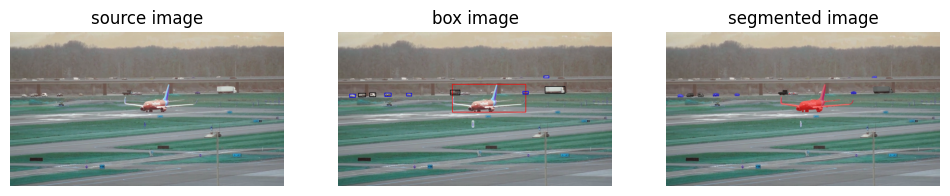


0: 384x640 1 person, 6 cars, 1 airplane, 1 truck, 30.4ms
Speed: 0.6ms preprocess, 30.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 534.0767,  243.6923,  878.3694,  375.9412],
        [ 966.4233,  253.2567, 1060.2968,  288.3044],
        [ 218.4736,  285.1816,  249.0403,  302.1876],
        [ 864.3688,  278.6843,  888.6991,  290.1238],
        [  53.7335,  290.0237,   81.2842,  305.1738],
        [ 625.2664,  417.2485,  634.3604,  443.0182],
        [ 147.0942,  284.3554,  176.0806,  302.5508],
        [ 321.0895,  287.1100,  344.7084,  300.2349],
        [ 962.5193,  205.9965,  984.4128,  213.2100],
        [  94.4470,  284.9369,  130.5117,  303.9588],
        [ 523.6687,  271.2883,  570.0857,  295.9478]], device='cuda:0')


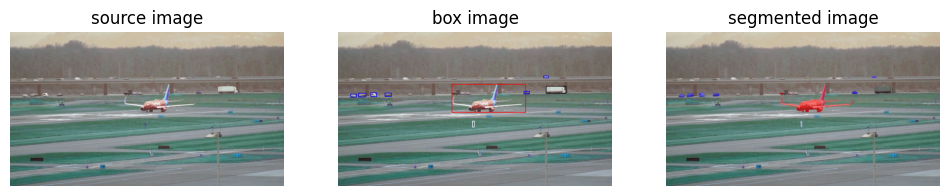


0: 384x640 1 person, 7 cars, 3 airplanes, 2 trucks, 35.7ms
Speed: 0.6ms preprocess, 35.7ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 535.2479,  243.4069,  879.0045,  376.0988],
        [ 971.7906,  252.8890, 1065.3014,  288.1907],
        [ 218.5334,  285.1148,  249.8309,  302.3961],
        [ 960.8585,  205.7000,  981.8851,  212.7869],
        [ 868.6688,  278.1130,  894.4135,  289.2355],
        [ 627.6757,  416.5829,  637.1121,  443.8130],
        [  58.8897,  290.5677,   86.6218,  304.6475],
        [ 153.0064,  284.3437,  180.8523,  303.0951],
        [  95.6968,  285.4985,  131.1899,  303.6688]], device='cuda:0')


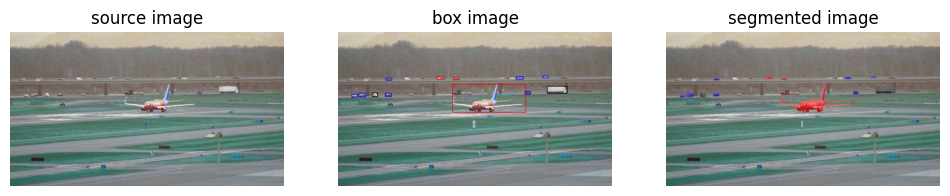


0: 384x640 6 cars, 2 airplanes, 2 trucks, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 536.2743,  243.6491,  879.6100,  376.2578],
        [ 976.5009,  252.5825, 1069.9976,  288.1998],
        [ 219.2848,  285.1369,  249.9247,  302.2265],
        [  62.9897,  291.0225,   92.3371,  305.2634],
        [ 630.2943,  416.4811,  639.7226,  443.9475],
        [ 538.1473,  214.1887,  566.1315,  222.4339],
        [ 873.9046,  277.8029,  899.0797,  289.6943],
        [  96.1548,  285.4601,  132.1076,  303.6944],
        [ 159.4143,  285.1391,  186.0595,  302.8175],
        [ 958.7253,  205.6497,  980.5969,  213.2918],
        [ 830.6951,  207.7502,  865.4669,  220.1164],
        [ 459.8161,  208.2031,  495.4050,  220.4012],
        [ 223.2540,  216.0743,  250.7343,  225.6471]], device='cuda:0')


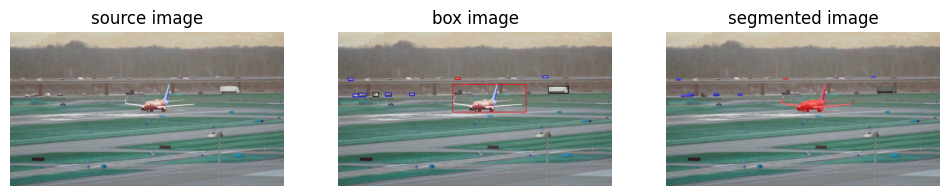


0: 384x640 3 cars, 3 airplanes, 2 trucks, 29.6ms
Speed: 0.7ms preprocess, 29.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 536.7858,  243.2867,  882.1704,  375.7728],
        [ 982.5721,  252.5771, 1075.9265,  287.5424],
        [ 220.3144,  284.1338,  250.8308,  301.0576],
        [ 163.3288,  283.9826,  189.7271,  301.7793],
        [  68.9851,  290.1620,   98.3975,  304.7525],
        [ 546.2859,  213.8148,  574.5664,  221.9429],
        [ 958.6031,  205.5531,  979.9999,  213.4862],
        [  96.9065,  285.6287,  133.1891,  303.4604],
        [ 334.7864,  285.8137,  358.4921,  299.8699],
        [  46.3265,  215.7357,   70.8551,  225.7822]], device='cuda:0')


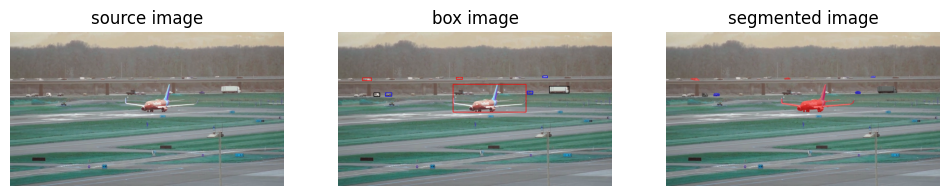


0: 384x640 1 person, 5 cars, 2 airplanes, 2 trucks, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 538.5450,  243.3670,  882.6532,  375.5295],
        [ 986.8976,  251.2570, 1079.7281,  287.4200],
        [ 957.2610,  205.8743,  978.4865,  212.9530],
        [ 552.3499,  211.2235,  581.3354,  221.3672],
        [ 221.4495,  284.1361,  251.9429,  300.8181],
        [ 167.6855,  283.3324,  194.7329,  302.4595],
        [ 111.9746,  213.7167,  159.2240,  227.1398],
        [ 883.6490,  276.3323,  910.2895,  288.8447]], device='cuda:0')


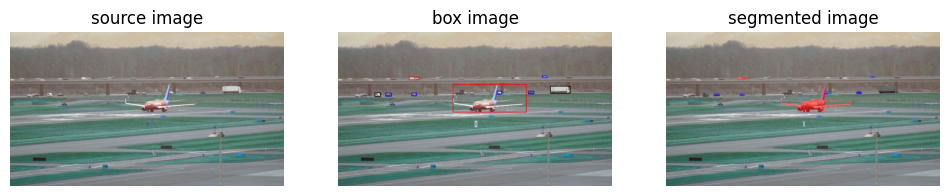


0: 384x640 1 person, 4 cars, 3 airplanes, 2 trucks, 30.0ms
Speed: 0.6ms preprocess, 30.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 536.6395,  243.5901,  883.9115,  375.4452],
        [ 992.9647,  252.3112, 1085.4525,  287.2772],
        [ 888.1541,  277.2045,  914.6213,  288.8566],
        [ 172.9475,  283.8613,  200.0184,  302.0923],
        [ 954.7225,  205.5653,  976.0414,  212.8359],
        [ 221.9261,  284.8349,  252.1138,  301.0178],
        [ 639.0139,  416.2601,  649.1971,  441.8838],
        [ 743.4254,  274.9542,  764.1745,  290.3701],
        [ 344.9542,  286.3500,  367.2972,  299.3201],
        [ 331.8146,  209.8729,  380.3764,  223.4669]], device='cuda:0')


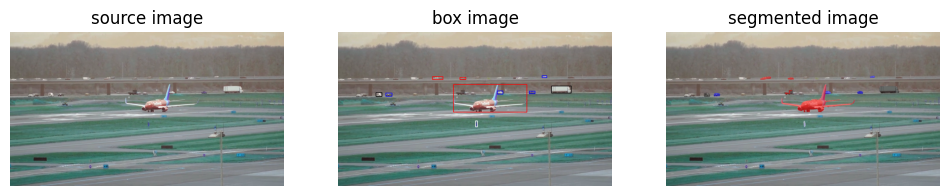


0: 384x640 1 person, 8 cars, 1 airplane, 2 trucks, 29.6ms
Speed: 0.7ms preprocess, 29.6ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 539.4839,  242.8285,  884.8924,  375.1277],
        [ 996.8646,  251.2421, 1091.1116,  286.9548],
        [ 744.9080,  274.7925,  770.6082,  289.8563],
        [ 222.9674,  284.4788,  252.9137,  300.9109],
        [ 642.1801,  416.4200,  651.9952,  441.9503],
        [ 569.7786,  211.7348,  597.1450,  221.3990],
        [ 177.6306,  283.5280,  205.2145,  302.3014],
        [ 952.4673,  205.4076,  974.9871,  212.8169],
        [ 893.9102,  276.6358,  919.9370,  288.5191],
        [ 440.1641,  207.7610,  490.6002,  222.9847]], device='cuda:0')


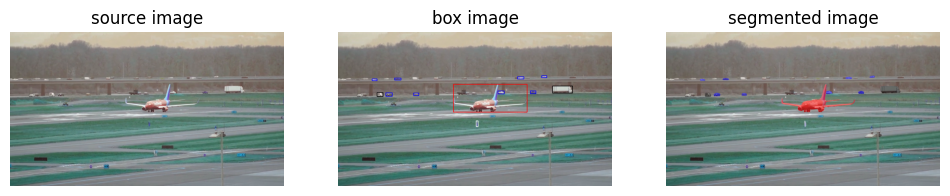


0: 384x640 1 person, 4 cars, 4 airplanes, 2 trucks, 30.4ms
Speed: 0.6ms preprocess, 30.4ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 540.1812,  241.8099,  886.5574,  374.8137],
        [1002.0267,  251.1350, 1096.0334,  287.2154],
        [ 897.8284,  276.5381,  924.2256,  288.3157],
        [ 223.2805,  284.1379,  253.3187,  300.5436],
        [ 354.3781,  285.5639,  377.5744,  298.0137],
        [ 182.8379,  283.2704,  209.9700,  302.0394],
        [ 159.1174,  217.7930,  182.7039,  227.0398],
        [ 746.7899,  274.5214,  776.2755,  289.4158],
        [ 645.4880,  415.8748,  655.1409,  441.3102],
        [ 265.3932,  214.8429,  293.9012,  223.7926],
        [ 840.9432,  209.7204,  867.6263,  219.4791],
        [ 951.5458,  205.1413,  975.1339,  212.9529]], device='cuda:0')


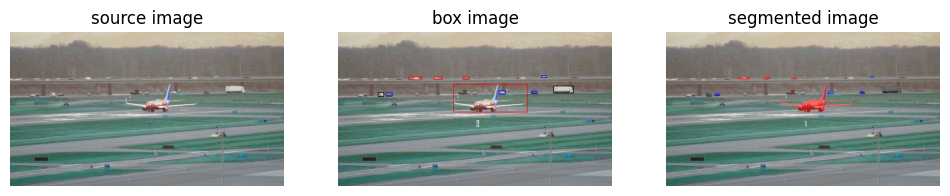


0: 384x640 7 cars, 1 airplane, 2 trucks, 63.4ms
Speed: 0.6ms preprocess, 63.4ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 538.8945,  242.4308,  888.3923,  375.0255],
        [1006.5837,  251.0919, 1101.5222,  287.2003],
        [ 749.7968,  275.2615,  781.7996,  289.7778],
        [ 187.2386,  283.2123,  213.7907,  301.8480],
        [ 903.0271,  276.0566,  929.6970,  288.5394],
        [ 648.1123,  416.1412,  658.1602,  442.1691],
        [ 224.0349,  284.2110,  254.1369,  300.9895],
        [ 334.2002,  209.8747,  391.3303,  223.3054],
        [ 583.7582,  211.1591,  613.2760,  221.4930],
        [ 949.8054,  204.8228,  973.7222,  213.2116],
        [ 448.2260,  208.2226,  488.0389,  221.8770]], device='cuda:0')


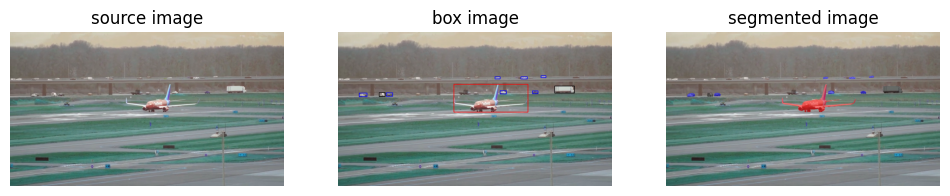


0: 384x640 5 cars, 1 airplane, 2 trucks, 31.2ms
Speed: 0.6ms preprocess, 31.2ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 541.0345,  242.3914,  889.2904,  374.6465],
        [1012.2013,  251.1081, 1105.5587,  286.8848],
        [  99.4058,  286.1767,  136.8768,  302.9658],
        [ 949.1150,  205.4349,  970.3804,  212.7136],
        [ 192.3996,  283.1343,  219.5814,  301.7032],
        [ 757.6490,  275.3677,  785.1034,  289.5475],
        [ 225.0947,  284.0686,  255.4369,  300.6746],
        [ 856.6530,  209.8004,  884.9594,  219.5331],
        [ 733.2085,  210.4043,  756.8142,  219.5669],
        [ 908.7222,  275.4074,  934.7510,  288.8375]], device='cuda:0')


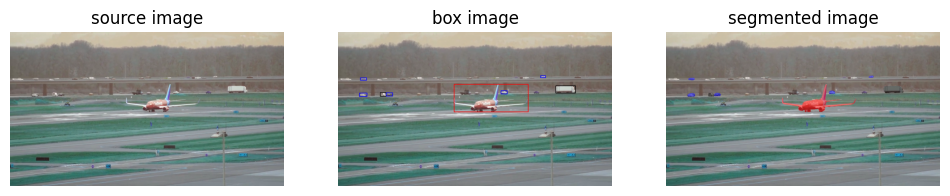


0: 384x640 1 person, 6 cars, 1 airplane, 3 trucks, 30.5ms
Speed: 0.6ms preprocess, 30.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 541.4282,  242.3958,  891.2368,  374.5182],
        [1017.0874,  250.9058, 1110.6023,  286.7587],
        [ 762.2442,  274.9033,  789.5768,  288.0366],
        [ 100.9297,  286.3689,  136.6702,  302.3733],
        [ 197.5297,  283.1697,  223.1618,  301.4783],
        [ 947.2053,  205.1001,  968.9419,  213.1055],
        [ 224.2858,  284.0862,  255.1400,  300.7245],
        [ 103.8263,  212.6952,  134.1748,  224.4839]], device='cuda:0')


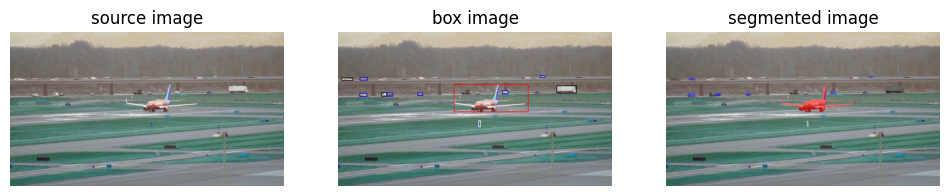


0: 384x640 1 person, 3 cars, 2 airplanes, 1 truck, 29.3ms
Speed: 0.6ms preprocess, 29.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 541.7441,  241.8129,  891.6084,  374.5610],
        [1021.9472,  251.2157, 1114.9600,  286.4846],
        [ 767.8333,  275.2323,  794.8818,  288.0231],
        [ 102.2393,  286.3034,  136.5259,  301.9101],
        [ 656.9937,  415.2791,  666.1069,  441.1222],
        [ 946.1414,  205.3212,  967.1807,  213.1257],
        [ 201.7621,  283.1738,  226.8144,  301.5297],
        [ 225.1786,  283.8659,  255.8422,  301.0156],
        [ 101.6935,  212.9274,  137.5883,  224.4703],
        [ 372.2639,  284.6486,  396.1244,  297.9754],
        [  19.1688,  214.2153,   70.0570,  225.8807]], device='cuda:0')


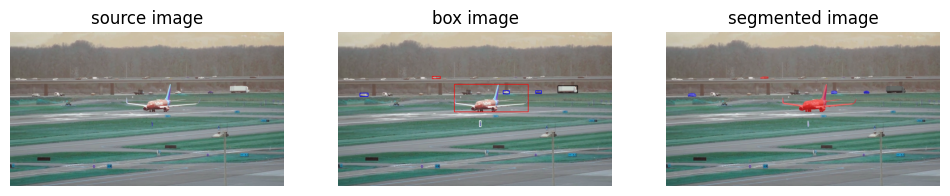


0: 384x640 1 person, 4 cars, 1 airplane, 3 trucks, 38.2ms
Speed: 0.6ms preprocess, 38.2ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 543.5033,  241.5198,  893.0773,  374.2313],
        [1026.6812,  250.6935, 1119.9185,  286.3123],
        [ 102.4075,  285.5582,  141.4831,  302.5129],
        [ 770.8710,  274.1323,  799.5448,  287.8923],
        [ 923.0515,  275.1355,  950.2468,  288.0712],
        [ 439.1572,  207.0628,  479.7068,  219.0296],
        [ 660.0789,  414.5375,  668.5894,  440.8515]], device='cuda:0')


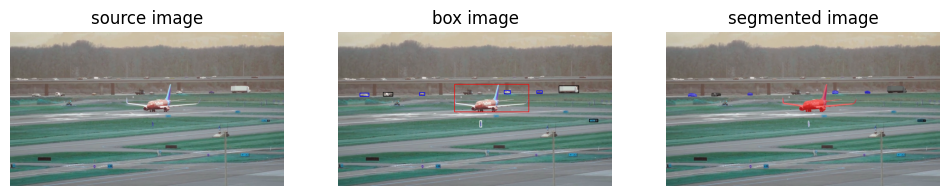


0: 384x640 5 cars, 2 airplanes, 3 trucks, 35.6ms
Speed: 0.6ms preprocess, 35.6ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 543.0354,  241.9395,  893.9434,  373.9947],
        [1032.1219,  250.6926, 1125.6918,  285.9750],
        [ 103.1279,  285.8068,  143.9829,  301.7722],
        [ 380.7582,  283.6265,  403.7738,  296.9919],
        [ 927.9812,  275.5531,  954.4141,  288.0357],
        [ 211.7814,  282.5605,  255.7795,  300.7491],
        [ 776.3226,  273.6889,  804.0077,  288.0154],
        [1173.0447,  406.6129, 1214.9800,  420.9145],
        [ 662.1437,  414.5901,  671.1879,  440.8330]], device='cuda:0')


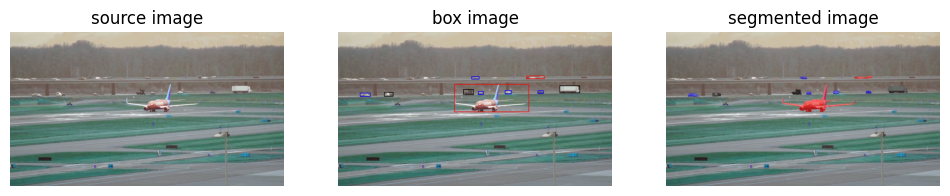


0: 384x640 2 cars, 3 airplanes, 2 trucks, 31.1ms
Speed: 0.5ms preprocess, 31.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 543.2543,  242.9136,  895.0485,  374.0827],
        [1036.6443,  250.9987, 1129.6428,  286.4807],
        [ 104.1087,  285.8251,  149.7553,  302.2527],
        [ 782.2910,  274.4255,  807.6575,  287.5792],
        [ 889.2473,  205.1691,  962.4658,  218.0905],
        [ 215.7799,  281.6549,  257.3835,  301.6343],
        [ 933.4800,  275.2835,  959.4480,  287.9529],
        [ 625.3901,  208.3304,  660.1912,  220.1789],
        [ 656.0411,  279.4008,  679.1608,  293.0797],
        [ 585.4087,  269.1896,  633.7324,  294.5958]], device='cuda:0')


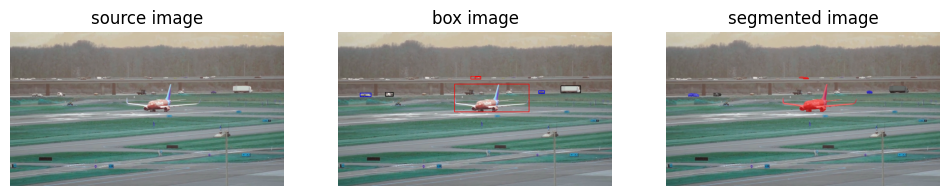


0: 384x640 5 cars, 3 airplanes, 2 trucks, 35.5ms
Speed: 0.6ms preprocess, 35.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 543.5248,  242.3533,  895.3158,  374.0966],
        [1041.3328,  250.2097, 1134.8020,  286.0438],
        [ 104.2449,  286.0234,  151.9390,  302.0990],
        [ 221.2560,  282.6661,  258.2502,  300.7579],
        [ 936.3756,  275.0111,  964.4288,  287.8371],
        [ 639.0343,  209.3432,  667.5129,  219.6165],
        [ 620.8115,  207.7520,  666.6680,  219.5310]], device='cuda:0')


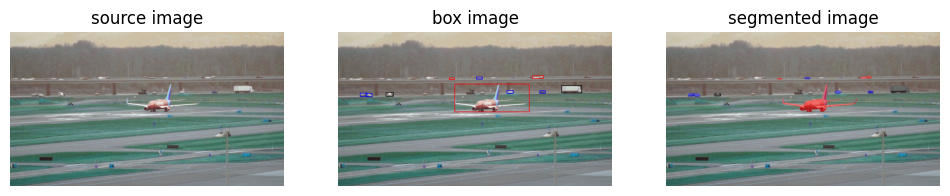


0: 384x640 1 person, 8 cars, 1 airplane, 1 truck, 29.3ms
Speed: 0.6ms preprocess, 29.3ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 544.3064,  241.9640,  897.2821,  374.0038],
        [1045.6943,  249.9446, 1139.4827,  285.4733],
        [ 104.2647,  286.2422,  135.2192,  302.0329],
        [ 645.6345,  209.8849,  674.8327,  220.1007],
        [ 942.6307,  275.1861,  967.9054,  287.2421],
        [ 224.3618,  281.3352,  258.2098,  301.1127],
        [ 131.8284,  286.9947,  159.6715,  301.6855],
        [ 790.1384,  273.9411,  818.2508,  288.1100],
        [ 909.0642,  204.4879,  959.7865,  217.8631],
        [ 520.4264,  213.6355,  544.1948,  221.2107]], device='cuda:0')


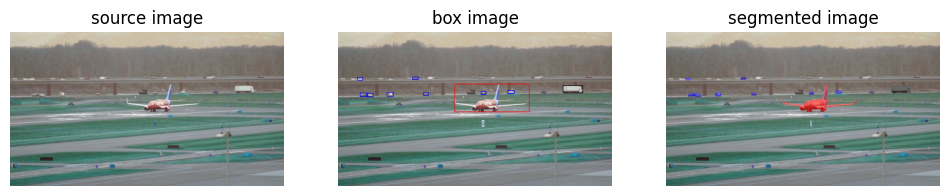


0: 384x640 1 person, 5 cars, 2 airplanes, 2 trucks, 29.9ms
Speed: 0.6ms preprocess, 29.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 545.2758,  241.8748,  896.1276,  374.3849],
        [1050.0872,  250.1530, 1144.2239,  285.7684],
        [ 672.5148,  413.6161,  681.9326,  441.0468],
        [ 103.5894,  285.2030,  138.6594,  302.3723],
        [ 229.8111,  282.3613,  257.5668,  300.6464],
        [ 134.9791,  287.0918,  164.0643,  302.1254],
        [ 668.1022,  278.9359,  690.9293,  292.4012],
        [ 794.0610,  273.4160,  822.4827,  288.0592],
        [ 398.6183,  283.6803,  422.3730,  296.7097],
        [  89.2949,  214.1129,  115.4969,  225.2031],
        [ 348.8458,  210.7934,  375.4625,  222.9774]], device='cuda:0')


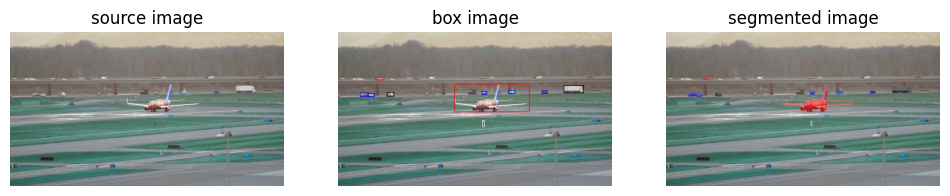


0: 384x640 1 person, 4 cars, 2 airplanes, 1 truck, 30.1ms
Speed: 0.6ms preprocess, 30.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 545.3611,  241.6322,  896.2873,  373.9703],
        [1054.8352,  249.4395, 1149.0461,  285.4210],
        [ 952.2797,  275.3503,  978.3685,  287.2540],
        [ 800.1313,  273.2211,  827.2772,  287.4038],
        [ 103.3503,  284.8032,  142.2629,  302.4834],
        [ 139.1249,  286.7270,  169.4973,  302.6375],
        [ 674.8044,  413.2600,  683.6273,  440.8196],
        [ 228.1726,  281.5362,  262.4554,  300.7866],
        [ 672.4281,  279.0651,  695.7865,  292.3011],
        [ 172.6928,  213.1065,  208.4808,  224.2420]], device='cuda:0')


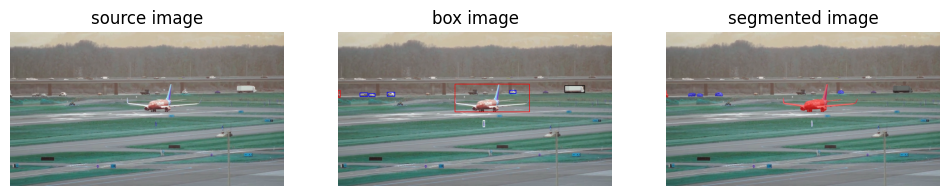


0: 384x640 1 person, 6 cars, 1 airplane, 3 trucks, 28.7ms
Speed: 0.6ms preprocess, 28.7ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 545.1466,  241.7605,  896.7001,  374.0184],
        [1059.3657,  249.0102, 1152.1294,  285.1239],
        [ 802.3265,  273.8990,  831.3585,  287.2359],
        [ 143.7998,  286.3510,  174.5754,  302.5447],
        [ 229.0664,  281.5388,  266.7993,  300.8096],
        [ 103.2700,  283.3438,  140.4402,  302.7686],
        [   0.0000,  271.7327,   10.6543,  304.4268],
        [ 677.4194,  413.5690,  686.5214,  440.5977]], device='cuda:0')


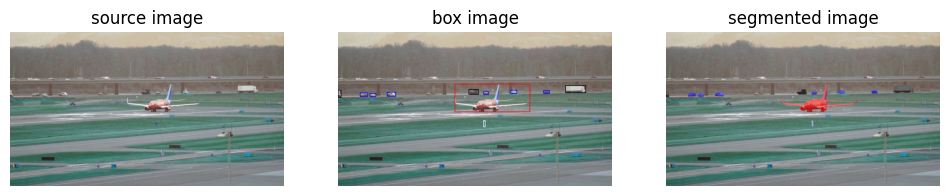


0: 384x640 1 person, 5 cars, 1 airplane, 3 trucks, 31.1ms
Speed: 2.3ms preprocess, 31.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.4598e+02, 2.4082e+02, 8.9818e+02, 3.7392e+02],
        [1.0633e+03, 2.4924e+02, 1.1580e+03, 2.8533e+02],
        [1.4813e+02, 2.8625e+02, 1.7816e+02, 3.0332e+02],
        [8.0720e+02, 2.7377e+02, 8.3561e+02, 2.8759e+02],
        [4.6854e-03, 2.7335e+02, 1.3966e+01, 3.0403e+02],
        [6.8096e+02, 2.7853e+02, 7.0481e+02, 2.9198e+02],
        [2.2893e+02, 2.8116e+02, 2.7049e+02, 3.0075e+02],
        [1.0332e+02, 2.8337e+02, 1.4008e+02, 3.0294e+02],
        [9.5974e+02, 2.7434e+02, 9.8759e+02, 2.8691e+02],
        [6.7902e+02, 4.1364e+02, 6.8816e+02, 4.4092e+02],
        [6.1020e+02, 2.6857e+02, 6.5763e+02, 2.9298e+02]], device='cuda:0')


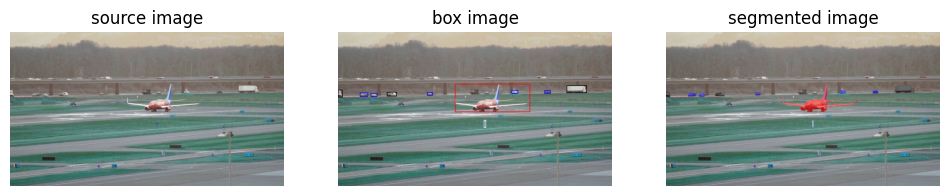


0: 384x640 3 cars, 2 airplanes, 4 trucks, 32.6ms
Speed: 0.6ms preprocess, 32.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.4618e+02, 2.4105e+02, 8.9916e+02, 3.7413e+02],
        [1.0685e+03, 2.4896e+02, 1.1622e+03, 2.8493e+02],
        [8.1245e+02, 2.7389e+02, 8.3966e+02, 2.8693e+02],
        [8.5964e-03, 2.7269e+02, 1.9224e+01, 3.0375e+02],
        [9.6643e+02, 2.7425e+02, 9.9201e+02, 2.8617e+02],
        [1.5337e+02, 2.8627e+02, 1.8306e+02, 3.0228e+02],
        [1.0339e+02, 2.8330e+02, 1.4032e+02, 3.0278e+02],
        [6.8195e+02, 4.1326e+02, 6.9082e+02, 4.4164e+02],
        [2.2951e+02, 2.8133e+02, 2.7453e+02, 3.0063e+02],
        [4.1802e+02, 2.8341e+02, 4.4119e+02, 2.9636e+02]], device='cuda:0')


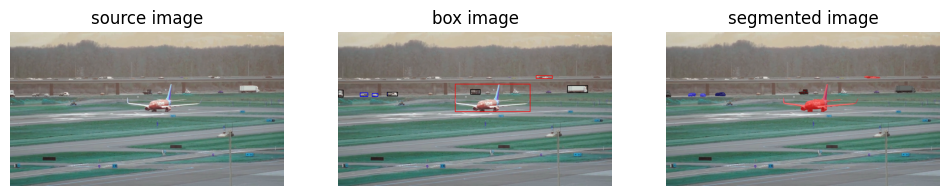


0: 384x640 2 cars, 2 airplanes, 3 trucks, 34.4ms
Speed: 0.6ms preprocess, 34.4ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.4623e+02, 2.4079e+02, 9.0015e+02, 3.7387e+02],
        [1.0735e+03, 2.4940e+02, 1.1673e+03, 2.8417e+02],
        [3.5070e-02, 2.7207e+02, 2.3473e+01, 3.0398e+02],
        [6.1882e+02, 2.6828e+02, 6.6474e+02, 2.9261e+02],
        [1.5895e+02, 2.8635e+02, 1.8567e+02, 3.0273e+02],
        [1.0385e+02, 2.8373e+02, 1.3913e+02, 3.0259e+02],
        [2.2978e+02, 2.8173e+02, 2.7796e+02, 3.0083e+02],
        [2.2935e+02, 2.8202e+02, 2.7753e+02, 3.0079e+02],
        [9.2647e+02, 2.0516e+02, 1.0004e+03, 2.1730e+02]], device='cuda:0')


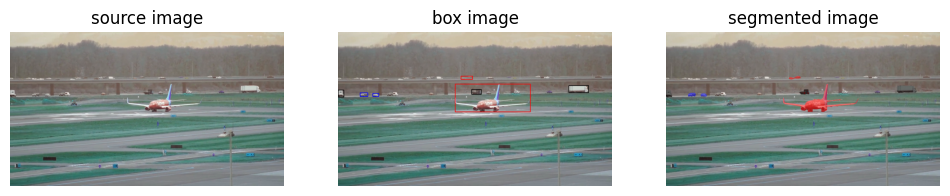


0: 384x640 1 person, 7 cars, 3 airplanes, 3 trucks, 28.7ms
Speed: 0.7ms preprocess, 28.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.4720e+02, 2.4027e+02, 9.0069e+02, 3.7404e+02],
        [1.0776e+03, 2.4934e+02, 1.1720e+03, 2.8458e+02],
        [5.0383e-02, 2.7114e+02, 2.7980e+01, 3.0480e+02],
        [1.6193e+02, 2.8585e+02, 1.8978e+02, 3.0180e+02],
        [6.2389e+02, 2.6818e+02, 6.6859e+02, 2.9214e+02],
        [1.0364e+02, 2.8340e+02, 1.3897e+02, 3.0229e+02],
        [5.7366e+02, 2.0553e+02, 6.2818e+02, 2.2053e+02]], device='cuda:0')


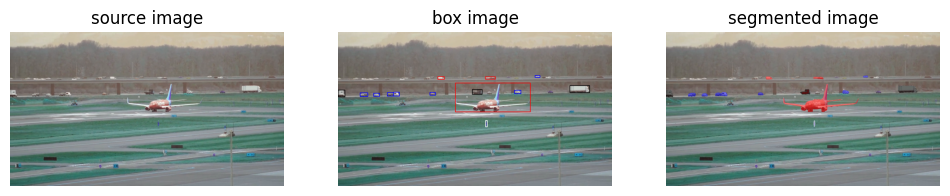


0: 384x640 8 cars, 4 airplanes, 4 trucks, 32.0ms
Speed: 0.7ms preprocess, 32.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.4689e+02, 2.4058e+02, 9.0123e+02, 3.7427e+02],
        [1.0821e+03, 2.4921e+02, 1.1762e+03, 2.8469e+02],
        [2.2681e-01, 2.7120e+02, 3.2214e+01, 3.0418e+02],
        [1.0356e+02, 2.8355e+02, 1.3944e+02, 3.0234e+02],
        [6.2676e+02, 2.6819e+02, 6.7368e+02, 2.9202e+02],
        [1.6610e+02, 2.8533e+02, 1.9427e+02, 3.0164e+02],
        [2.2982e+02, 2.8352e+02, 2.6114e+02, 3.0019e+02],
        [2.5871e+02, 2.8141e+02, 2.8603e+02, 3.0015e+02],
        [4.3063e+02, 2.8251e+02, 4.5424e+02, 2.9582e+02],
        [6.8915e+02, 4.1329e+02, 6.9751e+02, 4.4100e+02],
        [9.2032e+02, 2.0393e+02, 9.4251e+02, 2.1191e+02],
        [8.2496e+02, 2.7379e+02, 8.5351e+02, 2.8796e+02],
        [6.8810e+02, 2.0932e+02, 7.3708e+02, 2.2018e+02],
        [4.6631e+02, 2.0823e+02, 4.9781e+02, 2.2050e+02]], device='cuda:0')


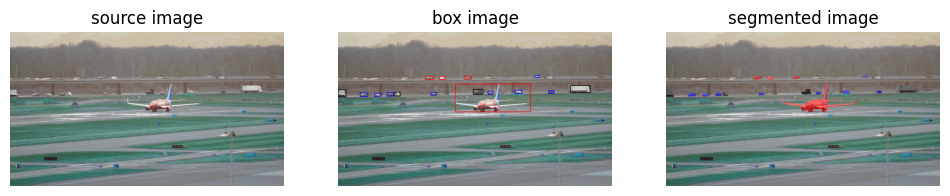


0: 384x640 1 person, 8 cars, 2 airplanes, 3 trucks, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.4659e+02, 2.4025e+02, 9.0098e+02, 3.7375e+02],
        [1.0862e+03, 2.4859e+02, 1.1801e+03, 2.8398e+02],
        [1.7498e-01, 2.7048e+02, 3.7677e+01, 3.0461e+02],
        [6.3126e+02, 2.6775e+02, 6.7744e+02, 2.9218e+02],
        [1.7065e+02, 2.8592e+02, 1.9867e+02, 3.0072e+02],
        [4.0818e+02, 2.0554e+02, 4.4921e+02, 2.2240e+02],
        [1.0346e+02, 2.8324e+02, 1.3954e+02, 3.0219e+02],
        [5.8831e+02, 2.0615e+02, 6.2336e+02, 2.2034e+02],
        [4.7300e+02, 2.0807e+02, 5.0419e+02, 2.2041e+02],
        [2.2935e+02, 2.8386e+02, 2.5931e+02, 2.9992e+02],
        [9.1800e+02, 2.0356e+02, 9.4060e+02, 2.1163e+02],
        [8.2889e+02, 2.7316e+02, 8.5873e+02, 2.8800e+02],
        [9.8368e+02, 2.7402e+02, 1.0108e+03, 2.8664e+02],
        [2.6321e+02, 2.8067e+02, 2.9015e+02, 3.0014e+02],
        [4.3391e+02, 2.8220e+02, 4.5816e+02, 2.9638e+02],
        [7.0069e+02, 2.7736e+02, 7.2325e+02, 2.9089e+02]], device='cuda:0')


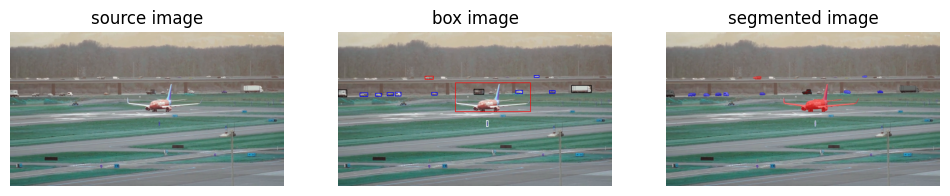


0: 384x640 10 cars, 2 airplanes, 3 trucks, 33.4ms
Speed: 0.7ms preprocess, 33.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.4642e+02, 2.4074e+02, 9.0134e+02, 3.7369e+02],
        [1.0907e+03, 2.4868e+02, 1.1841e+03, 2.8414e+02],
        [2.0437e-01, 2.7047e+02, 4.1906e+01, 3.0487e+02],
        [6.3528e+02, 2.6784e+02, 6.8088e+02, 2.9216e+02],
        [1.7526e+02, 2.8574e+02, 2.0248e+02, 3.0122e+02],
        [2.2966e+02, 2.8392e+02, 2.5904e+02, 3.0015e+02],
        [1.0356e+02, 2.8351e+02, 1.3930e+02, 3.0194e+02],
        [2.6710e+02, 2.8151e+02, 2.9371e+02, 3.0018e+02],
        [9.1601e+02, 2.0371e+02, 9.3922e+02, 2.1160e+02],
        [4.0623e+02, 2.0592e+02, 4.4587e+02, 2.2176e+02],
        [8.3248e+02, 2.7302e+02, 8.6288e+02, 2.8729e+02],
        [9.8812e+02, 2.7364e+02, 1.0144e+03, 2.8609e+02],
        [4.3854e+02, 2.8196e+02, 4.6203e+02, 2.9633e+02],
        [6.9374e+02, 4.1352e+02, 7.0184e+02, 4.4016e+02]], device='cuda:0')


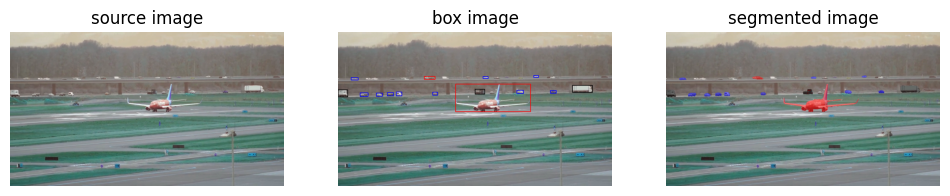


0: 384x640 8 cars, 3 airplanes, 3 trucks, 31.4ms
Speed: 1.1ms preprocess, 31.4ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.4759e+02, 2.4157e+02, 9.0189e+02, 3.7386e+02],
        [1.0948e+03, 2.4854e+02, 1.1890e+03, 2.8447e+02],
        [2.9863e-01, 2.7000e+02, 4.6391e+01, 3.0493e+02],
        [1.7840e+02, 2.8585e+02, 2.0770e+02, 3.0076e+02],
        [1.0386e+02, 2.8352e+02, 1.3967e+02, 3.0191e+02],
        [2.2947e+02, 2.8395e+02, 2.5982e+02, 2.9980e+02],
        [9.1412e+02, 2.0380e+02, 9.3692e+02, 2.1159e+02],
        [6.2535e+01, 2.1292e+02, 9.5029e+01, 2.2423e+02],
        [6.3886e+02, 2.6737e+02, 6.8408e+02, 2.9179e+02],
        [2.7196e+02, 2.8096e+02, 2.9863e+02, 2.9994e+02],
        [9.9270e+02, 2.7347e+02, 1.0194e+03, 2.8644e+02],
        [8.3797e+02, 2.7245e+02, 8.6606e+02, 2.8786e+02],
        [6.7827e+02, 2.0996e+02, 7.0126e+02, 2.1804e+02],
        [4.4240e+02, 2.8191e+02, 4.6302e+02, 2.9518e+02],
        [4.0346e+02, 2.0656e+02, 4.5444e+02, 2.2251e+02]], device='cuda:0')


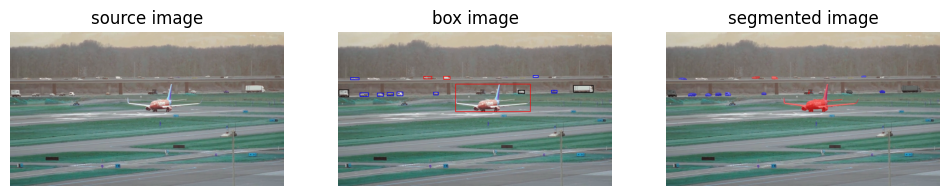


0: 384x640 7 cars, 2 airplanes, 3 trucks, 30.7ms
Speed: 0.6ms preprocess, 30.7ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 547.1146,  241.4459,  902.3060,  373.6556],
        [1099.5443,  248.3338, 1193.6964,  283.6444],
        [   4.3379,  269.7463,   51.8270,  305.0914],
        [ 103.3902,  283.5537,  141.6606,  302.1463],
        [ 183.0078,  285.0286,  212.6491,  300.6437],
        [ 229.2397,  283.0939,  259.8103,  299.4705],
        [ 912.1497,  203.6859,  934.1977,  211.4152],
        [ 275.6715,  280.7563,  302.5582,  299.2665],
        [ 997.6257,  273.0961, 1023.8511,  285.6187],
        [  57.7926,  212.6445,   99.5071,  223.0945],
        [ 400.9329,  206.3017,  440.4650,  219.7283],
        [ 446.7689,  281.7147,  468.2554,  294.6730],
        [ 842.6195,  272.1682,  870.5476,  287.9179],
        [ 492.5322,  207.2522,  524.4802,  220.5082]], device='cuda:0')


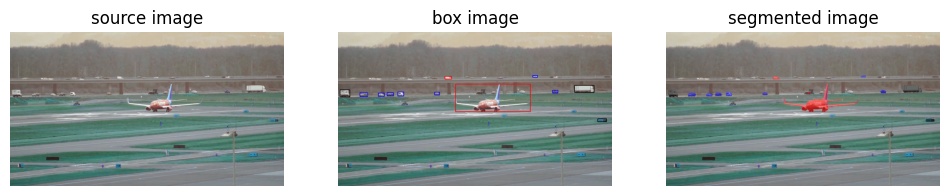


0: 384x640 6 cars, 2 airplanes, 5 trucks, 29.7ms
Speed: 0.6ms preprocess, 29.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 548.2324,  241.4704,  901.9468,  373.6432],
        [1104.1750,  248.4127, 1197.7539,  283.2792],
        [   8.9244,  269.6808,   56.1279,  304.7917],
        [ 188.6961,  285.0331,  217.2047,  301.3073],
        [ 911.0908,  204.0245,  932.4287,  211.5218],
        [ 229.6863,  283.2424,  260.4268,  299.5608],
        [ 103.4603,  283.6371,  139.7914,  302.0501],
        [1002.9604,  273.0022, 1027.9734,  285.9023],
        [ 280.1393,  280.1729,  307.4192,  299.5580],
        [ 451.1921,  281.7635,  474.3233,  294.9057],
        [ 499.0087,  207.7090,  530.6154,  220.3563],
        [1213.2217,  404.5699, 1254.3882,  419.7706]], device='cuda:0')


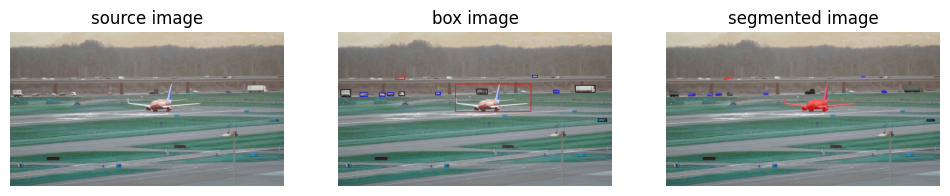


0: 384x640 8 cars, 1 airplane, 3 trucks, 33.7ms
Speed: 0.9ms preprocess, 33.7ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 549.2381,  241.6089,  903.4289,  373.3909],
        [1109.2594,  248.5421, 1201.9518,  283.0879],
        [  13.2154,  268.9097,   60.6209,  304.4251],
        [ 192.4733,  284.9756,  220.3027,  301.0457],
        [ 230.7122,  282.9644,  260.2650,  299.3264],
        [ 908.1307,  204.0167,  930.7531,  211.4724],
        [ 102.7991,  283.3908,  139.1528,  301.9218],
        [1006.8346,  273.0027, 1031.6930,  285.0298],
        [ 284.8511,  280.2617,  311.1940,  299.0767],
        [ 455.5595,  281.4136,  478.3105,  294.9310],
        [1214.8922,  404.2892, 1255.9801,  419.1717],
        [ 267.7111,  210.0904,  312.4943,  222.0846],
        [ 647.4929,  265.9984,  697.0768,  291.8300]], device='cuda:0')


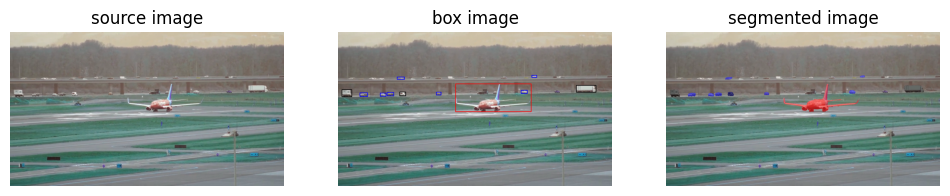


0: 384x640 1 person, 8 cars, 2 airplanes, 2 trucks, 30.8ms
Speed: 0.7ms preprocess, 30.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 549.0221,  241.6186,  903.4948,  373.5482],
        [1113.7744,  248.6231, 1205.8516,  282.6748],
        [  17.0987,  269.1776,   64.5902,  304.3477],
        [ 230.6350,  283.5726,  260.2551,  299.1234],
        [ 196.8564,  284.4660,  225.4500,  300.7868],
        [ 856.5037,  272.7198,  884.6257,  288.0861],
        [ 905.7272,  203.6165,  928.8048,  211.6282],
        [ 102.7613,  283.3616,  138.8139,  302.1223],
        [ 458.9777,  281.3461,  480.7251,  294.7051],
        [ 288.7083,  279.9606,  316.5135,  299.3224],
        [ 288.7892,  279.8649,  316.3976,  299.2404],
        [ 275.7457,  208.4182,  316.3542,  221.9951]], device='cuda:0')


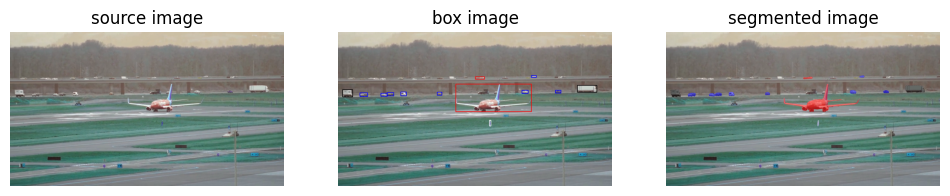


0: 384x640 12 cars, 4 airplanes, 3 trucks, 34.0ms
Speed: 0.8ms preprocess, 34.0ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.2217,  241.5353,  904.3769,  373.8991],
        [1117.9380,  248.3174, 1212.0562,  282.8677],
        [  20.7966,  269.1675,   69.2534,  304.9109],
        [ 200.6880,  285.3368,  231.1859,  300.7059],
        [ 228.5951,  283.8133,  260.3186,  299.2941],
        [ 860.3099,  272.6236,  888.8627,  288.4166],
        [ 102.4083,  283.2364,  138.9915,  302.3432],
        [ 904.4902,  203.7619,  926.7419,  211.5656],
        [ 292.6462,  280.1646,  319.8172,  299.1187],
        [1015.2277,  273.4366, 1041.2599,  285.6768],
        [ 639.4436,  208.8624,  683.8540,  220.5419],
        [ 463.9503,  281.5014,  485.5582,  294.8204],
        [ 706.7120,  413.0472,  714.8873,  439.4200]], device='cuda:0')


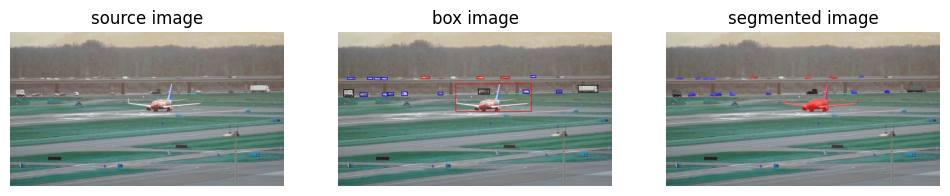


0: 384x640 1 person, 9 cars, 2 airplanes, 3 trucks, 63.2ms
Speed: 0.5ms preprocess, 63.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.3334,  241.1473,  905.0776,  373.6086],
        [1122.1261,  247.9522, 1215.9283,  282.6929],
        [  27.1938,  269.2286,   74.2931,  304.4369],
        [ 205.4609,  285.2574,  233.5916,  300.3972],
        [ 865.6655,  272.6054,  892.8333,  287.6041],
        [ 229.2616,  283.1855,  260.1651,  299.0993],
        [ 654.1925,  265.5588,  708.8461,  291.0479],
        [ 297.0980,  280.0076,  324.5187,  299.0623],
        [ 467.2979,  281.5465,  490.1971,  294.1177],
        [1020.4188,  272.2107, 1045.7467,  284.8834],
        [ 134.8349,  211.5034,  162.2827,  222.4336],
        [ 102.3500,  283.5171,  138.3472,  302.3431],
        [ 647.9586,  209.2883,  680.1680,  219.2909],
        [ 171.3344,  213.0595,  198.6991,  223.3988],
        [  42.1805,  212.1746,   78.3837,  221.2700],
        [ 201.9138,  213.7633,  230.7732,  223.2704],
        [ 387.6841,  204.8318,  429.1188,  217.5889],
        [ 901.5284,  204.1003,  923.6884,  212.5370],
        [ 758.0198,  206.712

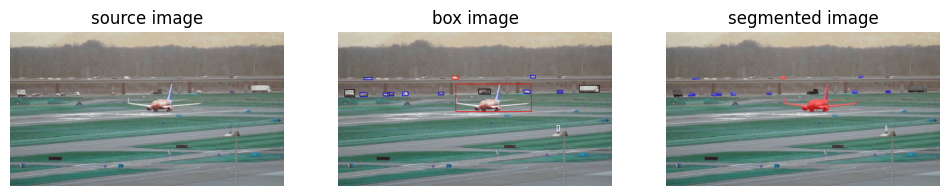


0: 384x640 1 person, 9 cars, 2 airplanes, 2 trucks, 31.6ms
Speed: 0.6ms preprocess, 31.6ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.2659,  241.7344,  905.4506,  373.7593],
        [1126.2277,  248.6441, 1221.3629,  282.9046],
        [  31.6104,  269.2651,   78.8470,  304.7620],
        [ 209.3848,  285.7632,  240.9383,  300.4279],
        [1023.8585,  272.5902, 1049.9825,  285.3256],
        [ 230.7423,  282.9610,  260.5922,  298.7292],
        [ 301.1508,  280.2208,  327.4429,  298.8879],
        [ 868.7103,  272.2297,  897.3794,  287.8480],
        [ 102.7620,  283.5903,  138.2440,  302.6320],
        [ 469.5128,  281.3974,  494.0070,  294.0753],
        [ 657.1727,  266.3793,  711.1006,  290.8193],
        [ 123.9496,  212.2500,  159.2767,  223.1805],
        [1022.6278,  435.7556, 1034.2499,  461.0633],
        [ 532.4686,  207.0376,  564.7463,  219.3543],
        [ 898.8391,  204.0277,  921.8926,  215.4625]], device='cuda:0')


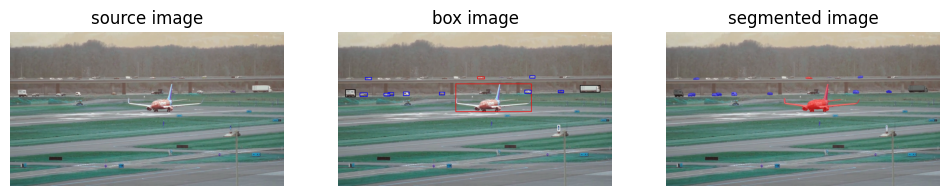


0: 384x640 1 person, 10 cars, 2 airplanes, 4 trucks, 28.8ms
Speed: 0.6ms preprocess, 28.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.2693,  241.9001,  906.2556,  373.8557],
        [1130.9399,  248.1607, 1225.8188,  282.6991],
        [  35.6072,  268.9741,   82.7710,  304.5690],
        [1029.1953,  272.3601, 1054.5532,  284.6206],
        [ 127.0325,  211.9228,  156.5771,  223.5110],
        [ 896.4974,  204.3075,  919.5630,  215.4005],
        [ 233.9545,  282.9482,  260.3451,  299.0724],
        [ 305.0885,  280.0719,  332.5234,  299.0562],
        [ 214.6346,  285.1882,  242.6538,  300.4018],
        [ 873.5297,  272.6076,  901.4824,  287.5404],
        [ 102.1530,  283.7668,  138.1842,  302.7579],
        [1025.6030,  435.8472, 1036.2598,  460.7035],
        [ 651.6843,  209.1090,  683.9712,  219.5849],
        [ 474.0619,  281.2526,  498.1068,  293.8699]], device='cuda:0')


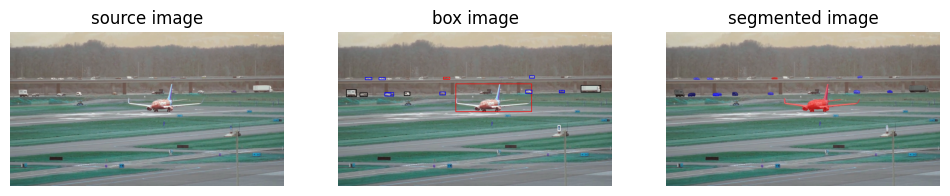


0: 384x640 6 cars, 1 airplane, 2 trucks, 32.9ms
Speed: 0.5ms preprocess, 32.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.6522,  241.8177,  907.1547,  374.0405],
        [1135.4468,  248.1697, 1229.9480,  282.5216],
        [  39.6085,  268.8107,   87.4973,  304.1932],
        [1032.8054,  272.3016, 1057.5696,  284.8411],
        [ 895.5092,  204.5501,  917.2260,  215.0383],
        [ 218.7672,  283.7051,  259.8520,  299.5916],
        [ 218.4202,  284.6896,  247.9164,  299.9196],
        [ 127.2710,  212.7006,  158.3486,  223.2300],
        [ 876.8792,  271.7864,  906.4667,  287.7186],
        [ 309.3282,  279.8267,  335.9319,  298.6718],
        [ 309.2779,  279.7148,  336.0223,  298.7638],
        [ 191.6282,  212.8516,  220.3161,  223.5652],
        [ 476.7440,  281.4822,  502.1159,  294.3993],
        [ 492.0846,  210.8458,  522.1647,  221.7200],
        [ 101.8433,  283.7574,  137.9791,  302.7919],
        [ 101.7641,  283.6335,  137.8415,  303.0820],
        [1026.8112,  435.7948, 1038.5931,  460.8275]], device='cuda:0')


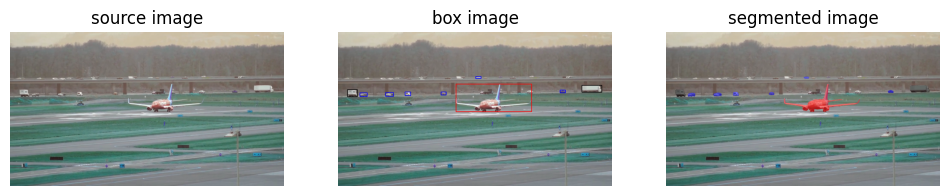


0: 384x640 11 cars, 1 airplane, 2 trucks, 32.6ms
Speed: 0.6ms preprocess, 32.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.1467,  242.1625,  907.4146,  374.0850],
        [1140.1252,  248.4671, 1233.2534,  282.2478],
        [  43.9429,  268.2643,   91.3544,  303.8995],
        [ 222.9662,  283.3645,  260.0256,  300.5222],
        [1037.6105,  272.4890, 1061.7638,  284.2649],
        [ 313.3633,  280.1068,  340.2601,  298.7188],
        [ 483.4578,  281.7413,  504.4396,  294.1758],
        [ 102.1125,  283.8540,  137.6947,  302.6494],
        [ 643.0999,  210.0704,  668.6178,  218.6059]], device='cuda:0')


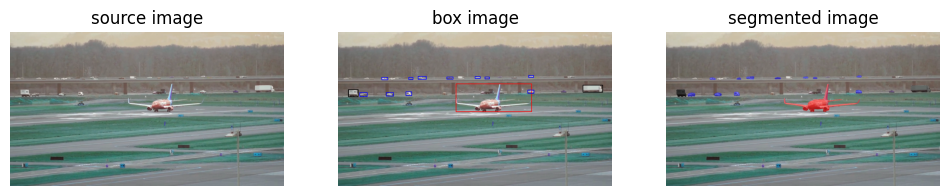


0: 384x640 3 cars, 1 airplane, 3 trucks, 29.8ms
Speed: 0.6ms preprocess, 29.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.1046,  242.2877,  908.0043,  374.0673],
        [1143.6824,  247.8856, 1238.6453,  283.0809],
        [  48.0740,  268.1181,   95.2347,  303.7005],
        [ 226.7487,  283.3834,  259.4680,  299.5090],
        [ 887.6688,  272.2263,  915.9381,  286.9728],
        [ 318.3329,  280.5366,  343.1880,  298.2084],
        [ 507.6230,  211.4747,  535.8226,  220.9414],
        [ 327.4556,  211.6478,  352.8563,  222.4232],
        [ 686.3156,  208.9303,  708.0663,  219.5297],
        [ 890.4742,  203.5172,  912.9183,  211.8412],
        [ 100.5455,  283.8257,  137.4349,  302.2839],
        [ 639.6700,  209.5423,  664.3276,  217.6503],
        [ 374.1348,  208.9645,  413.3094,  222.2009],
        [ 204.6639,  212.6268,  232.8207,  223.1035]], device='cuda:0')


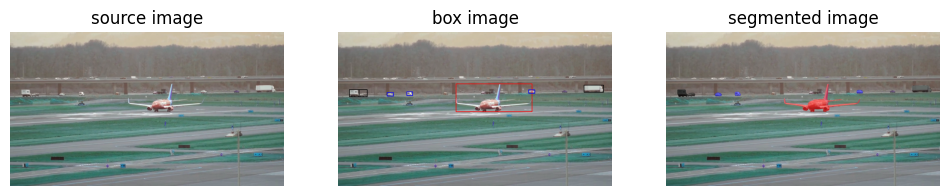


0: 384x640 1 person, 8 cars, 1 airplane, 3 trucks, 32.7ms
Speed: 0.5ms preprocess, 32.7ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.7675,  242.0986,  908.7874,  374.0814],
        [1148.1453,  247.8334, 1242.8777,  282.4722],
        [ 230.5408,  284.0203,  258.8231,  299.6141],
        [ 891.6469,  272.2795,  918.7050,  286.7383],
        [  52.0316,  268.0016,  101.4966,  303.3950],
        [ 322.3652,  280.7291,  347.7498,  298.3399],
        [  52.2707,  267.9382,  137.1597,  303.6160]], device='cuda:0')


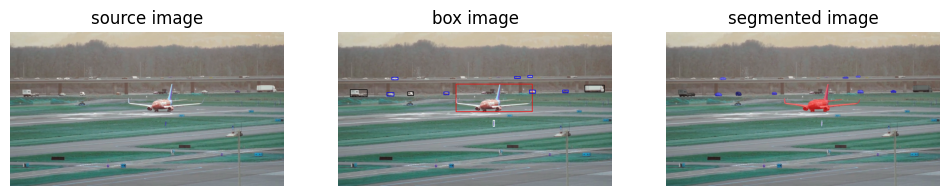


0: 384x640 6 cars, 1 airplane, 2 trucks, 28.7ms
Speed: 0.7ms preprocess, 28.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.0634,  241.8215,  908.7013,  374.1896],
        [1152.5171,  247.8006, 1246.2209,  281.9896],
        [  57.9146,  268.1705,  137.0745,  303.7700],
        [1051.2625,  272.3951, 1075.7817,  283.7417],
        [ 229.1958,  283.4311,  261.0768,  300.3649],
        [ 895.2969,  272.0212,  922.8848,  286.9016],
        [ 326.5130,  280.3882,  352.2097,  298.2295],
        [ 723.4878,  413.1852,  731.3145,  438.8623],
        [ 495.6504,  281.0137,  518.2178,  294.5954],
        [ 326.4700,  280.3926,  352.1912,  298.3868],
        [ 885.5979,  203.6207,  908.8276,  212.0155],
        [ 824.2615,  208.9082,  852.6661,  217.1684],
        [ 251.9802,  210.8206,  280.5571,  223.3609]], device='cuda:0')


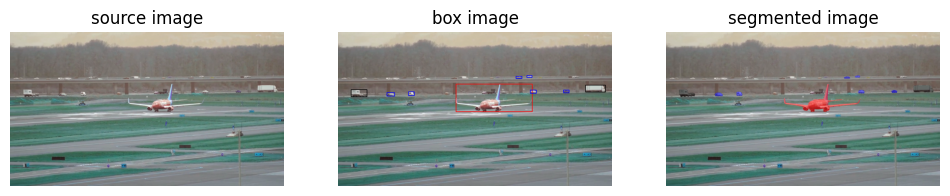


0: 384x640 7 cars, 1 airplane, 2 trucks, 32.6ms
Speed: 0.6ms preprocess, 32.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.1475,  242.2043,  909.3931,  374.0824],
        [1155.7673,  247.5723, 1250.2605,  282.2979],
        [  61.8424,  267.7372,  136.1954,  303.5993],
        [ 228.8350,  283.9496,  264.8765,  300.3051],
        [1054.6835,  272.4633, 1079.7850,  283.8695],
        [ 898.9387,  272.2589,  926.2933,  286.1614],
        [ 329.4622,  280.1517,  356.1622,  298.7839],
        [ 883.8057,  204.1113,  905.7438,  211.9136],
        [ 832.3546,  208.6892,  858.4562,  216.8382]], device='cuda:0')


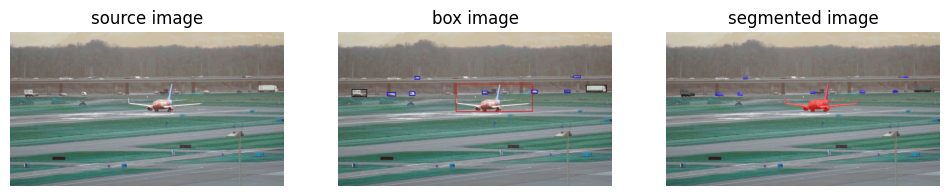


0: 384x640 6 cars, 1 airplane, 2 trucks, 29.4ms
Speed: 0.5ms preprocess, 29.4ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.4535,  242.6191,  909.8258,  373.8681],
        [1158.7292,  247.8125, 1254.8406,  282.9022],
        [  65.6531,  268.2141,  135.4015,  303.6043],
        [1058.8728,  272.3193, 1084.1990,  284.0634],
        [ 229.6717,  283.5397,  268.6277,  300.4503],
        [ 903.5494,  271.5726,  931.4381,  286.9703],
        [ 334.0592,  280.4360,  359.3270,  298.5117],
        [1102.6136,  206.3745, 1133.8075,  214.3695],
        [ 359.9659,  208.8017,  381.2986,  221.8214],
        [ 673.3987,  276.5815,  701.5938,  291.1304]], device='cuda:0')


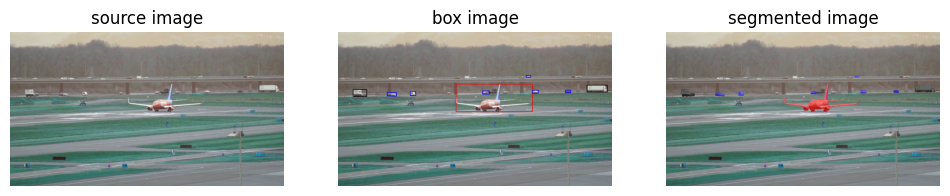


0: 384x640 5 cars, 3 airplanes, 2 trucks, 30.4ms
Speed: 0.6ms preprocess, 30.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.3865,  242.6274,  909.8044,  373.6434],
        [1163.6467,  247.1747, 1260.0212,  281.9399],
        [  69.6087,  267.7166,  135.2711,  303.0956],
        [1063.0586,  272.2748, 1087.5640,  283.5585],
        [ 337.6491,  279.6324,  363.3529,  298.6129],
        [ 908.0825,  271.8361,  934.9810,  286.3128],
        [ 880.0769,  204.1850,  900.9358,  211.2084],
        [ 229.7276,  283.5635,  273.4393,  299.7106],
        [ 675.5227,  276.0818,  706.5790,  290.9114]], device='cuda:0')


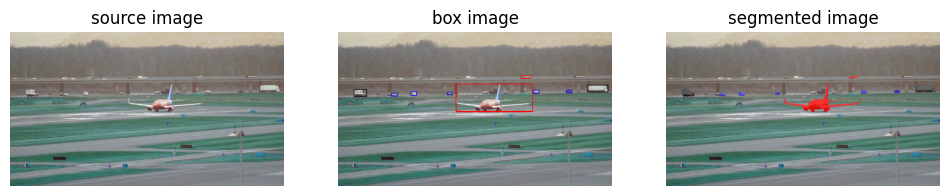


0: 384x640 5 cars, 3 airplanes, 2 trucks, 33.9ms
Speed: 0.6ms preprocess, 33.9ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.4558,  242.8501,  910.1355,  374.1796],
        [1167.6599,  247.5294, 1262.6931,  282.0824],
        [  74.3540,  267.9001,  135.3317,  303.2318],
        [1066.9875,  271.7227, 1092.9060,  284.2296],
        [ 341.6783,  280.1057,  366.3152,  298.5304],
        [ 250.9067,  285.2692,  275.8781,  299.4792],
        [ 852.4211,  204.8050,  898.5804,  217.5173],
        [ 511.3572,  281.2788,  534.0535,  294.8896],
        [ 911.0470,  271.1425,  939.7772,  287.0254],
        [ 551.8829,  259.5031,  897.4803,  346.3934]], device='cuda:0')


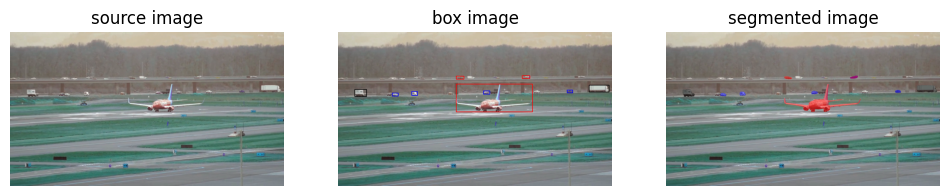


0: 384x640 8 cars, 1 airplane, 2 trucks, 33.1ms
Speed: 0.6ms preprocess, 33.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.8210,  242.9398,  910.8972,  373.9927],
        [1172.0293,  247.1716, 1267.1973,  281.4512],
        [  78.3083,  267.5996,  135.2032,  303.1777],
        [1070.8910,  272.0439, 1095.6251,  284.0490],
        [ 345.7863,  279.5353,  370.3399,  298.1628],
        [ 861.1431,  204.2372,  895.7988,  216.1141],
        [ 859.9924,  204.0839,  895.7336,  216.7660],
        [ 253.1624,  284.8934,  280.4205,  299.5874],
        [ 552.0790,  207.0681,  588.8280,  220.4931],
        [ 679.5966,  276.2133,  711.8151,  290.8300]], device='cuda:0')


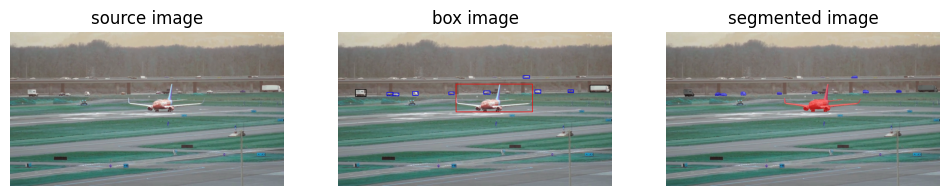


0: 384x640 11 cars, 1 airplane, 2 trucks, 33.6ms
Speed: 0.7ms preprocess, 33.6ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.5505,  242.4279,  911.8929,  373.7881],
        [1176.1647,  247.0840, 1270.5050,  280.8265],
        [  82.4970,  267.7860,  133.1045,  302.5329],
        [ 348.7038,  279.5281,  373.0556,  296.2690],
        [ 256.5742,  285.6507,  285.2930,  299.2024],
        [ 865.4660,  204.4975,  894.9930,  216.4231],
        [ 227.5549,  282.5937,  256.7797,  299.1403],
        [ 919.2446,  270.9433,  948.3464,  286.8820],
        [1074.5741,  271.3864, 1100.1263,  283.7191],
        [ 518.2115,  279.9224,  542.3631,  294.0045],
        [ 681.1411,  276.5262,  713.3071,  290.8669]], device='cuda:0')


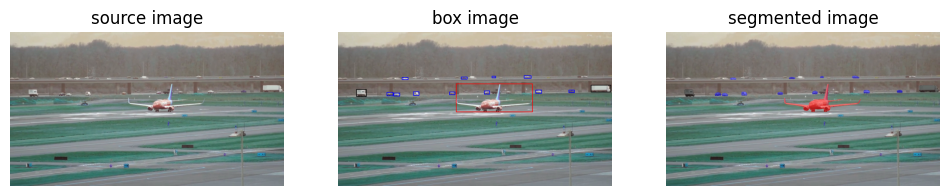


0: 384x640 5 cars, 2 airplanes, 2 trucks, 28.7ms
Speed: 0.5ms preprocess, 28.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.9695,  242.2497,  911.6722,  374.0974],
        [1180.9468,  247.2659, 1277.1873,  281.2391],
        [  85.9321,  267.6524,  133.0238,  303.0079],
        [ 261.4948,  285.6704,  288.5867,  299.8191],
        [ 227.0040,  282.5663,  255.4962,  299.4094],
        [ 924.3976,  272.4019,  951.2145,  285.8685],
        [ 353.2286,  279.5619,  377.7131,  297.1906],
        [ 869.6454,  204.6583,  902.1411,  216.4967],
        [ 683.4991,  276.5575,  707.3893,  290.4211],
        [ 719.5704,  206.7894,  737.5109,  215.0181],
        [ 521.8138,  280.4084,  546.5090,  294.0430],
        [1078.9607,  271.5182, 1103.6082,  283.2316],
        [ 298.4995,  212.6374,  327.1912,  222.6298],
        [ 575.0491,  210.0972,  601.3940,  220.1709]], device='cuda:0')


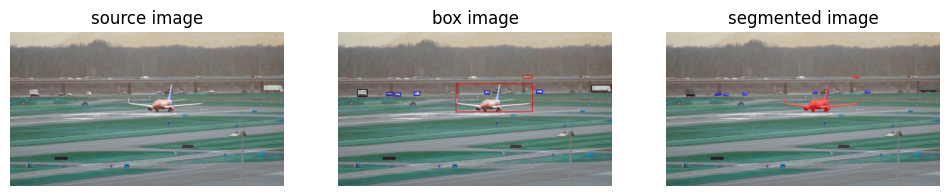


0: 384x640 1 person, 6 cars, 2 airplanes, 3 trucks, 33.0ms
Speed: 0.7ms preprocess, 33.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.6621,  241.7341,  910.8870,  374.1015],
        [  90.8823,  268.0971,  137.0448,  303.0895],
        [1184.5652,  247.4409, 1279.0496,  281.7156],
        [ 264.8356,  285.2767,  293.5323,  299.9476],
        [ 227.0071,  283.1126,  260.4445,  299.3451],
        [ 355.2360,  279.6820,  381.6218,  297.1989],
        [ 927.8701,  271.9362,  955.8330,  287.0582],
        [ 866.2520,  204.4877,  907.9827,  216.2966],
        [ 685.0903,  276.2756,  708.9319,  290.2024]], device='cuda:0')


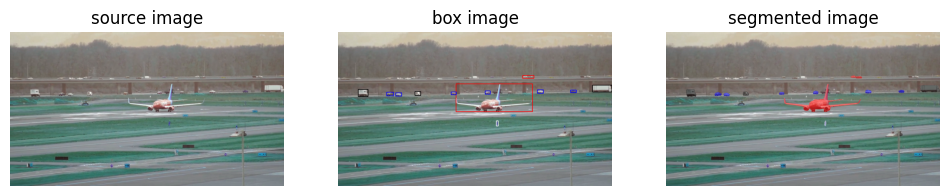


0: 384x640 8 cars, 1 airplane, 3 trucks, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.2607,  241.9428,  911.4316,  373.7791],
        [  94.7414,  267.2062,  141.3406,  303.0812],
        [1188.1770,  247.1524, 1278.6863,  281.0757],
        [ 269.6715,  284.7255,  297.4269,  299.6060],
        [ 226.8318,  281.8024,  258.8679,  298.9424],
        [ 931.7124,  272.0444,  958.7144,  285.7791],
        [ 687.7402,  276.1208,  711.0928,  290.3572],
        [ 359.7416,  278.0071,  386.6135,  297.1746],
        [1086.6545,  271.6904, 1113.4287,  283.5369],
        [ 529.3765,  280.5457,  552.3381,  293.7458],
        [ 864.5199,  204.5578,  915.7183,  216.4922],
        [ 740.0148,  416.8760,  749.0444,  439.2078]], device='cuda:0')


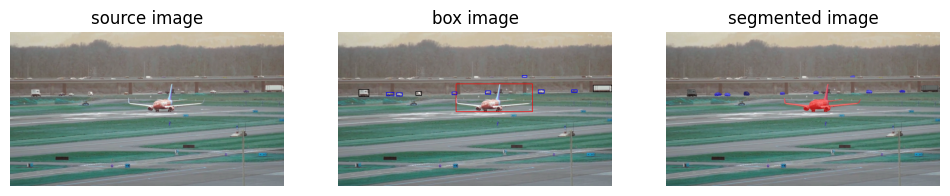


0: 384x640 9 cars, 1 airplane, 2 trucks, 28.9ms
Speed: 0.6ms preprocess, 28.9ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.0869,  242.0983,  911.0350,  373.7901],
        [  96.1460,  267.5204,  144.7417,  302.7420],
        [ 273.3991,  284.8945,  300.9857,  299.2883],
        [ 226.2122,  282.0038,  258.0018,  299.1773],
        [1192.6365,  246.9937, 1279.2590,  280.8684],
        [ 936.5557,  271.4720,  963.0781,  286.1027],
        [ 689.1902,  276.5108,  712.5991,  290.4197],
        [ 363.3295,  278.8120,  389.0962,  297.1651],
        [ 532.1346,  280.1614,  555.2550,  293.7813],
        [ 861.2789,  203.8766,  882.3488,  210.9547],
        [1090.4285,  271.7727, 1116.9963,  283.2924],
        [ 363.6476,  278.4873,  389.1871,  297.3965]], device='cuda:0')


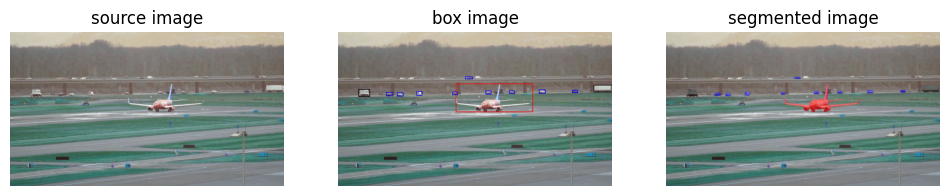


0: 384x640 1 person, 8 cars, 2 airplanes, 2 trucks, 31.7ms
Speed: 0.6ms preprocess, 31.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.3147,  242.2975,  911.3428,  374.1310],
        [  96.1416,  267.7541,  148.8476,  302.7586],
        [ 226.1729,  282.0924,  255.8942,  299.6375],
        [ 276.7751,  284.6880,  304.0668,  299.2133],
        [1194.3400,  247.2275, 1279.0795,  280.8273],
        [1094.5784,  272.0819, 1119.6980,  283.0219],
        [ 939.8911,  271.9309,  967.3920,  286.1494],
        [ 368.2744,  279.5547,  392.1061,  297.0251],
        [ 535.9081,  280.0919,  558.0138,  293.9678],
        [ 690.4700,  275.7899,  714.5933,  290.4599],
        [ 799.8782,  275.4017,  823.0217,  288.0088],
        [ 594.9875,  209.5064,  630.9039,  219.6568]], device='cuda:0')


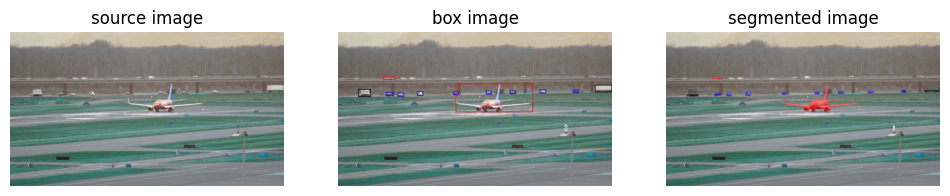


0: 384x640 11 cars, 1 airplane, 2 trucks, 29.3ms
Speed: 0.6ms preprocess, 29.3ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.6086,  241.6106,  912.0492,  374.1875],
        [  95.8590,  267.5943,  152.0718,  302.5692],
        [1201.7645,  247.6182, 1279.0844,  280.5685],
        [ 225.7433,  282.1195,  255.8318,  299.6310],
        [ 280.8856,  284.7679,  308.1517,  299.8533],
        [ 212.3300,  209.4513,  266.4910,  221.9402],
        [1098.8020,  271.3510, 1125.2053,  283.1765],
        [ 692.2437,  275.8879,  715.8964,  290.6913],
        [ 944.2778,  270.9154,  971.9143,  286.2185],
        [ 370.0302,  278.3311,  396.9293,  298.3922],
        [ 539.9452,  280.4021,  563.3265,  293.6389],
        [ 802.8845,  275.1965,  827.1097,  287.9401],
        [1059.1616,  435.4174, 1070.6826,  462.3257]], device='cuda:0')


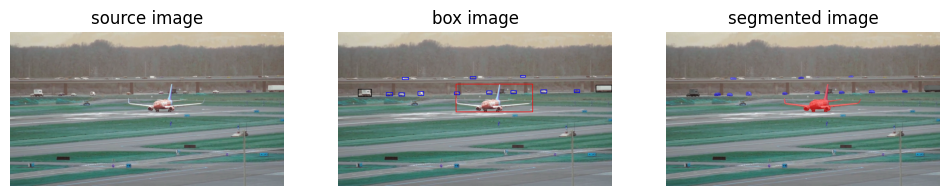


0: 384x640 8 cars, 2 airplanes, 3 trucks, 28.7ms
Speed: 0.6ms preprocess, 28.7ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.3605,  242.2507,  911.4652,  374.1583],
        [  94.5019,  266.8886,  157.0093,  303.0350],
        [1204.7236,  247.0965, 1279.3774,  280.7720],
        [ 225.2691,  282.7594,  255.4392,  299.4747],
        [ 947.4230,  271.1370,  975.1290,  285.9067],
        [ 285.0874,  285.0247,  312.0797,  299.5233],
        [1103.1924,  271.2035, 1130.2319,  283.2317],
        [ 693.7155,  275.8509,  718.9150,  290.7773],
        [ 373.8941,  278.9086,  399.8411,  297.6793],
        [ 543.7348,  280.0789,  568.0330,  293.5996],
        [ 808.5920,  274.7061,  831.8101,  288.0863],
        [ 301.0299,  211.0990,  328.2400,  222.5975],
        [ 851.3346,  203.8094,  874.7968,  211.0699],
        [ 617.0114,  209.2441,  644.7965,  218.9875]], device='cuda:0')


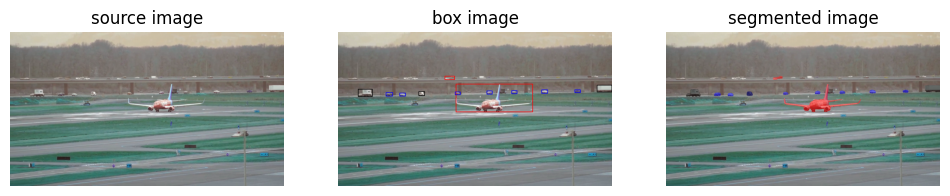


0: 384x640 7 cars, 2 airplanes, 4 trucks, 30.8ms
Speed: 1.0ms preprocess, 30.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.4182,  241.9196,  912.0144,  374.5790],
        [1209.3989,  247.9633, 1279.5654,  279.8008],
        [ 224.7129,  282.6431,  255.4083,  299.7162],
        [  93.9897,  267.0336,  159.9833,  303.0942],
        [1106.3657,  270.9551, 1132.4158,  283.0819],
        [ 287.7986,  284.9441,  315.4307,  300.0972],
        [ 952.1966,  271.3952,  979.6802,  286.7178],
        [ 696.3077,  275.7687,  720.3534,  290.3943],
        [ 498.8700,  206.6796,  544.5424,  220.9595],
        [ 376.8967,  278.4435,  404.4341,  298.1470],
        [ 376.7729,  278.2053,  404.4975,  298.4176],
        [ 547.8754,  280.3438,  570.6837,  293.5623],
        [ 812.0779,  274.6166,  836.0978,  288.0836]], device='cuda:0')


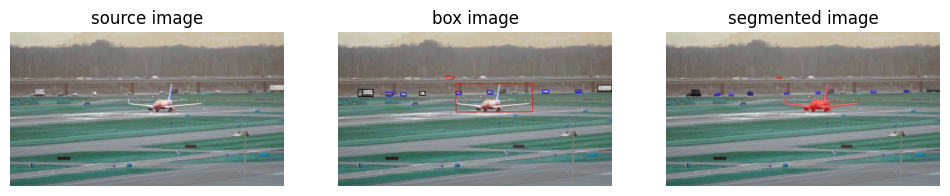


0: 384x640 10 cars, 3 airplanes, 3 trucks, 35.2ms
Speed: 0.5ms preprocess, 35.2ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.2491,  241.3809,  912.4708,  374.4582],
        [1213.9299,  247.9459, 1279.5237,  279.5082],
        [ 114.1544,  267.1696,  164.7492,  302.8994],
        [ 224.6781,  282.8046,  254.7647,  299.6162],
        [ 956.1069,  272.1854,  983.2893,  286.1802],
        [1110.2100,  271.1226, 1135.1919,  282.6552],
        [ 292.2554,  285.0244,  318.8324,  299.6793],
        [ 551.1736,  280.3561,  574.1277,  293.0881],
        [ 697.1908,  275.8791,  722.1093,  291.1531],
        [ 380.9432,  278.6689,  408.1091,  298.3669],
        [  93.0221,  266.7972,  164.8104,  302.7878],
        [ 505.7377,  206.8286,  543.4288,  220.8878],
        [ 380.7358,  278.5087,  408.0863,  298.3644]], device='cuda:0')


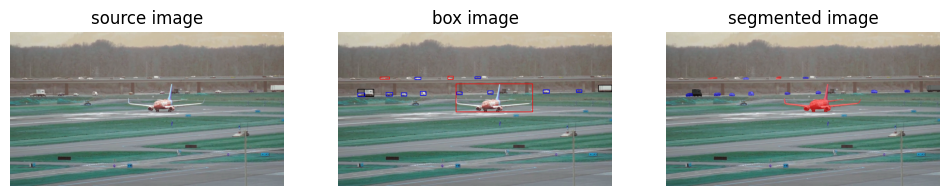


0: 384x640 1 person, 9 cars, 1 airplane, 2 trucks, 29.5ms
Speed: 0.5ms preprocess, 29.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.2836,  241.5157,  912.3992,  374.4515],
        [1217.5483,  247.7483, 1279.5107,  279.3606],
        [ 120.4648,  267.3763,  168.0473,  302.7435],
        [ 699.2464,  275.4158,  723.6330,  290.2920],
        [ 223.6465,  282.2130,  255.6900,  299.7062],
        [ 295.2065,  284.5660,  322.4305,  300.1623],
        [1114.0039,  271.3893, 1138.7930,  282.1804],
        [ 959.6492,  270.6291,  988.3277,  286.2813],
        [ 554.6918,  280.3601,  579.2197,  293.2739],
        [  97.0812,  266.2518,  168.2688,  303.1115],
        [ 384.5236,  278.2820,  411.1260,  297.7899],
        [  92.7427,  284.0228,  125.2410,  302.4355],
        [ 196.4735,  209.5554,  239.7758,  219.1044],
        [ 511.5092,  208.3555,  538.9977,  220.9655],
        [ 359.2569,  212.1198,  387.7087,  221.9030],
        [ 638.6127,  208.8066,  665.7743,  218.7431]], device='cuda:0')


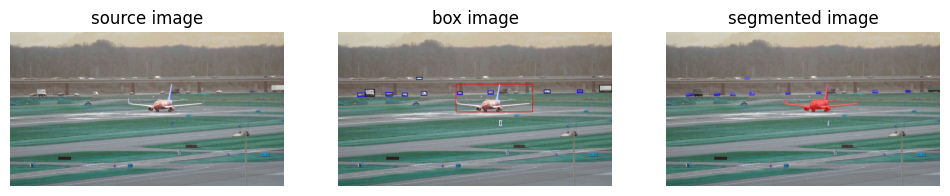


0: 384x640 1 person, 8 cars, 4 airplanes, 3 trucks, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.2262,  241.9221,  912.2484,  374.3851],
        [1221.2542,  247.5315, 1279.4832,  279.9670],
        [ 125.6146,  266.5551,  172.4789,  302.7104],
        [ 299.9112,  285.9296,  325.7384,  299.8728],
        [ 222.8489,  282.7745,  256.7151,  299.6351],
        [ 963.6309,  271.3744,  990.8240,  286.0818],
        [1118.2601,  271.0467, 1142.5848,  282.6250],
        [ 557.9836,  280.4456,  580.7450,  293.3060],
        [ 700.5452,  275.2455,  726.0979,  290.3550],
        [ 388.6176,  278.8218,  413.9796,  297.0150],
        [  91.6183,  284.3806,  129.5222,  302.6597],
        [ 754.1721,  416.4307,  762.6011,  439.1799],
        [ 365.3219,  211.8828,  393.9705,  222.0048]], device='cuda:0')


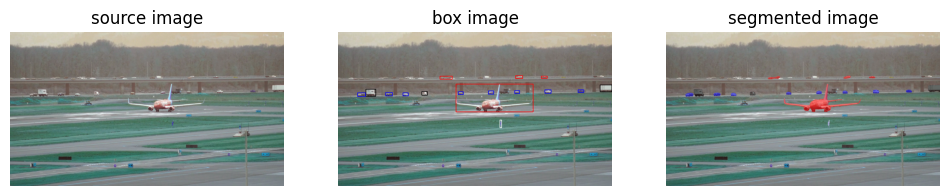


0: 384x640 1 person, 9 cars, 1 airplane, 3 trucks, 31.7ms
Speed: 0.6ms preprocess, 31.7ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 549.9493,  241.7984,  913.2115,  374.1833],
        [ 130.5989,  266.6973,  175.5994,  302.2172],
        [ 304.0261,  284.7743,  328.8997,  298.2256],
        [1224.7688,  247.0002, 1279.4429,  279.3719],
        [  91.9452,  284.0510,  130.9799,  302.2135],
        [ 828.9178,  204.6352,  861.1085,  217.6308],
        [ 562.2417,  280.7470,  584.2874,  292.6236],
        [1121.8762,  271.1541, 1146.9407,  281.6982],
        [ 702.4879,  275.0457,  727.3246,  289.7633],
        [ 222.9883,  283.6559,  254.8333,  298.5974],
        [ 967.3188,  269.7601,  995.1306,  285.8016],
        [ 755.2289,  411.7549,  765.1888,  439.4109],
        [ 392.0366,  277.2067,  416.9315,  296.6453],
        [ 948.0570,  206.6859,  977.5929,  215.3806],
        [ 825.7069,  275.2148,  849.0541,  287.9773],
        [ 475.6219,  204.9318,  531.2254,  221.2848]], device='cuda:0')


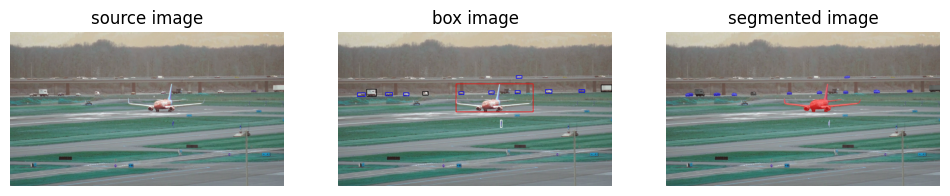


0: 384x640 1 person, 11 cars, 4 airplanes, 2 trucks, 35.4ms
Speed: 0.6ms preprocess, 35.4ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 549.9469,  241.7515,  912.9387,  374.2855],
        [1229.3677,  247.3334, 1279.4175,  279.7104],
        [ 134.2314,  266.4604,  180.7105,  302.1187],
        [ 307.1546,  284.6803,  332.6362,  298.4565],
        [1125.5674,  271.0697, 1151.3428,  281.7476],
        [ 704.4708,  275.4497,  729.0760,  289.9562],
        [ 223.6823,  283.3152,  256.4253,  298.5182],
        [  90.4845,  283.9822,  128.8494,  302.6514],
        [ 970.6928,  270.5919,  999.4090,  285.6383],
        [ 756.8370,  411.3721,  766.7201,  439.5767],
        [ 828.3286,  274.2903,  852.3829,  288.0709],
        [ 564.4095,  280.3135,  587.7159,  292.5613],
        [ 833.2629,  205.0785,  858.6084,  215.9196],
        [ 395.6796,  277.4664,  421.6194,  296.7550]], device='cuda:0')


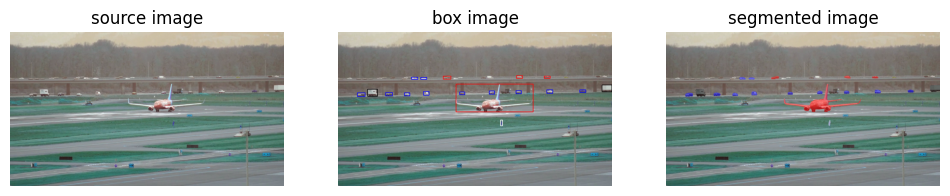


0: 384x640 12 cars, 2 airplanes, 3 trucks, 29.4ms
Speed: 0.5ms preprocess, 29.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.2329,  241.4238,  913.1868,  373.9837],
        [ 138.7372,  266.6081,  184.3798,  302.1526],
        [ 310.0513,  284.6740,  336.3377,  298.6310],
        [ 222.4239,  283.1970,  253.5566,  299.2048],
        [1233.0085,  246.9516, 1279.3513,  279.8553],
        [ 975.9697,  270.2093, 1003.2114,  285.9339],
        [  89.1932,  283.6912,  126.8712,  302.9691],
        [1129.9937,  271.6893, 1154.8765,  282.0473],
        [ 706.0426,  275.4692,  731.2152,  290.4364],
        [ 758.7781,  411.0957,  768.4233,  439.2579],
        [ 400.2537,  278.2521,  424.3134,  296.2432],
        [ 491.0193,  206.7845,  527.0358,  220.5601],
        [ 833.7286,  204.3981,  864.1945,  216.3891],
        [ 832.7534,  274.5081,  856.1929,  288.0602],
        [ 568.3718,  280.3895,  591.6177,  292.6178],
        [ 386.1967,  213.0186,  414.3181,  221.8871],
        [ 962.3317,  206.7892,  991.6199,  215.5199],
        [ 342.7701,  210.7965,  373.3751,  222.0118]], device='cuda:0')


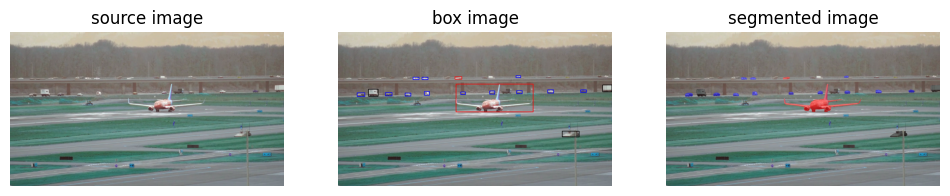


0: 384x640 1 person, 11 cars, 2 airplanes, 4 trucks, 30.3ms
Speed: 0.5ms preprocess, 30.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.1865,  241.2419,  914.0820,  373.9202],
        [ 142.2787,  266.4315,  188.5383,  301.9615],
        [1237.5757,  247.1837, 1279.3345,  279.4437],
        [ 221.0084,  283.0884,  252.7690,  299.2751],
        [ 313.4406,  285.1668,  340.6003,  299.3743],
        [  88.6773,  284.0824,  126.3028,  302.9657],
        [1134.3457,  271.7397, 1159.0986,  282.0153],
        [ 979.6851,  270.9984, 1006.7625,  285.5817],
        [ 708.2208,  275.1826,  732.9901,  290.7109],
        [ 392.2054,  211.6644,  420.8976,  221.8169],
        [ 403.1593,  278.3501,  426.5383,  296.5562],
        [ 545.3837,  208.9958,  578.4788,  220.9147],
        [ 835.2582,  274.6734,  859.2760,  288.1942],
        [ 349.7996,  211.1899,  379.1415,  221.8011],
        [ 832.1552,  205.2716,  851.5592,  213.1888],
        [ 573.4930,  280.1633,  595.6053,  292.8027],
        [1045.3975,  457.3969, 1127.4697,  491.0108]], device='cuda:0')


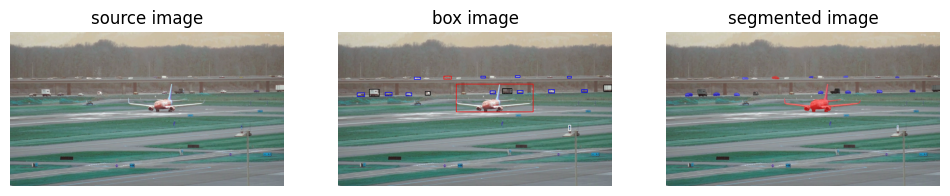


0: 384x640 9 cars, 2 airplanes, 4 trucks, 30.1ms
Speed: 0.7ms preprocess, 30.1ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.5554,  242.0020,  913.4887,  373.6857],
        [ 146.5041,  266.0172,  191.9358,  301.3637],
        [ 317.5912,  284.8964,  344.8938,  298.8027],
        [ 221.2453,  282.7046,  252.4214,  298.6750],
        [1240.7971,  246.9815, 1279.4182,  279.8915],
        [  88.5591,  284.4694,  125.3843,  302.3944],
        [ 984.2749,  270.5643, 1011.2676,  285.7334],
        [1138.0068,  270.7195, 1164.8167,  281.5616],
        [ 829.8014,  204.3968,  850.3190,  211.8228],
        [ 710.3958,  274.9841,  735.0183,  289.5280],
        [ 767.4372,  264.3897,  813.0679,  288.6278],
        [ 839.0580,  273.8522,  864.0450,  287.7821],
        [ 407.4385,  277.6886,  430.3582,  295.7712],
        [ 356.1526,  210.7463,  385.2541,  221.1563],
        [ 666.6224,  206.2984,  690.3474,  216.1682],
        [ 491.1053,  205.9990,  529.6797,  220.9136],
        [1077.4824,  434.2842, 1087.5361,  460.1106],
        [1072.4438,  206.8705, 1090.1104,  214.4925]], device='cuda:0')


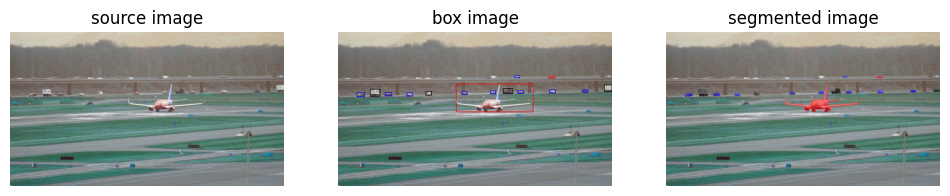


0: 384x640 1 person, 11 cars, 3 airplanes, 4 trucks, 28.6ms
Speed: 0.5ms preprocess, 28.6ms inference, 7.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.5092,  242.1024,  914.8131,  373.9487],
        [ 150.2495,  266.2280,  196.7737,  301.2992],
        [ 321.2866,  285.0229,  348.4523,  299.1303],
        [  87.7729,  284.3311,  125.0780,  302.5854],
        [ 987.9633,  271.4315, 1015.3512,  285.8135],
        [ 220.9060,  283.4131,  252.3360,  298.8787],
        [1245.3625,  247.3480, 1279.4070,  279.8513],
        [1142.5532,  271.1530, 1167.3369,  281.6290],
        [ 842.6602,  274.4014,  867.1238,  287.8719],
        [ 712.3469,  274.9721,  736.3481,  290.0056],
        [ 826.4280,  204.0896,  848.1157,  211.7487],
        [ 770.7326,  264.4187,  817.9069,  288.3661],
        [ 578.9257,  280.0320,  603.0521,  291.9418],
        [ 409.7671,  277.1070,  436.0933,  296.3962],
        [ 983.8197,  206.9364, 1012.9484,  214.8559]], device='cuda:0')


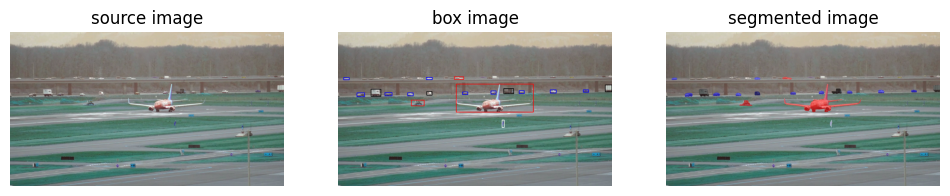


0: 384x640 1 person, 11 cars, 1 airplane, 4 trucks, 64.8ms
Speed: 0.7ms preprocess, 64.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.8518,  242.0656,  915.5594,  374.3754],
        [ 154.5943,  266.3540,  200.1911,  301.7164],
        [ 220.6904,  283.6423,  251.9701,  299.1633],
        [ 325.2863,  284.9157,  351.3672,  299.2669],
        [ 773.4766,  264.4966,  820.8005,  288.7473],
        [  87.4705,  284.2857,  124.3828,  302.8418],
        [ 992.2624,  270.8951, 1019.7073,  286.0427],
        [1146.1973,  271.7690, 1171.2710,  281.7619],
        [ 713.4977,  275.0096,  738.3619,  290.6341],
        [1249.4855,  247.7884, 1279.3986,  279.9604],
        [ 582.3491,  280.1803,  607.1626,  292.2354],
        [ 412.7206,  212.5165,  440.5905,  222.2135],
        [ 414.9430,  278.5863,  439.1284,  295.9237],
        [ 846.4700,  274.2236,  870.4058,  288.2941],
        [ 341.1712,  318.8785,  404.4664,  345.3499],
        [ 541.0164,  209.3786,  588.5774,  221.3943],
        [ 414.7079,  278.3756,  439.2475,  295.9386],
        [ 766.1309,  411.6605,  776.9131,  442.2083],
        [  26.5755,  214.001

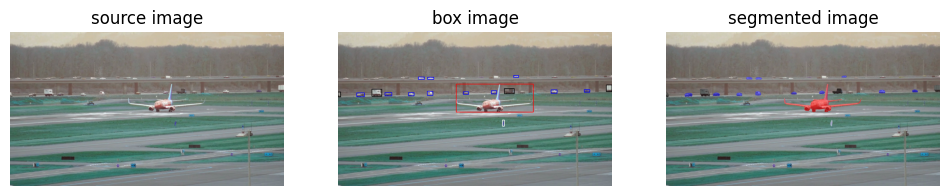


0: 384x640 1 person, 9 cars, 3 airplanes, 4 trucks, 28.6ms
Speed: 0.7ms preprocess, 28.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.5061e+02, 2.4218e+02, 9.1465e+02, 3.7430e+02],
        [1.5849e+02, 2.6542e+02, 2.0483e+02, 3.0097e+02],
        [7.7660e+02, 2.6454e+02, 8.2331e+02, 2.8827e+02],
        [2.2037e+02, 2.8307e+02, 2.5155e+02, 2.9875e+02],
        [3.2990e+02, 2.8392e+02, 3.5616e+02, 2.9891e+02],
        [9.9556e+02, 2.7087e+02, 1.0234e+03, 2.8546e+02],
        [8.7390e+01, 2.8393e+02, 1.2324e+02, 3.0214e+02],
        [1.1503e+03, 2.7091e+02, 1.1755e+03, 2.8170e+02],
        [1.2533e+03, 2.4655e+02, 1.2795e+03, 2.8036e+02],
        [5.8775e+02, 2.8014e+02, 6.0997e+02, 2.9190e+02],
        [4.1867e+02, 2.1205e+02, 4.4801e+02, 2.2139e+02],
        [7.1532e+02, 2.7419e+02, 7.4295e+02, 2.9014e+02],
        [4.1703e+02, 2.7750e+02, 4.4304e+02, 2.9675e+02],
        [7.6771e+02, 4.1225e+02, 7.7854e+02, 4.4019e+02],
        [8.2197e+02, 2.0384e+02, 8.4251e+02, 2.1168e+02],
        [3.7687e+02, 2.1127e+02, 4.0449e+02, 2.2140e+02],
        [1.2741e-03, 2.8043e+02, 1.1901e+01, 3.0340e+02]], device='cuda:

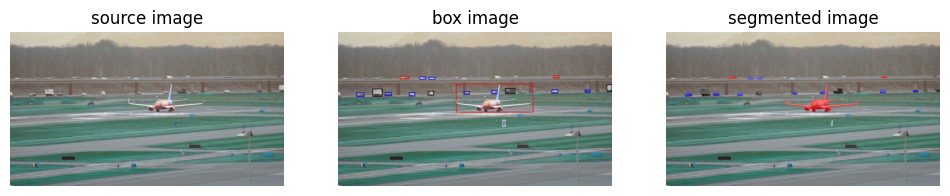


0: 384x640 1 person, 10 cars, 1 airplane, 4 trucks, 28.7ms
Speed: 0.5ms preprocess, 28.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.5651,  241.8719,  914.8602,  374.4717],
        [ 162.4091,  265.8044,  207.8412,  301.4532],
        [ 333.1617,  284.2664,  359.1396,  299.0612],
        [ 219.6381,  283.9260,  251.1692,  298.9706],
        [  87.6089,  283.4190,  122.7819,  302.2301],
        [ 999.7700,  270.5874, 1027.2217,  285.7696],
        [1154.0377,  271.7025, 1178.7479,  281.4257],
        [ 590.9481,  279.7383,  614.1409,  292.4203],
        [ 769.7778,  412.6657,  780.2959,  439.8725],
        [ 780.6931,  263.6176,  826.2548,  288.5433],
        [ 425.4260,  211.2635,  453.3613,  221.4596],
        [1257.0464,  247.0743, 1279.5049,  279.3552],
        [ 717.0660,  274.4827,  744.1379,  290.3113],
        [ 288.5259,  205.7084,  330.3005,  219.0724],
        [1005.3726,  206.5685, 1033.6060,  214.6165],
        [ 382.1776,  211.5449,  410.3710,  221.2827],
        [ 420.6708,  277.1566,  447.0764,  296.3198]], device='cuda:0')


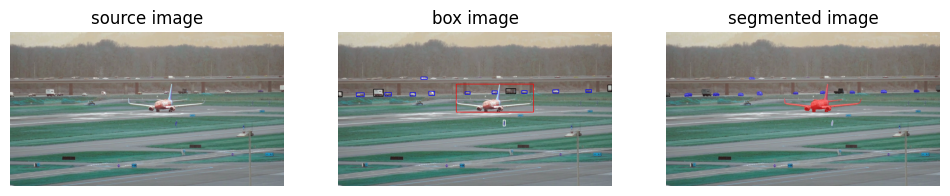


0: 384x640 1 person, 9 cars, 2 airplanes, 5 trucks, 30.2ms
Speed: 0.6ms preprocess, 30.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.5068e+02, 2.4161e+02, 9.1503e+02, 3.7454e+02],
        [1.6658e+02, 2.6625e+02, 2.1212e+02, 3.0102e+02],
        [3.3636e+02, 2.8416e+02, 3.6294e+02, 2.9894e+02],
        [2.2002e+02, 2.8424e+02, 2.5051e+02, 2.9942e+02],
        [1.0038e+03, 2.7082e+02, 1.0316e+03, 2.8579e+02],
        [8.5607e+01, 2.8363e+02, 1.2259e+02, 3.0275e+02],
        [1.2616e+03, 2.4836e+02, 1.2795e+03, 2.7960e+02],
        [8.5842e+02, 2.7459e+02, 8.8278e+02, 2.8779e+02],
        [1.1585e+03, 2.7104e+02, 1.1834e+03, 2.8158e+02],
        [7.8350e+02, 2.6417e+02, 8.2997e+02, 2.8830e+02],
        [7.7095e+02, 4.1291e+02, 7.8188e+02, 4.3963e+02],
        [1.1784e-02, 2.8041e+02, 2.0704e+01, 3.0481e+02],
        [4.2521e+02, 2.7778e+02, 4.5041e+02, 2.9618e+02],
        [3.8796e+02, 2.1117e+02, 4.1642e+02, 2.2122e+02],
        [5.9525e+02, 2.7940e+02, 6.1714e+02, 2.9210e+02],
        [7.1997e+02, 2.7438e+02, 7.4480e+02, 2.8995e+02]], device='cuda:0')


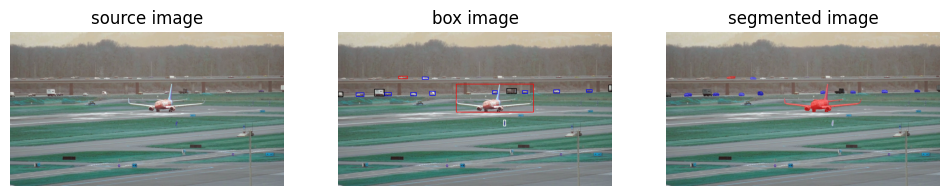


0: 384x640 1 person, 7 cars, 3 airplanes, 4 trucks, 33.6ms
Speed: 0.6ms preprocess, 33.6ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.0714,  241.9324,  915.6027,  373.9683],
        [ 170.3503,  265.1932,  216.7543,  301.4567],
        [  85.2995,  282.7715,  121.4247,  302.4349],
        [ 786.8424,  264.6012,  833.5670,  288.0050],
        [1161.0806,  270.6843, 1187.0742,  281.6217],
        [ 339.2191,  283.0153,  366.6523,  299.0151],
        [   0.0000,  280.4742,   24.3328,  304.7061],
        [1007.7092,  270.4319, 1035.3561,  285.9514],
        [ 220.5190,  283.8544,  249.7363,  298.9627],
        [1265.7219,  248.6411, 1279.5151,  278.9839],
        [ 772.4300,  410.6475,  783.6479,  439.6283],
        [ 862.0548,  273.5998,  886.4020,  287.6975],
        [ 394.0659,  210.5886,  422.4434,  221.0421],
        [ 283.6025,  205.5304,  324.0500,  218.8525],
        [ 720.8204,  274.3507,  745.0675,  289.4160],
        [ 428.6983,  277.4773,  454.2121,  296.9246],
        [ 428.8839,  276.9757,  454.4288,  297.0118]], device='cuda:0')


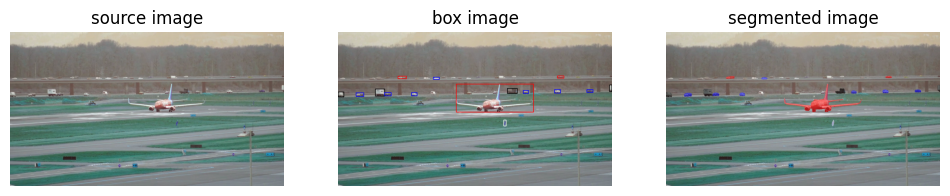


0: 384x640 1 person, 6 cars, 2 airplanes, 5 trucks, 29.4ms
Speed: 0.6ms preprocess, 29.4ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.5094e+02, 2.4170e+02, 9.1564e+02, 3.7389e+02],
        [1.7447e+02, 2.6539e+02, 2.2038e+02, 3.0101e+02],
        [7.9072e+02, 2.6393e+02, 8.3756e+02, 2.8822e+02],
        [8.5135e+01, 2.8327e+02, 1.2075e+02, 3.0234e+02],
        [6.8378e-03, 2.8042e+02, 2.7786e+01, 3.0481e+02],
        [3.4357e+02, 2.8243e+02, 3.6941e+02, 2.9877e+02],
        [1.0125e+03, 2.7080e+02, 1.0396e+03, 2.8538e+02],
        [8.6610e+02, 2.7365e+02, 8.9377e+02, 2.8776e+02],
        [1.1626e+03, 2.7004e+02, 1.1915e+03, 2.8175e+02],
        [1.0255e+03, 2.0650e+02, 1.0552e+03, 2.1411e+02],
        [7.7457e+02, 4.1085e+02, 7.8589e+02, 4.4006e+02],
        [1.2698e+03, 2.4818e+02, 1.2795e+03, 2.7902e+02],
        [4.4558e+02, 2.1157e+02, 4.7382e+02, 2.2151e+02],
        [2.7950e+02, 2.0503e+02, 3.2103e+02, 2.1932e+02],
        [2.1954e+02, 2.8327e+02, 2.4926e+02, 2.9906e+02]], device='cuda:0')


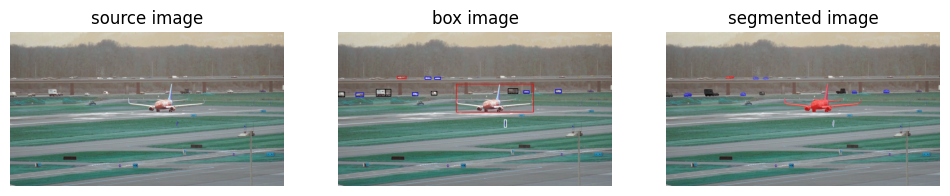


0: 384x640 7 cars, 2 airplanes, 5 trucks, 31.9ms
Speed: 0.7ms preprocess, 31.9ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.5095e+02, 2.4181e+02, 9.1484e+02, 3.7387e+02],
        [8.4618e+01, 2.8345e+02, 1.2013e+02, 3.0239e+02],
        [1.7821e+02, 2.6568e+02, 2.4736e+02, 3.0093e+02],
        [5.3766e-02, 2.8042e+02, 3.1337e+01, 3.0536e+02],
        [3.4688e+02, 2.8260e+02, 3.7411e+02, 2.9887e+02],
        [1.0162e+03, 2.7044e+02, 1.0437e+03, 2.8577e+02],
        [8.6790e+02, 2.7377e+02, 8.9368e+02, 2.8784e+02],
        [1.7803e+02, 2.6579e+02, 2.2493e+02, 3.0085e+02],
        [2.7680e+02, 2.0532e+02, 3.1871e+02, 2.1853e+02],
        [7.9406e+02, 2.6379e+02, 8.3984e+02, 2.8828e+02],
        [4.5146e+02, 2.1133e+02, 4.7998e+02, 2.2148e+02],
        [4.0714e+02, 2.1081e+02, 4.3540e+02, 2.2169e+02],
        [7.7620e+02, 4.1142e+02, 7.8825e+02, 4.4369e+02],
        [4.3558e+02, 2.7683e+02, 4.6051e+02, 2.9633e+02]], device='cuda:0')


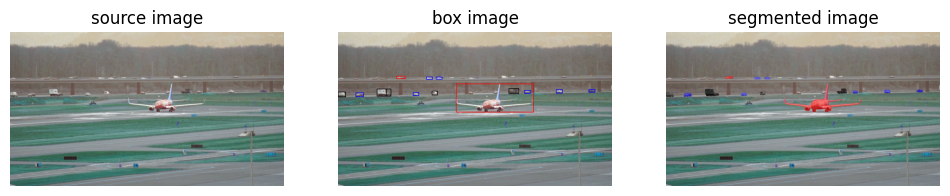


0: 384x640 8 cars, 1 airplane, 3 trucks, 31.7ms
Speed: 0.7ms preprocess, 31.7ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.5109e+02, 2.4175e+02, 9.1516e+02, 3.7380e+02],
        [8.3901e+01, 2.8341e+02, 1.1940e+02, 3.0256e+02],
        [1.8270e+02, 2.6555e+02, 2.4773e+02, 3.0053e+02],
        [3.5162e+02, 2.8353e+02, 3.7736e+02, 2.9826e+02],
        [1.0205e+03, 2.7055e+02, 1.0481e+03, 2.8529e+02],
        [4.2280e-01, 2.7989e+02, 3.5756e+01, 3.0470e+02],
        [8.7188e+02, 2.7351e+02, 8.9711e+02, 2.8754e+02],
        [1.1725e+03, 2.7017e+02, 1.2002e+03, 2.8091e+02],
        [2.7414e+02, 2.0529e+02, 3.1483e+02, 2.1837e+02],
        [4.1365e+02, 2.1093e+02, 4.4235e+02, 2.2086e+02],
        [1.8233e+02, 2.6564e+02, 2.2495e+02, 3.0028e+02],
        [7.9762e+02, 2.6386e+02, 8.4534e+02, 2.8827e+02],
        [4.4011e+02, 2.7712e+02, 4.6286e+02, 2.9547e+02],
        [4.5840e+02, 2.1055e+02, 4.8766e+02, 2.2090e+02]], device='cuda:0')


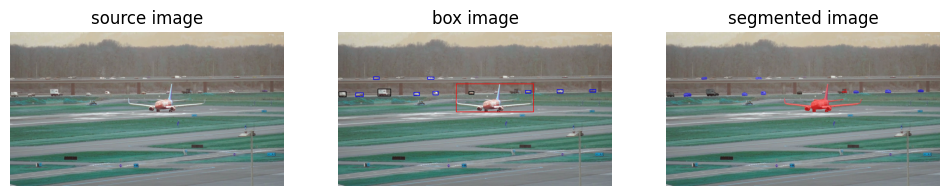


0: 384x640 1 person, 6 cars, 2 airplanes, 3 trucks, 32.0ms
Speed: 0.6ms preprocess, 32.0ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.2007,  241.8262,  916.6626,  374.1902],
        [ 186.9092,  265.1871,  247.6530,  301.0524],
        [  83.0585,  283.7356,  118.4713,  302.7579],
        [ 355.3289,  283.6917,  381.0549,  297.7313],
        [   3.1419,  279.6663,   40.3125,  304.9173],
        [1024.2659,  270.0838, 1051.7517,  285.4324],
        [1177.5768,  269.6284, 1203.8988,  280.9038],
        [ 875.9550,  273.2212,  900.7214,  287.3640],
        [ 443.1995,  276.7904,  467.7906,  295.1035],
        [ 419.6548,  210.6019,  448.6105,  220.8325],
        [ 612.6036,  279.4304,  635.4752,  291.9861],
        [ 163.8962,  208.9529,  194.3309,  222.0730]], device='cuda:0')


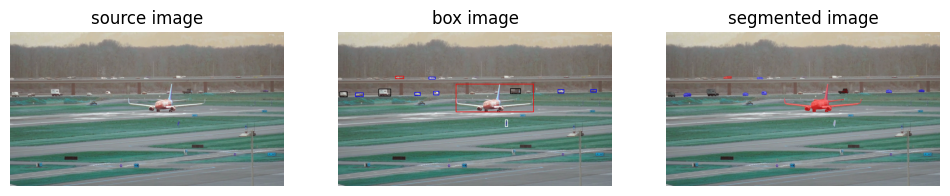


0: 384x640 1 person, 5 cars, 2 airplanes, 3 trucks, 28.8ms
Speed: 0.6ms preprocess, 28.8ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.9319,  241.9746,  917.1244,  374.3959],
        [ 190.4705,  265.8204,  247.1478,  300.3894],
        [  81.2423,  283.0391,  118.3397,  303.1902],
        [ 359.0679,  283.6104,  384.3824,  298.0235],
        [   8.9563,  279.7335,   43.5372,  304.5696],
        [1028.1738,  270.5082, 1055.7056,  285.2226],
        [ 447.2477,  277.0200,  470.9316,  292.8079],
        [ 268.3820,  205.8458,  308.0063,  218.2895],
        [ 804.4424,  263.5980,  854.6635,  288.6836],
        [1181.8627,  269.5023, 1207.6603,  281.0424],
        [ 425.7160,  210.3197,  454.2341,  220.9932],
        [ 782.5994,  411.5669,  792.9398,  439.9001]], device='cuda:0')


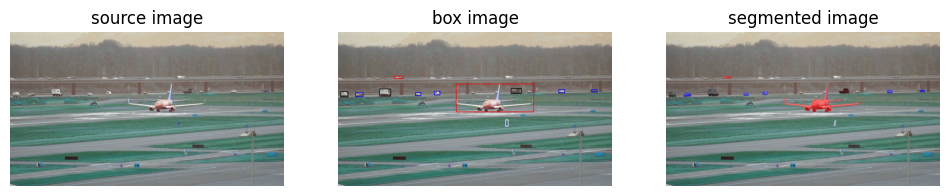


0: 384x640 1 person, 5 cars, 4 airplanes, 3 trucks, 29.3ms
Speed: 0.6ms preprocess, 29.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.8969,  242.0933,  917.2066,  374.3870],
        [ 194.2746,  265.8127,  247.1948,  301.2947],
        [  80.7416,  283.5390,  118.0240,  303.2401],
        [ 361.5856,  283.3853,  387.5167,  298.4444],
        [ 807.9128,  263.7314,  856.6936,  288.2520],
        [1032.0637,  270.4950, 1059.6262,  285.1555],
        [  12.9232,  280.0289,   47.5359,  304.7813],
        [1184.4552,  269.7428, 1211.2990,  280.9889],
        [ 450.8754,  277.2020,  475.2773,  294.1924],
        [ 783.6011,  411.8740,  795.2284,  439.1318],
        [ 265.2042,  206.2031,  304.6970,  218.5528]], device='cuda:0')


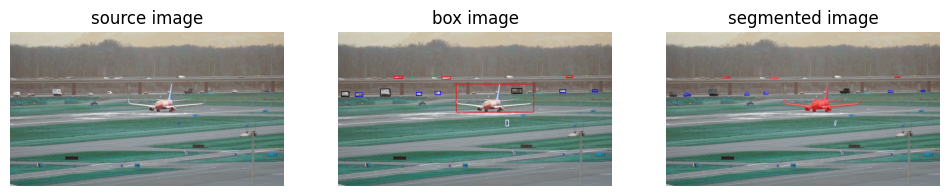


0: 384x640 1 person, 6 cars, 3 airplanes, 3 trucks, 30.0ms
Speed: 0.5ms preprocess, 30.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 551.1120,  242.2417,  916.9444,  374.3656],
        [ 198.9360,  266.5048,  243.7522,  300.3553],
        [  80.8975,  283.5481,  117.1087,  303.1044],
        [ 365.0914,  283.1288,  392.3396,  298.5023],
        [  16.1254,  279.1237,   51.3779,  305.1463],
        [1036.2606,  270.1735, 1063.9635,  284.9853],
        [ 810.6689,  263.1450,  858.7783,  288.7169],
        [ 454.5120,  277.1662,  479.0726,  292.4405],
        [ 784.8772,  412.0364,  796.8459,  438.8718],
        [ 484.0012,  206.2796,  527.5457,  220.6990],
        [1188.3545,  270.0192, 1213.7759,  280.6443],
        [ 262.1697,  205.6704,  302.2911,  217.6747],
        [1066.4797,  205.1367, 1095.9934,  213.9577]], device='cuda:0')


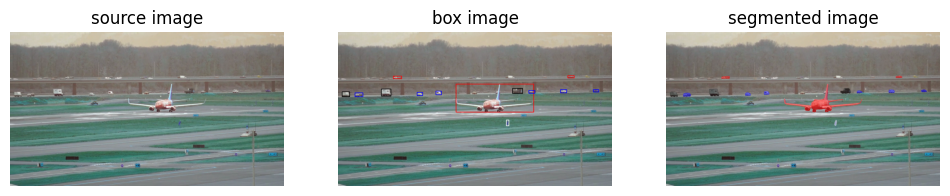


0: 384x640 1 person, 7 cars, 3 airplanes, 3 trucks, 32.8ms
Speed: 0.6ms preprocess, 32.8ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.8953,  241.7776,  918.1233,  375.0129],
        [ 202.8695,  265.9130,  247.7136,  300.6591],
        [  79.6468,  283.0487,  116.7247,  303.2283],
        [1040.2939,  269.7442, 1068.1577,  284.8811],
        [  19.8330,  279.1392,   55.8342,  304.9357],
        [ 369.4023,  283.4919,  395.4279,  298.0923],
        [ 813.5040,  263.3592,  861.9819,  287.7989],
        [1191.8867,  270.0115, 1217.9487,  280.7883],
        [ 786.9542,  411.6534,  798.2150,  438.1258],
        [ 458.4966,  277.1706,  482.7594,  292.0090],
        [1072.5623,  204.7134, 1103.3484,  213.8782],
        [ 256.9226,  205.8321,  298.3677,  218.8081],
        [ 890.8951,  273.5099,  917.4073,  286.5216]], device='cuda:0')


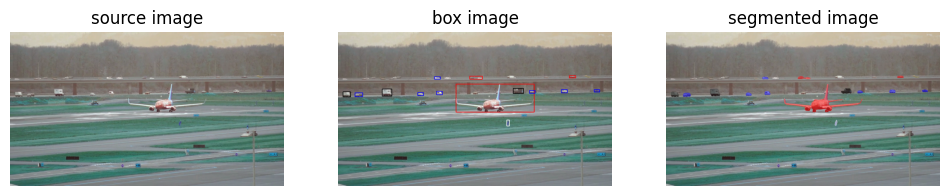


0: 384x640 1 person, 7 cars, 2 airplanes, 3 trucks, 31.3ms
Speed: 0.5ms preprocess, 31.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.6645,  241.8968,  917.3173,  375.1491],
        [ 206.2081,  265.0967,  252.1284,  301.1568],
        [  79.3471,  283.3224,  115.4571,  303.3542],
        [  23.1636,  278.7081,   59.8662,  305.1193],
        [ 373.2206,  283.7924,  398.2675,  297.8320],
        [1044.1422,  270.0984, 1072.2965,  284.6065],
        [1196.2620,  270.0101, 1222.7009,  281.0790],
        [ 788.2241,  410.5727,  800.0701,  438.7742],
        [ 817.6537,  263.8589,  865.2584,  288.5400],
        [ 615.9784,  205.4087,  674.3674,  220.3356],
        [ 451.1731,  208.2728,  478.6118,  219.9668],
        [ 461.8240,  277.0037,  487.0798,  292.5418],
        [1080.5774,  205.1073, 1110.1677,  213.8115],
        [ 894.4476,  273.1283,  920.6996,  287.2130]], device='cuda:0')


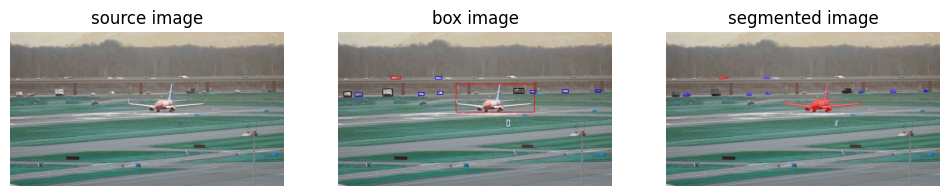


0: 384x640 7 cars, 2 airplanes, 3 trucks, 30.3ms
Speed: 0.7ms preprocess, 30.3ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 548.5037,  241.7999,  916.2720,  375.0476],
        [ 209.9783,  265.4969,  255.1595,  300.5622],
        [1047.8037,  269.4778, 1076.0674,  284.8377],
        [  78.8947,  283.6429,  115.0450,  303.1507],
        [  27.4232,  278.9708,   62.9609,  305.0208],
        [ 376.2485,  283.5645,  401.8054,  297.8598],
        [ 246.0410,  205.1355,  291.3646,  221.3208],
        [ 790.2867,  412.0311,  801.6655,  439.4649],
        [ 819.7645,  262.8444,  869.7828,  288.2649],
        [ 456.3773,  207.9777,  484.9507,  220.6873],
        [1198.9302,  270.0470, 1226.1006,  281.2230],
        [ 896.4553,  273.4307,  922.1816,  287.3501],
        [ 464.6646,  277.3767,  489.2105,  291.8704]], device='cuda:0')


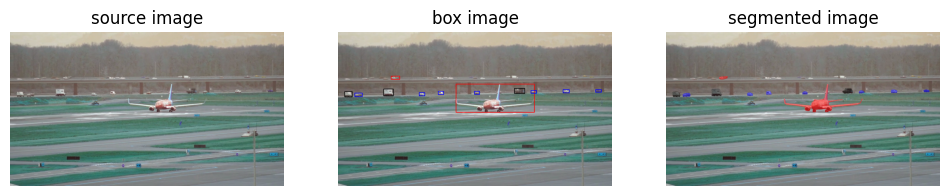


0: 384x640 1 person, 7 cars, 3 airplanes, 4 trucks, 31.5ms
Speed: 0.6ms preprocess, 31.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 549.1747,  241.9600,  918.0800,  375.0164],
        [ 212.3913,  266.2925,  259.5002,  300.7610],
        [1051.8287,  270.0354, 1080.3199,  284.9215],
        [ 379.3306,  283.5121,  406.0836,  298.0802],
        [ 823.6446,  262.7281,  873.1014,  288.2527],
        [  31.1707,  278.6277,   66.5347,  304.4836],
        [ 247.5156,  205.2427,  289.1928,  220.3537],
        [1203.3691,  269.6184, 1230.1040,  281.0271],
        [  77.3558,  284.4487,  114.6264,  303.4341],
        [ 468.8304,  277.6085,  492.8802,  291.2191],
        [ 901.1808,  273.2042,  925.6945,  287.3629],
        [ 636.9636,  278.9938,  661.6377,  292.0018]], device='cuda:0')


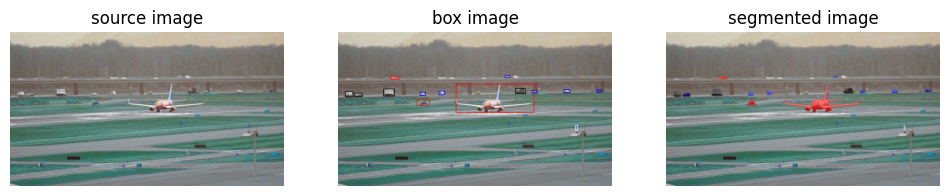


0: 384x640 6 cars, 2 airplanes, 3 trucks, 28.7ms
Speed: 0.6ms preprocess, 28.7ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 549.3116,  241.4074,  919.9221,  374.9731],
        [ 211.5319,  265.5757,  263.6981,  301.2659],
        [1056.0725,  269.7889, 1084.1248,  284.6624],
        [ 383.8905,  283.7518,  408.9272,  298.1190],
        [ 828.5817,  262.2721,  876.3282,  288.1101],
        [  34.3654,  278.5477,   69.7191,  304.5754],
        [ 243.3851,  205.2248,  285.9054,  220.9406],
        [ 472.5832,  278.0557,  495.6288,  292.7402],
        [1207.2810,  270.1311, 1231.8093,  281.0210],
        [ 904.6348,  273.0620,  929.2218,  287.0405],
        [  76.8343,  283.9813,  114.2162,  303.1009],
        [  76.6039,  283.9777,  114.1900,  302.9847],
        [ 368.4205,  317.2353,  429.3643,  343.9822],
        [1109.3281,  434.2932, 1120.5024,  460.7323],
        [ 779.6343,  204.3900,  802.9283,  213.5674]], device='cuda:0')


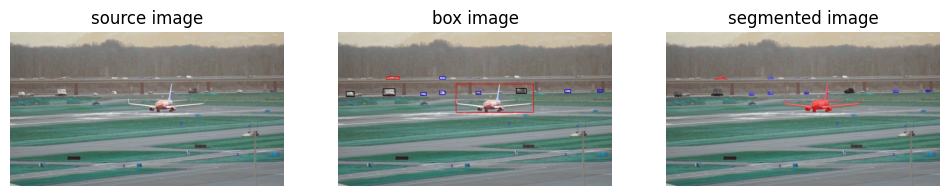


0: 384x640 6 cars, 1 airplane, 3 trucks, 29.4ms
Speed: 0.7ms preprocess, 29.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.2850,  241.5660,  920.7684,  375.2169],
        [ 210.4775,  265.3325,  267.1943,  300.7560],
        [1059.7327,  270.4223, 1087.0227,  284.1334],
        [ 387.5816,  283.9797,  412.5219,  297.5724],
        [ 831.7570,  262.9662,  878.4478,  288.0632],
        [  38.6893,  278.6704,   76.3593,  304.8327],
        [1211.7561,  270.1644, 1237.1606,  280.7585],
        [ 475.1010,  277.4325,  499.9724,  291.9546],
        [ 224.4287,  205.3682,  280.9900,  220.9654],
        [ 474.9875,  209.6011,  503.9431,  220.2976],
        [ 644.0018,  278.3548,  667.9198,  291.5344]], device='cuda:0')


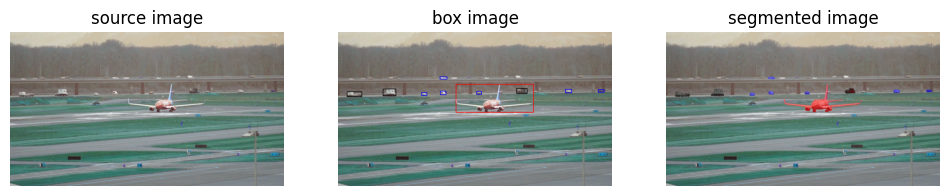


0: 384x640 1 person, 5 cars, 3 airplanes, 3 trucks, 31.6ms
Speed: 0.6ms preprocess, 31.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.0210,  242.2247,  915.0383,  375.1636],
        [ 209.7500,  265.0706,  270.0953,  301.0267],
        [1063.3257,  269.5817, 1091.8677,  284.2927],
        [ 391.1233,  283.6613,  416.0551,  297.9500],
        [  41.7178,  278.2552,  113.5111,  304.3630],
        [1216.3695,  271.0169, 1241.3783,  280.5113],
        [ 479.3928,  277.6034,  503.2846,  290.9908],
        [ 833.8538,  262.6786,  882.6099,  288.1129],
        [ 647.7601,  279.3756,  670.7292,  291.3468],
        [ 475.5429,  209.0504,  511.9111,  220.0038]], device='cuda:0')


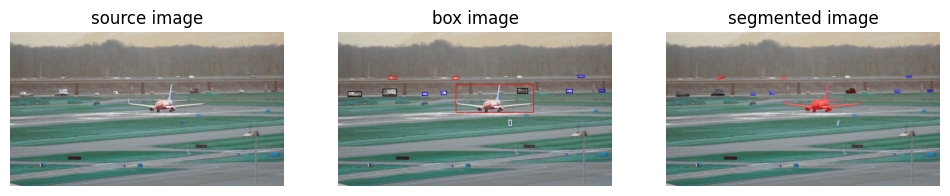


0: 384x640 6 cars, 2 airplanes, 3 trucks, 28.7ms
Speed: 0.6ms preprocess, 28.7ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.2703,  242.6492,  915.1904,  375.4330],
        [ 209.2193,  265.2104,  274.7249,  300.9203],
        [1066.9816,  269.5365, 1094.6581,  284.3861],
        [ 837.6234,  263.4996,  886.9840,  288.1112],
        [ 393.3646,  283.2258,  420.5291,  298.6269],
        [  45.6240,  278.2094,  111.5150,  304.0880],
        [1218.5562,  269.3312, 1244.7476,  280.6801],
        [ 481.8219,  276.6561,  507.0336,  292.1722],
        [ 235.8122,  206.2783,  274.8111,  221.5286],
        [1120.3628,  202.0654, 1151.3560,  212.7631],
        [ 798.3673,  412.5079,  810.1232,  438.4933],
        [ 532.3979,  208.8805,  564.7717,  220.8509]], device='cuda:0')


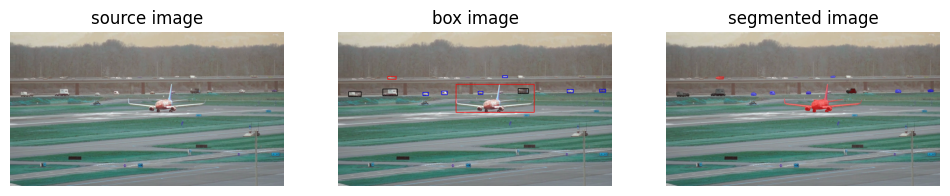


0: 384x640 1 person, 8 cars, 1 airplane, 4 trucks, 29.5ms
Speed: 0.6ms preprocess, 29.5ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.2703,  242.5148,  916.2214,  375.4095],
        [ 208.7205,  265.6644,  277.3486,  300.4284],
        [ 396.9233,  283.2145,  422.8281,  297.6606],
        [  48.9606,  278.3084,  109.9581,  303.8307],
        [1071.3403,  268.9594, 1098.5269,  284.3559],
        [ 840.0715,  262.7846,  889.5997,  288.4042],
        [1222.3236,  269.0417, 1247.5814,  280.7548],
        [ 231.2616,  206.3155,  273.3103,  220.8947],
        [ 654.0143,  279.0070,  677.6083,  291.0295],
        [ 485.0760,  276.2714,  510.3079,  292.5902],
        [ 769.0037,  204.8370,  789.9968,  212.8159]], device='cuda:0')


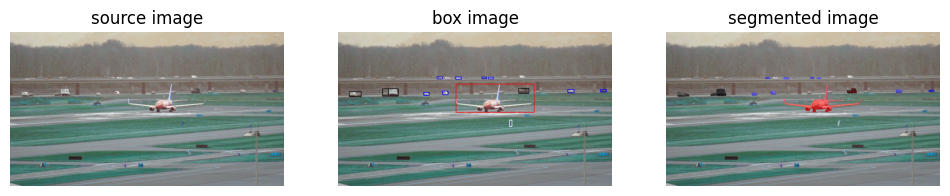


0: 384x640 1 person, 10 cars, 1 airplane, 4 trucks, 30.0ms
Speed: 0.5ms preprocess, 30.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 550.4050,  241.8931,  918.4519,  375.6751],
        [ 844.7347,  263.6476,  891.9240,  288.2504],
        [  53.3593,  278.2207,  108.8982,  303.9805],
        [1074.5731,  269.0364, 1101.7074,  283.9500],
        [1226.6678,  269.2164, 1253.4232,  280.1275],
        [ 400.1541,  283.0005,  427.6537,  297.7180],
        [ 207.6338,  264.6458,  282.0395,  300.0230],
        [ 234.9051,  265.1106,  282.1420,  299.9313],
        [ 488.5414,  276.0697,  513.3436,  292.4287],
        [ 672.2562,  210.1502,  694.4584,  218.7162],
        [ 800.8380,  413.4614,  812.9117,  437.9808],
        [ 458.9100,  209.0501,  485.9085,  220.1425],
        [ 702.4675,  210.9490,  726.7732,  220.4431],
        [ 548.0534,  209.7136,  576.5563,  220.3049]], device='cuda:0')


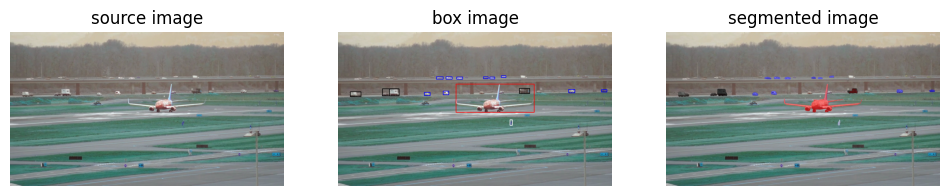


0: 384x640 2 persons, 6 cars, 1 airplane, 4 trucks, 29.4ms
Speed: 0.6ms preprocess, 29.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 549.6085,  241.5055,  918.1769,  375.8244],
        [ 403.8332,  283.0598,  429.9303,  297.5744],
        [  56.7421,  278.4406,  108.0440,  303.8998],
        [1078.3757,  268.8074, 1106.0024,  283.9390],
        [ 847.1506,  264.4881,  894.7390,  288.3557],
        [ 491.9741,  276.8278,  516.4502,  292.1607],
        [1230.5686,  269.4709, 1256.2258,  280.4124],
        [ 708.6556,  211.1212,  733.2814,  220.3963],
        [ 238.1254,  265.2827,  285.6776,  299.9010],
        [ 459.2703,  209.8333,  491.2301,  219.7768],
        [ 206.6276,  265.3100,  285.9437,  299.9351],
        [ 679.4819,  209.7213,  700.5605,  218.1808],
        [ 802.4343,  412.8785,  814.1979,  437.9274],
        [ 763.6426,  204.5208,  783.7592,  211.7739],
        [ 505.7714,  209.2672,  534.0380,  219.9487],
        [ 553.7349,  209.8417,  582.4290,  220.7179]], device='cuda:0')


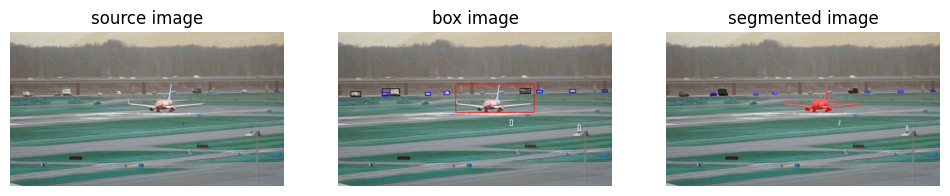


0: 384x640 1 person, 10 cars, 1 airplane, 5 trucks, 28.7ms
Speed: 0.7ms preprocess, 28.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 549.2079,  241.5326,  918.4117,  375.7708],
        [ 408.0284,  283.6136,  432.3735,  297.1824],
        [  60.3560,  278.4926,  107.8545,  303.8155],
        [1081.5616,  269.2040, 1109.7814,  284.2588],
        [ 205.6074,  264.8165,  288.3879,  300.1591],
        [1233.6501,  269.1478, 1259.2275,  280.3513],
        [ 243.5349,  265.4651,  288.3556,  299.9376],
        [ 496.3575,  276.8159,  519.8582,  292.4553],
        [ 804.0827,  411.7077,  815.8398,  438.1131],
        [ 847.9673,  263.9716,  898.2322,  288.3351],
        [1120.8091,  434.5377, 1131.0220,  458.8636],
        [ 927.6483,  273.3231,  955.3813,  284.9332],
        [ 205.1919,  283.5086,  236.8171,  300.1723]], device='cuda:0')


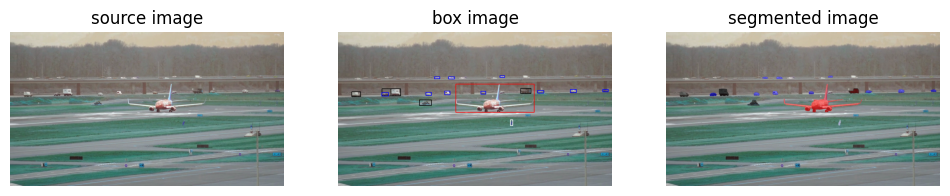


0: 384x640 8 cars, 1 airplane, 5 trucks, 28.9ms
Speed: 0.6ms preprocess, 28.9ms inference, 8.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 548.8035,  241.4789,  918.1174,  375.7325],
        [ 410.6974,  283.6943,  436.5835,  297.4696],
        [1085.4409,  268.9432, 1114.0039,  284.1182],
        [1237.7487,  269.4920, 1262.5936,  280.1177],
        [  64.4705,  278.8790,  106.6674,  303.5612],
        [ 246.9612,  265.6429,  292.7679,  299.0822],
        [ 206.0983,  265.2660,  293.0657,  299.4762],
        [ 516.2892,  209.5615,  544.5031,  219.3499],
        [ 449.7136,  209.5264,  478.1056,  220.2684],
        [ 205.0600,  283.9449,  235.8678,  299.7441],
        [ 498.3597,  276.4910,  524.1432,  292.9800],
        [ 377.4791,  316.7625,  438.3853,  343.5541],
        [ 850.5942,  263.8146,  902.5052,  288.7654],
        [ 805.1658,  411.1489,  817.2114,  438.1761],
        [ 666.9147,  277.9468,  689.4645,  290.7220],
        [ 757.3694,  203.9362,  778.3465,  212.4286],
        [ 931.7212,  273.2098,  960.6890,  284.9827]], device='cuda:0')


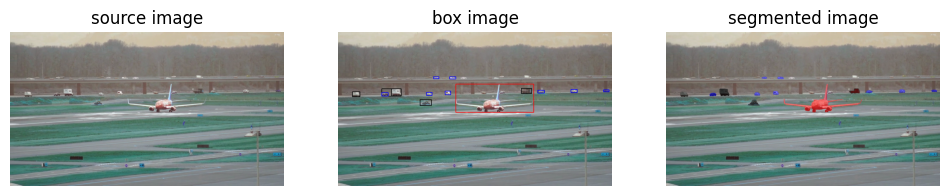


0: 384x640 9 cars, 1 airplane, 4 trucks, 31.6ms
Speed: 0.7ms preprocess, 31.6ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 548.3279,  242.1669,  916.9666,  375.9730],
        [ 413.5973,  283.7595,  438.5871,  296.9806],
        [ 251.0725,  265.5257,  295.7119,  299.3758],
        [  68.0321,  279.1140,  104.2392,  303.3521],
        [1089.2117,  268.8084, 1117.3938,  283.8775],
        [1240.4363,  270.1863, 1266.3640,  280.3015],
        [ 379.0022,  315.2365,  438.6177,  343.6051],
        [ 502.2380,  276.9124,  525.5132,  292.1789],
        [ 204.0225,  264.3896,  295.8536,  299.9474],
        [ 203.6252,  284.0835,  234.3251,  299.5967],
        [ 935.0067,  272.8755,  962.0343,  284.6723],
        [ 853.1217,  263.6528,  905.5182,  288.2243],
        [ 521.6729,  208.8716,  550.1023,  219.5787],
        [ 445.2712,  209.8191,  471.4385,  218.8625]], device='cuda:0')


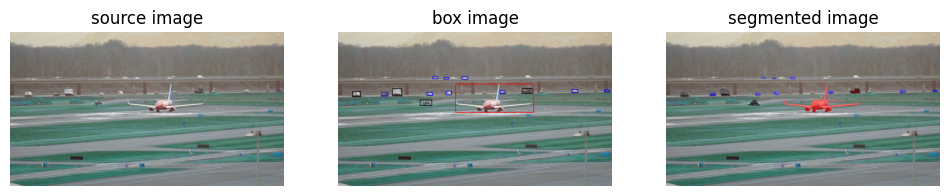


0: 384x640 9 cars, 1 airplane, 3 trucks, 29.4ms
Speed: 0.6ms preprocess, 29.4ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 547.4744,  241.8295,  916.8630,  376.0336],
        [ 254.6682,  264.8470,  299.7092,  299.7923],
        [ 416.3082,  283.3876,  442.2606,  297.0740],
        [  67.4798,  279.4727,  105.9379,  303.4800],
        [ 202.6592,  284.0381,  234.6750,  300.0525],
        [1092.4177,  268.5347, 1120.7039,  283.7935],
        [1245.2130,  270.2206, 1270.1552,  280.2118],
        [ 503.9760,  276.3913,  528.7653,  293.7323],
        [ 381.6204,  317.2641,  440.2579,  343.6441],
        [ 756.0641,  274.5726,  781.0516,  288.8563],
        [ 576.5114,  208.7317,  606.9313,  219.3497],
        [ 440.0829,  209.3838,  466.8087,  217.6276],
        [ 493.7927,  210.5511,  516.1171,  220.3994],
        [ 854.4939,  263.2058,  908.2847,  288.6271]], device='cuda:0')


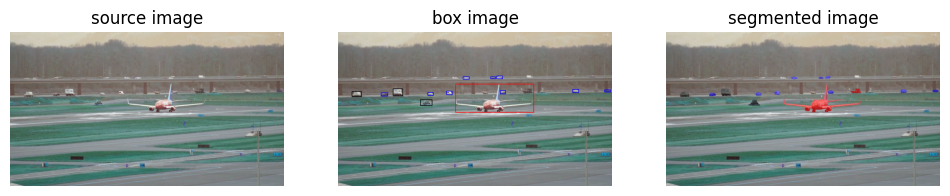


0: 384x640 5 cars, 2 airplanes, 2 trucks, 31.3ms
Speed: 0.6ms preprocess, 31.3ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 547.6393,  241.9102,  915.6691,  376.0189],
        [ 419.7296,  283.3819,  444.6320,  296.7873],
        [ 256.9498,  264.9287,  302.2422,  299.7454],
        [1096.7555,  268.5999, 1124.0602,  283.6389],
        [  64.7895,  278.6037,  109.4140,  303.8199],
        [ 201.1588,  284.6451,  233.1454,  300.0609],
        [ 508.1490,  276.9103,  532.7806,  293.4592],
        [ 741.0368,  206.5724,  767.2138,  218.0409],
        [ 584.6434,  208.9645,  612.5511,  219.9921],
        [ 382.8606,  316.1043,  441.6440,  343.5508],
        [ 712.9152,  208.9879,  737.2994,  218.0120],
        [ 756.3721,  273.5397,  782.2994,  288.9362],
        [1246.0067,  269.9324, 1272.4625,  280.2592]], device='cuda:0')


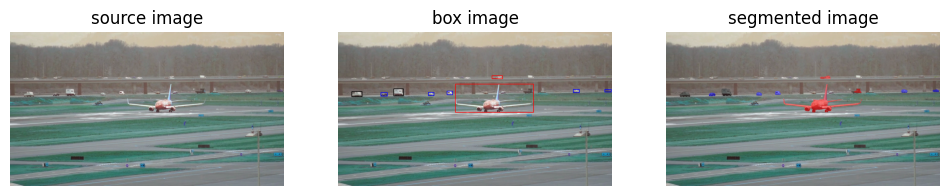


0: 384x640 4 cars, 4 airplanes, 5 trucks, 30.4ms
Speed: 0.5ms preprocess, 30.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 546.8096,  242.3902,  916.1428,  376.1995],
        [ 259.7148,  265.1841,  305.4576,  299.8282],
        [  64.1047,  279.0475,  113.2844,  303.8640],
        [1100.0166,  269.3193, 1127.4058,  283.9803],
        [ 422.3230,  282.7281,  448.0540,  296.8723],
        [ 200.4344,  284.2510,  232.0203,  300.3958],
        [ 510.3577,  277.1273,  535.2602,  293.2920],
        [1246.5951,  269.0860, 1275.8129,  280.3797],
        [ 720.6307,  204.9568,  770.0764,  219.2757]], device='cuda:0')


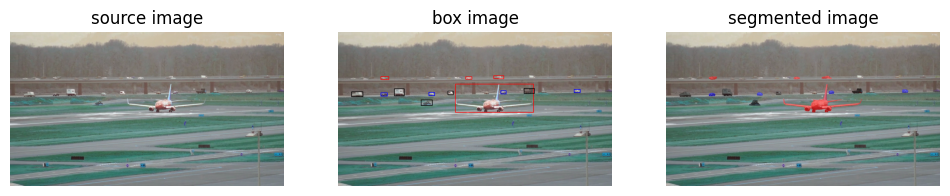


0: 384x640 7 cars, 2 airplanes, 5 trucks, 30.4ms
Speed: 3.7ms preprocess, 30.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 546.7086,  242.0555,  915.8788,  376.3169],
        [  63.9239,  279.7497,  116.3820,  303.9896],
        [ 263.4813,  265.2656,  309.7378,  299.7722],
        [ 425.1234,  282.9576,  451.3630,  297.3981],
        [1103.5792,  268.5052, 1131.5358,  283.9590],
        [ 199.6781,  284.6491,  231.1475,  300.3441],
        [ 727.0347,  205.8216,  774.2253,  218.7715],
        [ 199.9285,  206.6613,  239.5127,  221.0562],
        [ 868.0568,  263.9736,  918.1074,  288.2096],
        [ 513.9470,  277.0418,  539.4407,  293.3730],
        [ 384.2875,  317.4241,  441.7510,  343.6221],
        [ 596.3051,  209.1703,  625.7147,  220.0407],
        [ 760.8935,  274.3617,  785.5891,  289.1451]], device='cuda:0')


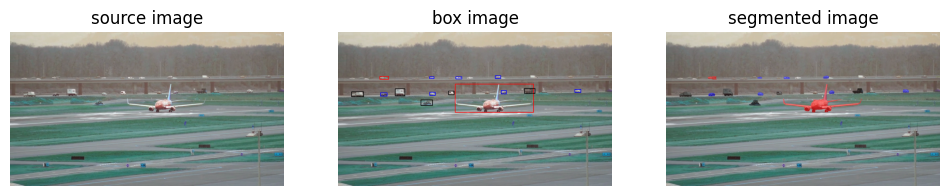


0: 384x640 1 person, 5 cars, 1 airplane, 4 trucks, 63.2ms
Speed: 0.6ms preprocess, 63.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 546.5573,  241.9809,  914.7128,  376.0840],
        [ 429.3257,  282.7886,  454.0737,  296.3760],
        [ 266.7694,  264.9293,  312.2042,  299.4675],
        [  62.6322,  278.0017,  120.2544,  303.7492],
        [ 198.8657,  284.3945,  229.7432,  300.0360],
        [ 870.5701,  263.6937,  920.3357,  287.5841],
        [ 734.8043,  205.1793,  759.9618,  216.7577],
        [1107.3518,  268.3745, 1133.9026,  283.1270],
        [ 516.1910,  275.9843,  541.8292,  293.5496],
        [ 385.2681,  318.4203,  443.4674,  343.7689],
        [ 427.2716,  209.5804,  448.8404,  218.2519],
        [ 761.9675,  273.8088,  785.8098,  288.7223],
        [ 550.7074,  209.0666,  578.3781,  219.3146],
        [ 195.1629,  205.9840,  237.2509,  219.4944]], device='cuda:0')


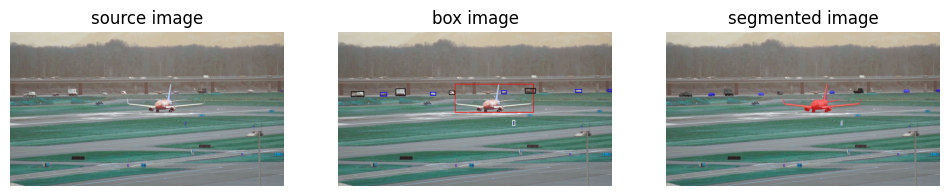


0: 384x640 1 person, 6 cars, 1 airplane, 6 trucks, 30.8ms
Speed: 0.6ms preprocess, 30.8ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 545.9838,  242.4175,  913.9893,  376.2772],
        [ 432.2770,  282.9348,  457.0942,  296.5230],
        [ 269.3926,  265.1442,  317.4315,  298.9053],
        [ 197.1554,  283.6319,  229.4609,  300.2990],
        [  61.0451,  278.2073,  122.4995,  304.2321],
        [ 874.9030,  265.1466,  924.1146,  287.5916],
        [1110.7136,  268.0919, 1138.6375,  283.5179],
        [ 763.6468,  274.2846,  787.2769,  289.1218],
        [1261.6058,  266.5506, 1279.4977,  279.2809],
        [ 519.7824,  275.9996,  545.3151,  293.1539],
        [ 815.1726,  412.6548,  825.8838,  438.3096]], device='cuda:0')


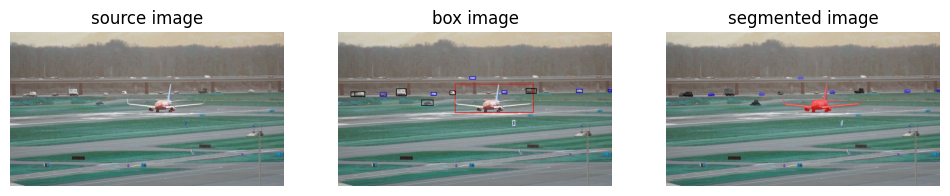


0: 384x640 1 person, 7 cars, 1 airplane, 2 trucks, 29.6ms
Speed: 0.6ms preprocess, 29.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 545.8275,  242.1542,  914.1791,  376.3399],
        [ 272.6810,  264.7736,  319.8604,  299.6082],
        [ 435.3884,  282.9987,  460.4346,  296.7796],
        [ 196.7154,  284.4793,  227.9521,  300.4595],
        [1113.6604,  268.6652, 1142.1296,  283.7979],
        [ 878.0885,  266.3397,  925.4945,  287.3006],
        [  60.6120,  278.3710,  126.0962,  303.8945],
        [ 522.0006,  275.7847,  548.5374,  293.9666],
        [  79.7174,  278.8927,  125.9174,  303.1432],
        [ 764.8317,  274.6985,  789.4071,  288.8429],
        [1262.8041,  267.0457, 1279.5040,  279.7018],
        [ 389.0256,  318.7538,  445.4841,  343.4588],
        [ 614.8941,  209.3897,  642.8514,  220.1824],
        [ 815.7281,  413.0102,  827.1598,  438.2142]], device='cuda:0')


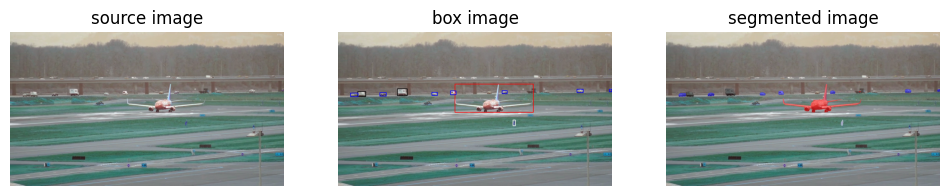


0: 384x640 1 person, 7 cars, 1 airplane, 4 trucks, 29.7ms
Speed: 0.6ms preprocess, 29.7ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 545.2395,  242.0928,  912.6626,  376.4003],
        [ 277.8367,  264.6954,  323.4669,  298.5574],
        [ 195.0683,  284.0782,  225.9788,  299.9567],
        [ 438.2408,  282.3926,  464.5905,  296.1854],
        [1117.0826,  268.4400, 1145.5511,  283.3004],
        [  94.1195,  278.2060,  128.4794,  303.1257],
        [ 526.2638,  276.4930,  551.0966,  293.8160],
        [ 766.3596,  273.9996,  790.2276,  287.9516],
        [ 817.6360,  411.7444,  827.9083,  437.9094],
        [1266.1578,  266.2100, 1279.4913,  278.9676],
        [  57.6757,  284.4742,   95.8418,  303.0157]], device='cuda:0')


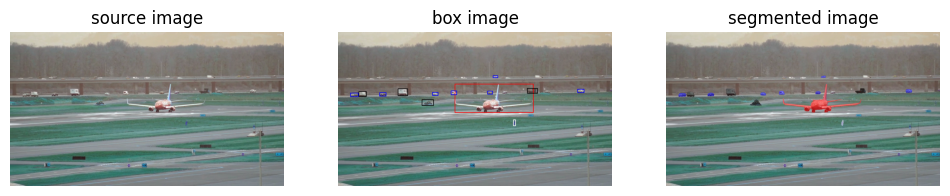


0: 384x640 1 person, 8 cars, 2 airplanes, 3 trucks, 34.4ms
Speed: 0.6ms preprocess, 34.4ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 545.0186,  242.2471,  913.5003,  376.2462],
        [ 281.4943,  265.5172,  325.8868,  298.9877],
        [ 194.8825,  284.6162,  224.6128,  299.8611],
        [ 441.7161,  283.1039,  466.5263,  296.2253],
        [  98.2264,  278.5330,  132.6189,  303.2031],
        [1121.0665,  268.8176, 1149.1259,  283.5724],
        [ 819.4143,  413.2444,  829.4209,  437.7193],
        [  56.9835,  285.1488,   96.8214,  303.1277],
        [ 884.5792,  265.3056,  932.7058,  287.1355],
        [ 528.3810,  275.6802,  553.7396,  293.4823],
        [ 724.2734,  204.6856,  745.8933,  213.4683],
        [ 391.4973,  317.4944,  447.4111,  343.3676],
        [ 697.9438,  277.5850,  720.6833,  290.0287]], device='cuda:0')


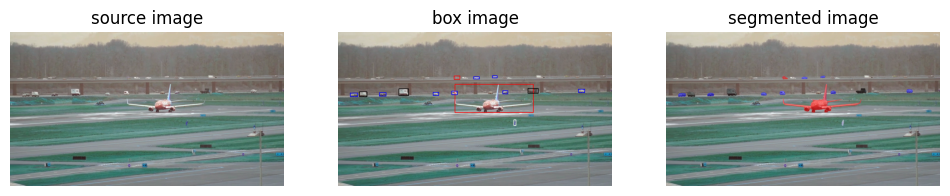


0: 384x640 1 person, 7 cars, 1 airplane, 2 trucks, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 544.9396,  242.4622,  913.5604,  376.4172],
        [ 285.4384,  265.7021,  328.8571,  298.2203],
        [ 193.4696,  284.7877,  224.2486,  300.2292],
        [ 444.4930,  283.1066,  469.7200,  296.2845],
        [ 101.8985,  278.6965,  136.1853,  303.6315],
        [1124.9716,  268.8781, 1151.8751,  283.6712],
        [ 886.1589,  263.9753,  936.8227,  288.1971],
        [ 820.4738,  412.5968,  831.1564,  437.8565],
        [ 721.6249,  205.0603,  743.0858,  214.1745],
        [ 541.2747,  206.0005,  570.5862,  220.8449],
        [ 531.6174,  275.8021,  557.7241,  294.0322],
        [ 768.4146,  274.3281,  793.3916,  288.8206],
        [ 633.7886,  209.7130,  660.9187,  220.0511],
        [  56.2894,  285.5607,   95.2929,  303.1958]], device='cuda:0')


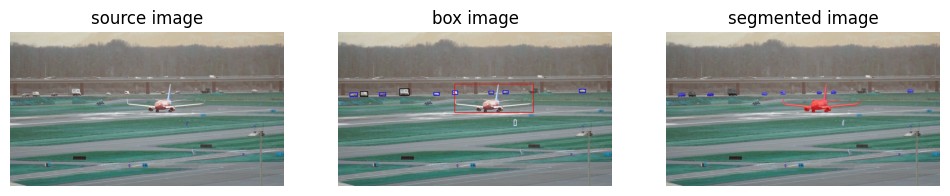


0: 384x640 1 person, 6 cars, 1 airplane, 2 trucks, 30.6ms
Speed: 0.5ms preprocess, 30.6ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 544.6769,  242.1916,  912.9747,  376.2348],
        [ 288.2118,  265.1099,  332.9365,  298.3271],
        [ 448.2979,  282.7783,  472.4141,  295.9700],
        [ 193.0132,  284.9043,  222.9632,  299.9168],
        [ 104.5593,  277.9750,  140.0770,  302.9177],
        [1128.7789,  268.4335, 1156.4540,  283.5032],
        [ 535.5290,  276.4116,  559.5478,  292.8989],
        [ 822.3085,  411.2647,  832.7977,  438.2426],
        [ 769.4738,  274.0978,  794.8461,  289.0000],
        [  55.1054,  284.3751,   92.0859,  302.9209],
        [ 704.7263,  277.2809,  727.9241,  289.8796]], device='cuda:0')


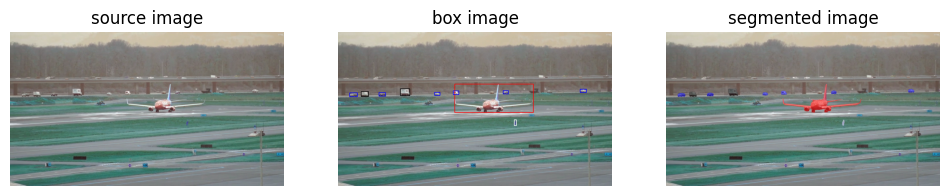


0: 384x640 1 person, 6 cars, 1 airplane, 2 trucks, 35.8ms
Speed: 0.7ms preprocess, 35.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 544.2849,  242.5493,  913.3777,  376.2326],
        [ 292.8622,  265.2853,  335.6574,  298.2142],
        [ 191.9457,  284.5572,  222.5129,  300.3074],
        [ 451.6701,  282.2346,  475.8829,  296.1542],
        [1131.8909,  268.5764, 1159.5627,  283.2619],
        [ 108.1257,  277.7113,  143.5741,  303.3047],
        [ 537.9600,  275.8046,  563.4202,  293.7466],
        [ 771.4305,  274.4678,  795.4122,  289.3137],
        [  53.9791,  284.5511,   91.6501,  303.0001],
        [ 822.9464,  410.6364,  833.7267,  437.9418]], device='cuda:0')


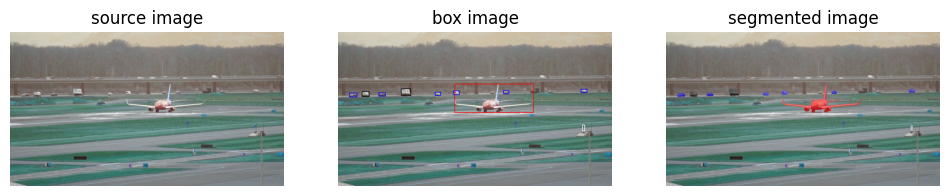


0: 384x640 1 person, 6 cars, 1 airplane, 2 trucks, 28.7ms
Speed: 0.6ms preprocess, 28.7ms inference, 6.5ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 543.8402,  242.4008,  913.7416,  376.5364],
        [ 295.4234,  265.3642,  340.5548,  298.4551],
        [ 190.5156,  284.3431,  220.5608,  300.2823],
        [ 454.5438,  282.3040,  480.4200,  296.2509],
        [ 111.8977,  278.4360,  147.0464,  303.6445],
        [  52.9101,  284.2395,   91.1736,  303.7823],
        [ 542.1215,  275.7728,  566.8015,  293.6171],
        [1135.6372,  267.8550, 1163.7183,  283.5993],
        [ 772.8536,  274.5388,  797.4635,  289.1959],
        [1141.3182,  433.7416, 1151.6405,  460.0023]], device='cuda:0')


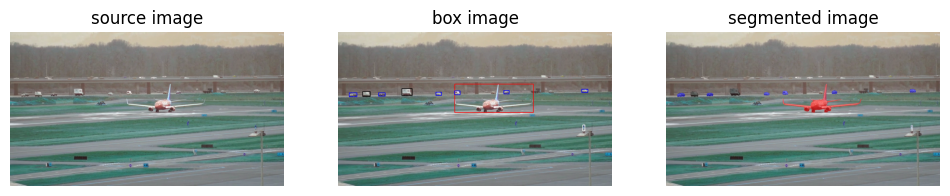


0: 384x640 7 cars, 1 airplane, 3 trucks, 28.9ms
Speed: 0.5ms preprocess, 28.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 543.7275,  242.2759,  913.4580,  376.2095],
        [ 298.8695,  264.4677,  344.3396,  298.9747],
        [ 190.1600,  284.6057,  220.4103,  300.1761],
        [ 457.9237,  282.0428,  483.5933,  296.0865],
        [1139.2551,  268.0826, 1166.8118,  282.9860],
        [  52.1127,  284.3586,   89.7566,  303.2415],
        [ 115.7853,  278.3630,  149.8525,  302.9094],
        [ 544.8031,  275.6308,  570.2377,  293.5579],
        [ 774.7302,  272.8556,  798.6069,  288.1913],
        [1141.9980,  433.3781, 1152.7544,  460.1960]], device='cuda:0')


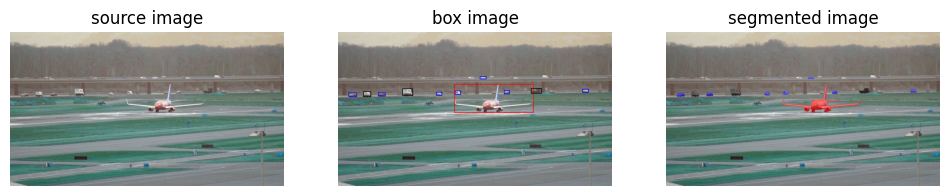


0: 384x640 6 cars, 1 airplane, 2 trucks, 30.1ms
Speed: 0.6ms preprocess, 30.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 543.4310,  243.0153,  913.0199,  376.6346],
        [ 302.5897,  265.2050,  349.5064,  298.7236],
        [ 189.4271,  284.3998,  219.7592,  300.2994],
        [ 461.1381,  282.3722,  486.6639,  296.4092],
        [ 119.2341,  278.0059,  154.2701,  303.2687],
        [1142.7483,  267.7075, 1170.8440,  282.6743],
        [  50.9273,  284.1459,   88.6078,  303.5232],
        [ 547.3203,  274.9412,  573.2512,  293.7166],
        [ 776.1647,  273.8334,  799.5513,  287.6373],
        [ 901.4866,  263.4881,  951.3115,  287.4031],
        [ 662.7717,  209.2499,  692.7975,  220.3354]], device='cuda:0')


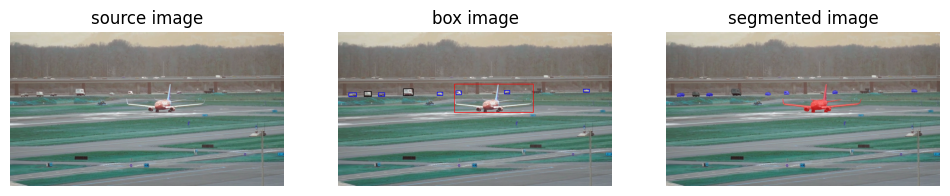


0: 384x640 1 person, 8 cars, 2 airplanes, 2 trucks, 39.1ms
Speed: 0.6ms preprocess, 39.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 543.2645,  242.8351,  913.2020,  376.5224],
        [ 306.2109,  264.8856,  350.9747,  298.4539],
        [ 188.1912,  285.0395,  218.1806,  300.4232],
        [ 463.6614,  282.4622,  489.5871,  296.6735],
        [1146.3218,  268.1384, 1174.2937,  282.5433],
        [  49.7337,  283.8110,   86.7867,  303.7971],
        [ 122.6276,  278.8863,  156.5316,  302.6718],
        [ 551.8514,  275.8543,  575.3060,  293.0661],
        [ 776.8477,  273.3138,  799.9360,  287.7613]], device='cuda:0')


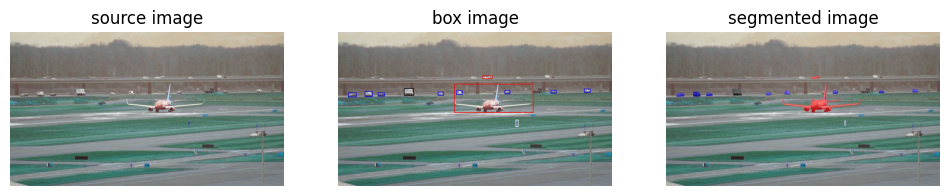


0: 384x640 1 person, 7 cars, 2 airplanes, 3 trucks, 29.4ms
Speed: 0.6ms preprocess, 29.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 543.1938,  242.8349,  912.4105,  376.7739],
        [ 310.4906,  265.1410,  353.3906,  298.0492],
        [ 187.2615,  284.6889,  217.1438,  300.3046],
        [  49.0475,  283.9980,   85.7306,  303.4268],
        [ 467.7236,  282.1583,  493.9990,  296.2478],
        [ 779.3950,  273.5641,  801.6558,  287.4647],
        [ 674.9977,  205.2845,  720.5577,  219.2269],
        [ 126.7401,  278.4097,  159.9477,  302.4833],
        [ 126.7542,  278.4983,  159.9537,  302.4535],
        [1150.8442,  267.0028, 1178.5923,  282.5573],
        [ 553.3863,  275.2458,  580.1502,  293.7166],
        [ 831.2472,  412.1313,  841.7601,  440.6067],
        [ 993.9851,  273.1154, 1019.7358,  285.1003]], device='cuda:0')


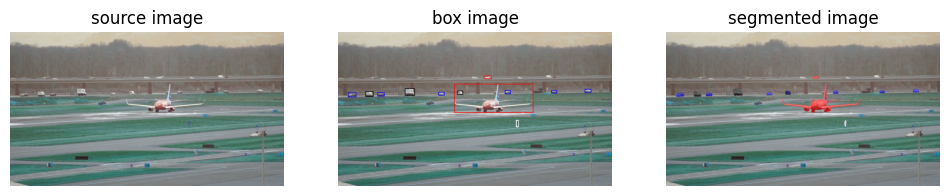


0: 384x640 1 person, 8 cars, 1 airplane, 3 trucks, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 543.2319,  242.5865,  912.7053,  376.9963],
        [ 313.4423,  264.5711,  358.7773,  298.5840],
        [ 185.7738,  284.3118,  216.4876,  300.4427],
        [ 471.3465,  282.3965,  495.9006,  296.3367],
        [  46.6603,  283.6667,   85.3678,  303.6656],
        [ 682.6913,  205.9482,  718.4910,  217.8583],
        [1153.9127,  268.1498, 1181.8610,  282.3428],
        [ 128.9924,  278.1877,  164.0833,  302.8264],
        [ 997.9722,  272.2278, 1023.0898,  284.9359],
        [ 780.1599,  273.8688,  805.3438,  289.1070],
        [ 557.6697,  275.6799,  583.1021,  293.7947],
        [ 557.5446,  275.8000,  583.2616,  294.2090],
        [ 832.2130,  411.4527,  842.9865,  441.7232]], device='cuda:0')


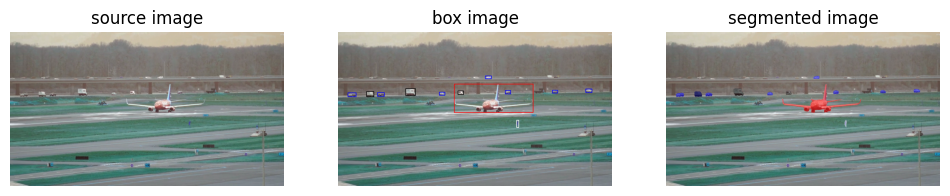


0: 384x640 1 person, 6 cars, 1 airplane, 3 trucks, 30.0ms
Speed: 0.6ms preprocess, 30.0ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 542.6522,  242.4788,  912.5181,  376.9958],
        [ 317.1741,  264.1760,  362.5944,  298.3732],
        [ 184.8967,  284.0150,  216.2549,  300.6194],
        [ 473.7678,  281.9904,  499.7466,  296.4628],
        [  46.6485,  284.0612,   84.5608,  303.5271],
        [ 133.5323,  278.1580,  168.2796,  302.9570],
        [ 688.7557,  206.1458,  717.1307,  218.6154],
        [ 133.4340,  278.0132,  168.2018,  302.7649],
        [1156.7140,  266.9056, 1186.6805,  282.6879],
        [ 781.1661,  273.7210,  806.2894,  288.9492],
        [1001.6235,  272.6702, 1025.3982,  284.7943],
        [ 834.2792,  411.3226,  844.7924,  446.3165],
        [ 560.1326,  275.1682,  585.5117,  294.4760]], device='cuda:0')


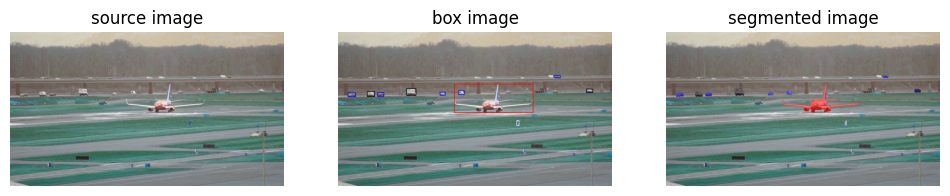


0: 384x640 1 person, 7 cars, 1 airplane, 2 trucks, 31.0ms
Speed: 0.6ms preprocess, 31.0ms inference, 12.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 542.6469,  242.5640,  913.2611,  377.0212],
        [ 321.3431,  264.2095,  365.3560,  298.2617],
        [ 477.7783,  282.3083,  501.7211,  295.1326],
        [ 183.6403,  283.7263,  214.8208,  300.7109],
        [ 136.3036,  277.8722,  171.6678,  303.2358],
        [  47.3968,  283.7952,   83.3767,  303.3108],
        [1161.3367,  266.9091, 1190.1475,  282.5395],
        [ 835.4860,  411.5493,  845.6461,  437.2720],
        [ 563.4847,  274.6464,  589.5422,  292.9167],
        [1161.3817,  266.9814, 1189.6349,  282.5988],
        [1009.4581,  203.4466, 1037.4220,  213.2013]], device='cuda:0')


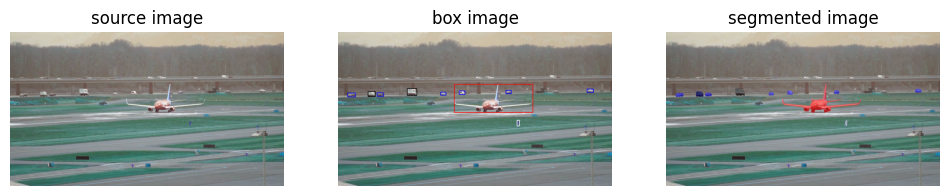


0: 384x640 1 person, 8 cars, 1 airplane, 2 trucks, 28.7ms
Speed: 0.7ms preprocess, 28.7ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 541.5416,  242.7612,  913.1686,  377.2435],
        [ 324.4510,  264.5760,  367.9838,  298.0961],
        [ 182.8567,  283.9186,  213.8575,  300.6993],
        [ 480.5643,  282.0136,  504.4811,  296.5904],
        [  46.2049,  284.6022,   81.9814,  303.5830],
        [1164.2791,  267.2368, 1193.5181,  282.2094],
        [ 139.8969,  278.0370,  174.9426,  302.8278],
        [ 566.3904,  275.6636,  591.8994,  293.5953],
        [ 139.6102,  277.4713,  174.6328,  302.9699],
        [ 836.5255,  410.3835,  847.3749,  438.7016],
        [ 784.1539,  273.3902,  809.8373,  288.6824]], device='cuda:0')


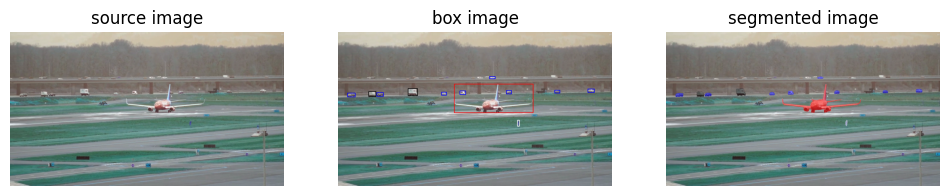


0: 384x640 1 person, 7 cars, 2 airplanes, 2 trucks, 31.4ms
Speed: 0.6ms preprocess, 31.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 540.9821,  242.7108,  914.1400,  377.4113],
        [ 327.6936,  264.5715,  372.5696,  299.0345],
        [ 483.9679,  282.4370,  506.9897,  295.6709],
        [1168.5647,  266.7958, 1197.0159,  282.5648],
        [ 180.6872,  283.9009,  213.1898,  301.0411],
        [ 785.3759,  273.5612,  811.0189,  288.9950],
        [ 143.2246,  277.3399,  177.9172,  303.0428],
        [  44.5713,  284.4122,   82.7957,  304.0335],
        [ 569.6102,  275.1493,  596.3021,  292.8406],
        [ 838.0897,  410.4246,  848.5795,  440.1671],
        [ 707.4532,  208.6180,  735.7408,  218.5188],
        [1011.7838,  271.1689, 1037.4210,  285.3209]], device='cuda:0')


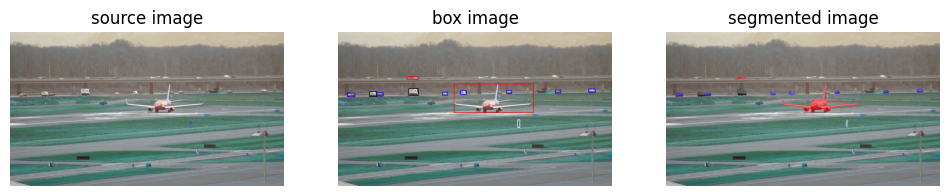


0: 384x640 1 person, 6 cars, 4 airplanes, 3 trucks, 28.7ms
Speed: 0.6ms preprocess, 28.7ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 540.3893,  242.4025,  914.7806,  377.2338],
        [ 330.6976,  264.0553,  376.7254,  298.9084],
        [ 488.5063,  282.0533,  511.4428,  294.2856],
        [ 787.1349,  274.0288,  811.7310,  288.9144],
        [1171.9078,  266.8474, 1200.4542,  282.3617],
        [ 146.9198,  277.3600,  180.8949,  302.5144],
        [ 178.8466,  283.9434,  211.8816,  301.0850],
        [ 839.1974,  409.9187,  851.4562,  447.8784],
        [  44.1582,  285.6854,   79.8090,  303.5191],
        [ 573.5044,  274.9934,  597.9858,  292.3071],
        [1015.6135,  271.2361, 1040.2122,  284.9581],
        [ 321.2287,  206.8247,  374.4654,  221.8032]], device='cuda:0')


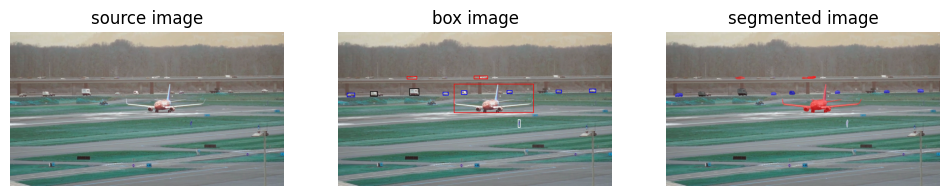


0: 384x640 1 person, 7 cars, 2 airplanes, 3 trucks, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 540.8817,  242.4313,  915.0480,  377.2738],
        [ 334.8580,  264.3986,  379.7878,  298.4677],
        [  42.6168,  285.9334,   77.7716,  303.8108],
        [1175.4810,  266.2255, 1204.6343,  282.8908],
        [ 788.7593,  273.5042,  813.3308,  288.9472],
        [ 151.2208,  277.6417,  185.2831,  302.0748],
        [ 489.9916,  281.2264,  516.2532,  295.1265],
        [ 632.6798,  205.1393,  700.2604,  219.4143],
        [ 840.9009,  410.1965,  852.2940,  446.4088],
        [ 661.1016,  205.4551,  700.3884,  217.9354],
        [ 321.9979,  206.9105,  369.7019,  221.8702],
        [ 575.9691,  274.6637,  602.5823,  292.8341],
        [1018.8621,  271.7645, 1044.0142,  285.3792],
        [ 576.0358,  274.6514,  602.7246,  292.2896]], device='cuda:0')


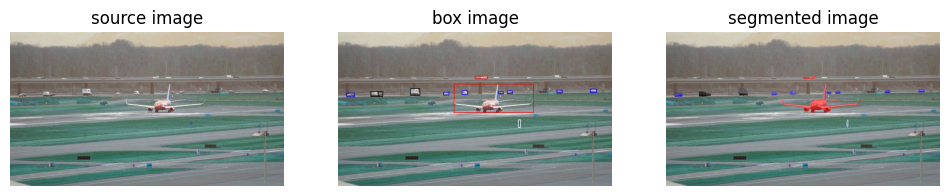


0: 384x640 8 cars, 1 airplane, 3 trucks, 31.6ms
Speed: 0.6ms preprocess, 31.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 541.9924,  241.7956,  916.8345,  377.5012],
        [ 338.8416,  264.7263,  381.3556,  298.5794],
        [  41.6678,  285.8467,   77.1907,  303.7437],
        [1178.9238,  266.5761, 1208.1978,  282.7628],
        [ 153.1833,  277.9311,  209.6117,  301.9925],
        [ 153.5127,  277.9105,  189.4114,  302.2276],
        [ 638.9557,  204.7366,  697.0309,  220.5066],
        [ 790.6597,  273.9283,  814.9442,  288.7773],
        [ 579.0410,  274.5455,  605.7401,  292.7551],
        [1022.5385,  271.8936, 1047.5861,  285.1346],
        [ 842.4933,  409.9566,  854.3130,  445.7741],
        [ 493.2720,  280.8643,  520.2310,  294.8091],
        [ 748.6431,  276.3792,  773.1841,  289.3883]], device='cuda:0')


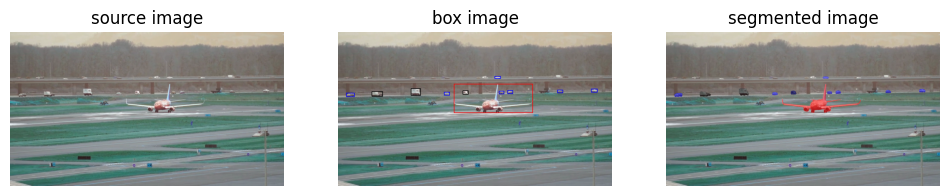


0: 384x640 1 person, 9 cars, 1 airplane, 2 trucks, 29.9ms
Speed: 0.7ms preprocess, 29.9ms inference, 6.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 541.9149,  242.0801,  915.1445,  377.4837],
        [ 342.3322,  264.5045,  384.9990,  298.3224],
        [ 159.3226,  278.4257,  207.7290,  301.5709],
        [  40.4392,  285.7698,   76.8143,  303.3521],
        [ 496.5608,  281.6012,  522.0242,  295.0648],
        [1183.2915,  266.5771, 1211.6924,  282.6826],
        [1026.0461,  272.3170, 1050.1411,  284.9411],
        [ 583.5673,  275.0504,  607.8954,  291.2153],
        [ 792.1599,  273.5426,  816.0125,  288.8729],
        [ 732.1714,  208.4415,  760.1570,  217.2930],
        [ 752.2898,  275.9093,  775.8328,  289.3037],
        [ 583.6780,  275.0799,  608.1060,  291.7307]], device='cuda:0')


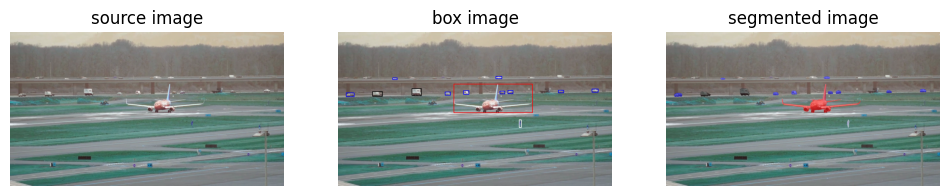


0: 384x640 1 person, 7 cars, 2 airplanes, 2 trucks, 30.0ms
Speed: 0.6ms preprocess, 30.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 541.2352,  242.3447,  912.7646,  377.4577],
        [ 345.4229,  264.3485,  390.4806,  299.0929],
        [  40.1937,  285.7503,   75.4578,  303.2424],
        [ 162.5637,  278.4270,  207.5496,  301.4243],
        [ 500.6152,  281.6072,  525.0793,  295.6548],
        [1185.5999,  266.5259, 1215.2639,  282.7606],
        [ 793.0708,  273.6907,  817.6990,  288.2442],
        [ 737.8357,  207.9934,  766.6846,  217.7587],
        [ 585.1866,  274.1044,  612.5190,  291.9472],
        [ 845.8124,  409.8135,  856.8343,  446.7632],
        [1029.8147,  272.2639, 1053.7898,  284.8140],
        [ 756.6196,  276.2473,  779.0632,  288.6362],
        [ 255.8905,  214.7034,  276.8477,  221.5332]], device='cuda:0')


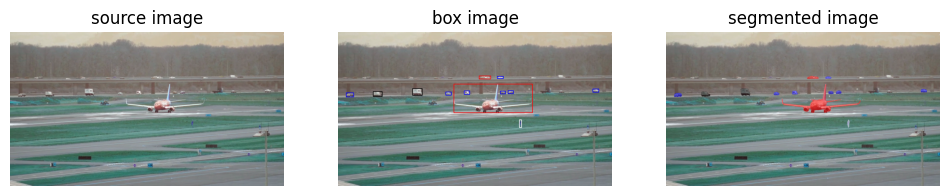


0: 384x640 1 person, 5 cars, 1 airplane, 4 trucks, 29.4ms
Speed: 0.6ms preprocess, 29.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 540.7375,  242.4327,  911.1654,  377.8231],
        [ 348.7184,  264.3426,  393.6205,  298.9259],
        [  39.0173,  285.4925,   74.2337,  303.8129],
        [ 166.3120,  278.5314,  206.6525,  301.4594],
        [ 503.3434,  281.5182,  528.7308,  295.3869],
        [ 793.8417,  274.1120,  819.3840,  288.5703],
        [ 759.2325,  276.5990,  781.9682,  288.7848],
        [ 589.5856,  275.0804,  614.0660,  292.1551],
        [ 657.5846,  205.2801,  713.9816,  220.0467],
        [ 846.7167,  410.2938,  857.6500,  446.3167],
        [1189.9407,  266.4969, 1219.4167,  282.6384],
        [ 744.1097,  207.8552,  772.0314,  218.1017]], device='cuda:0')


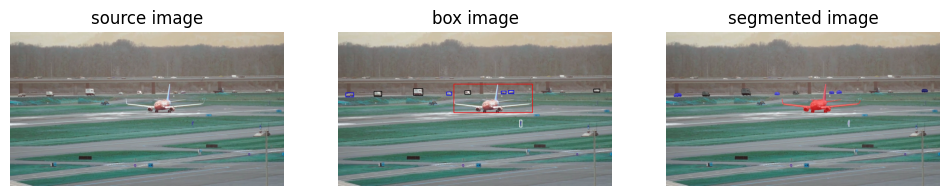


0: 384x640 1 person, 4 cars, 2 airplanes, 4 trucks, 29.4ms
Speed: 0.6ms preprocess, 29.4ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 540.8757,  241.7548,  911.2640,  377.5951],
        [ 352.4835,  263.9823,  396.6047,  298.0842],
        [  37.8947,  285.2980,   73.5656,  303.6037],
        [ 169.5120,  278.5049,  205.7586,  301.6157],
        [ 796.2096,  273.4238,  820.5685,  288.4762],
        [ 506.9182,  280.9919,  530.3934,  294.9316],
        [ 848.1494,  410.9955,  859.7134,  445.6778],
        [1194.1003,  266.4361, 1222.7488,  282.4373],
        [ 762.9553,  276.2269,  785.1740,  288.8394],
        [1194.6111,  266.7149, 1222.7068,  282.3872],
        [ 592.1386,  274.2321,  619.2578,  292.0954]], device='cuda:0')


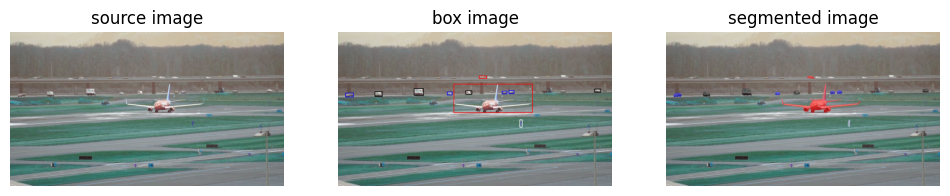


0: 384x640 1 person, 5 cars, 1 airplane, 2 trucks, 29.8ms
Speed: 0.9ms preprocess, 29.8ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 540.1912,  241.8182,  911.1377,  377.5887],
        [ 356.3588,  264.6366,  399.4590,  297.7903],
        [  35.8974,  285.7026,   72.5271,  303.5094],
        [ 173.1299,  278.4580,  205.7345,  301.2029],
        [ 797.8461,  273.3479,  822.3212,  288.4470],
        [ 510.6058,  280.7144,  533.6578,  295.0785],
        [ 849.6582,  410.0538,  861.3076,  445.4433],
        [ 658.7104,  205.3638,  694.3959,  217.6475],
        [1197.4280,  265.6162, 1228.0325,  282.3456],
        [ 766.6100,  275.5602,  787.8698,  287.9094],
        [ 594.8220,  274.0677,  624.6708,  292.2669]], device='cuda:0')


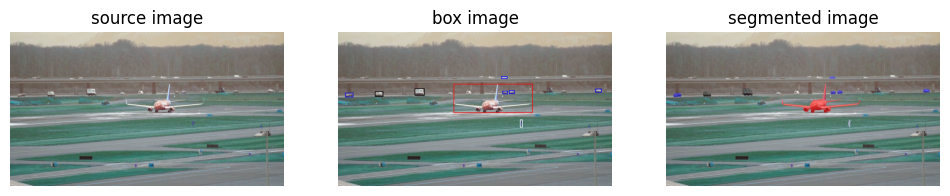


0: 384x640 2 persons, 5 cars, 1 airplane, 2 trucks, 29.9ms
Speed: 0.6ms preprocess, 29.9ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 538.3829,  241.4983,  910.4603,  377.8247],
        [ 359.2182,  263.9741,  404.4700,  298.3660],
        [  35.5837,  286.1833,   70.6383,  303.4838],
        [ 174.9305,  278.0874,  209.6506,  301.6162],
        [ 799.5253,  273.0860,  823.8617,  288.4724],
        [ 851.0791,  410.4427,  862.7356,  445.6100],
        [1201.7064,  266.3282, 1230.4596,  282.2983],
        [ 763.2441,  208.9883,  789.9380,  217.0646],
        [ 769.5383,  276.6919,  792.0010,  289.2090]], device='cuda:0')


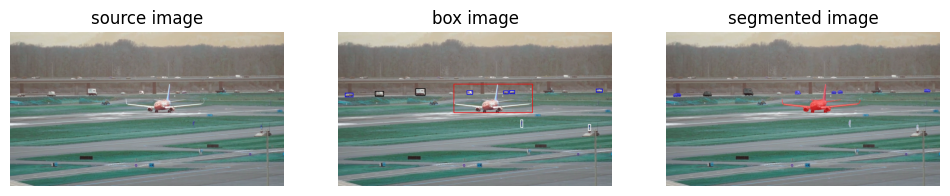


0: 384x640 1 person, 7 cars, 1 airplane, 4 trucks, 30.1ms
Speed: 0.7ms preprocess, 30.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 538.6262,  241.2452,  911.1299,  377.6128],
        [ 363.1783,  263.8093,  408.0341,  298.1192],
        [  34.3444,  285.8074,   69.6312,  303.5807],
        [ 174.2793,  278.1810,  212.8624,  300.7581],
        [ 801.3073,  273.1436,  825.6852,  288.5124],
        [1206.4746,  266.1363, 1235.2944,  281.8942],
        [ 852.2404,  410.0382,  864.2087,  446.7728],
        [ 772.8060,  275.2486,  793.9498,  288.2086],
        [1169.2301,  433.9044, 1179.9557,  458.9745],
        [ 601.9471,  273.7657,  630.3663,  291.1341]], device='cuda:0')


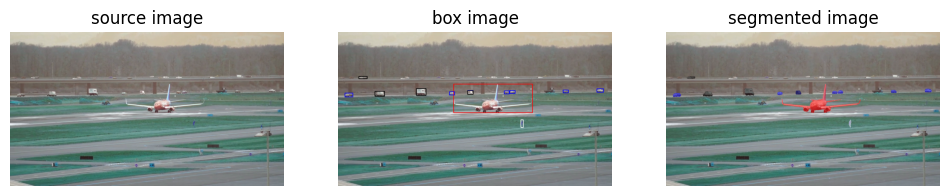


0: 384x640 2 persons, 8 cars, 1 airplane, 2 trucks, 28.7ms
Speed: 0.6ms preprocess, 28.7ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 538.6453,  241.3312,  910.9205,  377.7410],
        [ 366.9526,  263.7521,  411.7308,  297.4769],
        [ 173.0600,  278.5482,  215.8910,  300.5316],
        [  33.7282,  285.8782,   68.7740,  303.1225],
        [ 802.8513,  273.2828,  827.2203,  288.2771],
        [1209.7661,  265.5706, 1239.2124,  281.6646],
        [ 854.2008,  409.9876,  865.4498,  445.7281],
        [1052.2517,  272.3347, 1076.5613,  284.1324],
        [ 520.6937,  280.2334,  543.8583,  293.8173],
        [ 777.1232,  274.2866,  798.6173,  287.9651],
        [  97.9797,  207.6537,  135.5262,  218.5406],
        [ 605.7864,  273.6736,  632.0742,  292.0226],
        [ 605.7698,  274.0901,  632.2681,  292.6557]], device='cuda:0')


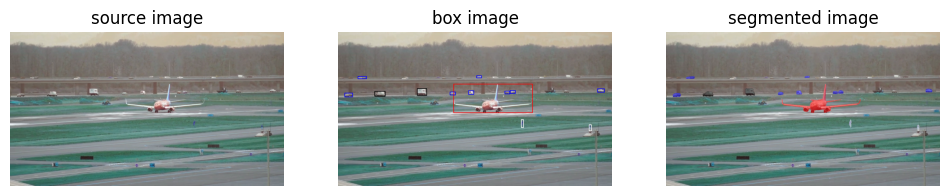


0: 384x640 5 cars, 1 airplane, 4 trucks, 65.2ms
Speed: 0.5ms preprocess, 65.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 538.1746,  241.5051,  910.1694,  377.9232],
        [ 370.6225,  263.6846,  414.7437,  298.4023],
        [ 172.4253,  278.6619,  220.2544,  300.9057],
        [  31.8397,  285.2220,   68.9113,  304.1042],
        [ 805.3394,  273.4250,  828.7646,  288.6148],
        [1213.1960,  265.7618, 1242.8733,  282.2579],
        [  94.2146,  208.4415,  132.3327,  218.4721],
        [ 854.9879,  409.1817,  866.9698,  446.9451],
        [ 647.4059,  205.3748,  670.4169,  213.4869],
        [ 523.3398,  281.0016,  548.3389,  293.9344],
        [1172.7906,  432.9698, 1183.3041,  460.1827],
        [ 608.4713,  273.7612,  634.8993,  291.1848],
        [ 780.5488,  275.8321,  800.3057,  288.4763]], device='cuda:0')


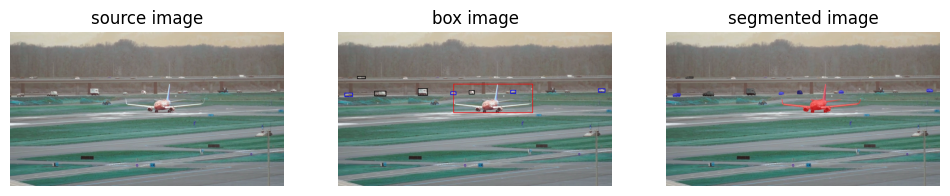


0: 384x640 8 cars, 1 airplane, 3 trucks, 29.2ms
Speed: 0.5ms preprocess, 29.2ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 538.2303,  241.2469,  910.7484,  377.4750],
        [ 171.5621,  277.1525,  223.3826,  300.4282],
        [ 374.5310,  263.6868,  418.9807,  297.5064],
        [  32.1564,  285.2857,   68.1519,  302.8621],
        [1218.0332,  266.1646, 1246.8608,  281.5297],
        [ 807.1184,  273.1409,  830.0740,  288.0415],
        [ 612.3743,  273.1530,  637.8247,  291.7369],
        [ 527.3636,  279.9957,  552.5460,  293.7390],
        [ 612.6223,  273.6814,  638.0811,  292.2723],
        [  89.7389,  207.5753,  127.9709,  218.5140]], device='cuda:0')


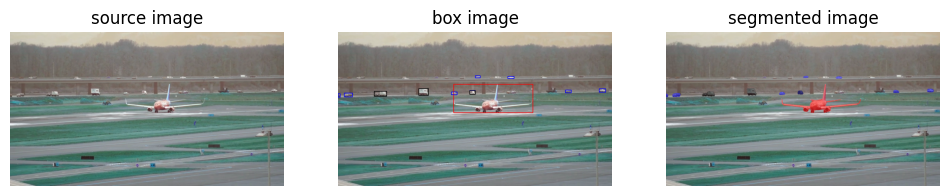


0: 384x640 8 cars, 1 airplane, 2 trucks, 29.1ms
Speed: 0.5ms preprocess, 29.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.3807e+02, 2.4128e+02, 9.1200e+02, 3.7786e+02],
        [3.7893e+02, 2.6398e+02, 4.2204e+02, 2.9783e+02],
        [1.6959e+02, 2.7765e+02, 2.2721e+02, 3.0098e+02],
        [1.2216e+03, 2.6621e+02, 1.2496e+03, 2.8040e+02],
        [2.9844e+01, 2.8557e+02, 6.7377e+01, 3.0396e+02],
        [1.0624e+03, 2.7167e+02, 1.0877e+03, 2.8457e+02],
        [6.4243e+02, 2.0578e+02, 6.6419e+02, 2.1366e+02],
        [5.2971e+02, 2.8025e+02, 5.5633e+02, 2.9336e+02],
        [6.1562e+02, 2.7331e+02, 6.4124e+02, 2.9202e+02],
        [6.1540e+02, 2.7384e+02, 6.4171e+02, 2.9271e+02],
        [6.2021e-02, 2.8691e+02, 1.0124e+01, 3.0383e+02],
        [7.9405e+02, 2.0835e+02, 8.2167e+02, 2.1739e+02]], device='cuda:0')


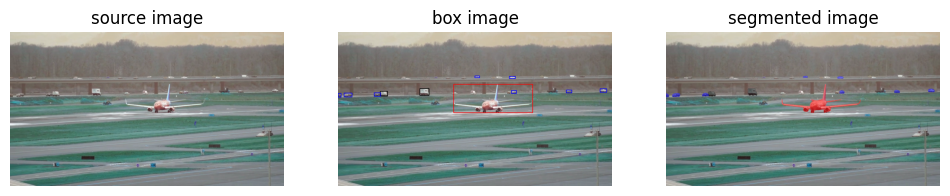


0: 384x640 1 person, 5 cars, 2 airplanes, 4 trucks, 31.9ms
Speed: 0.5ms preprocess, 31.9ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 538.1961,  241.6647,  912.2951,  377.9977],
        [ 382.7357,  263.9345,  426.3861,  298.5988],
        [1225.6653,  266.0659, 1253.7678,  280.8998],
        [ 197.7863,  277.7546,  231.2659,  300.8785],
        [  29.8760,  286.6749,   63.9326,  303.9039],
        [ 169.1412,  285.5340,  199.6665,  300.8234],
        [ 810.4664,  273.4991,  833.4161,  288.0185],
        [1067.3213,  271.9949, 1091.5518,  284.1118],
        [   0.0000,  287.2804,   13.5631,  303.4797],
        [ 800.1230,  208.1957,  828.4794,  217.7205],
        [ 640.2989,  205.7841,  661.2401,  213.4593]], device='cuda:0')


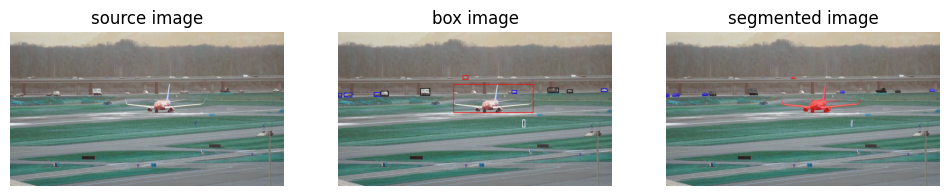


0: 384x640 1 person, 6 cars, 3 airplanes, 2 trucks, 28.7ms
Speed: 0.6ms preprocess, 28.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.3828e+02, 2.4135e+02, 9.1129e+02, 3.7790e+02],
        [3.8526e+02, 2.6340e+02, 4.2900e+02, 2.9707e+02],
        [2.9181e+01, 2.8557e+02, 6.3886e+01, 3.0355e+02],
        [1.2295e+03, 2.6558e+02, 1.2581e+03, 2.8043e+02],
        [1.6960e+02, 2.8405e+02, 2.0051e+02, 3.0021e+02],
        [1.7300e-02, 2.8682e+02, 1.6397e+01, 3.0421e+02],
        [2.0103e+02, 2.7711e+02, 2.3524e+02, 3.0010e+02],
        [9.7920e+02, 2.6078e+02, 1.0300e+03, 2.8564e+02],
        [8.6219e+02, 4.1042e+02, 8.7388e+02, 4.4028e+02],
        [5.8156e+02, 2.0253e+02, 6.0886e+02, 2.2003e+02],
        [8.1324e+02, 2.7378e+02, 8.3513e+02, 2.8787e+02],
        [1.0704e+03, 2.7072e+02, 1.0956e+03, 2.8423e+02]], device='cuda:0')


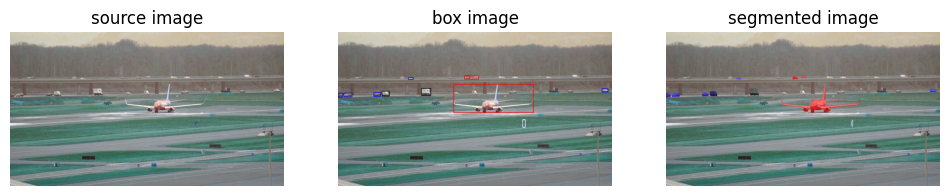


0: 384x640 1 person, 8 cars, 2 airplanes, 1 truck, 33.0ms
Speed: 0.5ms preprocess, 33.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.3827e+02, 2.4128e+02, 9.1299e+02, 3.7803e+02],
        [3.8822e+02, 2.6343e+02, 4.3380e+02, 2.9771e+02],
        [1.6853e+02, 2.8351e+02, 1.9825e+02, 3.0066e+02],
        [1.2338e+03, 2.6595e+02, 1.2606e+03, 2.8048e+02],
        [2.8402e+01, 2.8517e+02, 6.4178e+01, 3.0420e+02],
        [2.9144e-02, 2.8645e+02, 2.0429e+01, 3.0448e+02],
        [2.0616e+02, 2.7705e+02, 2.3839e+02, 3.0010e+02],
        [8.6334e+02, 4.1063e+02, 8.7557e+02, 4.4302e+02],
        [5.9039e+02, 2.0129e+02, 6.1548e+02, 2.1989e+02],
        [2.0580e+02, 2.7719e+02, 2.3859e+02, 3.0040e+02],
        [3.2864e+02, 2.1389e+02, 3.5232e+02, 2.2175e+02],
        [5.9129e+02, 2.0200e+02, 6.5599e+02, 2.1772e+02]], device='cuda:0')


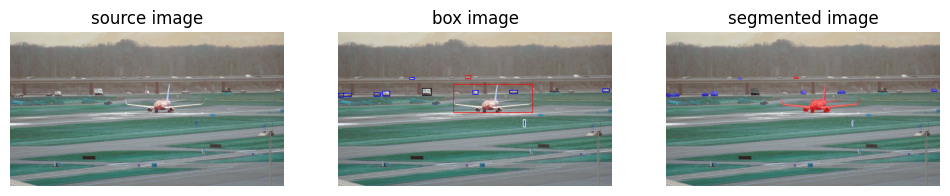


0: 384x640 1 person, 8 cars, 2 airplanes, 1 truck, 33.4ms
Speed: 0.7ms preprocess, 33.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.3820e+02, 2.4183e+02, 9.1112e+02, 3.7802e+02],
        [3.9285e+02, 2.6324e+02, 4.3728e+02, 2.9720e+02],
        [1.6772e+02, 2.8386e+02, 1.9732e+02, 3.0086e+02],
        [1.2371e+03, 2.6587e+02, 1.2657e+03, 2.8015e+02],
        [2.0973e+02, 2.7713e+02, 2.4192e+02, 2.9990e+02],
        [2.5632e+01, 2.8579e+02, 6.3133e+01, 3.0446e+02],
        [3.6417e-02, 2.8688e+02, 2.5313e+01, 3.0408e+02],
        [8.6482e+02, 4.1028e+02, 8.7724e+02, 4.4055e+02],
        [6.2972e+02, 2.7435e+02, 6.5369e+02, 2.9166e+02],
        [5.9390e+02, 2.0192e+02, 6.2298e+02, 2.1935e+02],
        [7.9988e+02, 2.7240e+02, 8.3876e+02, 2.8838e+02],
        [3.3401e+02, 2.1270e+02, 3.5674e+02, 2.2123e+02]], device='cuda:0')


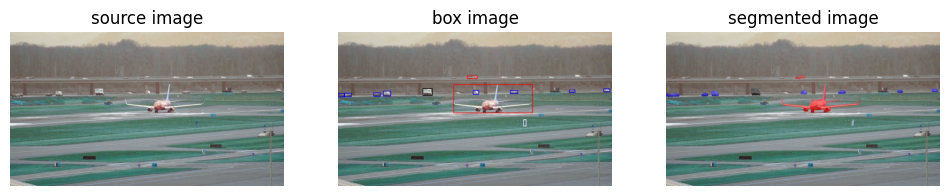


0: 384x640 1 person, 6 cars, 2 airplanes, 2 trucks, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.3769e+02, 2.4213e+02, 9.1189e+02, 3.7818e+02],
        [3.9720e+02, 2.6373e+02, 4.4087e+02, 2.9687e+02],
        [1.6648e+02, 2.8440e+02, 1.9690e+02, 3.0110e+02],
        [1.2414e+03, 2.6552e+02, 1.2697e+03, 2.8049e+02],
        [2.1315e+02, 2.7696e+02, 2.4547e+02, 2.9995e+02],
        [8.6709e+02, 4.0968e+02, 8.7932e+02, 4.3836e+02],
        [6.0167e+02, 2.0288e+02, 6.5014e+02, 2.1792e+02],
        [8.6708e-02, 2.8688e+02, 2.9415e+01, 3.0425e+02],
        [2.4213e+01, 2.8561e+02, 6.1757e+01, 3.0441e+02],
        [1.0814e+03, 2.7202e+02, 1.1073e+03, 2.8356e+02],
        [8.0348e+02, 2.7298e+02, 8.4204e+02, 2.8844e+02],
        [6.3046e+02, 2.7353e+02, 6.5806e+02, 2.9224e+02]], device='cuda:0')


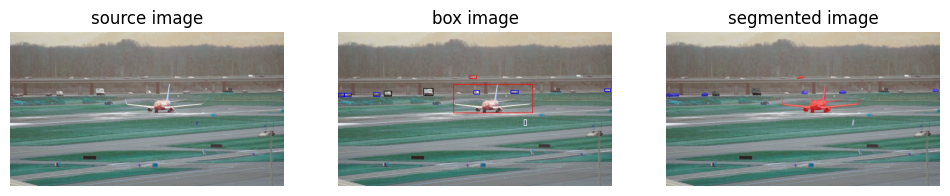


0: 384x640 1 person, 7 cars, 1 airplane, 3 trucks, 28.8ms
Speed: 0.6ms preprocess, 28.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.3792e+02, 2.4125e+02, 9.1084e+02, 3.7785e+02],
        [4.0100e+02, 2.6332e+02, 4.4435e+02, 2.9704e+02],
        [1.6551e+02, 2.8374e+02, 1.9610e+02, 3.0091e+02],
        [1.2451e+03, 2.6585e+02, 1.2723e+03, 2.8026e+02],
        [2.1598e+02, 2.7592e+02, 2.4987e+02, 3.0032e+02],
        [8.6806e+02, 4.0964e+02, 8.8047e+02, 4.3866e+02],
        [6.1135e+02, 2.0565e+02, 6.4649e+02, 2.1820e+02],
        [2.7487e+01, 2.8570e+02, 6.1397e+01, 3.0358e+02],
        [6.3520e+02, 2.7356e+02, 6.6145e+02, 2.9111e+02],
        [8.0172e-01, 2.8664e+02, 3.1251e+01, 3.0412e+02],
        [8.0809e+02, 2.7305e+02, 8.4359e+02, 2.8830e+02]], device='cuda:0')


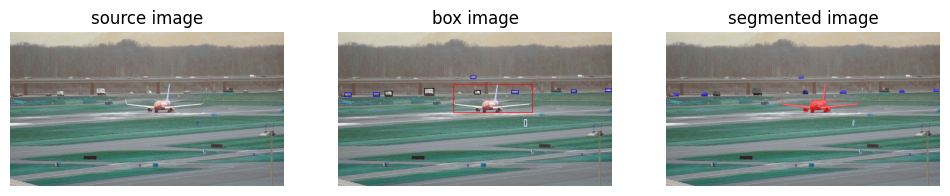


0: 384x640 1 person, 8 cars, 3 airplanes, 4 trucks, 29.3ms
Speed: 0.6ms preprocess, 29.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 537.7143,  241.4699,  911.0721,  378.0520],
        [ 404.1804,  263.1649,  448.1470,  297.2302],
        [ 164.8873,  283.4383,  195.5002,  301.0126],
        [1248.6019,  265.9683, 1277.3983,  280.3308],
        [ 220.5180,  276.4906,  253.2002,  300.1707],
        [ 870.0557,  410.6085,  881.8738,  441.0604],
        [ 621.1290,  206.4047,  643.2852,  217.7281],
        [ 639.7711,  273.2671,  663.7219,  290.7939],
        [  29.5986,  284.4286,   62.2141,  303.1266],
        [ 639.4296,  274.2953,  663.8169,  290.9770],
        [ 810.8068,  273.3693,  844.8199,  288.2979],
        [1089.5181,  270.0181, 1114.4326,  283.7455]], device='cuda:0')


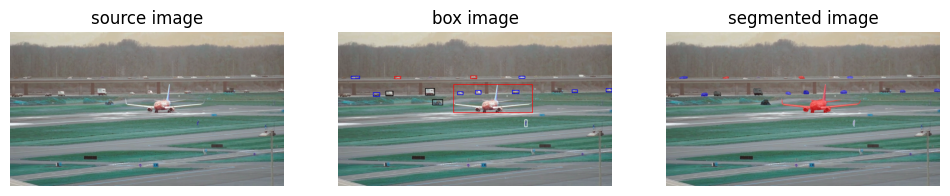


0: 384x640 4 cars, 3 airplanes, 4 trucks, 32.7ms
Speed: 0.6ms preprocess, 32.7ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 537.9113,  242.2103,  911.3133,  378.0266],
        [ 408.2436,  263.1338,  452.1943,  296.8926],
        [ 163.9286,  283.7532,  195.0999,  301.0579],
        [ 224.7870,  276.5779,  256.4496,  299.7822],
        [ 619.7196,  205.9095,  650.4214,  218.2002],
        [1252.9944,  265.6951, 1279.3647,  280.3363],
        [1093.2228,  271.0017, 1118.8070,  283.3937],
        [ 814.9120,  272.9639,  845.5353,  288.2074],
        [ 643.4465,  273.7828,  668.7332,  290.4739],
        [ 560.1710,  280.1411,  583.8213,  292.2541],
        [ 845.1462,  207.1180,  874.2371,  216.1306],
        [ 871.7957,  410.5903,  884.2197,  443.5840],
        [ 643.4828,  272.5997,  667.9888,  290.3088],
        [  61.1658,  207.2970,  100.7320,  218.7526],
        [ 262.4589,  207.3122,  295.4351,  217.2759],
        [ 440.5111,  315.0752,  488.6151,  341.9793]], device='cuda:0')


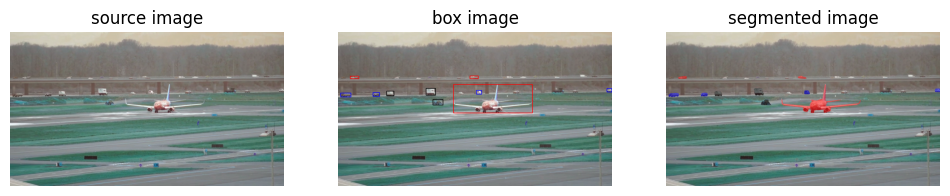


0: 384x640 7 cars, 2 airplanes, 3 trucks, 30.0ms
Speed: 0.5ms preprocess, 30.0ms inference, 8.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 537.1536,  242.1109,  911.6929,  378.3110],
        [ 413.0523,  263.7034,  455.5742,  296.5522],
        [ 163.8472,  283.9979,  194.2918,  300.5082],
        [ 615.2825,  205.7545,  655.9075,  218.0919],
        [ 228.6063,  276.3117,  260.6798,  299.7380],
        [1256.7662,  265.1681, 1279.4886,  280.6862],
        [ 646.5317,  273.9562,  671.8315,  290.9786],
        [  14.4024,  284.8293,   59.8189,  304.1696],
        [ 646.6361,  272.7769,  671.6509,  290.8246],
        [  57.1858,  206.6493,   96.8422,  218.9452],
        [ 442.3818,  315.3191,  488.9716,  341.9430]], device='cuda:0')


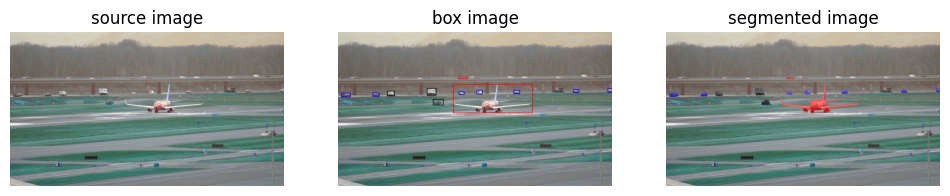


0: 384x640 8 cars, 2 airplanes, 4 trucks, 30.1ms
Speed: 0.6ms preprocess, 30.1ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 537.4473,  241.1285,  911.8494,  378.7264],
        [ 416.3690,  262.9877,  459.6065,  296.5688],
        [ 231.1542,  276.2792,  263.7005,  299.8041],
        [ 161.7947,  283.6872,  194.0290,  301.0303],
        [1260.5410,  265.7957, 1279.4985,  280.3672],
        [  16.5579,  284.8682,   58.7444,  304.1934],
        [ 647.8673,  272.4935,  674.0448,  290.7979],
        [ 562.4371,  208.1252,  604.9932,  219.3462],
        [ 566.1057,  280.0793,  589.4966,  291.9958],
        [ 822.0134,  274.0187,  848.3003,  288.6902],
        [ 442.9523,  315.0977,  492.0595,  342.1582],
        [1099.4746,  270.1392, 1125.4446,  283.6726]], device='cuda:0')


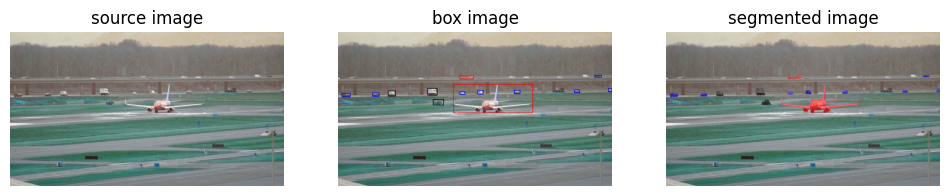


0: 384x640 1 person, 6 cars, 3 airplanes, 4 trucks, 29.9ms
Speed: 0.6ms preprocess, 29.9ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 537.1252,  241.1890,  911.8954,  378.5649],
        [ 420.3051,  263.3295,  462.2800,  296.6370],
        [ 161.4896,  283.9190,  192.8325,  301.0164],
        [ 234.8522,  276.2710,  267.5069,  299.5945],
        [  18.6761,  285.0747,   57.7877,  303.9974],
        [ 568.4032,  205.6178,  631.6857,  219.3497],
        [1265.4275,  265.3879, 1279.5022,  279.6362],
        [ 824.4360,  273.0578,  849.8948,  288.5919],
        [ 569.1522,  279.8988,  593.1788,  291.3999],
        [ 653.4098,  273.6812,  678.0604,  289.8901],
        [ 653.6741,  272.7007,  678.0225,  289.6036],
        [1104.1772,  270.0249, 1129.9097,  283.5505],
        [ 444.5557,  315.2159,  494.7537,  342.1273],
        [1200.4087,  202.7394, 1229.7148,  210.8109]], device='cuda:0')


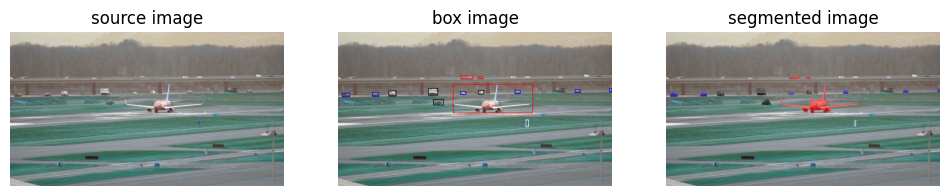


0: 384x640 1 person, 6 cars, 2 airplanes, 3 trucks, 30.2ms
Speed: 0.6ms preprocess, 30.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 536.8700,  241.7151,  912.1471,  379.2525],
        [ 422.5581,  262.9853,  466.6925,  296.2482],
        [  20.8774,  285.8250,   56.0292,  304.0547],
        [ 160.4821,  284.1686,  192.4573,  300.9016],
        [ 826.3594,  273.1307,  852.2104,  288.8397],
        [ 574.1097,  205.3779,  627.4041,  219.7769],
        [ 238.7960,  276.4670,  271.4402,  299.4723],
        [ 655.5118,  273.3583,  680.2307,  291.0480],
        [1267.9812,  265.0286, 1279.4963,  279.4289],
        [ 571.7588,  279.7629,  597.3391,  291.3157],
        [ 878.3304,  410.6181,  889.6984,  442.7002],
        [1107.2812,  269.7183, 1133.4971,  283.3002],
        [ 446.0130,  314.9236,  495.6818,  342.2485],
        [ 652.9106,  208.9830,  677.4786,  218.4524]], device='cuda:0')


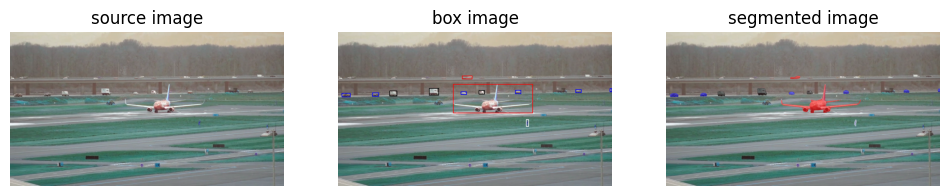


0: 384x640 1 person, 4 cars, 5 airplanes, 3 trucks, 34.2ms
Speed: 0.6ms preprocess, 34.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 536.0971,  242.2145,  912.3701,  379.3060],
        [ 426.7549,  263.3039,  470.5568,  296.3520],
        [ 579.1350,  205.5257,  625.9381,  219.8450],
        [ 160.5590,  284.5329,  190.7942,  300.7890],
        [  19.4600,  286.2168,   57.3764,  303.8478],
        [ 242.4348,  276.1769,  275.3661,  299.8948],
        [ 827.8325,  273.4026,  853.9490,  288.7433],
        [ 575.3574,  279.7787,  600.4417,  291.6559],
        [ 879.2659,  410.7154,  890.8908,  437.9515],
        [ 659.1136,  273.4930,  684.6885,  290.4135],
        [1270.1375,  264.7786, 1279.5017,  279.4792],
        [1109.6121,  269.6331, 1137.0808,  283.4084]], device='cuda:0')


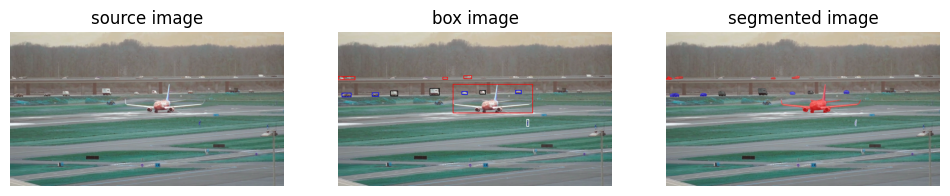


0: 384x640 1 person, 5 cars, 2 airplanes, 3 trucks, 33.6ms
Speed: 0.7ms preprocess, 33.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[535.1815, 242.2108, 912.7506, 378.9949],
        [430.6227, 262.8473, 474.4099, 296.4745],
        [245.9940, 276.5390, 278.1793, 299.7006],
        [160.6971, 285.2164, 189.9485, 300.5523],
        [ 18.1866, 286.2834,  61.3019, 303.9800],
        [  6.5293, 205.1114,  80.2056, 221.4099],
        [586.2390, 205.3876, 623.8288, 218.9201],
        [829.8968, 272.7817, 856.8699, 288.6864],
        [578.1638, 279.4006, 604.2205, 291.8352],
        [880.5464, 408.4689, 892.0620, 438.0584],
        [662.1304, 273.5964, 688.8704, 290.7418],
        [  4.4903, 206.8198,  30.8853, 222.0140],
        [490.1454, 210.6077, 512.7621, 221.9053]], device='cuda:0')


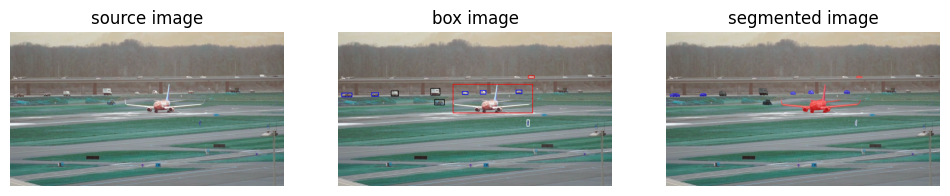


0: 384x640 2 persons, 4 cars, 3 airplanes, 4 trucks, 30.0ms
Speed: 3.2ms preprocess, 30.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[535.5109, 241.6837, 912.8605, 378.9253],
        [434.0871, 262.7273, 476.6872, 296.1429],
        [157.8264, 284.8098, 189.2525, 300.9034],
        [249.2121, 276.3511, 282.0911, 299.3499],
        [ 17.8453, 286.4442,  64.4378, 304.0286],
        [831.3671, 272.9839, 859.4124, 288.7981],
        [581.0247, 279.6240, 607.5686, 292.9432],
        [882.5664, 409.5609, 894.3944, 438.3462],
        [663.4818, 273.1871, 689.7787, 290.7804],
        [449.4596, 315.2673, 498.4314, 342.3674],
        [888.4682, 204.4212, 917.3299, 214.7620]], device='cuda:0')


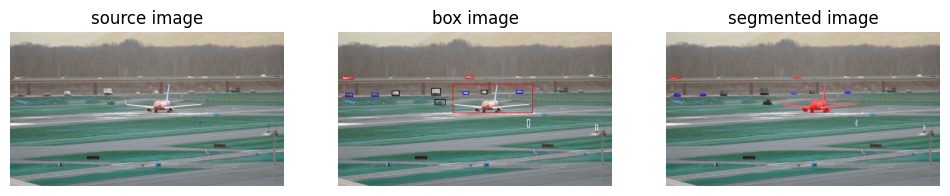


0: 384x640 1 person, 5 cars, 3 airplanes, 4 trucks, 28.7ms
Speed: 0.7ms preprocess, 28.7ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 534.8634,  241.4999,  912.9950,  379.0267],
        [ 437.8099,  262.9824,  479.9656,  296.4075],
        [ 832.6329,  272.3039,  863.4625,  288.9078],
        [  19.5234,  205.5448,   73.3986,  222.4410],
        [ 584.7098,  279.5820,  610.6801,  293.3619],
        [ 253.0661,  276.4037,  285.5871,  299.4587],
        [ 157.2910,  284.8170,  189.1036,  301.4073],
        [ 883.8121,  408.7614,  895.7684,  437.6325],
        [ 594.9703,  206.0095,  636.2621,  218.1358],
        [ 668.2784,  273.0993,  694.4926,  290.5012],
        [  35.7784,  286.6561,   69.0166,  304.0476],
        [1201.6838,  432.5822, 1212.4067,  458.5672],
        [ 451.5723,  314.6595,  500.9175,  342.3161]], device='cuda:0')


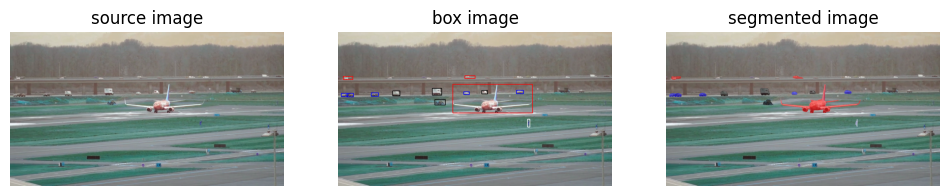


0: 384x640 2 persons, 5 cars, 1 airplane, 3 trucks, 30.1ms
Speed: 0.6ms preprocess, 30.1ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


tensor([[534.9380, 242.5001, 912.6107, 379.0316],
        [441.0129, 262.5939, 483.6319, 296.3594],
        [256.9010, 276.4668, 288.0716, 299.3885],
        [833.6750, 272.3645, 865.7045, 288.6014],
        [156.0521, 284.9890, 187.6732, 301.0834],
        [587.2211, 279.7469, 613.9889, 292.8182],
        [885.1351, 408.2251, 897.0150, 439.9045],
        [ 44.5272, 286.8275,  72.2068, 303.7285],
        [670.6531, 273.2267, 699.0276, 290.9482],
        [592.4177, 204.9846, 644.7737, 218.4449],
        [ 25.1745, 205.6759,  69.5361, 221.8910],
        [451.2579, 314.6255, 500.2079, 342.2847],
        [ 15.7626, 286.8367,  46.2232, 303.3372]], device='cuda:0')


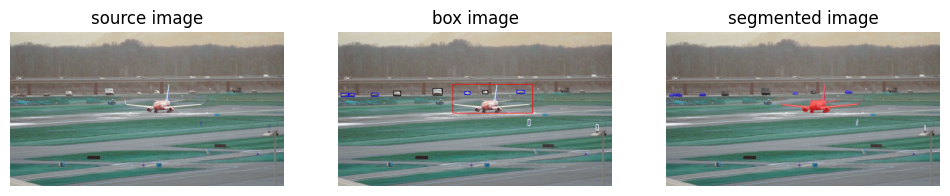


0: 384x640 6 cars, 1 airplane, 4 trucks, 33.1ms
Speed: 0.6ms preprocess, 33.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 535.0297,  242.5208,  912.8271,  379.0846],
        [ 444.6818,  263.0025,  487.4772,  296.2401],
        [ 834.9799,  272.3286,  870.8413,  288.7747],
        [ 591.0047,  279.7039,  617.3365,  292.8294],
        [ 260.7120,  276.3429,  292.0486,  299.5723],
        [ 156.8249,  286.2524,  186.3728,  300.9801],
        [ 886.7114,  408.1594,  898.4954,  438.0008],
        [ 674.9733,  273.2534,  700.7245,  290.2761],
        [  48.5178,  286.2891,   76.0313,  303.8720],
        [  15.1553,  286.0331,   50.9794,  303.8512],
        [1204.8884,  432.6128, 1215.1482,  459.3998]], device='cuda:0')


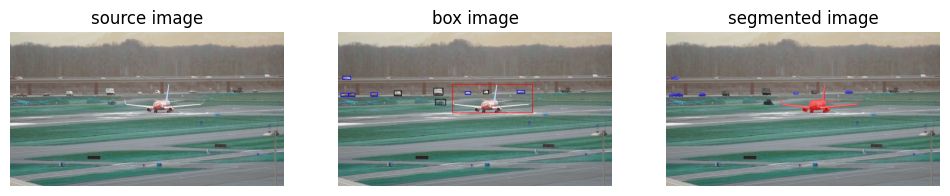


0: 384x640 4 cars, 1 airplane, 5 trucks, 31.2ms
Speed: 0.7ms preprocess, 31.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[533.6089, 243.0728, 912.7462, 378.7650],
        [447.6093, 262.0825, 491.0211, 296.3152],
        [263.1718, 276.3437, 295.8662, 298.8486],
        [836.6768, 271.7852, 871.8479, 287.8934],
        [593.5129, 278.6900, 619.9177, 291.9919],
        [154.5284, 285.1638, 184.9696, 300.6463],
        [ 50.1749, 286.3154,  78.5272, 303.3684],
        [677.6409, 272.6410, 703.7058, 289.7725],
        [ 14.4852, 286.1028,  50.5339, 303.5503],
        [453.7911, 313.1714, 506.9698, 341.9339],
        [ 23.1994, 207.8329,  60.1518, 223.1044]], device='cuda:0')


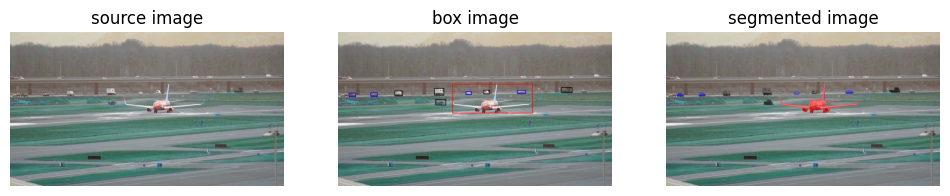


0: 384x640 4 cars, 2 airplanes, 4 trucks, 29.7ms
Speed: 0.6ms preprocess, 29.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 532.2512,  241.9768,  911.0501,  379.1873],
        [ 451.4973,  262.4743,  493.5602,  296.3151],
        [ 266.3920,  276.2313,  299.4506,  298.9058],
        [ 153.7555,  285.1020,  184.4929,  301.1268],
        [ 597.6849,  279.4542,  623.3723,  292.3578],
        [ 838.5815,  272.8917,  876.7910,  288.2761],
        [  52.0129,  286.4219,   82.3699,  303.5751],
        [ 680.5378,  272.6412,  706.4944,  290.0540],
        [1041.1859,  260.1854, 1094.2213,  285.0610],
        [ 455.5933,  313.7606,  506.5220,  342.0560]], device='cuda:0')


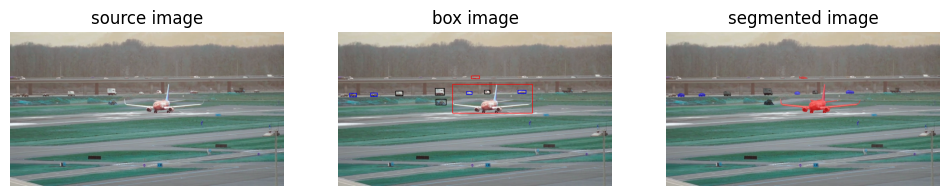


0: 384x640 4 cars, 2 airplanes, 4 trucks, 35.0ms
Speed: 0.6ms preprocess, 35.0ms inference, 9.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[531.9525, 242.5919, 910.9418, 379.3736],
        [454.4261, 262.0150, 497.9420, 296.9438],
        [840.0084, 273.3416, 879.5552, 288.1507],
        [270.4163, 276.5781, 303.0901, 299.2299],
        [601.0518, 279.1331, 626.3432, 292.4529],
        [152.5326, 285.3918, 183.7987, 301.4368],
        [684.3192, 273.3163, 710.1276, 290.2536],
        [ 55.8848, 287.0015,  85.4791, 304.1035],
        [621.2004, 203.2214, 662.1892, 218.7891],
        [456.6184, 314.2664, 507.2937, 342.1507]], device='cuda:0')


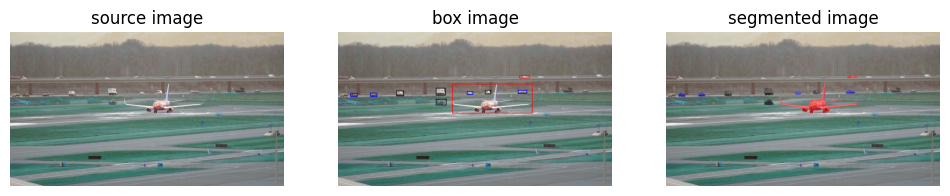


0: 384x640 1 person, 5 cars, 4 airplanes, 4 trucks, 63.1ms
Speed: 0.6ms preprocess, 63.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[532.2161, 242.1933, 910.4941, 379.1505],
        [458.2075, 261.4739, 501.8246, 296.4810],
        [841.1844, 273.6496, 882.5818, 287.8416],
        [274.1125, 275.8945, 306.1232, 298.5902],
        [603.6476, 279.3079, 630.0916, 292.3496],
        [ 59.2033, 286.7788,  89.6208, 303.7767],
        [687.5025, 273.0518, 712.4774, 290.8510],
        [458.1443, 314.2773, 506.7499, 341.3058],
        [151.1097, 286.6582, 182.8773, 301.4968],
        [846.8657, 204.4498, 894.8007, 215.9955]], device='cuda:0')


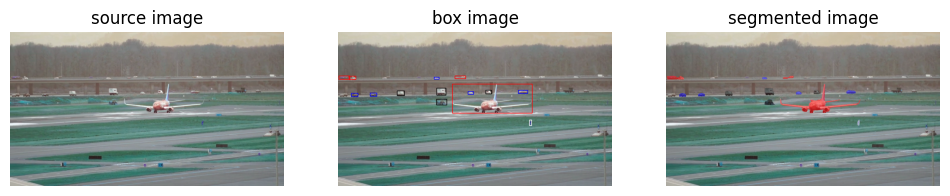


0: 384x640 1 person, 6 cars, 1 airplane, 4 trucks, 29.9ms
Speed: 0.6ms preprocess, 29.9ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


tensor([[532.2079, 241.8284, 910.3417, 379.0759],
        [461.3270, 261.1817, 504.7778, 296.4579],
        [608.0994, 279.5944, 632.7926, 292.3370],
        [277.5754, 275.9783, 309.8165, 298.3909],
        [ 62.2923, 286.5856,  92.4983, 303.6060],
        [689.6320, 272.4365, 716.2872, 290.7574],
        [842.6399, 272.8714, 886.2667, 288.1955],
        [150.1175, 286.5468, 181.4000, 301.2472],
        [  2.6407, 204.1988,  49.2255, 220.3550],
        [ 48.1543, 205.5072,  84.4497, 223.5491],
        [449.6769, 210.7354, 472.8803, 220.4679],
        [458.8208, 313.4269, 511.6343, 341.3422],
        [894.8008, 409.6819, 905.4357, 437.0193],
        [546.4972, 205.4331, 595.6031, 218.3134]], device='cuda:0')


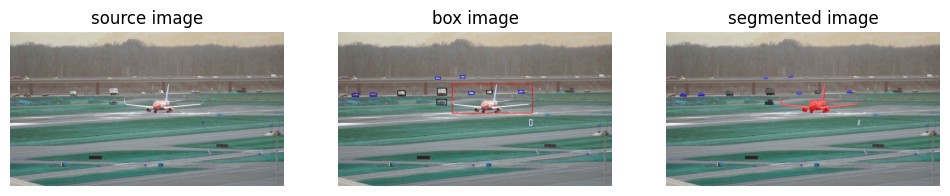


0: 384x640 1 person, 6 cars, 2 airplanes, 5 trucks, 29.4ms
Speed: 0.6ms preprocess, 29.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[531.1078, 242.1369, 909.3507, 379.3777],
        [465.2920, 261.5507, 507.4980, 296.2096],
        [280.5834, 276.1110, 313.9799, 298.8793],
        [610.8081, 279.3983, 635.8667, 291.9875],
        [ 66.5802, 286.8299,  97.3120, 303.7989],
        [693.5540, 272.4106, 719.8061, 290.4369],
        [149.7919, 286.5736, 180.8090, 301.5698],
        [895.4666, 410.0286, 907.0317, 437.1548],
        [460.4742, 314.0599, 513.1091, 341.2280],
        [844.6811, 272.5139, 867.6302, 287.4886],
        [456.1393, 211.0943, 480.2664, 220.9597],
        [571.1577, 205.2700, 592.7715, 215.2873]], device='cuda:0')


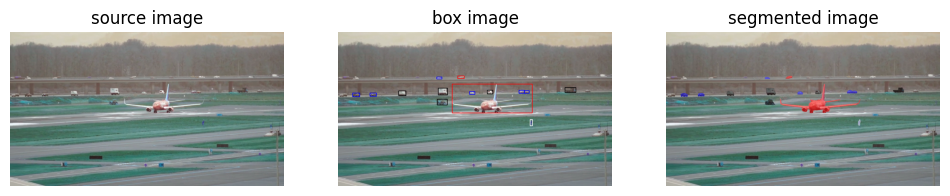


0: 384x640 1 person, 6 cars, 2 airplanes, 4 trucks, 34.7ms
Speed: 0.6ms preprocess, 34.7ms inference, 8.8ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 531.9298,  241.5693,  910.3909,  379.1091],
        [ 469.3203,  261.4819,  511.3387,  295.8781],
        [  68.7321,  285.4933,  100.7106,  303.7715],
        [ 284.4094,  275.4578,  317.0703,  298.1472],
        [ 149.1870,  286.0952,  180.2556,  301.4389],
        [ 558.1583,  206.1488,  588.7167,  217.4819],
        [ 845.9442,  272.3181,  869.7014,  287.3889],
        [1057.9856,  259.6000, 1112.1934,  283.8572],
        [ 461.9497,  211.2020,  485.2086,  220.0945],
        [ 897.0422,  409.7781,  908.7217,  438.3144],
        [ 870.8804,  273.9006,  892.8279,  287.6767],
        [ 613.7614,  278.3729,  639.6655,  292.3911],
        [ 696.4982,  272.4039,  722.5417,  290.2723],
        [ 461.8289,  314.6231,  513.9932,  341.0788]], device='cuda:0')


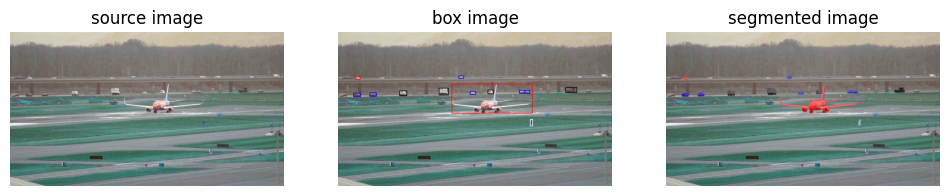


0: 384x640 1 person, 5 cars, 2 airplanes, 4 trucks, 29.1ms
Speed: 0.6ms preprocess, 29.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 531.9631,  241.3770,  910.1228,  379.3113],
        [ 472.6360,  261.2722,  515.4769,  295.5206],
        [  73.5867,  284.8599,  105.2813,  303.4275],
        [ 288.8893,  275.1595,  320.2302,  298.3746],
        [ 148.0059,  285.8554,  178.9705,  300.9860],
        [1061.9749,  260.1326, 1116.4600,  283.9135],
        [ 873.3674,  273.4684,  895.7419,  287.6269],
        [ 617.1558,  277.8210,  643.7633,  292.1241],
        [ 899.1979,  408.7806,  910.8566,  437.2345],
        [ 846.8058,  272.3448,  870.4066,  287.5031],
        [ 564.0454,  206.6880,  587.8628,  216.1800],
        [ 700.5315,  271.8280,  725.2417,  290.3451],
        [  83.4034,  206.1133,  102.9061,  221.4605]], device='cuda:0')


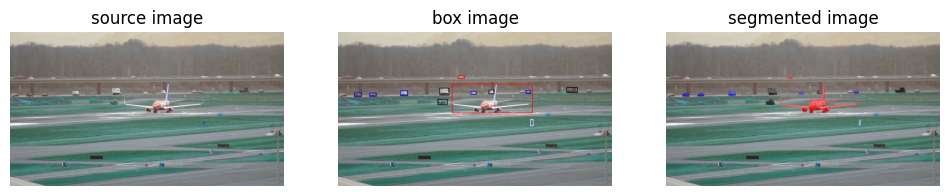


0: 384x640 1 person, 5 cars, 3 airplanes, 3 trucks, 28.6ms
Speed: 0.6ms preprocess, 28.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 531.4186,  241.7204,  909.6384,  379.1891],
        [ 476.5465,  261.1741,  519.3103,  295.3541],
        [  76.5797,  284.8688,  108.6822,  303.6481],
        [ 292.7013,  275.6514,  324.4360,  298.2903],
        [ 146.9934,  285.8513,  178.9618,  300.9038],
        [1065.8931,  259.2468, 1119.5950,  284.0331],
        [ 900.5770,  408.3822,  911.9193,  437.1595],
        [ 621.2309,  278.1269,  646.4311,  291.7941],
        [ 562.4928,  206.8956,  592.9025,  217.4226],
        [ 878.4276,  273.1498,  899.2767,  287.6317],
        [ 703.7488,  271.4157,  728.1426,  291.0848],
        [ 464.6461,  313.6387,  515.1158,  341.4138]], device='cuda:0')


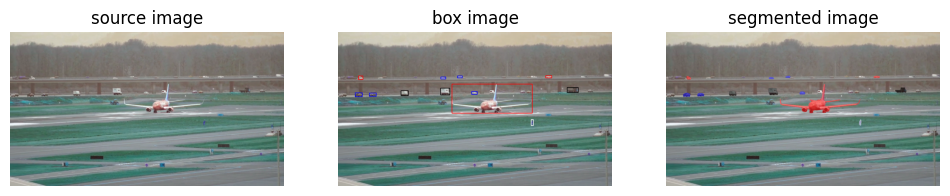


0: 384x640 1 person, 6 cars, 1 airplane, 3 trucks, 28.7ms
Speed: 0.6ms preprocess, 28.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 531.4943,  241.6786,  908.8817,  379.1630],
        [ 479.8533,  260.9347,  523.1053,  295.8943],
        [  80.8594,  285.1277,  112.4414,  303.2194],
        [ 296.3347,  274.9851,  327.5663,  298.2259],
        [ 146.9095,  285.9916,  178.5007,  300.6904],
        [ 902.1956,  408.9904,  913.2578,  436.6531],
        [  95.9465,  205.0427,  116.6310,  221.6953],
        [ 623.6383,  277.7018,  650.1576,  292.4324],
        [ 481.7102,  212.3273,  502.6526,  219.3027],
        [ 970.9429,  204.9612,  998.4082,  213.3819],
        [ 558.5796,  205.9866,  579.9675,  215.1212],
        [1069.9338,  259.7825, 1122.8430,  284.1432]], device='cuda:0')


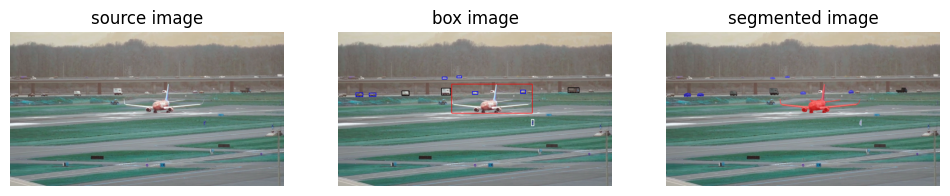


0: 384x640 6 cars, 1 airplane, 4 trucks, 33.0ms
Speed: 0.6ms preprocess, 33.0ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 530.8373,  242.2778,  908.6159,  379.2669],
        [ 483.5397,  261.4714,  526.0900,  296.1166],
        [ 299.3069,  275.2985,  332.1043,  297.9260],
        [  84.3084,  285.0405,  117.2804,  303.4548],
        [1073.2103,  258.5855, 1126.8580,  284.3171],
        [ 145.5416,  286.0630,  177.6829,  301.3421],
        [ 627.0724,  277.9026,  653.2733,  292.4555],
        [ 903.0671,  410.0609,  914.5657,  436.7761],
        [ 487.0507,  211.4799,  510.5360,  220.4218],
        [ 852.0266,  271.1041,  877.1343,  287.2015],
        [ 556.2162,  205.7654,  576.5902,  213.9112]], device='cuda:0')


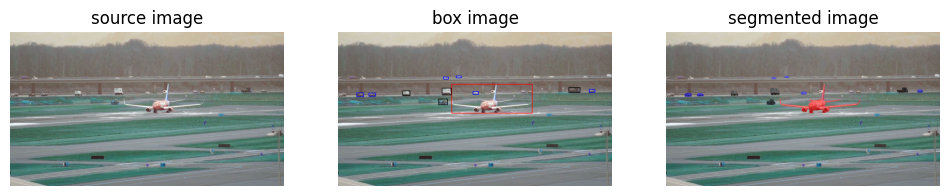


0: 384x640 6 cars, 2 airplanes, 3 trucks, 30.0ms
Speed: 0.6ms preprocess, 30.0ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 531.1383,  242.9874,  909.0804,  379.3072],
        [ 486.7001,  261.1039,  530.3941,  296.1530],
        [  87.2616,  284.3490,  120.9732,  303.0889],
        [1076.6892,  259.5947, 1130.5759,  284.2029],
        [ 144.6602,  285.9223,  176.5362,  301.3780],
        [ 302.9606,  275.5992,  335.6729,  298.1608],
        [ 631.1768,  277.7392,  656.3979,  291.6778],
        [ 469.2330,  313.5257,  513.0269,  341.0457],
        [1173.3967,  268.9161, 1199.9060,  282.6019],
        [ 552.9752,  206.1393,  574.8931,  214.3006],
        [ 492.8525,  211.2043,  515.5781,  220.1798]], device='cuda:0')


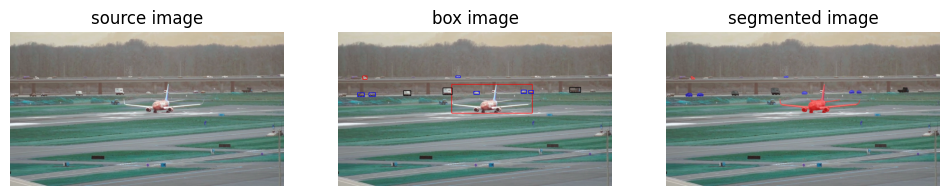


0: 384x640 6 cars, 2 airplanes, 3 trucks, 29.4ms
Speed: 0.6ms preprocess, 29.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 529.9606,  242.1202,  909.0872,  379.5142],
        [ 490.4549,  261.1251,  534.0400,  295.3037],
        [ 306.8161,  274.7935,  339.9804,  298.1094],
        [  91.3041,  284.1541,  124.4715,  303.0859],
        [ 144.1793,  285.1477,  176.1754,  301.4477],
        [1081.5793,  258.2308, 1134.6458,  283.5278],
        [ 634.2051,  277.6074,  661.4533,  291.5005],
        [ 855.3348,  272.0521,  881.3503,  287.6822],
        [ 890.7251,  273.2085,  913.5367,  287.0759],
        [ 550.7693,  205.5146,  572.3496,  213.8984],
        [ 115.7354,  205.3930,  135.6511,  221.1712]], device='cuda:0')


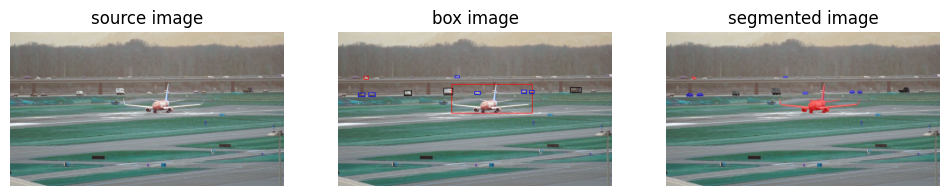


0: 384x640 1 person, 7 cars, 2 airplanes, 3 trucks, 34.4ms
Speed: 0.6ms preprocess, 34.4ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 528.6960,  242.0363,  909.8408,  379.6668],
        [ 493.9821,  261.3650,  536.6605,  295.6776],
        [ 310.6240,  275.1646,  343.2884,  298.4575],
        [ 894.0677,  273.5806,  917.0449,  287.1459],
        [ 856.3783,  272.5098,  882.2350,  287.9069],
        [  95.2027,  284.8013,  127.8285,  303.2572],
        [ 143.5558,  285.6290,  174.7020,  301.7238],
        [1084.8181,  258.7080, 1137.4602,  284.3110],
        [ 637.9658,  277.7731,  666.4021,  292.2285],
        [ 122.9737,  206.2641,  142.0878,  222.0303],
        [ 547.2372,  206.0291,  568.3121,  214.3724]], device='cuda:0')


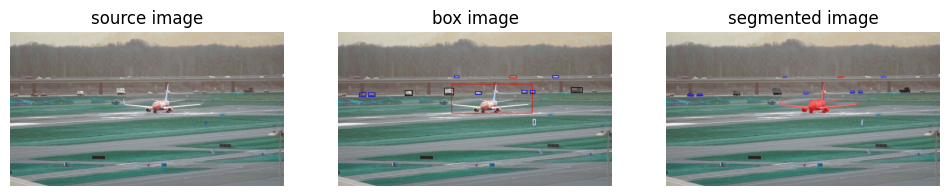


0: 384x640 1 person, 5 cars, 3 airplanes, 4 trucks, 32.6ms
Speed: 0.6ms preprocess, 32.6ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 528.6826,  242.0737,  909.8801,  379.6810],
        [ 498.1667,  261.5774,  539.9847,  295.3120],
        [ 314.3206,  274.7681,  346.7617,  298.0311],
        [ 142.6348,  285.0503,  174.0818,  301.6863],
        [ 858.1381,  272.3408,  884.5887,  288.0112],
        [ 897.1036,  273.4789,  920.1036,  287.1285],
        [1088.1350,  258.3145, 1142.1204,  284.1434],
        [  98.8559,  284.2947,  131.0166,  303.1295],
        [ 641.0345,  278.0291,  668.4083,  292.7912],
        [ 910.8104,  410.1642,  921.3204,  436.0734],
        [ 544.4127,  205.9872,  566.0243,  214.5191],
        [ 799.0225,  204.3053,  832.9604,  215.6290],
        [1002.1862,  204.0873, 1030.1891,  213.3562]], device='cuda:0')


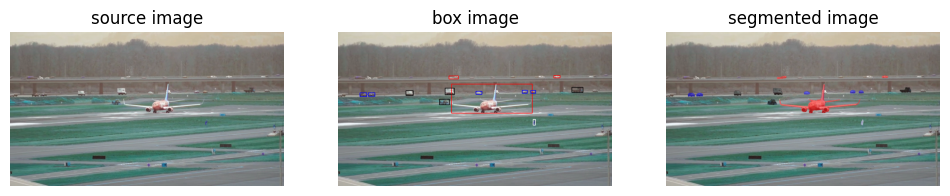


0: 384x640 1 person, 4 cars, 4 airplanes, 4 trucks, 29.1ms
Speed: 0.6ms preprocess, 29.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 528.7979,  242.1822,  909.9209,  379.5514],
        [ 501.4750,  261.4523,  543.5181,  294.6569],
        [ 318.8054,  274.4907,  350.4131,  297.4322],
        [ 900.6620,  272.9737,  923.1875,  286.5926],
        [ 860.1525,  271.8385,  885.0591,  287.3177],
        [1091.0247,  258.1860, 1145.0320,  283.1151],
        [ 517.4247,  205.6171,  562.3398,  220.1336],
        [ 141.2344,  284.1031,  172.6742,  301.5291],
        [ 911.0735,  410.9280,  922.9469,  435.5393],
        [ 644.3724,  277.6245,  671.2615,  291.4509],
        [1008.1268,  203.8774, 1036.9491,  212.9694],
        [ 102.2352,  283.5482,  134.4464,  302.8948],
        [ 473.9116,  313.8127,  519.7108,  341.4194]], device='cuda:0')


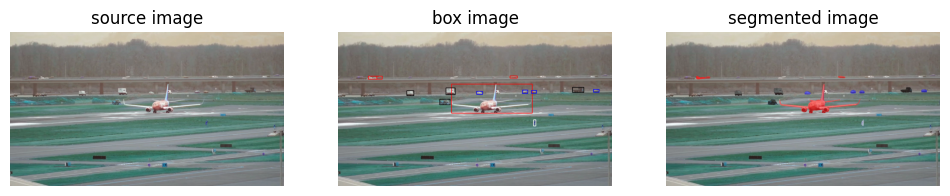


0: 384x640 1 person, 9 cars, 2 airplanes, 5 trucks, 63.2ms
Speed: 0.6ms preprocess, 63.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 528.3177,  242.0039,  910.2291,  379.8116],
        [ 505.4391,  261.4166,  547.4520,  295.1155],
        [ 322.0883,  273.9969,  353.5657,  298.1389],
        [ 903.8058,  273.1320,  927.8419,  286.5785],
        [1095.9526,  257.9779, 1149.0239,  283.4435],
        [ 862.0762,  272.1975,  887.3689,  287.3650],
        [ 141.1158,  204.6600,  182.7591,  220.6957],
        [ 912.3922,  410.0690,  924.6383,  436.8071],
        [ 647.3672,  277.4036,  674.4087,  291.9913],
        [ 140.9767,  204.9919,  205.6758,  219.4339],
        [1193.1082,  268.4393, 1219.5093,  281.8644],
        [ 475.8050,  313.4993,  520.4178,  341.2561],
        [ 800.5289,  204.3246,  838.8060,  215.9937]], device='cuda:0')


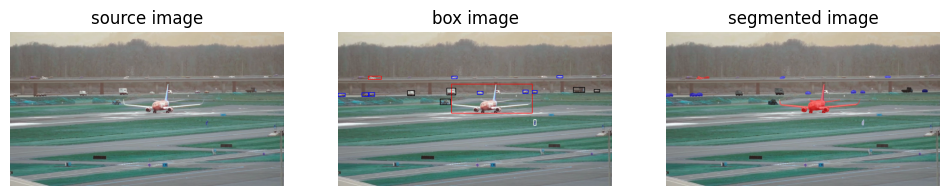


0: 384x640 1 person, 7 cars, 3 airplanes, 4 trucks, 63.2ms
Speed: 0.5ms preprocess, 63.2ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.2664e+02, 2.4113e+02, 9.0850e+02, 3.7986e+02],
        [5.0880e+02, 2.6161e+02, 5.5109e+02, 2.9514e+02],
        [1.0997e+03, 2.5899e+02, 1.1515e+03, 2.8342e+02],
        [3.2631e+02, 2.7462e+02, 3.5720e+02, 2.9825e+02],
        [8.6339e+02, 2.7228e+02, 8.8934e+02, 2.8772e+02],
        [9.0764e+02, 2.7296e+02, 9.3032e+02, 2.8652e+02],
        [6.5041e+02, 2.7717e+02, 6.7664e+02, 2.9107e+02],
        [9.1434e+02, 4.0955e+02, 9.2657e+02, 4.3673e+02],
        [1.3937e+02, 2.8208e+02, 1.7180e+02, 3.0121e+02],
        [1.1974e+03, 2.6917e+02, 1.2219e+03, 2.8179e+02],
        [1.4713e+02, 2.0562e+02, 2.0196e+02, 2.2001e+02],
        [4.7664e+02, 3.1347e+02, 5.2075e+02, 3.4081e+02],
        [5.3110e+02, 2.0647e+02, 5.5608e+02, 2.1792e+02],
        [1.1283e+02, 2.8351e+02, 1.4496e+02, 3.0294e+02],
        [1.0218e+03, 2.0454e+02, 1.0505e+03, 2.1365e+02],
        [1.3962e-01, 2.8546e+02, 3.4474e+01, 3.0379e+02],
        [1.1974e+03, 2.6968e+02, 1.2212e+03, 2.8200e+02]], device='cuda:

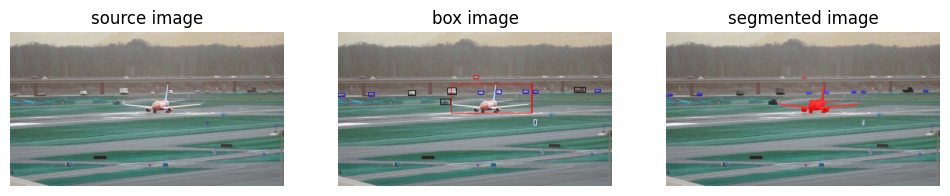


0: 384x640 1 person, 7 cars, 1 airplane, 3 trucks, 29.2ms
Speed: 0.6ms preprocess, 29.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.2529e+02, 2.4140e+02, 9.1003e+02, 3.8001e+02],
        [5.1299e+02, 2.6165e+02, 5.5411e+02, 2.9519e+02],
        [3.2914e+02, 2.7453e+02, 3.6183e+02, 2.9828e+02],
        [8.6530e+02, 2.7214e+02, 8.9071e+02, 2.8762e+02],
        [6.5573e+02, 2.7766e+02, 6.8053e+02, 2.9092e+02],
        [1.2009e+03, 2.6945e+02, 1.2257e+03, 2.8144e+02],
        [1.1046e+03, 2.5869e+02, 1.1564e+03, 2.8323e+02],
        [9.1554e+02, 4.0897e+02, 9.2835e+02, 4.3715e+02],
        [7.3740e+02, 2.7205e+02, 7.6221e+02, 2.8954e+02],
        [1.3502e-01, 2.8630e+02, 3.2312e+01, 3.0369e+02],
        [9.1076e+02, 2.7274e+02, 9.3449e+02, 2.8667e+02],
        [5.4309e+02, 2.6518e+02, 8.6034e+02, 3.6973e+02],
        [6.3273e+02, 2.0131e+02, 6.5796e+02, 2.1892e+02],
        [1.4228e+02, 2.8203e+02, 1.7109e+02, 3.0141e+02],
        [4.7775e+02, 3.1441e+02, 5.2113e+02, 3.4089e+02]], device='cuda:0')


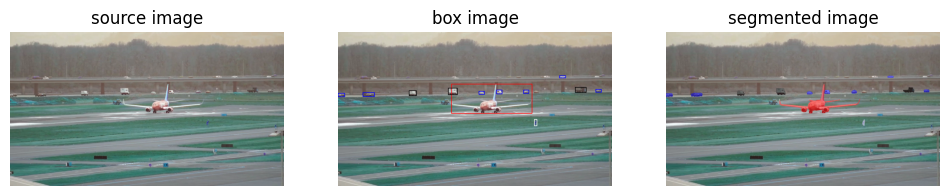


0: 384x640 1 person, 6 cars, 2 airplanes, 3 trucks, 29.9ms
Speed: 1.0ms preprocess, 29.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.2480e+02, 2.4263e+02, 9.0945e+02, 3.8032e+02],
        [5.1645e+02, 2.6196e+02, 5.5742e+02, 2.9472e+02],
        [8.6695e+02, 2.7206e+02, 8.9237e+02, 2.8773e+02],
        [1.1065e+03, 2.5775e+02, 1.1600e+03, 2.8345e+02],
        [1.7155e-01, 2.8536e+02, 3.2627e+01, 3.0367e+02],
        [9.1718e+02, 4.0898e+02, 9.2990e+02, 4.3772e+02],
        [3.3272e+02, 2.7469e+02, 3.6579e+02, 2.9789e+02],
        [6.5742e+02, 2.7736e+02, 6.8443e+02, 2.9178e+02],
        [1.1856e+02, 2.8240e+02, 1.7091e+02, 3.0308e+02],
        [7.3988e+02, 2.7182e+02, 7.6565e+02, 2.8961e+02],
        [1.0353e+03, 2.0432e+02, 1.0626e+03, 2.1276e+02],
        [1.2044e+03, 2.6894e+02, 1.2299e+03, 2.8180e+02]], device='cuda:0')


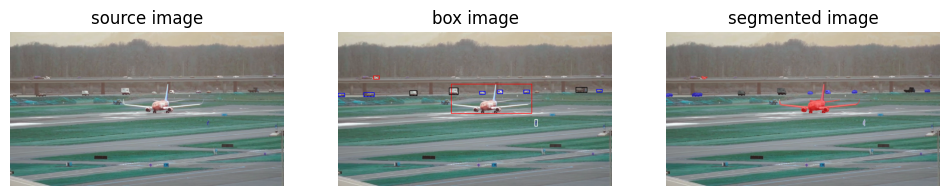


0: 384x640 8 cars, 1 airplane, 3 trucks, 29.1ms
Speed: 0.6ms preprocess, 29.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.2472e+02, 2.4277e+02, 9.0822e+02, 3.7999e+02],
        [5.1929e+02, 2.6134e+02, 5.6177e+02, 2.9503e+02],
        [8.6787e+02, 2.7166e+02, 8.9429e+02, 2.8710e+02],
        [3.3711e+02, 2.7415e+02, 3.6867e+02, 2.9762e+02],
        [1.1101e+03, 2.5913e+02, 1.1640e+03, 2.8306e+02],
        [1.7467e-02, 2.8588e+02, 3.2113e+01, 3.0365e+02],
        [9.1883e+02, 4.0913e+02, 9.3156e+02, 4.3713e+02],
        [1.2238e+02, 2.8208e+02, 1.7074e+02, 3.0340e+02],
        [6.6171e+02, 2.7736e+02, 6.8745e+02, 2.9153e+02],
        [1.2076e+03, 2.6874e+02, 1.2338e+03, 2.8141e+02],
        [7.4424e+02, 2.7215e+02, 7.6957e+02, 2.8979e+02],
        [1.6365e+02, 2.0481e+02, 1.9293e+02, 2.2051e+02]], device='cuda:0')


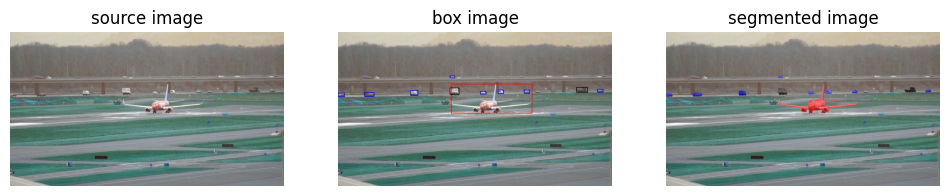


0: 384x640 9 cars, 1 airplane, 3 trucks, 32.4ms
Speed: 0.6ms preprocess, 32.4ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.2616e+02, 2.4278e+02, 9.0900e+02, 3.7971e+02],
        [5.2342e+02, 2.6114e+02, 5.6577e+02, 2.9445e+02],
        [1.1142e+03, 2.5819e+02, 1.1666e+03, 2.8284e+02],
        [8.7035e+02, 2.7128e+02, 8.9534e+02, 2.8688e+02],
        [3.4093e+02, 2.7399e+02, 3.7290e+02, 2.9689e+02],
        [6.6466e+02, 2.7734e+02, 6.9163e+02, 2.9006e+02],
        [1.2132e+03, 2.6866e+02, 1.2374e+03, 2.8094e+02],
        [3.4088e+02, 2.7406e+02, 3.7270e+02, 2.9697e+02],
        [1.9776e-01, 2.8576e+02, 3.0833e+01, 3.0277e+02],
        [1.2586e+02, 2.8296e+02, 1.6972e+02, 3.0312e+02],
        [5.2430e+02, 2.0574e+02, 5.4545e+02, 2.1390e+02],
        [7.4812e+02, 2.7104e+02, 7.7367e+02, 2.8917e+02]], device='cuda:0')


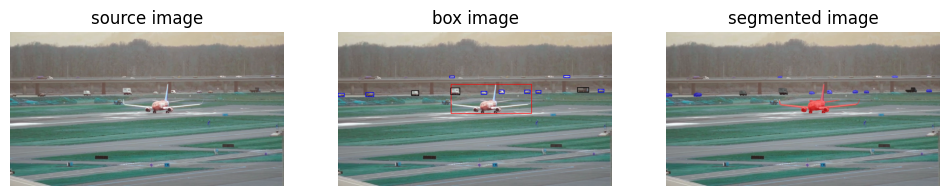


0: 384x640 1 person, 9 cars, 1 airplane, 3 trucks, 36.7ms
Speed: 0.7ms preprocess, 36.7ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.2413e+02, 2.4313e+02, 9.0808e+02, 3.8062e+02],
        [5.2673e+02, 2.6119e+02, 5.6930e+02, 2.9478e+02],
        [8.7186e+02, 2.7194e+02, 8.9683e+02, 2.8712e+02],
        [3.4460e+02, 2.7421e+02, 3.7699e+02, 2.9810e+02],
        [1.1179e+03, 2.5804e+02, 1.1715e+03, 2.8353e+02],
        [6.6864e+02, 2.7761e+02, 6.9489e+02, 2.9135e+02],
        [1.3016e+02, 2.8337e+02, 1.6801e+02, 3.0284e+02],
        [9.2480e+02, 2.7294e+02, 9.4865e+02, 2.8641e+02],
        [3.4321e-02, 2.8615e+02, 2.9657e+01, 3.0354e+02],
        [1.2171e+03, 2.6874e+02, 1.2414e+03, 2.8106e+02],
        [5.2215e+02, 2.0551e+02, 5.4202e+02, 2.1361e+02],
        [7.5211e+02, 2.7216e+02, 7.7609e+02, 2.8935e+02],
        [1.0551e+03, 2.0435e+02, 1.0837e+03, 2.1325e+02]], device='cuda:0')


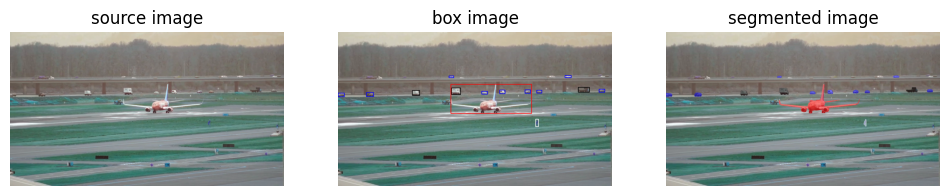


0: 384x640 1 person, 8 cars, 2 airplanes, 3 trucks, 50.3ms
Speed: 0.7ms preprocess, 50.3ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.2187e+02, 2.4394e+02, 9.0719e+02, 3.8005e+02],
        [5.3114e+02, 2.6116e+02, 5.7267e+02, 2.9464e+02],
        [3.4853e+02, 2.7413e+02, 3.8027e+02, 2.9688e+02],
        [8.7359e+02, 2.7129e+02, 8.9888e+02, 2.8721e+02],
        [2.4893e-02, 2.8479e+02, 2.9233e+01, 3.0311e+02],
        [9.2866e+02, 2.7294e+02, 9.5268e+02, 2.8567e+02],
        [9.2397e+02, 4.0804e+02, 9.3819e+02, 4.4405e+02],
        [1.3337e+02, 2.8239e+02, 1.6811e+02, 3.0264e+02],
        [1.2212e+03, 2.6827e+02, 1.2462e+03, 2.8087e+02],
        [6.7157e+02, 2.7749e+02, 6.9845e+02, 2.9037e+02],
        [5.1925e+02, 2.0565e+02, 5.3956e+02, 2.1354e+02],
        [7.5523e+02, 2.7131e+02, 7.8001e+02, 2.8893e+02],
        [1.0610e+03, 2.0355e+02, 1.0892e+03, 2.1300e+02],
        [1.1216e+03, 2.5773e+02, 1.1751e+03, 2.8291e+02]], device='cuda:0')


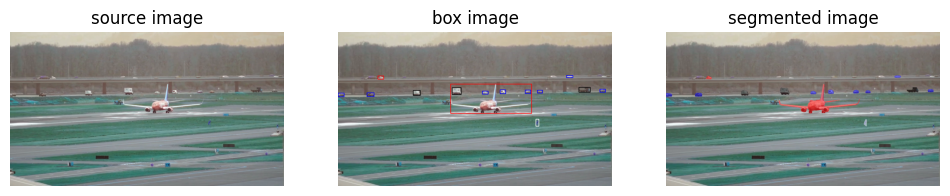


0: 384x640 1 person, 9 cars, 2 airplanes, 3 trucks, 29.7ms
Speed: 0.6ms preprocess, 29.7ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.2135e+02, 2.4343e+02, 9.0717e+02, 3.8018e+02],
        [5.3408e+02, 2.6015e+02, 5.7585e+02, 2.9447e+02],
        [3.5265e+02, 2.7397e+02, 3.8399e+02, 2.9708e+02],
        [8.7557e+02, 2.7147e+02, 9.0035e+02, 2.8705e+02],
        [2.4475e-02, 2.8486e+02, 2.8823e+01, 3.0280e+02],
        [9.3185e+02, 2.7256e+02, 9.5550e+02, 2.8563e+02],
        [1.3736e+02, 2.8315e+02, 1.6890e+02, 3.0178e+02],
        [9.2472e+02, 4.0779e+02, 9.3901e+02, 4.4237e+02],
        [1.1243e+03, 2.5830e+02, 1.1790e+03, 2.8256e+02],
        [1.2246e+03, 2.6832e+02, 1.2495e+03, 2.8100e+02],
        [7.5850e+02, 2.7105e+02, 7.8221e+02, 2.8869e+02],
        [6.7479e+02, 2.7685e+02, 7.0200e+02, 2.9011e+02],
        [1.0680e+03, 2.0361e+02, 1.0961e+03, 2.1283e+02],
        [1.8544e+02, 2.0498e+02, 2.1270e+02, 2.2054e+02]], device='cuda:0')


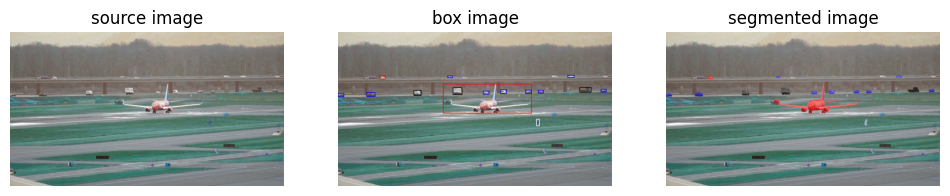


0: 384x640 1 person, 9 cars, 1 airplane, 3 trucks, 29.4ms
Speed: 0.6ms preprocess, 29.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1880e+02, 2.4215e+02, 9.0736e+02, 3.7996e+02],
        [5.3892e+02, 2.6018e+02, 5.7947e+02, 2.9411e+02],
        [1.3486e+02, 2.8330e+02, 1.7351e+02, 3.0088e+02],
        [3.5608e+02, 2.7381e+02, 3.8808e+02, 2.9675e+02],
        [8.7707e+02, 2.7148e+02, 9.0217e+02, 2.8712e+02],
        [9.3532e+02, 2.7229e+02, 9.5982e+02, 2.8562e+02],
        [3.0533e-02, 2.8555e+02, 2.8565e+01, 3.0264e+02],
        [1.1285e+03, 2.5880e+02, 1.1822e+03, 2.8254e+02],
        [7.6059e+02, 2.7075e+02, 7.8755e+02, 2.8915e+02],
        [1.2290e+03, 2.6838e+02, 1.2536e+03, 2.8087e+02],
        [5.1281e+02, 2.0590e+02, 5.3416e+02, 2.1369e+02],
        [6.7930e+02, 2.7628e+02, 7.0482e+02, 2.8970e+02],
        [9.2670e+02, 4.0850e+02, 9.4031e+02, 4.3585e+02],
        [1.0743e+03, 2.0331e+02, 1.1027e+03, 2.1272e+02],
        [1.9364e+02, 2.0486e+02, 2.2022e+02, 2.2027e+02]], device='cuda:0')


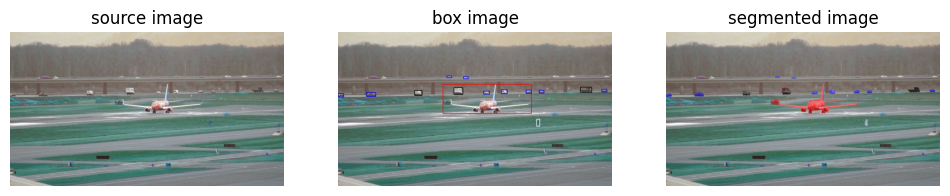


0: 384x640 1 person, 7 cars, 1 airplane, 4 trucks, 63.7ms
Speed: 0.6ms preprocess, 63.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1282e+02, 2.4159e+02, 9.0699e+02, 3.8023e+02],
        [5.4079e+02, 2.5951e+02, 5.8293e+02, 2.9385e+02],
        [1.3328e+02, 2.8327e+02, 1.7681e+02, 3.0123e+02],
        [3.5908e+02, 2.7401e+02, 3.9194e+02, 2.9688e+02],
        [9.4019e+02, 2.7267e+02, 9.6173e+02, 2.8505e+02],
        [1.1308e+03, 2.5825e+02, 1.1852e+03, 2.8254e+02],
        [1.2325e+03, 2.6859e+02, 1.2570e+03, 2.8067e+02],
        [8.7840e+02, 2.7134e+02, 9.0360e+02, 2.8714e+02],
        [3.5805e-02, 2.8606e+02, 2.7432e+01, 3.0259e+02],
        [6.8041e+02, 2.7599e+02, 7.0776e+02, 2.9001e+02],
        [5.0950e+02, 2.0582e+02, 5.3108e+02, 2.1344e+02],
        [7.6295e+02, 2.7090e+02, 7.9004e+02, 2.8917e+02],
        [9.2781e+02, 4.0908e+02, 9.4224e+02, 4.3708e+02],
        [5.8708e+02, 2.0988e+02, 6.0828e+02, 2.1767e+02]], device='cuda:0')


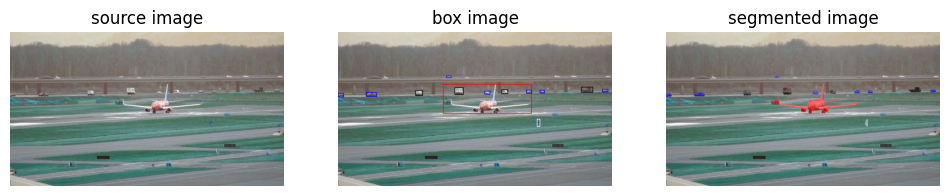


0: 384x640 1 person, 6 cars, 2 airplanes, 4 trucks, 32.9ms
Speed: 0.6ms preprocess, 32.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1595e+02, 2.4219e+02, 9.0663e+02, 3.8064e+02],
        [5.4449e+02, 2.5982e+02, 5.8741e+02, 2.9400e+02],
        [1.3289e+02, 2.8258e+02, 1.8043e+02, 3.0185e+02],
        [3.6269e+02, 2.7404e+02, 3.9599e+02, 2.9652e+02],
        [1.1357e+03, 2.5767e+02, 1.1902e+03, 2.8252e+02],
        [6.8529e+02, 2.7623e+02, 7.1151e+02, 2.8982e+02],
        [8.8086e+02, 2.7108e+02, 9.0599e+02, 2.8686e+02],
        [5.1355e-02, 2.8648e+02, 2.6581e+01, 3.0247e+02],
        [7.6565e+02, 2.7016e+02, 7.9405e+02, 2.8936e+02],
        [9.3009e+02, 4.0854e+02, 9.4459e+02, 4.4385e+02],
        [5.0731e+02, 2.0582e+02, 5.2804e+02, 2.1343e+02],
        [1.2361e+03, 2.6736e+02, 1.2606e+03, 2.8107e+02],
        [9.4318e+02, 2.7228e+02, 9.6426e+02, 2.8570e+02]], device='cuda:0')


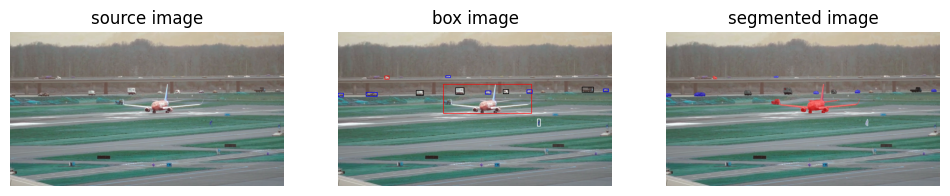


0: 384x640 1 person, 8 cars, 1 airplane, 5 trucks, 28.9ms
Speed: 0.6ms preprocess, 28.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1872e+02, 2.4144e+02, 9.0649e+02, 3.8039e+02],
        [5.4907e+02, 2.6005e+02, 5.8955e+02, 2.9339e+02],
        [1.3224e+02, 2.8249e+02, 1.8360e+02, 3.0085e+02],
        [3.6637e+02, 2.7360e+02, 3.9894e+02, 2.9612e+02],
        [1.1400e+03, 2.5766e+02, 1.1944e+03, 2.8218e+02],
        [1.2405e+03, 2.6688e+02, 1.2638e+03, 2.8057e+02],
        [8.8209e+02, 2.7083e+02, 9.0747e+02, 2.8687e+02],
        [3.3255e-02, 2.8606e+02, 2.5579e+01, 3.0231e+02],
        [7.7109e+02, 2.7031e+02, 7.9646e+02, 2.8942e+02],
        [9.3152e+02, 4.0740e+02, 9.4648e+02, 4.3920e+02],
        [6.8828e+02, 2.7581e+02, 7.1429e+02, 2.9006e+02],
        [5.0340e+02, 2.0628e+02, 5.2412e+02, 2.1310e+02],
        [2.1960e+02, 2.0526e+02, 2.3819e+02, 2.1938e+02]], device='cuda:0')


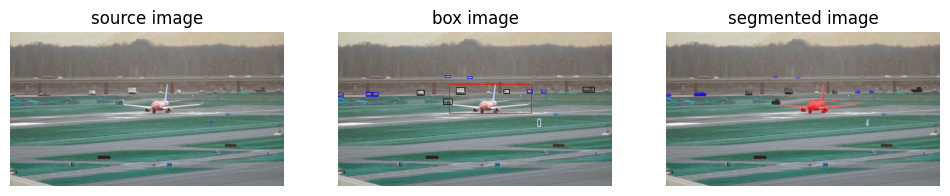


0: 384x640 1 person, 7 cars, 1 airplane, 3 trucks, 63.3ms
Speed: 0.7ms preprocess, 63.3ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1680e+02, 2.4084e+02, 9.0608e+02, 3.8046e+02],
        [5.5269e+02, 2.5965e+02, 5.9417e+02, 2.9346e+02],
        [1.1434e+03, 2.5783e+02, 1.1985e+03, 2.8222e+02],
        [3.7059e+02, 2.7369e+02, 4.0303e+02, 2.9607e+02],
        [3.4143e-02, 2.8585e+02, 2.4473e+01, 3.0200e+02],
        [1.5824e+02, 2.8296e+02, 1.8722e+02, 2.9997e+02],
        [8.8316e+02, 2.7089e+02, 9.0888e+02, 2.8659e+02],
        [9.3337e+02, 4.0706e+02, 9.4695e+02, 4.3878e+02],
        [1.3223e+02, 2.8267e+02, 1.8676e+02, 3.0067e+02],
        [1.3174e+02, 2.8363e+02, 1.5899e+02, 3.0027e+02],
        [7.7560e+02, 2.6983e+02, 8.0007e+02, 2.8928e+02],
        [6.0628e+02, 2.1003e+02, 6.2867e+02, 2.1787e+02],
        [5.0017e+02, 2.0568e+02, 5.2246e+02, 2.1375e+02],
        [9.4953e+02, 2.7130e+02, 9.7229e+02, 2.8558e+02],
        [4.9202e+02, 3.1122e+02, 5.3300e+02, 3.3955e+02]], device='cuda:0')


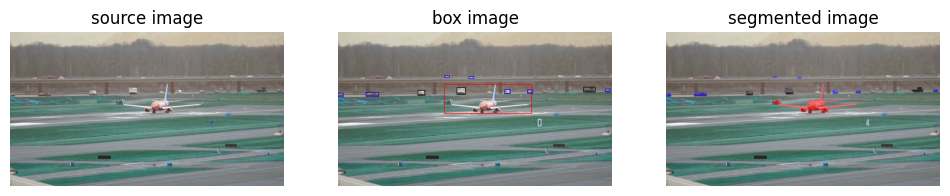


0: 384x640 1 person, 8 cars, 2 airplanes, 5 trucks, 34.1ms
Speed: 0.6ms preprocess, 34.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1493e+02, 2.4147e+02, 9.0618e+02, 3.8060e+02],
        [5.5607e+02, 2.5968e+02, 5.9710e+02, 2.9326e+02],
        [1.3179e+02, 2.8231e+02, 1.9010e+02, 3.0060e+02],
        [1.1468e+03, 2.5805e+02, 1.2010e+03, 2.8201e+02],
        [3.8790e-02, 2.8603e+02, 2.4120e+01, 3.0208e+02],
        [3.7468e+02, 2.7363e+02, 4.0638e+02, 2.9598e+02],
        [8.8531e+02, 2.7106e+02, 9.1078e+02, 2.8645e+02],
        [7.7886e+02, 2.7042e+02, 8.0301e+02, 2.8922e+02],
        [1.2481e+03, 2.6679e+02, 1.2729e+03, 2.8036e+02],
        [4.9772e+02, 2.0572e+02, 5.2003e+02, 2.1387e+02],
        [6.1122e+02, 2.0980e+02, 6.3536e+02, 2.1856e+02],
        [9.3482e+02, 4.0733e+02, 9.4889e+02, 4.3538e+02]], device='cuda:0')


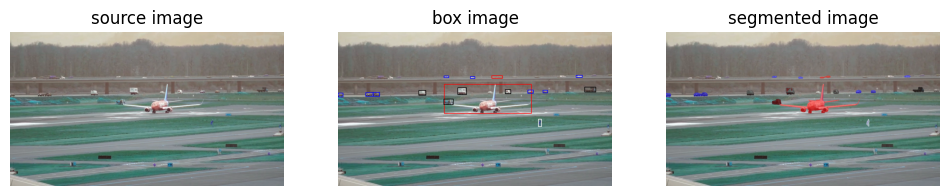


0: 384x640 1 person, 9 cars, 2 airplanes, 5 trucks, 29.9ms
Speed: 0.8ms preprocess, 29.9ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1865e+02, 2.4150e+02, 9.0640e+02, 3.8087e+02],
        [5.5920e+02, 2.5940e+02, 6.0092e+02, 2.9334e+02],
        [1.3023e+02, 2.8419e+02, 1.6372e+02, 3.0122e+02],
        [1.6611e+02, 2.8201e+02, 1.9340e+02, 2.9997e+02],
        [1.1519e+03, 2.5708e+02, 1.2050e+03, 2.8234e+02],
        [3.7807e+02, 2.7360e+02, 4.1070e+02, 2.9605e+02],
        [4.9626e+02, 2.0618e+02, 5.1591e+02, 2.1309e+02],
        [5.4432e-02, 2.8596e+02, 2.3739e+01, 3.0249e+02],
        [8.8703e+02, 2.7089e+02, 9.1283e+02, 2.8669e+02],
        [9.5649e+02, 2.7193e+02, 9.8035e+02, 2.8526e+02],
        [6.1794e+02, 2.0929e+02, 6.4060e+02, 2.1828e+02],
        [4.9499e+02, 3.1197e+02, 5.3922e+02, 3.4014e+02],
        [7.8106e+02, 2.6987e+02, 8.0711e+02, 2.8941e+02],
        [9.3639e+02, 4.0760e+02, 9.5158e+02, 4.4410e+02],
        [7.1895e+02, 2.0388e+02, 7.6929e+02, 2.1637e+02],
        [1.1142e+03, 2.0215e+02, 1.1406e+03, 2.1142e+02]], device='cuda:0')


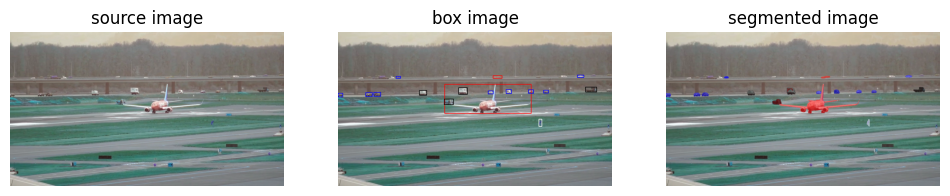


0: 384x640 1 person, 7 cars, 1 airplane, 5 trucks, 29.2ms
Speed: 0.5ms preprocess, 29.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1943e+02, 2.4227e+02, 9.0329e+02, 3.8117e+02],
        [5.6309e+02, 2.5948e+02, 6.0467e+02, 2.9352e+02],
        [1.7090e+02, 2.8439e+02, 1.9781e+02, 2.9995e+02],
        [1.2975e+02, 2.8452e+02, 1.5900e+02, 3.0133e+02],
        [3.8161e+02, 2.7394e+02, 4.1416e+02, 2.9573e+02],
        [8.8891e+02, 2.7147e+02, 9.1475e+02, 2.8663e+02],
        [5.7241e-02, 2.8635e+02, 2.3037e+01, 3.0245e+02],
        [9.6030e+02, 2.7226e+02, 9.8315e+02, 2.8497e+02],
        [4.9592e+02, 3.1182e+02, 5.4116e+02, 3.3964e+02],
        [1.1551e+03, 2.5717e+02, 1.2094e+03, 2.8213e+02],
        [7.8597e+02, 2.7016e+02, 8.0962e+02, 2.8940e+02],
        [1.1188e+03, 2.0187e+02, 1.1485e+03, 2.1130e+02],
        [7.8610e+02, 2.7051e+02, 8.0963e+02, 2.8942e+02],
        [9.3849e+02, 4.0698e+02, 9.5345e+02, 4.4048e+02],
        [7.0278e+02, 2.7490e+02, 7.2625e+02, 2.8932e+02],
        [2.7122e+02, 2.0710e+02, 2.9240e+02, 2.1669e+02],
        [7.2288e+02, 2.0488e+02, 7.6591e+02, 2.1725e+02]], device='cuda:

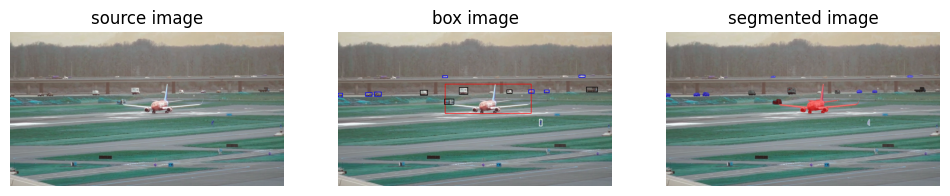


0: 384x640 1 person, 8 cars, 1 airplane, 5 trucks, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1763e+02, 2.4176e+02, 9.0530e+02, 3.8134e+02],
        [5.6634e+02, 2.5952e+02, 6.0697e+02, 2.9297e+02],
        [1.7310e+02, 2.8094e+02, 2.0142e+02, 2.9993e+02],
        [1.2930e+02, 2.8491e+02, 1.5853e+02, 3.0121e+02],
        [3.8590e+02, 2.7367e+02, 4.1873e+02, 2.9567e+02],
        [8.9028e+02, 2.7124e+02, 9.1659e+02, 2.8630e+02],
        [9.6396e+02, 2.7253e+02, 9.8654e+02, 2.8475e+02],
        [4.9727e+02, 3.1192e+02, 5.4267e+02, 3.3927e+02],
        [9.4015e+02, 4.0716e+02, 9.5404e+02, 4.3662e+02],
        [7.3824e-02, 2.8675e+02, 2.2515e+01, 3.0258e+02],
        [7.8893e+02, 2.7061e+02, 8.1307e+02, 2.8943e+02],
        [1.1592e+03, 2.5703e+02, 1.2141e+03, 2.8190e+02],
        [1.1252e+03, 2.0139e+02, 1.1547e+03, 2.1174e+02],
        [4.8933e+02, 2.0593e+02, 5.1044e+02, 2.1356e+02]], device='cuda:0')


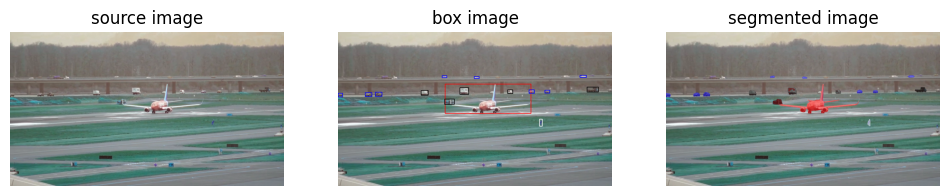


0: 384x640 2 persons, 6 cars, 1 airplane, 4 trucks, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1868e+02, 2.4152e+02, 9.0388e+02, 3.8180e+02],
        [5.7012e+02, 2.5916e+02, 6.1139e+02, 2.9378e+02],
        [1.7468e+02, 2.8160e+02, 2.0501e+02, 3.0042e+02],
        [1.2797e+02, 2.8468e+02, 1.5811e+02, 3.0189e+02],
        [8.9193e+02, 2.7156e+02, 9.1771e+02, 2.8655e+02],
        [3.8909e+02, 2.7387e+02, 4.2161e+02, 2.9603e+02],
        [9.6673e+02, 2.7242e+02, 9.9062e+02, 2.8510e+02],
        [9.4164e+02, 4.0854e+02, 9.5518e+02, 4.3991e+02],
        [1.1620e+03, 2.5716e+02, 1.2161e+03, 2.8241e+02],
        [4.9855e+02, 3.1189e+02, 5.4485e+02, 3.3939e+02],
        [7.9232e+02, 2.7022e+02, 8.1599e+02, 2.8914e+02],
        [5.8247e-02, 2.8582e+02, 2.2281e+01, 3.0303e+02],
        [1.1306e+03, 2.0190e+02, 1.1608e+03, 2.1157e+02],
        [4.8648e+02, 2.0559e+02, 5.0799e+02, 2.1355e+02],
        [6.3595e+02, 2.0953e+02, 6.6038e+02, 2.1815e+02]], device='cuda:0')


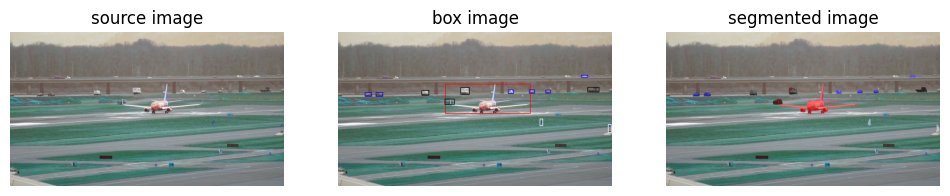


0: 384x640 2 persons, 7 cars, 1 airplane, 4 trucks, 33.0ms
Speed: 0.6ms preprocess, 33.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 520.5215,  242.0518,  902.4287,  381.5742],
        [ 572.2980,  258.9508,  614.2294,  293.1400],
        [ 126.5329,  284.4919,  157.9953,  301.7539],
        [ 392.4102,  273.7084,  424.8040,  296.1729],
        [ 177.8042,  283.1125,  208.1527,  300.1792],
        [1165.4309,  256.7774, 1219.6658,  282.6595],
        [ 892.9490,  271.5789,  918.7925,  286.5667],
        [ 969.8108,  272.5170,  993.0139,  284.9907],
        [ 943.2843,  407.3835,  956.0835,  434.6296],
        [1138.3831,  201.6793, 1166.9473,  211.0485],
        [ 498.9305,  311.6943,  546.3950,  339.0400],
        [ 796.1110,  271.0571,  819.6887,  288.7800],
        [1261.8379,  430.7767, 1274.1270,  463.2802]], device='cuda:0')


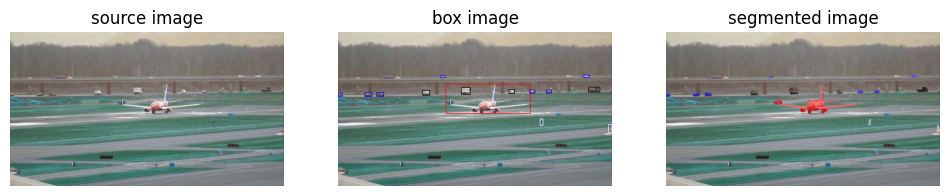


0: 384x640 2 persons, 4 cars, 1 airplane, 4 trucks, 63.2ms
Speed: 2.3ms preprocess, 63.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1898e+02, 2.4196e+02, 9.0306e+02, 3.8160e+02],
        [1.2590e+02, 2.8438e+02, 1.5762e+02, 3.0151e+02],
        [5.7695e+02, 2.5948e+02, 6.1786e+02, 2.9263e+02],
        [3.9622e+02, 2.7332e+02, 4.2832e+02, 2.9605e+02],
        [8.9514e+02, 2.7147e+02, 9.2084e+02, 2.8644e+02],
        [1.8037e+02, 2.8349e+02, 2.1183e+02, 2.9985e+02],
        [1.1697e+03, 2.5683e+02, 1.2239e+03, 2.8231e+02],
        [7.9931e+02, 2.7002e+02, 8.2268e+02, 2.8935e+02],
        [9.7383e+02, 2.7230e+02, 9.9648e+02, 2.8502e+02],
        [9.4458e+02, 4.0802e+02, 9.5834e+02, 4.3447e+02],
        [1.1446e+03, 2.0151e+02, 1.1739e+03, 2.1118e+02],
        [1.2640e+03, 4.3095e+02, 1.2755e+03, 4.6230e+02],
        [4.8073e+02, 2.0584e+02, 5.0181e+02, 2.1359e+02],
        [9.9239e-02, 2.8565e+02, 2.1065e+01, 3.0289e+02]], device='cuda:0')


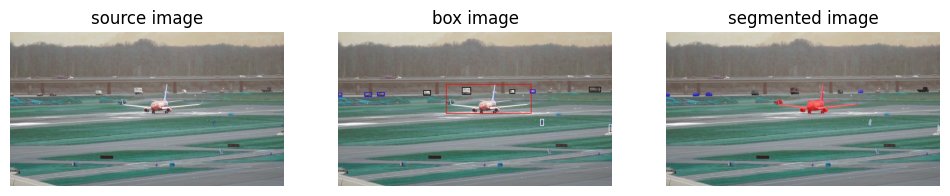


0: 384x640 1 person, 4 cars, 1 airplane, 4 trucks, 30.1ms
Speed: 0.7ms preprocess, 30.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1895e+02, 2.4263e+02, 9.0404e+02, 3.8181e+02],
        [5.8038e+02, 2.5960e+02, 6.2070e+02, 2.9272e+02],
        [1.2598e+02, 2.8498e+02, 1.5579e+02, 3.0125e+02],
        [4.0038e+02, 2.7327e+02, 4.3223e+02, 2.9581e+02],
        [8.9739e+02, 2.7164e+02, 9.2190e+02, 2.8641e+02],
        [1.1726e+03, 2.5699e+02, 1.2283e+03, 2.8172e+02],
        [8.0155e+02, 2.6991e+02, 8.2614e+02, 2.8941e+02],
        [1.8519e+02, 2.8356e+02, 2.1578e+02, 2.9996e+02],
        [9.4626e+02, 4.0735e+02, 9.6078e+02, 4.3436e+02],
        [6.1615e-02, 2.8490e+02, 1.8702e+01, 3.0287e+02],
        [1.2658e+03, 4.3099e+02, 1.2787e+03, 4.6557e+02]], device='cuda:0')


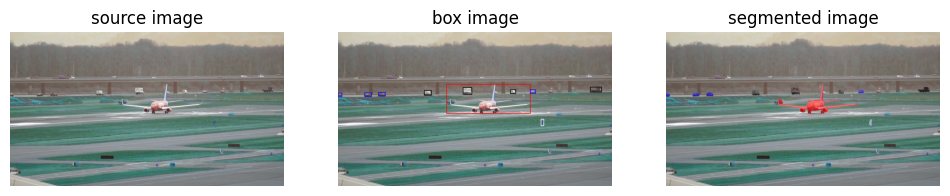


0: 384x640 1 person, 5 cars, 1 airplane, 4 trucks, 30.8ms
Speed: 0.6ms preprocess, 30.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1884e+02, 2.4288e+02, 9.0141e+02, 3.8203e+02],
        [5.8477e+02, 2.5935e+02, 6.2536e+02, 2.9301e+02],
        [1.2457e+02, 2.8495e+02, 1.5543e+02, 3.0166e+02],
        [4.0414e+02, 2.7358e+02, 4.3604e+02, 2.9599e+02],
        [1.8983e+02, 2.8505e+02, 2.1879e+02, 3.0021e+02],
        [8.9867e+02, 2.7125e+02, 9.2413e+02, 2.8623e+02],
        [9.4785e+02, 4.0754e+02, 9.6211e+02, 4.3502e+02],
        [8.0447e+02, 2.6984e+02, 8.2986e+02, 2.8958e+02],
        [1.1774e+03, 2.5708e+02, 1.2321e+03, 2.8234e+02],
        [4.8210e-02, 2.8479e+02, 1.7999e+01, 3.0298e+02]], device='cuda:0')


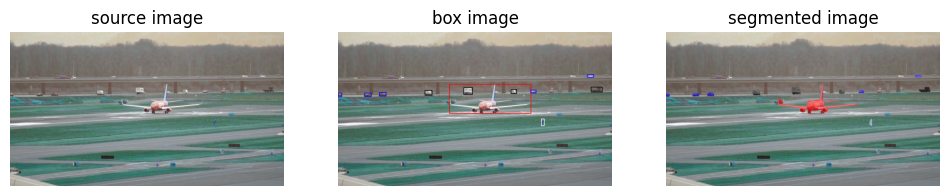


0: 384x640 1 person, 5 cars, 2 airplanes, 4 trucks, 28.7ms
Speed: 0.5ms preprocess, 28.7ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1755e+02, 2.4217e+02, 9.0197e+02, 3.8213e+02],
        [4.0729e+02, 2.7332e+02, 4.3972e+02, 2.9609e+02],
        [1.2428e+02, 2.8497e+02, 1.5485e+02, 3.0112e+02],
        [5.8709e+02, 2.5909e+02, 6.2980e+02, 2.9310e+02],
        [1.1814e+03, 2.5732e+02, 1.2339e+03, 2.8161e+02],
        [9.4992e+02, 4.0801e+02, 9.6279e+02, 4.3462e+02],
        [9.0029e+02, 2.7092e+02, 9.2620e+02, 2.8606e+02],
        [8.0810e+02, 2.6938e+02, 8.3437e+02, 2.8898e+02],
        [1.1641e+03, 1.9988e+02, 1.1937e+03, 2.1062e+02],
        [1.9444e+02, 2.8440e+02, 2.2401e+02, 3.0008e+02],
        [6.6317e-02, 2.8551e+02, 1.6158e+01, 3.0283e+02]], device='cuda:0')


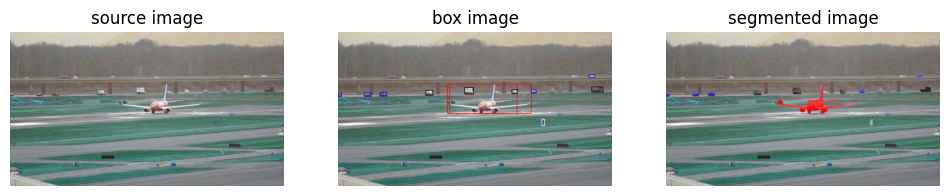


0: 384x640 5 cars, 2 airplanes, 4 trucks, 29.3ms
Speed: 0.6ms preprocess, 29.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1433e+02, 2.4194e+02, 9.0283e+02, 3.8200e+02],
        [1.2347e+02, 2.8493e+02, 1.5447e+02, 3.0095e+02],
        [5.9066e+02, 2.5925e+02, 6.3345e+02, 2.9275e+02],
        [5.2687e+02, 2.6013e+02, 8.1478e+02, 3.8128e+02],
        [4.1180e+02, 2.7246e+02, 4.4367e+02, 2.9609e+02],
        [9.0227e+02, 2.7045e+02, 9.2703e+02, 2.8593e+02],
        [1.9737e+02, 2.8422e+02, 2.2811e+02, 3.0010e+02],
        [1.1853e+03, 2.5668e+02, 1.2390e+03, 2.8111e+02],
        [8.1198e+02, 2.6979e+02, 8.3704e+02, 2.8911e+02],
        [1.1719e+03, 2.0073e+02, 1.2003e+03, 2.1058e+02],
        [9.5108e+02, 4.0862e+02, 9.6534e+02, 4.3409e+02],
        [8.1354e-02, 2.8578e+02, 1.6021e+01, 3.0217e+02]], device='cuda:0')


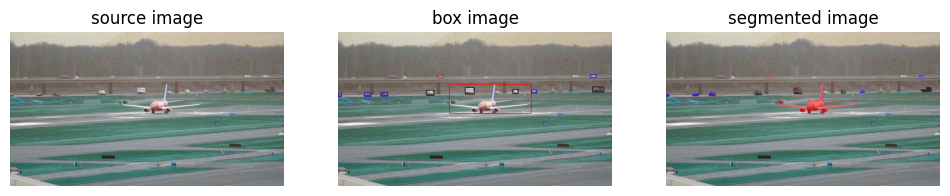


0: 384x640 1 person, 6 cars, 3 airplanes, 4 trucks, 32.1ms
Speed: 0.6ms preprocess, 32.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1045e+02, 2.4168e+02, 9.0307e+02, 3.8204e+02],
        [1.2274e+02, 2.8430e+02, 1.5381e+02, 3.0099e+02],
        [5.9471e+02, 2.5928e+02, 6.3612e+02, 2.9277e+02],
        [4.1559e+02, 2.7251e+02, 4.4762e+02, 2.9561e+02],
        [1.1889e+03, 2.5679e+02, 1.2430e+03, 2.8073e+02],
        [9.0398e+02, 2.7070e+02, 9.2888e+02, 2.8574e+02],
        [1.1792e+03, 2.0038e+02, 1.2073e+03, 2.1057e+02],
        [8.1536e+02, 2.6935e+02, 8.4145e+02, 2.8815e+02],
        [2.0113e+02, 2.8403e+02, 2.3243e+02, 2.9986e+02],
        [6.1432e-02, 2.8619e+02, 1.5294e+01, 3.0312e+02],
        [4.6583e+02, 2.0553e+02, 4.8836e+02, 2.1370e+02]], device='cuda:0')


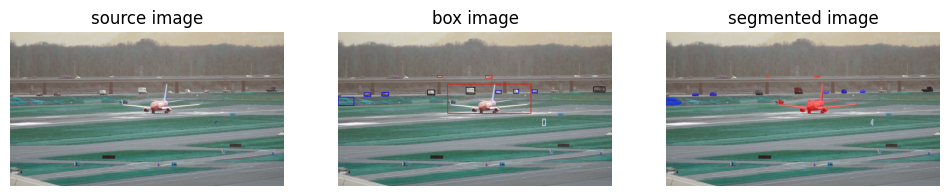


0: 384x640 1 person, 6 cars, 1 airplane, 3 trucks, 32.0ms
Speed: 0.7ms preprocess, 32.0ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1082e+02, 2.4154e+02, 9.0321e+02, 3.8176e+02],
        [1.2229e+02, 2.8391e+02, 1.5324e+02, 3.0074e+02],
        [5.9888e+02, 2.5859e+02, 6.3952e+02, 2.9171e+02],
        [2.0507e+02, 2.8373e+02, 2.3556e+02, 2.9940e+02],
        [4.2036e+02, 2.7179e+02, 4.5243e+02, 2.9496e+02],
        [9.0595e+02, 2.7011e+02, 9.3155e+02, 2.8612e+02],
        [1.1935e+03, 2.5643e+02, 1.2492e+03, 2.8125e+02],
        [6.8823e+02, 2.0398e+02, 7.2120e+02, 2.1552e+02],
        [8.1990e+02, 2.6920e+02, 8.4367e+02, 2.8819e+02],
        [8.1993e+02, 2.6916e+02, 8.4388e+02, 2.8790e+02],
        [9.5567e+02, 4.0627e+02, 9.6945e+02, 4.3337e+02],
        [4.6489e+02, 2.0473e+02, 4.8417e+02, 2.1253e+02],
        [7.3580e+02, 2.7513e+02, 7.6297e+02, 2.8913e+02],
        [4.0594e-01, 3.0349e+02, 7.5989e+01, 3.3647e+02]], device='cuda:0')


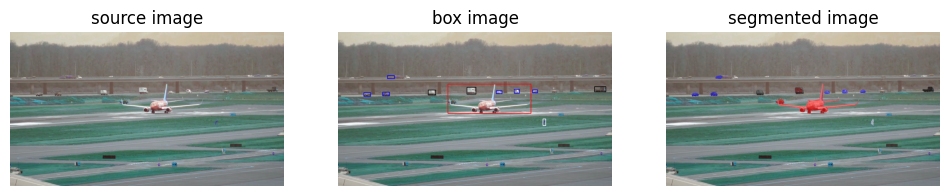


0: 384x640 1 person, 9 cars, 1 airplane, 3 trucks, 31.0ms
Speed: 0.6ms preprocess, 31.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.6706,  241.4824,  903.1265,  381.4691],
        [ 121.4811,  283.8116,  152.6181,  300.6412],
        [ 602.3049,  257.9704,  644.9870,  291.9806],
        [ 209.5870,  282.9110,  239.8427,  298.5485],
        [ 422.9907,  272.1244,  456.2659,  294.5604],
        [ 823.9246,  269.2264,  847.3079,  286.9288],
        [ 908.2433,  269.1598,  933.2238,  285.7635],
        [ 957.4045,  406.9321,  970.6453,  433.6899],
        [ 229.7275,  204.4386,  261.5882,  218.5397],
        [1197.0388,  255.5038, 1252.8452,  281.0895],
        [ 739.1507,  274.7114,  764.5080,  287.6726]], device='cuda:0')


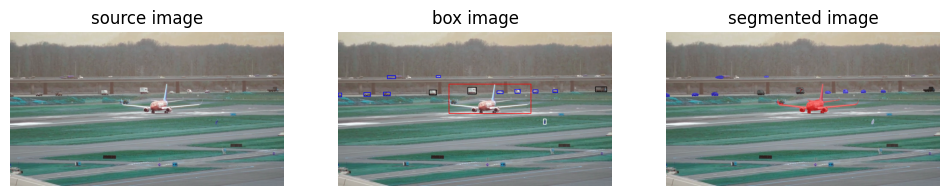


0: 384x640 1 person, 6 cars, 1 airplane, 3 trucks, 29.9ms
Speed: 0.7ms preprocess, 29.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1221e+02, 2.4159e+02, 9.0387e+02, 3.8173e+02],
        [1.2138e+02, 2.8420e+02, 1.5236e+02, 3.0063e+02],
        [6.0607e+02, 2.5829e+02, 6.4746e+02, 2.9165e+02],
        [2.1242e+02, 2.8310e+02, 2.4387e+02, 2.9881e+02],
        [9.0942e+02, 2.6916e+02, 9.3490e+02, 2.8564e+02],
        [4.2716e+02, 2.7225e+02, 4.5959e+02, 2.9456e+02],
        [8.2721e+02, 2.6949e+02, 8.5058e+02, 2.8718e+02],
        [2.9703e-02, 2.8530e+02, 1.7462e+01, 3.0283e+02],
        [9.5919e+02, 4.0738e+02, 9.7223e+02, 4.3319e+02],
        [1.2010e+03, 2.5529e+02, 1.2562e+03, 2.8142e+02],
        [2.2968e+02, 2.0471e+02, 2.6801e+02, 2.1877e+02],
        [7.4226e+02, 2.7472e+02, 7.7122e+02, 2.8745e+02],
        [1.0040e+03, 2.7195e+02, 1.0257e+03, 2.8353e+02],
        [4.5850e+02, 2.0484e+02, 4.7947e+02, 2.1225e+02]], device='cuda:0')


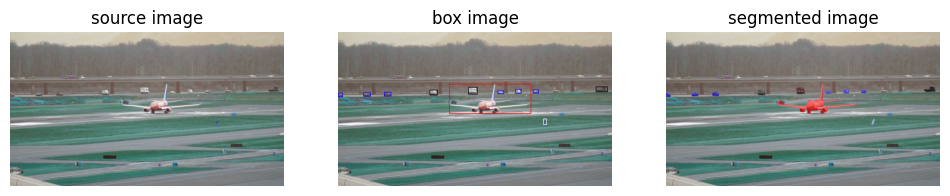


0: 384x640 1 person, 6 cars, 2 airplanes, 3 trucks, 28.9ms
Speed: 0.6ms preprocess, 28.9ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1457e+02, 2.4288e+02, 9.0148e+02, 3.8179e+02],
        [6.0986e+02, 2.5853e+02, 6.5223e+02, 2.9177e+02],
        [1.2018e+02, 2.8436e+02, 1.5199e+02, 3.0093e+02],
        [4.3081e+02, 2.7225e+02, 4.6356e+02, 2.9466e+02],
        [9.1137e+02, 2.7012e+02, 9.3662e+02, 2.8580e+02],
        [2.1573e+02, 2.8311e+02, 2.4807e+02, 2.9973e+02],
        [2.9314e-02, 2.8501e+02, 2.1642e+01, 3.0282e+02],
        [8.2989e+02, 2.6944e+02, 8.5397e+02, 2.8744e+02],
        [7.4608e+02, 2.7538e+02, 7.7430e+02, 2.8723e+02],
        [1.2045e+03, 2.5537e+02, 1.2589e+03, 2.8093e+02],
        [9.6027e+02, 4.0746e+02, 9.7415e+02, 4.3335e+02]], device='cuda:0')


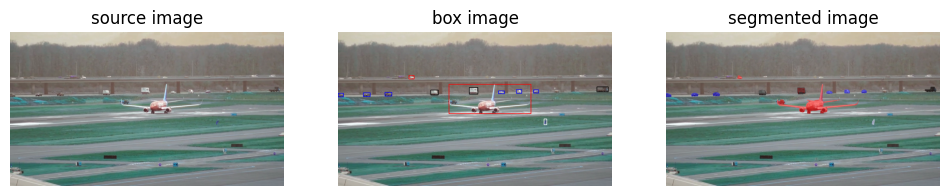


0: 384x640 1 person, 6 cars, 2 airplanes, 4 trucks, 39.6ms
Speed: 0.6ms preprocess, 39.6ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1631e+02, 2.4263e+02, 9.0312e+02, 3.8205e+02],
        [6.1226e+02, 2.5857e+02, 6.5446e+02, 2.9169e+02],
        [1.1868e+02, 2.8452e+02, 1.5003e+02, 3.0158e+02],
        [9.1303e+02, 2.7007e+02, 9.3813e+02, 2.8559e+02],
        [2.1936e+02, 2.8372e+02, 2.5034e+02, 2.9994e+02],
        [4.3463e+02, 2.7202e+02, 4.6750e+02, 2.9527e+02],
        [8.3408e+02, 2.7042e+02, 8.5711e+02, 2.8713e+02],
        [1.2079e+03, 2.5574e+02, 1.2622e+03, 2.8128e+02],
        [9.6208e+02, 4.0785e+02, 9.7612e+02, 4.3357e+02],
        [7.4907e+02, 2.7501e+02, 7.7895e+02, 2.8889e+02],
        [3.3238e+02, 2.0274e+02, 3.5443e+02, 2.1835e+02],
        [4.7199e-02, 2.8625e+02, 2.5267e+01, 3.0286e+02]], device='cuda:0')


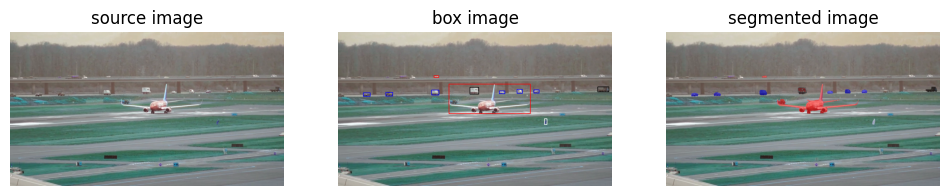


0: 384x640 1 person, 6 cars, 2 airplanes, 2 trucks, 35.5ms
Speed: 0.6ms preprocess, 35.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 517.2892,  241.8548,  900.6602,  381.9694],
        [ 118.3355,  284.0443,  149.6242,  301.1038],
        [ 616.5234,  258.2710,  658.2996,  291.3643],
        [ 914.8792,  269.8239,  940.2029,  286.0917],
        [ 224.4798,  284.0723,  254.4866,  299.2791],
        [ 963.9496,  407.7267,  977.4481,  433.7179],
        [ 438.6933,  272.1313,  470.7772,  295.0869],
        [ 438.5713,  272.1734,  470.9037,  295.1629],
        [ 836.4257,  268.8395,  860.9950,  287.4748],
        [1212.5129,  256.6004, 1264.9419,  280.8394],
        [ 836.9373,  268.7221,  860.8655,  287.5998],
        [ 753.1509,  274.9114,  779.3533,  288.7723],
        [ 448.8315,  204.8826,  470.2288,  212.1864]], device='cuda:0')


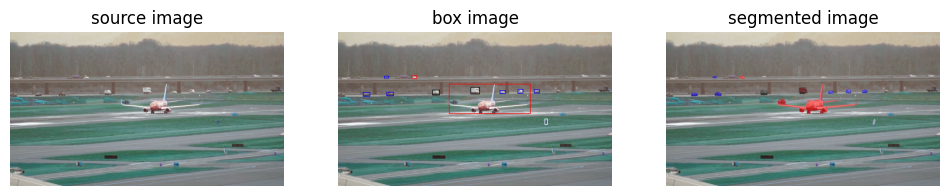


0: 384x640 6 cars, 3 airplanes, 3 trucks, 31.6ms
Speed: 0.6ms preprocess, 31.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[518.3722, 242.3160, 900.1974, 381.8683],
        [620.4025, 257.9752, 660.8817, 291.1214],
        [117.8372, 284.0566, 148.8822, 300.7526],
        [228.0808, 282.9266, 257.8850, 298.4327],
        [916.0882, 269.0815, 941.7322, 285.6996],
        [965.4825, 408.3568, 978.2474, 433.8615],
        [442.3570, 272.3253, 474.7137, 294.2455],
        [343.6135, 203.2959, 366.8787, 217.9015],
        [839.9979, 268.8773, 864.2487, 286.8910],
        [756.3434, 274.8979, 782.0165, 288.7830],
        [216.6398, 207.1541, 238.2011, 215.8557]], device='cuda:0')


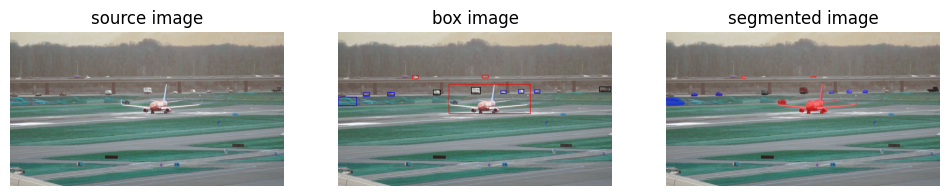


0: 384x640 5 cars, 2 airplanes, 2 trucks, 63.4ms
Speed: 0.6ms preprocess, 63.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1835e+02, 2.4270e+02, 9.0126e+02, 3.8273e+02],
        [6.2421e+02, 2.5867e+02, 6.6528e+02, 2.9120e+02],
        [1.1767e+02, 2.8467e+02, 1.4795e+02, 3.0168e+02],
        [2.3177e+02, 2.8376e+02, 2.6192e+02, 2.9941e+02],
        [4.4619e+02, 2.7247e+02, 4.7817e+02, 2.9474e+02],
        [9.1857e+02, 2.7060e+02, 9.4330e+02, 2.8581e+02],
        [8.4383e+02, 2.6877e+02, 8.6794e+02, 2.8774e+02],
        [7.6083e+02, 2.7541e+02, 7.8567e+02, 2.8886e+02],
        [6.7426e+02, 2.0164e+02, 7.0267e+02, 2.1343e+02],
        [6.6162e-02, 3.0315e+02, 8.9839e+01, 3.4429e+02],
        [3.4748e+02, 2.0193e+02, 3.7419e+02, 2.1882e+02],
        [1.2197e+03, 2.5599e+02, 1.2748e+03, 2.8113e+02]], device='cuda:0')


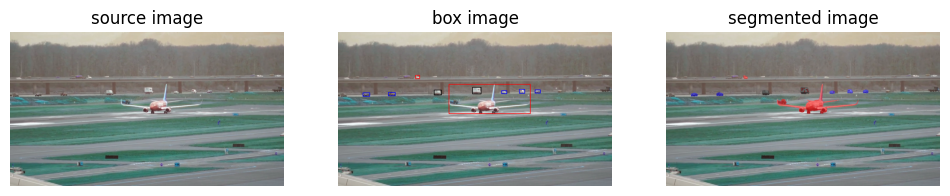


0: 384x640 1 person, 5 cars, 2 airplanes, 3 trucks, 34.9ms
Speed: 0.6ms preprocess, 34.9ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[517.1029, 242.0074, 901.0082, 382.4297],
        [627.7864, 257.6176, 669.6283, 291.0748],
        [117.4899, 284.6796, 148.1487, 301.1189],
        [236.2580, 283.6200, 266.2298, 298.3108],
        [920.1969, 269.9091, 945.2626, 285.4247],
        [764.7439, 274.6076, 789.0095, 288.2526],
        [450.1821, 271.9601, 482.6939, 294.6266],
        [848.0352, 269.0153, 872.2393, 287.4810],
        [362.8514, 202.6191, 381.1013, 218.0431]], device='cuda:0')


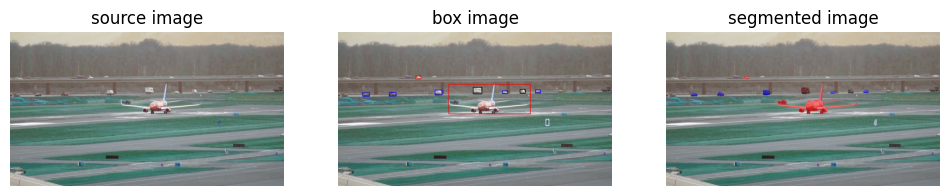


0: 384x640 1 person, 4 cars, 2 airplanes, 3 trucks, 31.0ms
Speed: 0.5ms preprocess, 31.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[516.8140, 241.9853, 901.3464, 382.9269],
        [631.8689, 258.1078, 674.0236, 290.9459],
        [116.2085, 284.8112, 147.2765, 302.2668],
        [240.5721, 283.4526, 271.0739, 299.0619],
        [921.9920, 270.6074, 946.8483, 286.1948],
        [767.0444, 275.2363, 792.4917, 288.5799],
        [851.0116, 269.2110, 875.1290, 287.4866],
        [971.1840, 406.1791, 985.1418, 433.9252],
        [453.9937, 272.2144, 486.1992, 295.1078],
        [454.2360, 272.4129, 485.8896, 295.3566],
        [363.4419, 202.0547, 387.3312, 218.8264]], device='cuda:0')


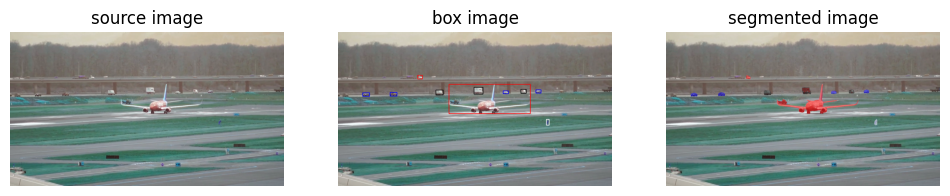


0: 384x640 1 person, 6 cars, 2 airplanes, 3 trucks, 30.2ms
Speed: 0.9ms preprocess, 30.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[517.2711, 242.2414, 901.2745, 382.9532],
        [636.4359, 258.2623, 677.2510, 292.1175],
        [116.1151, 284.4888, 147.3106, 302.2644],
        [458.1707, 272.2489, 490.2612, 294.7132],
        [923.7468, 270.1254, 949.5927, 285.9622],
        [243.8508, 282.9995, 276.0219, 299.2508],
        [769.8391, 275.7239, 796.5703, 288.3546],
        [973.4062, 408.1595, 986.7964, 434.0014],
        [854.8674, 269.0598, 879.3523, 287.2638],
        [372.9518, 202.3111, 394.7194, 218.5913]], device='cuda:0')


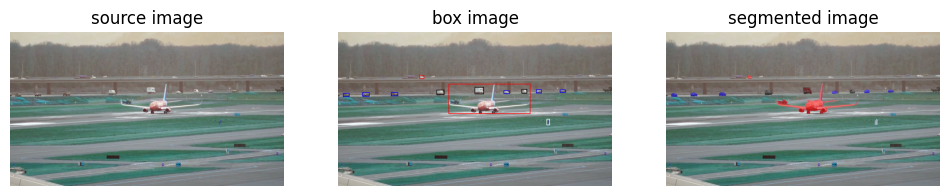


0: 384x640 1 person, 8 cars, 2 airplanes, 3 trucks, 29.6ms
Speed: 0.6ms preprocess, 29.6ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 517.1040,  241.8162,  900.3337,  382.6633],
        [ 638.9661,  257.7526,  680.8384,  291.3061],
        [ 115.3746,  284.3347,  146.1124,  301.0947],
        [ 248.6906,  282.6561,  278.8155,  298.3533],
        [ 925.5384,  268.7569,  951.6559,  285.4685],
        [ 775.8805,  275.1742,  800.1552,  288.2097],
        [ 461.6951,  271.4485,  494.7503,  294.0504],
        [ 975.5717,  407.5452,  988.2181,  433.2424],
        [ 857.7894,  268.5531,  882.3549,  287.1562],
        [ 380.0629,  202.6274,  400.4722,  218.0728],
        [  23.9309,  285.6686,   53.8322,  303.1317],
        [1036.8473,  270.3526, 1060.6320,  283.1545]], device='cuda:0')


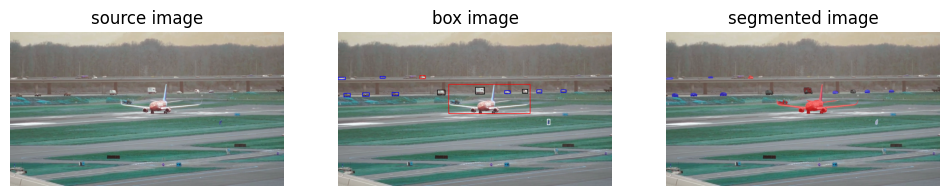


0: 384x640 1 person, 6 cars, 1 airplane, 3 trucks, 28.9ms
Speed: 0.7ms preprocess, 28.9ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 517.0128,  242.1186,  900.3051,  382.9101],
        [ 643.2776,  258.0679,  684.0310,  291.2109],
        [ 114.6385,  284.6049,  145.7511,  301.4528],
        [ 927.6389,  269.2103,  953.2839,  285.2411],
        [ 252.2807,  283.0775,  282.8126,  298.6175],
        [ 466.0194,  271.3494,  499.5994,  294.7181],
        [ 779.3446,  275.2665,  803.4454,  288.4446],
        [ 861.9193,  269.1922,  886.2224,  286.7995],
        [ 977.2076,  408.3296,  990.8419,  433.3574],
        [   1.8379,  211.5448,   34.1426,  223.7647],
        [ 380.1371,  201.8733,  407.8778,  218.8830],
        [ 197.6871,  207.6302,  221.0853,  217.3935],
        [  28.4030,  286.0233,   57.7956,  303.3370],
        [1041.0868,  270.5142, 1064.2382,  283.3655]], device='cuda:0')


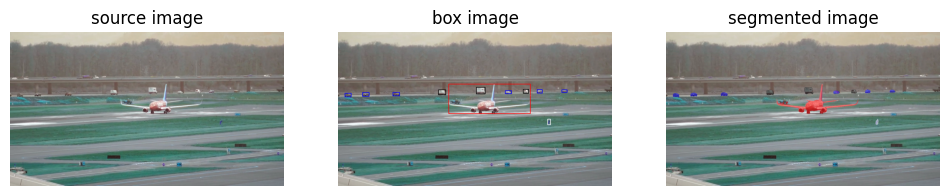


0: 384x640 1 person, 6 cars, 2 airplanes, 3 trucks, 31.0ms
Speed: 0.6ms preprocess, 31.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 515.9499,  242.1616,  900.1942,  382.6494],
        [ 646.9474,  257.6825,  688.0419,  290.6776],
        [ 114.2983,  284.3044,  145.3653,  300.6508],
        [ 257.1921,  282.6041,  287.1994,  297.9888],
        [ 929.6179,  269.5021,  954.9341,  285.2730],
        [ 782.5195,  274.0976,  807.1150,  288.0189],
        [ 979.1948,  405.9319,  992.9167,  433.6710],
        [ 469.9861,  270.9003,  503.6564,  294.8230],
        [ 866.5743,  269.4098,  889.9464,  286.8137],
        [1044.9099,  270.8179, 1068.4041,  282.8147],
        [  33.0029,  286.0952,   62.3802,  303.4351]], device='cuda:0')


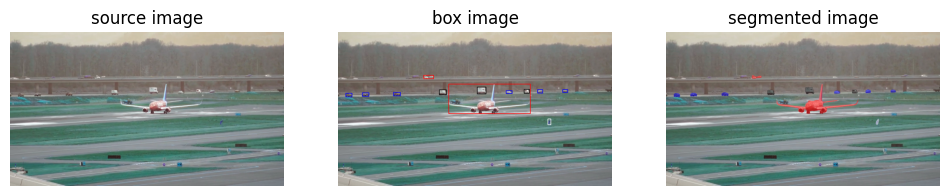


0: 384x640 1 person, 7 cars, 2 airplanes, 3 trucks, 30.2ms
Speed: 0.6ms preprocess, 30.2ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 516.2929,  241.9954,  900.7007,  382.5032],
        [ 650.5173,  257.6016,  691.8980,  290.0360],
        [ 113.4679,  284.3994,  144.1390,  300.8712],
        [ 260.8871,  283.0507,  291.0484,  298.3088],
        [ 932.2568,  269.0198,  957.1639,  284.9310],
        [ 474.0968,  271.8223,  506.6044,  294.5989],
        [ 399.0781,  202.4032,  445.7039,  217.9679],
        [ 869.9119,  269.0098,  892.2005,  287.2484],
        [ 980.5793,  406.0709,  994.2217,  434.0058],
        [ 784.6308,  274.2142,  811.5831,  289.0557],
        [1050.0538,  270.5702, 1072.7159,  282.5891],
        [  35.9185,  285.7462,   66.3169,  302.7780]], device='cuda:0')


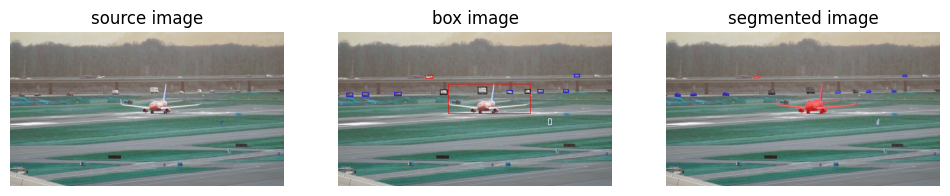


0: 384x640 6 cars, 2 airplanes, 3 trucks, 58.1ms
Speed: 0.6ms preprocess, 58.1ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 515.5693,  242.0935,  900.1240,  382.5145],
        [ 654.4302,  257.6243,  695.5916,  290.6001],
        [ 265.1570,  283.1360,  294.9698,  298.3454],
        [ 113.4873,  285.1223,  143.6407,  300.3462],
        [ 933.4355,  268.6843,  959.2544,  285.2409],
        [ 477.9082,  271.3819,  510.2692,  294.6813],
        [ 408.3575,  202.7674,  443.1107,  218.2751],
        [ 873.9889,  269.5524,  896.4012,  287.0385],
        [ 982.7660,  406.4200,  996.1847,  433.9585],
        [  40.0363,  285.2635,   69.9444,  302.1639],
        [1054.0812,  270.8772, 1077.5441,  282.5162],
        [ 788.6118,  274.4669,  815.2866,  288.9333],
        [1102.7715,  197.6894, 1128.7207,  209.7246]], device='cuda:0')


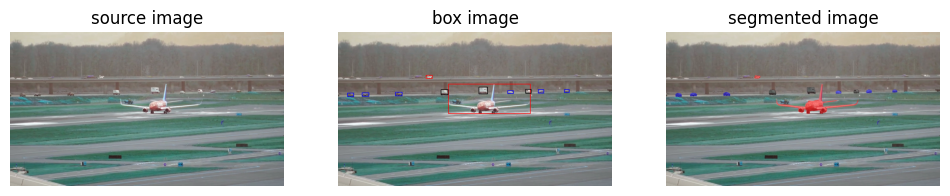


0: 384x640 1 person, 7 cars, 1 airplane, 4 trucks, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 5.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 514.9438,  241.7396,  900.3271,  382.5655],
        [ 657.9259,  257.4817,  699.5065,  290.5021],
        [ 792.4873,  274.8972,  819.3228,  288.4909],
        [ 268.6485,  282.8684,  298.8123,  298.1242],
        [ 935.5087,  268.9514,  961.3036,  284.8966],
        [ 113.0974,  285.1974,  143.6406,  300.4487],
        [ 482.1982,  270.9416,  514.3893,  294.8574],
        [ 410.6900,  202.3764,  439.2331,  217.4252],
        [ 876.7556,  268.1498,  901.5830,  287.0888],
        [1058.4150,  270.5634, 1079.9785,  282.3824],
        [  44.7410,  285.0182,   74.0436,  302.0082]], device='cuda:0')


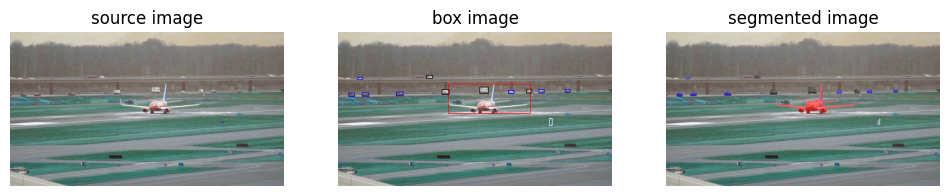


0: 384x640 1 person, 5 cars, 1 airplane, 4 trucks, 29.6ms
Speed: 0.6ms preprocess, 29.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 513.7635,  241.0497,  900.4608,  382.8368],
        [ 662.1645,  257.4501,  703.5685,  290.3561],
        [ 937.5236,  268.7602,  963.8047,  284.9234],
        [ 113.3104,  285.0482,  143.9144,  299.9894],
        [ 272.8547,  281.4322,  303.5997,  298.0225],
        [ 486.0904,  270.5020,  518.9030,  294.6543],
        [ 880.9991,  267.8250,  903.9591,  287.4304],
        [ 796.3283,  273.9354,  822.9477,  288.0307],
        [1062.1239,  270.6310, 1084.1954,  282.1738],
        [  49.3069,  284.7124,   78.0678,  301.4347],
        [ 987.3461,  405.8038, 1001.5533,  433.2344],
        [ 412.5368,  201.9991,  441.4927,  218.1584],
        [  91.3657,  212.1561,  116.3951,  221.6735]], device='cuda:0')


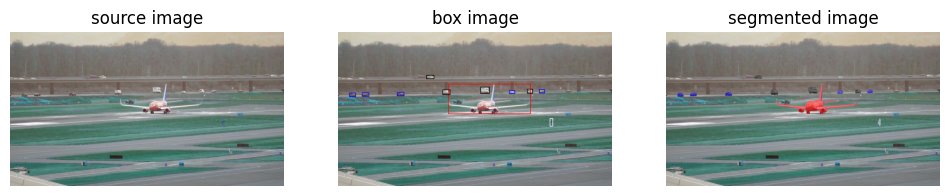


0: 384x640 1 person, 8 cars, 1 airplane, 2 trucks, 34.3ms
Speed: 0.6ms preprocess, 34.3ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 513.7057,  240.8314,  899.8735,  383.2484],
        [ 666.3966,  257.6300,  707.4896,  289.9555],
        [ 277.7796,  282.7597,  307.1911,  297.9977],
        [ 112.3703,  284.9654,  143.5215,  300.6632],
        [ 801.0201,  274.9157,  826.8326,  288.6302],
        [ 940.3813,  268.7059,  965.9951,  285.1448],
        [ 490.3550,  271.4182,  522.5221,  294.8206],
        [  54.3226,  285.6971,   82.5396,  302.1184],
        [ 883.7917,  267.6271,  908.7583,  287.6944],
        [ 989.6630,  406.0881, 1003.7838,  434.2171],
        [ 413.0046,  202.4776,  447.1987,  217.6905]], device='cuda:0')


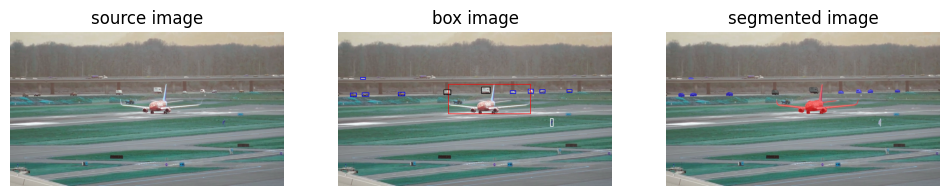


0: 384x640 1 person, 7 cars, 2 airplanes, 4 trucks, 1 boat, 31.3ms
Speed: 0.7ms preprocess, 31.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 514.2411,  242.6576,  900.4661,  382.9323],
        [ 670.8763,  257.6016,  711.3749,  289.8334],
        [ 112.4061,  284.6866,  143.4284,  300.7783],
        [ 282.3011,  282.6549,  311.3875,  297.9271],
        [ 805.5806,  275.0668,  830.4308,  288.7468],
        [  57.8977,  285.1550,   86.4511,  301.9506],
        [ 942.6207,  269.1467,  968.0953,  285.1451],
        [ 495.0999,  271.1576,  527.0712,  294.8469],
        [ 888.7111,  267.9725,  912.6151,  287.0251],
        [ 991.8513,  405.8976, 1005.8448,  433.7059],
        [ 105.7133,  211.9352,  128.9597,  221.4099],
        [1070.6587,  270.5669, 1093.9263,  282.5400]], device='cuda:0')


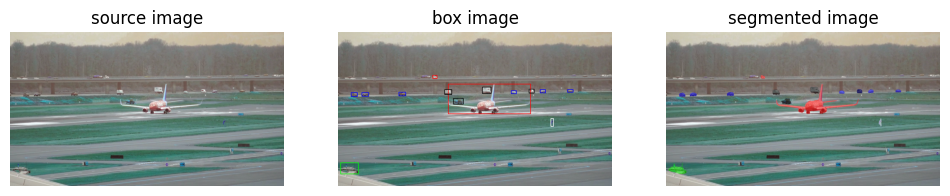


0: 384x640 1 person, 6 cars, 1 airplane, 4 trucks, 29.6ms
Speed: 2.7ms preprocess, 29.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 513.3965,  241.8668,  900.2046,  382.7181],
        [ 111.6543,  283.7149,  143.4333,  300.4405],
        [ 944.1715,  269.1577,  969.9922,  284.6870],
        [ 285.6985,  282.7522,  315.3545,  297.3125],
        [ 674.2456,  256.6837,  714.5703,  289.9847],
        [ 809.2710,  274.8922,  833.3408,  288.3783],
        [ 498.9561,  270.5400,  531.3518,  294.6274],
        [1074.0621,  270.3073, 1097.6305,  281.5017],
        [ 444.0995,  202.0477,  462.0037,  217.1270],
        [ 538.6901,  310.2569,  582.4769,  337.4335],
        [ 891.8115,  267.3174,  916.1624,  287.0326],
        [ 891.6617,  267.4265,  916.1044,  287.0724],
        [  61.9290,  284.2108,   90.9084,  301.7783],
        [ 993.8490,  405.4595, 1007.3706,  434.6501],
        [  10.3215,  613.1479,   96.1253,  665.5928]], device='cuda:0')


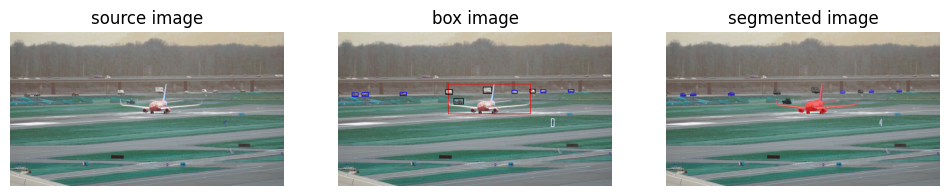


0: 384x640 1 person, 7 cars, 2 airplanes, 3 trucks, 29.1ms
Speed: 0.6ms preprocess, 29.1ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 513.2450,  242.0417,  900.3969,  383.0078],
        [ 112.0605,  284.6533,  142.8565,  300.2628],
        [ 678.3470,  257.0023,  718.8756,  289.2148],
        [ 946.9465,  268.9550,  972.3718,  284.7135],
        [ 813.1503,  274.2505,  837.8993,  288.4101],
        [ 503.2028,  270.7358,  536.0432,  294.7609],
        [ 290.8081,  282.5494,  320.5651,  297.3253],
        [  66.0583,  285.4986,   95.2870,  301.4279],
        [ 995.8431,  406.0727, 1009.8942,  433.7420],
        [1078.4128,  270.5322, 1102.7756,  281.5694],
        [ 896.5576,  267.2121,  920.4869,  287.2110],
        [ 541.1264,  310.4535,  585.6288,  338.0569]], device='cuda:0')


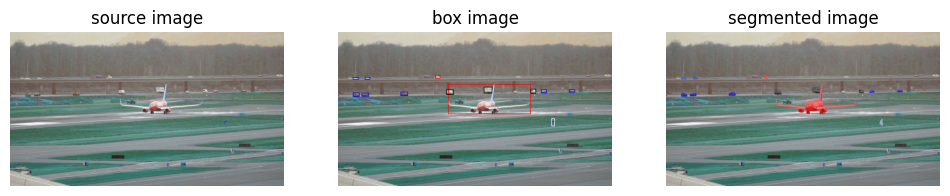


0: 384x640 1 person, 5 cars, 2 airplanes, 3 trucks, 30.0ms
Speed: 0.6ms preprocess, 30.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 513.2115,  242.6671,  900.7700,  383.1105],
        [ 948.7919,  268.4549,  974.7301,  284.6265],
        [ 293.7620,  281.5687,  324.6653,  297.7490],
        [ 112.4546,  286.1909,  142.3713,  300.1165],
        [ 507.0514,  271.1108,  539.6711,  294.0955],
        [ 681.8961,  256.7563,  719.8573,  284.5087],
        [1083.2844,  270.6583, 1106.0388,  281.8400],
        [ 900.3623,  267.3454,  924.3801,  287.0909],
        [ 998.1649,  406.8838, 1011.7864,  434.3103],
        [ 126.1053,  211.0814,  150.3116,  220.6026],
        [  71.3262,  285.8275,   98.7932,  301.4485],
        [  70.5788,  213.2786,   96.8679,  222.2542],
        [ 458.3784,  202.2100,  476.4381,  217.1795]], device='cuda:0')


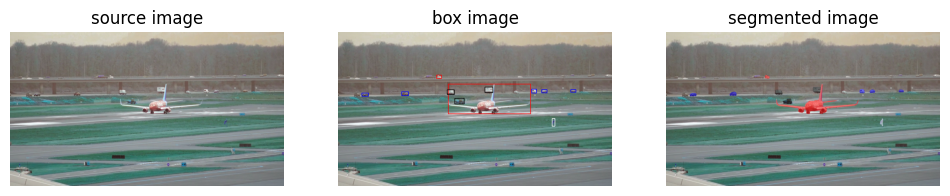


0: 384x640 1 person, 5 cars, 2 airplanes, 3 trucks, 32.6ms
Speed: 0.6ms preprocess, 32.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 513.0248,  242.4206,  900.7631,  382.8445],
        [ 951.0239,  268.9958,  976.1868,  284.3049],
        [ 510.1079,  270.8542,  543.3167,  294.0994],
        [ 111.7368,  285.2475,  142.0178,  299.9124],
        [ 297.8553,  280.6965,  328.0937,  297.4113],
        [ 904.4027,  267.2259,  927.5023,  286.5969],
        [ 686.5411,  257.3885,  724.0040,  282.2082],
        [ 461.7209,  201.4059,  482.9649,  216.9439],
        [ 999.9827,  404.2039, 1015.2275,  435.4608],
        [1087.7188,  269.6388, 1111.6484,  282.1707],
        [ 545.3729,  310.8413,  588.9647,  337.2756]], device='cuda:0')


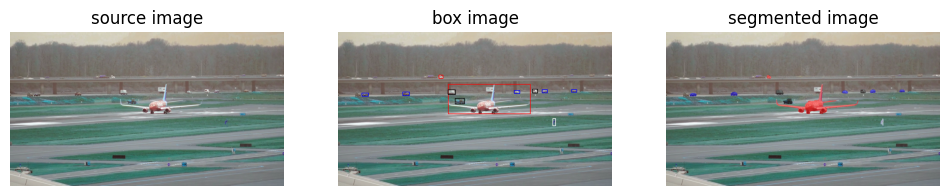


0: 384x640 1 person, 6 cars, 2 airplanes, 2 trucks, 34.2ms
Speed: 0.6ms preprocess, 34.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 512.4803,  241.7372,  900.2892,  383.2336],
        [ 953.3852,  269.1681,  978.9630,  284.9369],
        [ 301.9601,  281.0566,  332.9850,  297.2428],
        [ 515.9941,  270.8143,  547.4413,  293.0338],
        [ 824.3027,  274.1992,  850.0211,  288.1220],
        [ 109.9786,  285.8236,  141.4625,  300.3193],
        [1092.0256,  269.7116, 1115.3943,  281.6833],
        [ 908.0409,  267.1746,  931.9512,  286.7676],
        [1002.1371,  404.5379, 1017.5963,  433.2004],
        [ 546.6105,  310.8445,  591.5367,  336.8983],
        [ 471.4596,  201.0015,  490.5365,  217.4193]], device='cuda:0')


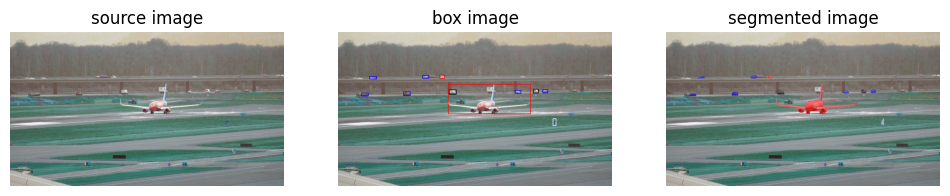


0: 384x640 1 person, 4 cars, 2 airplanes, 3 trucks, 33.5ms
Speed: 0.6ms preprocess, 33.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.8120,  241.5372,  900.1669,  383.1853],
        [ 520.7106,  270.4689,  552.1552,  292.9295],
        [ 828.4077,  274.3146,  854.4592,  287.5356],
        [ 955.4969,  268.6849,  981.5184,  284.7343],
        [ 306.0940,  280.9390,  337.2860,  297.2070],
        [ 911.9236,  266.7148,  935.7636,  285.7888],
        [1005.0757,  405.5647, 1019.0195,  432.4992],
        [ 148.0406,  207.3952,  180.5881,  218.4549],
        [ 477.8054,  201.7807,  495.5572,  216.3618],
        [ 396.7450,  202.2739,  422.9254,  216.2801],
        [ 110.3164,  286.2866,  141.1393,  299.9508]], device='cuda:0')


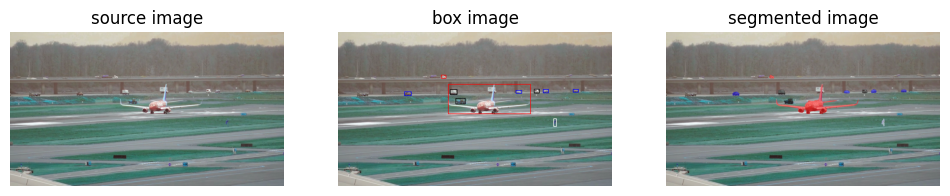


0: 384x640 1 person, 4 cars, 3 airplanes, 3 trucks, 30.0ms
Speed: 0.6ms preprocess, 30.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.6902,  240.5952,  900.4695,  383.1954],
        [ 310.4859,  280.2215,  341.9894,  297.0995],
        [ 831.6664,  273.8867,  858.7103,  287.6940],
        [ 957.8314,  268.6400,  983.5800,  284.4885],
        [ 525.0492,  270.6992,  555.7802,  293.0038],
        [ 483.4752,  201.7495,  503.2103,  216.2809],
        [1007.1764,  407.0364, 1021.3422,  432.0630],
        [ 915.9572,  266.5598,  939.9299,  286.0112],
        [ 550.6041,  310.4598,  595.9545,  337.1479],
        [1099.1055,  269.1342, 1124.7532,  281.7765]], device='cuda:0')


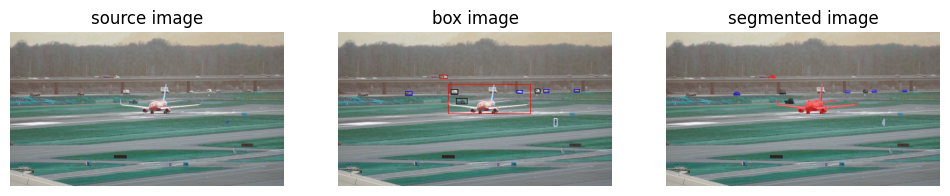


0: 384x640 1 person, 5 cars, 3 airplanes, 4 trucks, 65.1ms
Speed: 0.6ms preprocess, 65.1ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 510.9792,  245.6193,  900.4067,  383.2067],
        [ 959.9418,  268.9296,  985.8198,  284.2032],
        [ 835.5318,  273.4958,  862.9059,  287.4054],
        [ 315.9487,  280.4206,  345.9210,  296.7258],
        [ 492.5424,  201.5426,  510.1058,  216.3260],
        [ 529.1995,  270.7022,  559.1610,  293.1013],
        [ 920.1672,  266.3826,  943.6223,  285.8824],
        [1009.4038,  406.9062, 1023.8032,  432.6898],
        [ 473.7312,  201.3546,  509.9396,  216.8046],
        [1104.1069,  268.6757, 1128.8418,  281.5974],
        [ 552.9401,  310.5654,  598.5817,  336.3754]], device='cuda:0')


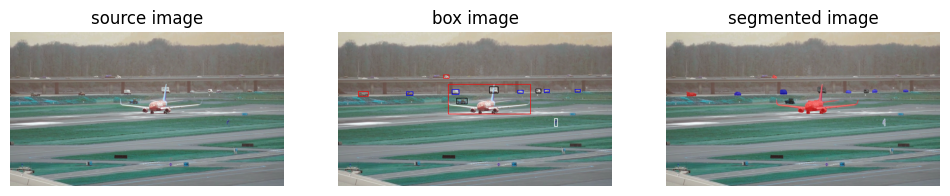


0: 384x640 1 person, 6 cars, 2 airplanes, 4 trucks, 40.9ms
Speed: 0.6ms preprocess, 40.9ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.4754,  245.3970,  900.8635,  383.1616],
        [ 962.3965,  268.8965,  987.8838,  283.8058],
        [ 840.0925,  273.1443,  865.2517,  286.9370],
        [ 320.2725,  280.2388,  350.4407,  296.2549],
        [ 533.5703,  270.0414,  565.0808,  292.0417],
        [  94.6769,  275.1224,  141.2066,  300.2560],
        [1011.2291,  405.6762, 1026.0948,  433.1571],
        [ 533.4271,  270.1834,  564.8101,  292.4012],
        [1107.7598,  268.9045, 1133.6550,  281.0876],
        [ 497.1384,  200.9788,  517.5278,  216.0763],
        [ 923.7579,  266.3377,  947.7896,  285.8814],
        [ 706.9357,  256.1206,  749.6075,  286.8227],
        [ 554.3536,  310.4217,  600.0063,  336.1163]], device='cuda:0')


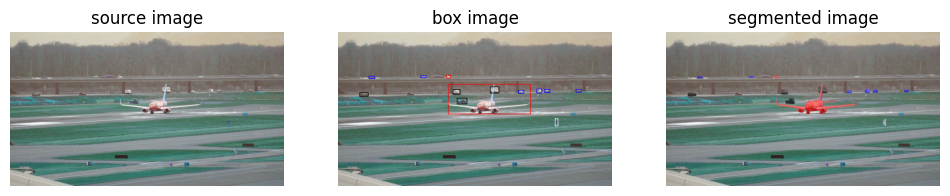


0: 384x640 5 cars, 2 airplanes, 3 trucks, 29.5ms
Speed: 0.6ms preprocess, 29.5ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.8004,  245.8248,  900.3553,  383.1227],
        [ 965.2496,  268.5882,  990.5912,  283.7466],
        [ 844.3013,  273.0116,  869.2542,  286.7866],
        [ 538.4435,  270.3467,  569.8539,  292.2297],
        [1013.9694,  406.2608, 1027.7025,  432.9649],
        [ 928.7398,  266.7076,  952.1642,  285.7475],
        [ 711.9456,  256.5772,  753.4207,  287.5967],
        [ 387.3665,  204.7866,  410.2579,  212.9763],
        [ 555.9015,  309.2333,  603.1713,  336.4446],
        [ 508.1955,  201.7526,  524.0865,  216.5258],
        [1111.8075,  269.0168, 1138.6945,  281.3222],
        [ 143.3916,  206.5734,  170.5399,  216.6551],
        [ 100.7514,  283.9151,  140.4730,  300.4470]], device='cuda:0')


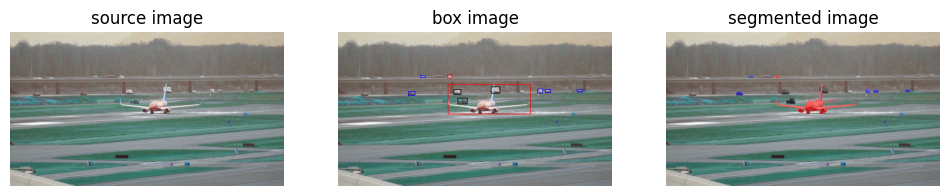


0: 384x640 1 person, 6 cars, 1 airplane, 3 trucks, 63.2ms
Speed: 0.7ms preprocess, 63.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.4894,  242.3754,  900.3597,  383.0276],
        [ 967.9691,  268.3717,  992.4552,  283.0017],
        [ 542.1535,  269.6343,  574.1072,  291.8316],
        [ 932.4061,  266.0002,  956.3990,  285.1365],
        [ 386.4695,  204.3585,  408.2847,  211.5079],
        [ 558.1364,  308.7114,  603.6969,  336.3359],
        [ 722.2764,  257.7932,  757.2642,  287.3018],
        [ 327.9683,  279.2448,  359.8583,  296.4808],
        [1116.4199,  267.6594, 1141.9390,  280.1693],
        [ 511.8405,  201.0496,  532.4282,  216.0287]], device='cuda:0')


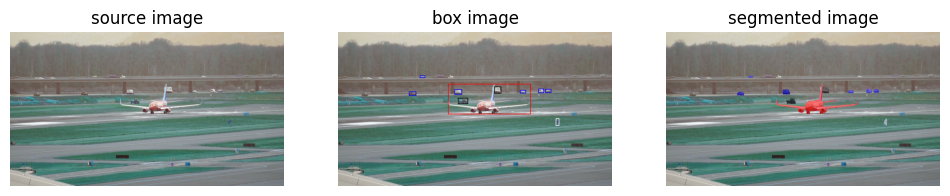


0: 384x640 1 person, 7 cars, 1 airplane, 3 trucks, 36.6ms
Speed: 0.6ms preprocess, 36.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.6919,  242.4701,  900.8093,  383.1931],
        [ 969.9612,  268.3125,  995.3901,  283.1987],
        [ 727.3475,  256.2549,  762.0612,  288.2845],
        [ 332.9954,  279.5319,  363.7562,  296.1064],
        [ 936.3368,  266.1222,  960.4576,  285.3851],
        [ 545.7132,  269.6733,  577.9531,  291.9180],
        [ 384.7214,  204.2634,  406.1531,  211.7482],
        [ 546.1592,  269.7978,  578.1168,  292.1920],
        [1018.5942,  404.0459, 1033.5054,  432.1675],
        [ 851.4734,  271.4365,  877.5586,  285.9359],
        [ 560.4315,  308.9227,  605.8743,  336.2370]], device='cuda:0')


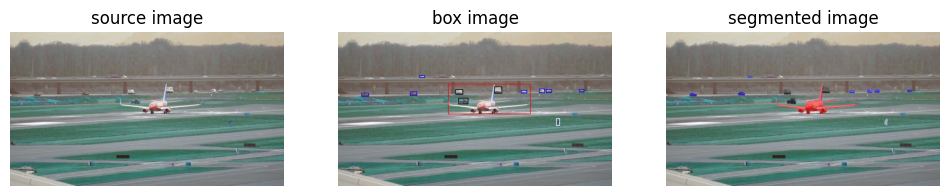


0: 384x640 1 person, 7 cars, 2 airplanes, 3 trucks, 35.9ms
Speed: 1.2ms preprocess, 35.9ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 512.6606,  242.7893,  901.3044,  382.9728],
        [ 973.1778,  268.9848,  997.9925,  282.9032],
        [ 729.8607,  256.1589,  765.7682,  288.8412],
        [ 940.2871,  266.4838,  963.7322,  285.3746],
        [ 338.0559,  280.2264,  367.5409,  295.9642],
        [ 549.5933,  269.3516,  582.9700,  292.4474],
        [ 854.8932,  271.8097,  882.8644,  287.1154],
        [ 110.6264,  286.7466,  143.0780,  299.7570],
        [1127.2910,  269.0426, 1149.1694,  279.8756],
        [ 382.4352,  203.8241,  404.4531,  211.8568],
        [1020.5648,  405.2922, 1036.0651,  431.7261],
        [ 562.1861,  308.8868,  608.8214,  336.1672]], device='cuda:0')


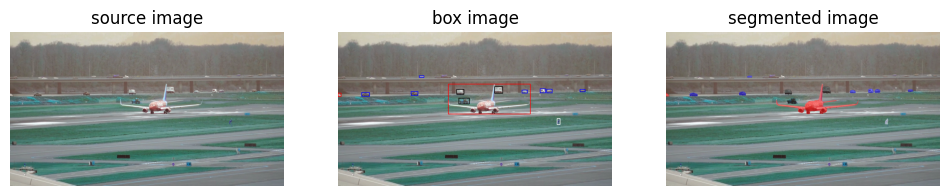


0: 384x640 1 person, 6 cars, 1 airplane, 3 trucks, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1335e+02, 2.4310e+02, 9.0061e+02, 3.8310e+02],
        [9.7478e+02, 2.6797e+02, 1.0003e+03, 2.8336e+02],
        [7.3066e+02, 2.5535e+02, 7.6995e+02, 2.8840e+02],
        [5.5619e+02, 2.6864e+02, 5.8741e+02, 2.9225e+02],
        [8.5914e+02, 2.7179e+02, 8.8545e+02, 2.8669e+02],
        [3.4286e+02, 2.7873e+02, 3.7218e+02, 2.9607e+02],
        [3.8029e+02, 2.0468e+02, 4.0088e+02, 2.1121e+02],
        [1.0959e+02, 2.8485e+02, 1.4776e+02, 2.9983e+02],
        [5.6341e+02, 3.0796e+02, 6.1340e+02, 3.3613e+02],
        [1.0234e+03, 4.0675e+02, 1.0370e+03, 4.3138e+02],
        [9.4375e+02, 2.6548e+02, 9.6881e+02, 2.8527e+02],
        [1.1312e+03, 2.6856e+02, 1.1534e+03, 2.7970e+02],
        [4.7193e-02, 2.8500e+02, 1.3610e+01, 3.0053e+02]], device='cuda:0')


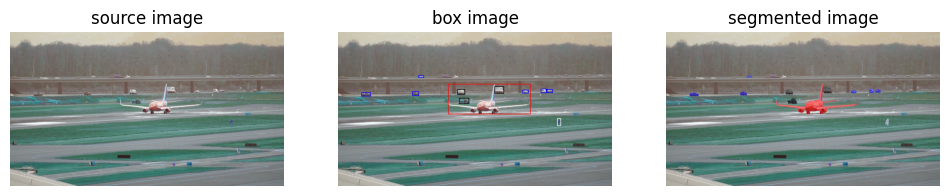


0: 384x640 1 person, 7 cars, 2 airplanes, 4 trucks, 31.7ms
Speed: 0.6ms preprocess, 31.7ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 512.6086,  242.9954,  901.7334,  383.2285],
        [ 732.7971,  255.8746,  773.9058,  289.5224],
        [ 977.7421,  268.3127, 1002.4929,  283.1931],
        [ 347.1664,  279.6115,  377.4317,  296.1251],
        [ 863.9760,  271.7887,  890.0064,  287.1218],
        [ 560.2725,  268.7416,  591.5568,  292.7340],
        [ 376.9166,  204.3931,  398.9673,  211.8135],
        [ 947.7727,  265.2465,  974.5797,  284.8640],
        [ 109.9779,  284.2073,  152.5175,  299.8398],
        [ 565.7660,  308.7950,  611.0433,  336.0960],
        [1025.1802,  403.9209, 1039.8525,  432.7550]], device='cuda:0')


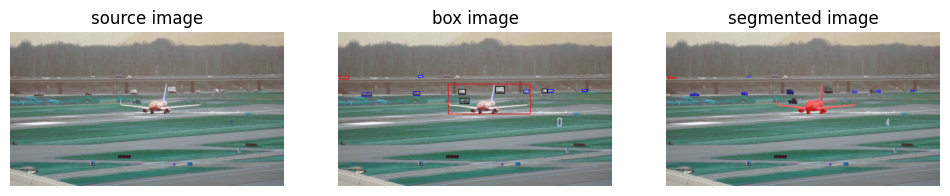


0: 384x640 1 person, 7 cars, 1 airplane, 4 trucks, 29.1ms
Speed: 0.6ms preprocess, 29.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.9998,  242.4689,  900.1212,  383.2077],
        [ 736.9266,  255.3576,  778.7225,  289.2153],
        [ 352.8425,  279.4677,  381.7128,  295.8644],
        [ 867.4121,  271.6257,  893.1541,  286.6141],
        [ 978.9266,  268.1333, 1004.8585,  283.1205],
        [ 111.0617,  284.8207,  156.8940,  299.5397],
        [ 564.4985,  268.6780,  596.3024,  292.2753],
        [ 564.4125,  268.5435,  596.7859,  292.0886],
        [ 375.9584,  204.4301,  396.2621,  211.2159],
        [ 952.4327,  265.6444,  977.0880,  284.7256],
        [ 569.2792,  309.3184,  612.9052,  335.9012],
        [   2.9787,  206.6585,   52.7028,  219.9043],
        [1027.0632,  403.6965, 1041.9304,  432.5536],
        [1139.4618,  268.5481, 1162.8124,  279.8567]], device='cuda:0')


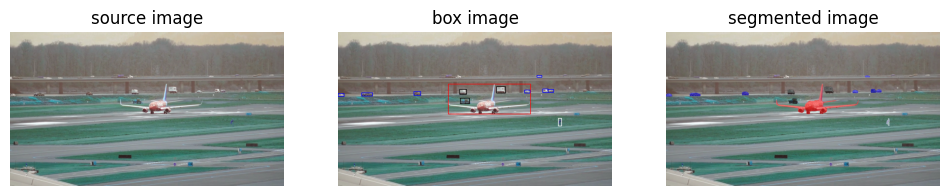


0: 384x640 7 cars, 1 airplane, 3 trucks, 38.5ms
Speed: 0.6ms preprocess, 38.5ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


tensor([[5.1175e+02, 2.4263e+02, 9.0000e+02, 3.8329e+02],
        [7.4016e+02, 2.5514e+02, 7.8261e+02, 2.8843e+02],
        [3.5618e+02, 2.7971e+02, 3.8594e+02, 2.9589e+02],
        [8.7114e+02, 2.7169e+02, 8.9664e+02, 2.8667e+02],
        [9.8181e+02, 2.6802e+02, 1.0072e+03, 2.8282e+02],
        [1.1131e+02, 2.8409e+02, 1.6085e+02, 2.9952e+02],
        [5.6861e+02, 2.6836e+02, 6.0052e+02, 2.9185e+02],
        [5.7110e+02, 3.0941e+02, 6.1469e+02, 3.3546e+02],
        [1.0292e+03, 4.0534e+02, 1.0449e+03, 4.3202e+02],
        [9.3042e+02, 2.0387e+02, 9.5209e+02, 2.1153e+02],
        [9.5628e+02, 2.6644e+02, 9.8110e+02, 2.8437e+02],
        [9.5638e+02, 2.6601e+02, 9.8100e+02, 2.8456e+02],
        [8.1764e-02, 2.8723e+02, 2.6558e+01, 3.0085e+02]], device='cuda:0')


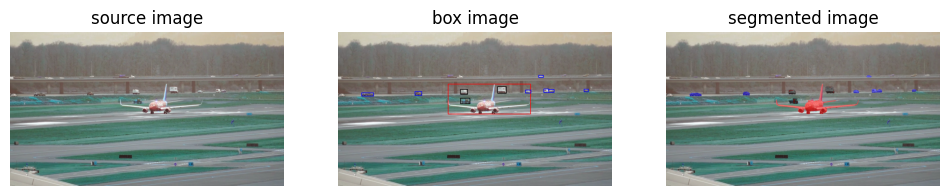


0: 384x640 4 cars, 1 airplane, 4 trucks, 29.9ms
Speed: 0.6ms preprocess, 29.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.3438,  243.0541,  900.7526,  383.2628],
        [ 745.4596,  255.0206,  787.5348,  288.5283],
        [ 360.6158,  279.1472,  390.3024,  295.9380],
        [ 876.3226,  271.8026,  901.0052,  286.2349],
        [ 984.4960,  268.3850, 1009.3879,  282.9891],
        [ 111.6440,  283.8148,  165.7474,  299.5231],
        [ 572.9427,  268.4949,  605.5687,  292.5207],
        [ 573.1139,  308.9937,  617.6945,  335.6560],
        [ 960.7736,  266.1918,  984.9127,  285.0626],
        [ 937.6669,  203.2797,  959.5973,  212.0983],
        [1149.1171,  267.8608, 1169.1696,  279.7569]], device='cuda:0')


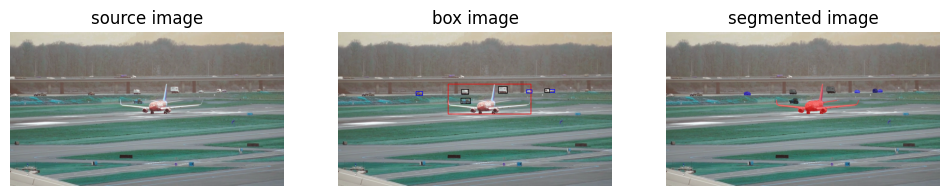


0: 384x640 4 cars, 1 airplane, 3 trucks, 30.5ms
Speed: 0.6ms preprocess, 30.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.4823,  242.9708,  902.0455,  383.2162],
        [ 749.8179,  255.0630,  791.4045,  288.6810],
        [ 364.9686,  279.6975,  395.1799,  295.8762],
        [ 987.9878,  268.4199, 1013.1692,  283.3452],
        [ 575.5647,  309.1435,  618.8870,  335.6816],
        [ 577.1506,  268.5754,  610.4541,  291.6942],
        [ 880.6899,  271.2955,  906.7024,  286.8174],
        [ 965.2534,  266.4398,  987.7312,  284.4830],
        [ 965.3701,  266.6531,  987.6150,  284.3663]], device='cuda:0')


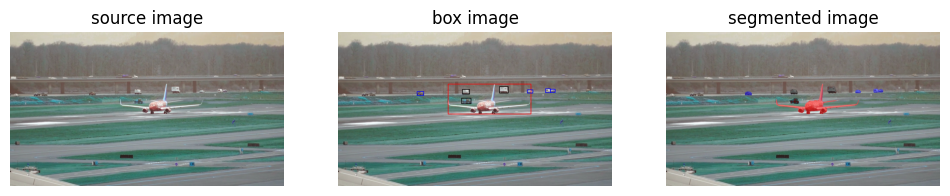


0: 384x640 1 person, 5 cars, 1 airplane, 4 trucks, 29.7ms
Speed: 0.6ms preprocess, 29.7ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.5332,  242.6634,  902.3042,  383.3238],
        [ 753.6545,  254.7975,  795.9905,  288.4794],
        [ 991.0031,  267.9044, 1014.8114,  282.8140],
        [ 581.7788,  268.4182,  614.4325,  291.1379],
        [ 370.4353,  279.4544,  399.8815,  295.7986],
        [ 884.3310,  271.0981,  910.0198,  285.5242],
        [ 577.6375,  308.3572,  620.4172,  335.4149],
        [ 968.8633,  265.6859,  991.0540,  284.5672]], device='cuda:0')


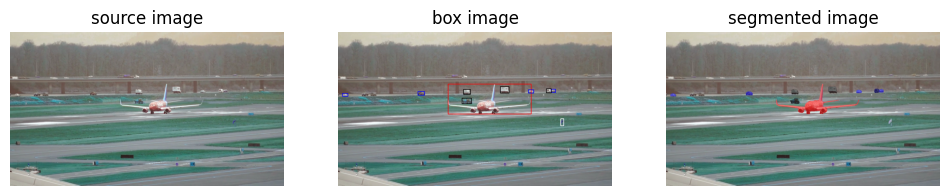


0: 384x640 7 cars, 1 airplane, 3 trucks, 42.9ms
Speed: 0.6ms preprocess, 42.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 512.0010,  242.6365,  902.8752,  383.3652],
        [ 757.6447,  254.7206,  800.4449,  288.7101],
        [ 374.4188,  278.9086,  404.3552,  295.6825],
        [ 586.4398,  268.5801,  618.7848,  291.4094],
        [ 577.7448,  308.4862,  622.8219,  335.2911],
        [ 888.8851,  271.2083,  915.1944,  285.3837],
        [ 994.4987,  267.9081, 1016.7657,  282.6494],
        [ 973.8384,  266.3215,  995.0869,  284.0829],
        [  21.2577,  287.1266,   46.2749,  300.1216],
        [ 973.7948,  267.0034,  994.5128,  284.1382],
        [1039.1143,  407.5399, 1054.8428,  431.6237]], device='cuda:0')


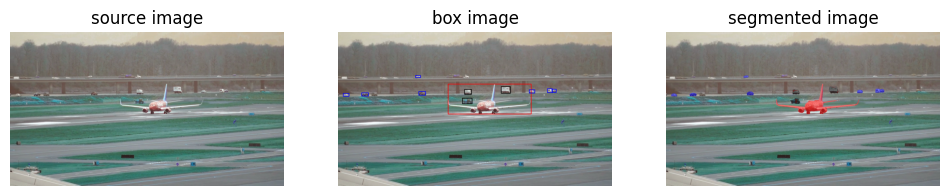


0: 384x640 7 cars, 2 airplanes, 3 trucks, 29.8ms
Speed: 0.6ms preprocess, 29.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.5208,  242.2872,  903.3647,  383.7766],
        [ 763.1247,  254.7601,  804.7055,  288.3361],
        [ 378.2389,  279.1781,  408.3883,  295.8391],
        [ 591.5982,  268.3588,  623.5102,  292.2330],
        [ 893.0883,  271.5693,  919.2435,  285.7890],
        [ 580.7158,  308.8170,  626.1517,  335.4031],
        [1000.0951,  267.6549, 1020.2269,  282.4835],
        [ 362.3068,  204.0421,  384.3208,  213.5468],
        [ 111.3123,  285.9864,  142.3609,  299.8954],
        [ 977.7109,  266.0094, 1001.0281,  284.1709],
        [  25.2407,  286.9654,   49.7478,  299.7717]], device='cuda:0')


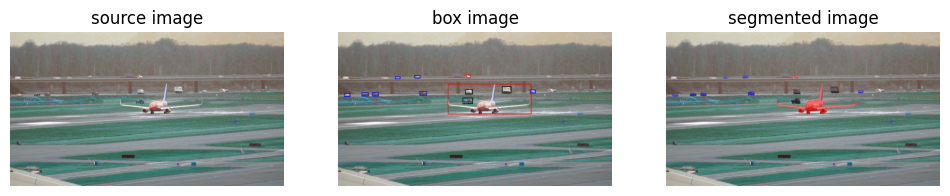


0: 384x640 1 person, 5 cars, 1 airplane, 4 trucks, 32.1ms
Speed: 0.6ms preprocess, 32.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[511.3880, 242.3538, 903.0914, 383.8463],
        [767.1641, 254.6562, 809.4958, 288.2440],
        [897.6165, 271.6845, 922.9165, 286.2481],
        [160.8111, 283.2397, 189.3438, 298.6618],
        [111.7697, 285.5378, 142.0539, 299.9877],
        [596.7090, 268.0157, 628.0244, 291.1675],
        [383.2683, 278.3217, 413.9258, 295.4514],
        [358.8964, 204.6466, 382.3160, 215.2886],
        [ 30.4543, 287.3048,  56.0218, 299.6518],
        [582.9180, 308.7285, 627.6323, 335.5573],
        [599.9171, 198.6514, 618.0251, 214.8195],
        [267.7039, 209.1934, 290.6366, 217.5120]], device='cuda:0')


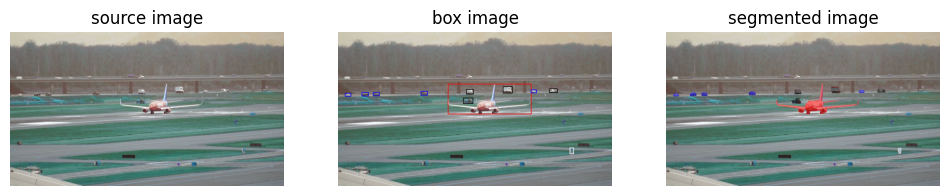


0: 384x640 6 cars, 1 airplane, 4 trucks, 33.7ms
Speed: 0.6ms preprocess, 33.7ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.4428,  242.4095,  902.7723,  383.9589],
        [ 771.5186,  254.6295,  813.5522,  287.2552],
        [ 601.1789,  267.9842,  631.6028,  291.0958],
        [ 165.7617,  281.8476,  193.5962,  298.8753],
        [ 111.7793,  285.0455,  142.6138,  299.3215],
        [ 901.1581,  271.0087,  927.3129,  285.7802],
        [ 387.5718,  278.6634,  418.6694,  295.0400],
        [ 583.4728,  308.0026,  630.1754,  335.0748],
        [  34.7935,  287.5111,   59.2567,  299.2130],
        [ 987.4329,  265.8093, 1024.2758,  283.2416],
        [1087.7224,  540.7390, 1100.3333,  570.4504]], device='cuda:0')


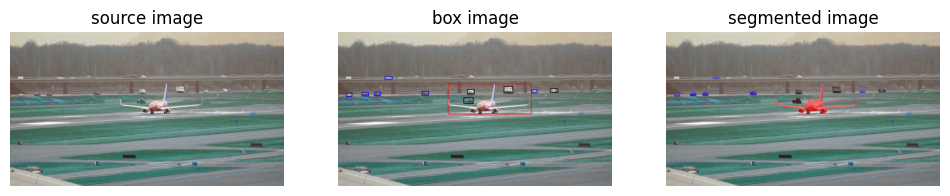


0: 384x640 1 person, 9 cars, 1 airplane, 3 trucks, 32.2ms
Speed: 0.6ms preprocess, 32.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.6610,  242.6245,  903.1564,  383.9060],
        [ 776.0131,  254.4746,  818.1830,  287.2180],
        [ 170.1550,  282.0652,  198.0131,  298.4893],
        [ 605.0884,  267.7739,  635.2896,  291.3369],
        [ 111.7649,  284.3293,  142.6756,  299.2643],
        [ 905.6298,  271.4956,  930.7921,  285.4281],
        [ 392.2870,  278.6412,  422.7767,  294.7508],
        [ 586.8181,  307.6291,  631.8088,  335.1496],
        [ 992.5912,  265.7784, 1027.1757,  283.0124],
        [  39.5363,  287.3456,   65.3813,  299.0523],
        [ 218.3963,  209.9825,  253.2314,  219.8882]], device='cuda:0')


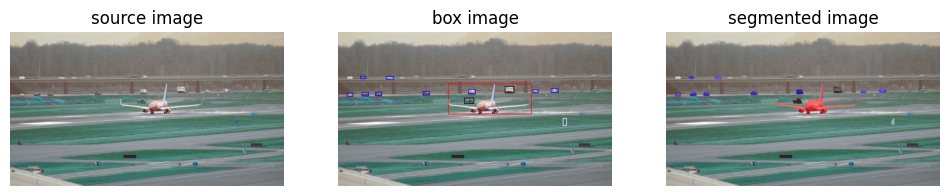


0: 384x640 9 cars, 1 airplane, 3 trucks, 34.5ms
Speed: 1.5ms preprocess, 34.5ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.7046,  242.3265,  904.3723,  383.9695],
        [ 780.5139,  255.0035,  821.5351,  287.2764],
        [ 174.5341,  281.4058,  203.2566,  298.3204],
        [ 995.4832,  265.3528, 1029.8093,  283.1851],
        [ 909.0354,  270.8561,  936.4092,  285.9138],
        [ 396.0049,  277.8478,  428.6192,  295.0066],
        [ 590.4108,  307.7015,  634.5873,  335.3530],
        [ 610.3047,  267.9649,  640.6274,  291.2709],
        [ 610.2240,  268.0628,  641.0494,  291.6652],
        [ 104.2810,  206.0994,  131.0919,  218.1947],
        [ 111.2473,  284.3780,  143.5914,  299.9205],
        [  43.8695,  286.8260,   69.9784,  299.0761],
        [ 225.9068,  209.1601,  259.8836,  221.0928],
        [1051.2885,  404.9748, 1067.6642,  431.1788]], device='cuda:0')


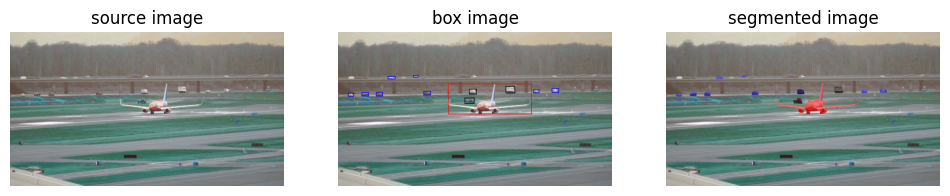


0: 384x640 7 cars, 2 airplanes, 3 trucks, 30.1ms
Speed: 0.6ms preprocess, 30.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.4503,  242.5846,  904.6459,  384.0170],
        [ 784.5272,  254.7471,  826.4356,  287.2336],
        [ 178.8638,  281.7704,  207.8023,  298.4269],
        [ 999.8904,  265.0477, 1031.3062,  283.1318],
        [ 614.4983,  268.1786,  645.1731,  291.6971],
        [ 913.1200,  271.0695,  940.2206,  285.3047],
        [ 111.8156,  283.9611,  144.0082,  300.0411],
        [ 401.2462,  278.2953,  431.8826,  294.5730],
        [ 591.3594,  307.3914,  636.3843,  335.2203],
        [  47.9371,  287.0447,   73.9855,  299.1756],
        [ 614.6962,  268.0139,  645.5240,  291.1277],
        [ 352.3322,  203.9153,  373.3087,  210.9104],
        [ 232.2229,  208.5030,  266.9696,  220.2239]], device='cuda:0')


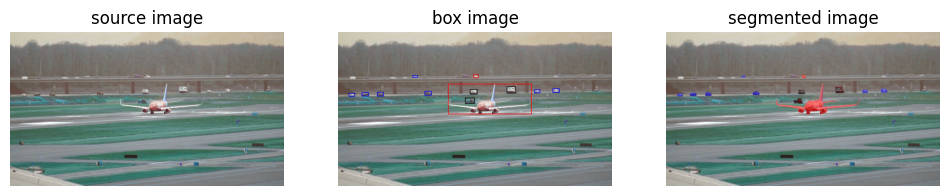


0: 384x640 8 cars, 2 airplanes, 3 trucks, 30.2ms
Speed: 0.6ms preprocess, 30.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.7097,  242.4831,  906.3735,  384.2354],
        [ 789.6726,  254.8035,  830.0312,  287.4062],
        [ 183.6763,  282.0556,  212.2202,  298.5073],
        [1003.7576,  265.7134, 1034.2542,  283.0319],
        [ 111.9483,  283.9734,  143.7352,  299.9800],
        [ 592.6912,  307.7660,  638.0849,  335.3127],
        [ 916.8771,  271.0318,  943.3566,  285.3988],
        [ 617.7852,  267.6697,  649.1321,  290.5438],
        [ 405.5771,  278.1241,  436.8068,  295.0768],
        [  52.3400,  286.7353,   79.3345,  299.2978],
        [ 350.3482,  203.8452,  371.8305,  211.2676],
        [ 634.8763,  198.6763,  654.4261,  214.9104]], device='cuda:0')


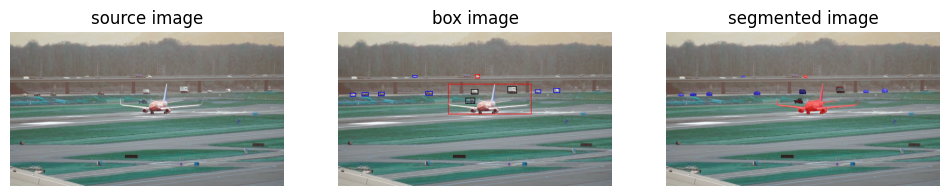


0: 384x640 7 cars, 2 airplanes, 2 trucks, 34.1ms
Speed: 0.6ms preprocess, 34.1ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.8234,  242.4850,  904.7404,  384.2966],
        [ 793.6589,  254.3608,  834.8247,  287.4790],
        [ 188.2133,  281.6372,  217.2105,  298.4329],
        [ 112.2275,  285.0021,  142.9852,  300.2759],
        [ 921.4583,  270.9297,  948.0681,  285.6093],
        [ 409.5826,  278.1452,  440.9225,  294.6972],
        [ 594.8899,  307.2669,  640.2856,  335.0123],
        [ 622.9365,  268.1628,  653.7185,  291.2795],
        [1008.4421,  265.6844, 1035.7556,  283.7250],
        [ 622.8783,  267.4650,  653.4965,  290.9508],
        [  57.3841,  286.3933,   84.2561,  298.6761],
        [ 642.4924,  199.0857,  661.6289,  214.3186],
        [ 348.4427,  203.8809,  369.2568,  211.4279]], device='cuda:0')


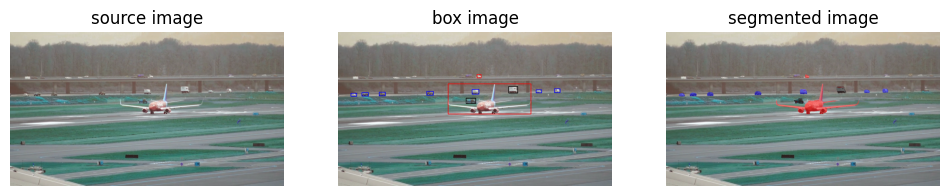


0: 384x640 1 person, 7 cars, 1 airplane, 2 trucks, 28.8ms
Speed: 0.5ms preprocess, 28.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.3705,  241.9865,  903.1041,  384.0516],
        [ 797.3651,  253.8757,  839.7885,  287.2298],
        [ 193.2258,  281.9660,  220.9240,  297.9195],
        [ 926.3633,  270.9629,  951.9755,  285.4679],
        [ 111.7759,  285.1143,  143.2757,  300.1437],
        [ 414.3952,  277.9615,  445.4341,  294.7245],
        [  61.5237,  285.9961,   88.1613,  299.5443],
        [1011.5114,  265.0201, 1037.0057,  283.5660],
        [ 626.7264,  267.8466,  658.6370,  291.0200],
        [ 597.8615,  307.3363,  642.2021,  335.0657],
        [ 650.4972,  199.3548,  668.6918,  214.2103]], device='cuda:0')


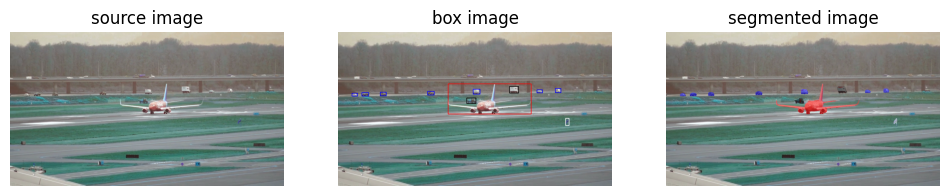


0: 384x640 1 person, 6 cars, 2 airplanes, 3 trucks, 28.7ms
Speed: 0.6ms preprocess, 28.7ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.6361,  241.7895,  903.4214,  384.2390],
        [ 801.3840,  253.8190,  843.8794,  286.5595],
        [ 111.9794,  284.8889,  143.0121,  299.7695],
        [ 198.1168,  282.0321,  225.0972,  297.9906],
        [  65.3959,  286.2066,   92.4589,  299.5756],
        [ 929.1883,  270.9437,  955.7515,  285.1103],
        [ 631.3540,  267.9010,  663.0022,  290.8173],
        [ 418.3065,  277.9755,  448.6584,  294.5312],
        [1016.2287,  265.4276, 1040.6179,  283.5150],
        [ 599.2349,  307.5077,  643.7103,  334.8511],
        [1063.1519,  403.1529, 1080.6196,  429.9345]], device='cuda:0')


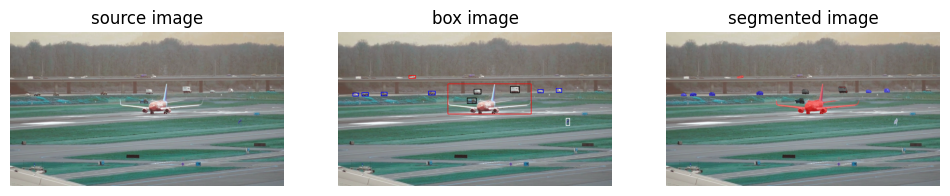


0: 384x640 1 person, 10 cars, 2 airplanes, 3 trucks, 30.1ms
Speed: 0.6ms preprocess, 30.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.6024,  241.8580,  903.3751,  384.3620],
        [ 805.9387,  254.1467,  847.5651,  286.1934],
        [ 934.1394,  270.9912,  959.3569,  285.2754],
        [ 331.9742,  204.6228,  362.2529,  215.2192],
        [  70.3344,  285.7376,   96.2167,  299.2990],
        [ 111.7849,  285.5289,  142.7091,  299.9494],
        [ 202.2824,  282.4235,  229.6629,  297.9299],
        [ 422.8112,  277.2746,  454.0375,  294.4634],
        [ 635.5597,  267.5605,  668.1476,  290.8893],
        [1019.6091,  265.3355, 1045.2629,  283.3376],
        [ 601.9178,  307.7087,  646.4911,  334.6522],
        [1064.9795,  402.8659, 1082.7498,  429.6396]], device='cuda:0')


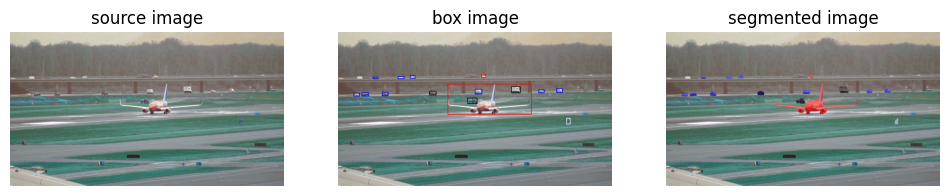


0: 384x640 8 cars, 2 airplanes, 2 trucks, 42.1ms
Speed: 0.7ms preprocess, 42.1ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.5654,  242.0454,  902.9095,  384.4399],
        [ 810.1350,  254.2834,  851.9204,  286.2311],
        [ 936.6912,  270.1991,  964.4834,  285.1941],
        [ 207.0141,  281.7879,  234.3502,  297.8615],
        [  73.4211,  285.9749,  100.2363,  299.0024],
        [ 111.7666,  284.7627,  143.1978,  299.9984],
        [ 281.3326,  209.0215,  309.6699,  218.0499],
        [ 338.6298,  204.4935,  360.1326,  215.7055],
        [1021.6746,  264.8972, 1048.8374,  283.5297],
        [ 640.8241,  267.6474,  672.1044,  291.0056],
        [ 670.4875,  199.0157,  689.7466,  214.1262],
        [ 427.5061,  277.3048,  458.5333,  294.7878],
        [1067.7738,  404.5055, 1085.5941,  430.5374],
        [ 427.5446,  277.1491,  458.3827,  294.8986],
        [ 604.4751,  307.3811,  649.4017,  335.0873],
        [ 164.4689,  210.5736,  187.1733,  218.7771]], device='cuda:0')


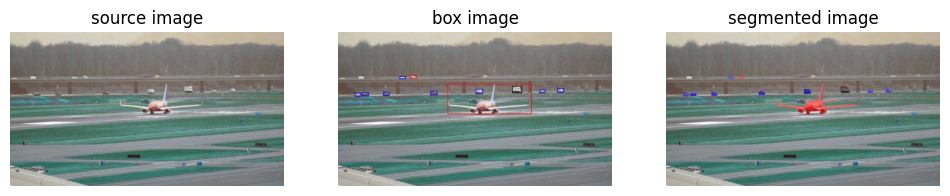


0: 384x640 1 person, 7 cars, 2 airplanes, 3 trucks, 63.2ms
Speed: 0.6ms preprocess, 63.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.9764,  242.1684,  903.3405,  384.1164],
        [ 813.8962,  254.0363,  856.2891,  285.9646],
        [ 941.7579,  270.3723,  967.3036,  284.8132],
        [ 212.5851,  281.9845,  239.1900,  297.5284],
        [  78.8462,  285.3291,  105.4470,  299.7496],
        [ 111.5853,  284.1245,  143.7207,  299.6775],
        [ 432.9338,  277.2112,  462.7849,  294.1241],
        [1025.2239,  264.3322, 1054.6934,  283.9073],
        [ 644.7762,  267.3927,  676.6847,  290.5019],
        [ 644.9596,  267.2407,  676.5707,  290.5225],
        [ 336.2598,  204.1881,  367.8436,  215.7818],
        [ 288.8246,  208.9662,  317.8697,  217.8646]], device='cuda:0')


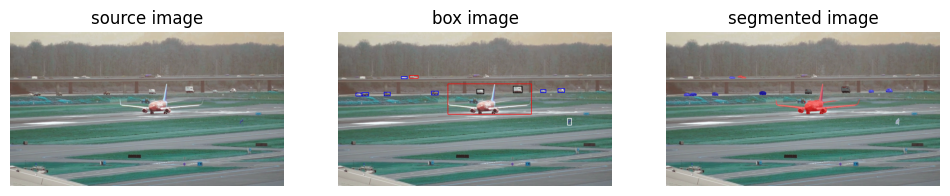


0: 384x640 1 person, 8 cars, 1 airplane, 3 trucks, 34.8ms
Speed: 0.6ms preprocess, 34.8ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.7678,  242.1249,  904.4783,  384.4985],
        [ 819.2827,  254.2262,  860.1304,  285.7872],
        [ 946.2289,  269.8406,  972.1527,  284.3775],
        [ 216.5142,  282.3590,  244.0899,  297.7294],
        [ 649.4410,  266.9578,  681.2818,  290.6916],
        [ 110.8456,  283.9718,  143.3219,  299.6818],
        [1026.6494,  263.9655, 1057.7563,  283.5275],
        [ 436.1312,  277.2744,  468.1165,  294.6294],
        [  83.2332,  285.3880,  112.1746,  299.7839],
        [1071.9589,  403.3547, 1090.3849,  430.6719],
        [ 436.3947,  277.6006,  467.9999,  294.4166],
        [ 332.4327,  204.2671,  375.9006,  216.1740],
        [ 296.9407,  208.1411,  323.9173,  218.4090]], device='cuda:0')


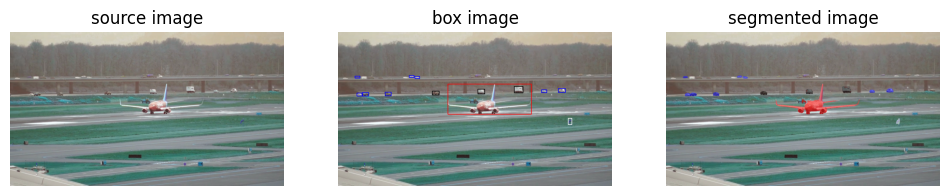


0: 384x640 7 cars, 1 airplane, 3 trucks, 31.0ms
Speed: 0.6ms preprocess, 31.0ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.7209,  242.1710,  905.0374,  384.6698],
        [ 823.6289,  254.3745,  863.3950,  285.6251],
        [ 951.0410,  270.6184,  975.5747,  284.6398],
        [1029.7196,  264.2847, 1062.0482,  283.3726],
        [ 220.7523,  282.3725,  249.0842,  298.1083],
        [  88.0214,  285.3445,  113.9304,  299.4019],
        [ 112.0291,  284.4349,  143.0659,  299.6200],
        [ 654.4236,  267.3800,  685.5823,  290.4415],
        [ 441.1462,  277.3802,  472.0114,  294.3340],
        [  79.7650,  206.3694,  101.0404,  214.4060],
        [1074.9324,  403.8005, 1093.9441,  430.6369],
        [ 331.3490,  204.5440,  355.5482,  212.6311],
        [ 360.1554,  207.6100,  382.0202,  217.0908]], device='cuda:0')


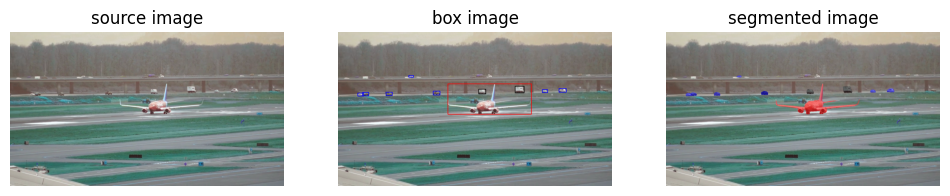


0: 384x640 1 person, 9 cars, 1 airplane, 2 trucks, 39.8ms
Speed: 0.6ms preprocess, 39.8ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.8870,  241.6779,  904.5239,  384.6548],
        [ 828.1684,  254.7119,  868.6673,  285.6501],
        [ 954.4945,  270.0462,  979.2085,  284.2493],
        [1032.6160,  263.9851, 1065.6777,  282.0661],
        [ 658.4026,  266.9550,  690.1077,  290.7716],
        [ 225.7673,  282.5323,  252.8149,  297.8619],
        [  92.1176,  285.1468,  118.9742,  299.6999],
        [ 444.1259,  276.7393,  476.6385,  294.1370],
        [ 115.8535,  283.5797,  143.9124,  298.9698],
        [ 444.4228,  276.7972,  476.7336,  294.1307],
        [ 330.6758,  204.3469,  351.4031,  211.7374]], device='cuda:0')


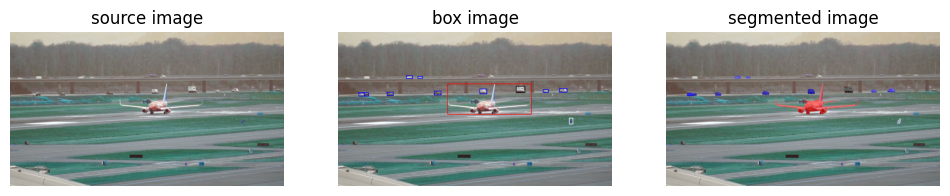


0: 384x640 1 person, 7 cars, 1 airplane, 2 trucks, 34.0ms
Speed: 0.6ms preprocess, 34.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.8259,  241.5582,  905.3626,  385.2897],
        [ 833.1881,  254.9699,  873.4398,  285.8030],
        [ 959.9596,  270.9271,  983.4279,  283.9989],
        [1035.1963,  264.7206, 1069.4702,  281.8972],
        [ 230.6503,  281.8124,  258.0847,  297.7535],
        [ 663.1536,  266.8881,  693.8430,  290.3345],
        [ 663.1926,  266.7876,  693.5090,  290.2735],
        [ 449.8041,  276.4022,  481.7121,  293.9453],
        [ 320.6315,  204.5873,  348.5884,  217.9526],
        [ 373.6186,  207.4189,  395.8632,  216.4929],
        [  96.5362,  284.7286,  123.5678,  300.0847],
        [  96.6309,  283.9359,  143.6351,  300.0873],
        [1080.0046,  404.0274, 1098.5847,  429.7052]], device='cuda:0')


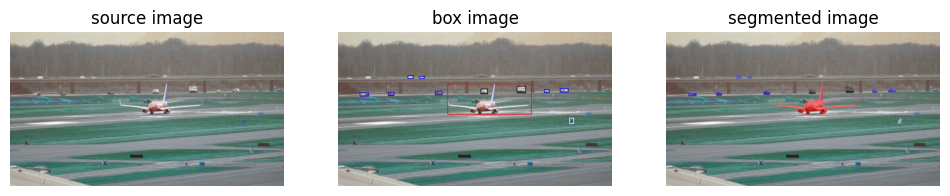


0: 384x640 1 person, 5 cars, 2 airplanes, 3 trucks, 29.9ms
Speed: 0.6ms preprocess, 29.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.8846,  241.8550,  905.4471,  385.4277],
        [ 836.3064,  253.9300,  877.8972,  285.5167],
        [ 963.1201,  270.3427,  987.6978,  284.1255],
        [1037.8176,  264.7411, 1074.1643,  282.2028],
        [ 235.2188,  282.7054,  262.0710,  297.6474],
        [ 667.9467,  266.7448,  699.0145,  290.6318],
        [ 101.8648,  283.4201,  143.6584,  300.3238],
        [ 454.4277,  277.0458,  486.3860,  293.9417],
        [ 327.0961,  204.4638,  353.3423,  217.1564],
        [ 381.7081,  208.7213,  403.5513,  216.8181],
        [1082.0898,  404.5235, 1100.9653,  429.3519]], device='cuda:0')


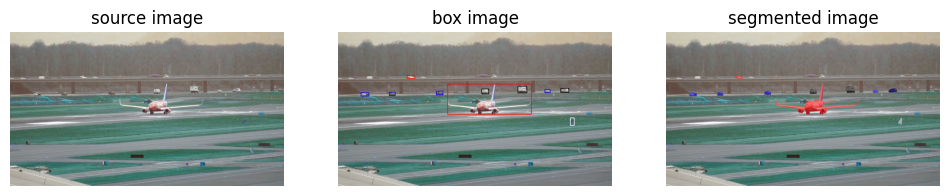


0: 384x640 1 person, 7 cars, 1 airplane, 2 trucks, 28.7ms
Speed: 0.6ms preprocess, 28.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.7354,  242.0244,  907.3579,  385.6362],
        [ 841.0388,  254.0335,  882.5381,  285.1173],
        [ 967.3344,  270.5530,  992.2198,  283.9990],
        [ 240.7435,  282.0219,  267.3579,  297.4320],
        [ 672.9458,  266.8135,  703.9530,  290.9813],
        [ 106.0444,  283.0979,  144.2904,  299.7847],
        [1040.5508,  264.3699, 1079.3242,  283.6609],
        [ 460.0572,  277.3048,  490.1679,  293.7601],
        [ 322.3112,  204.0308,  360.3027,  217.3859],
        [1085.0178,  404.1315, 1103.3254,  429.1954],
        [1040.3035,  264.2663, 1079.2556,  283.8004]], device='cuda:0')


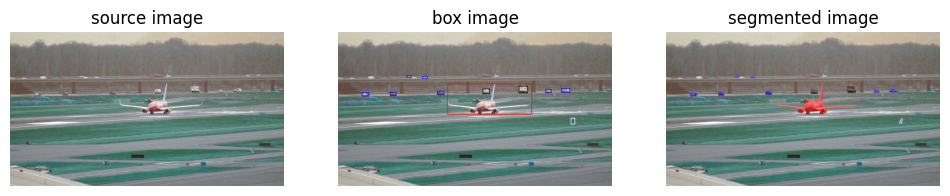


0: 384x640 1 person, 6 cars, 1 airplane, 3 trucks, 30.2ms
Speed: 0.6ms preprocess, 30.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.7687,  241.8521,  906.3407,  385.6086],
        [ 845.6058,  254.0077,  886.2675,  285.3772],
        [ 971.3912,  269.9874,  996.4984,  283.8297],
        [ 244.8596,  281.9951,  271.5369,  297.4366],
        [ 111.4509,  282.8470,  144.2043,  299.5488],
        [ 676.9448,  266.9147,  707.2481,  290.2855],
        [ 465.2391,  277.0186,  494.7745,  293.6271],
        [ 395.4632,  208.2303,  416.9507,  217.1865],
        [1044.0293,  264.7531, 1082.4797,  281.6675],
        [1087.3114,  402.7086, 1106.7013,  430.3093],
        [ 321.8335,  203.9484,  343.0956,  211.2494]], device='cuda:0')


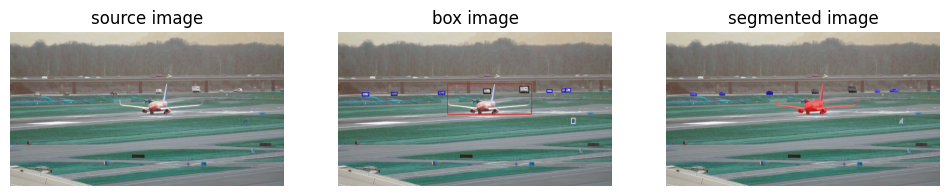


0: 384x640 8 cars, 1 airplane, 2 trucks, 31.8ms
Speed: 0.6ms preprocess, 31.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.9125,  241.6258,  905.2555,  385.7523],
        [ 849.9746,  253.0554,  891.1807,  285.3669],
        [ 976.0469,  270.7968, 1000.0991,  283.9430],
        [ 112.7096,  283.5685,  143.2963,  299.8154],
        [ 249.2447,  282.0744,  276.3826,  297.6925],
        [ 681.3528,  266.5262,  711.6155,  290.3059],
        [ 468.0849,  276.4628,  500.2819,  293.9595],
        [ 468.1883,  276.9224,  500.0421,  293.8439],
        [1045.8456,  267.2757, 1064.4830,  280.6118],
        [1062.0747,  264.4981, 1087.0417,  280.3029],
        [1088.8604,  403.0609, 1108.7524,  429.5374]], device='cuda:0')


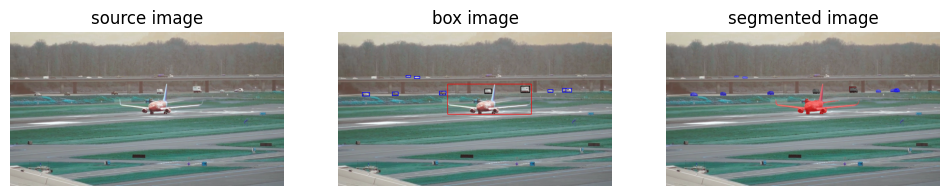


0: 384x640 8 cars, 1 airplane, 2 trucks, 32.9ms
Speed: 0.5ms preprocess, 32.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 511.3470,  241.6016,  904.4447,  385.8223],
        [ 853.5840,  253.2033,  895.4026,  284.9394],
        [ 979.4188,  269.3276, 1004.4458,  283.9417],
        [ 113.4225,  283.2445,  146.3951,  299.4702],
        [ 253.6253,  280.9912,  281.5633,  297.3128],
        [ 473.3201,  277.0482,  503.9677,  292.9563],
        [ 686.2493,  266.6491,  717.9487,  289.8317],
        [1065.9985,  264.2739, 1091.7568,  280.7618],
        [ 356.3537,  208.0932,  382.6403,  218.0835],
        [ 317.9880,  203.9947,  338.9831,  210.8557],
        [1049.3057,  263.9177, 1091.9194,  281.5610]], device='cuda:0')


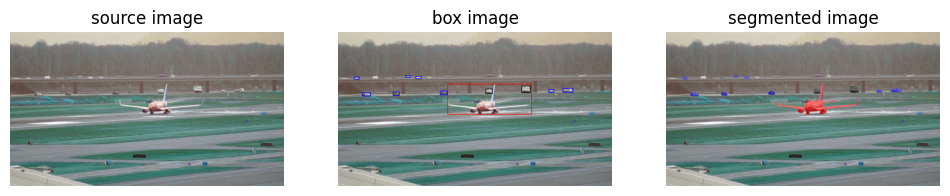


0: 384x640 8 cars, 1 airplane, 2 trucks, 39.7ms
Speed: 0.6ms preprocess, 39.7ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 510.6055,  241.1074,  905.0455,  385.8202],
        [ 983.8550,  270.6342, 1007.9739,  283.9713],
        [ 858.5815,  252.6008,  900.3757,  285.2968],
        [ 113.5052,  283.4243,  152.3147,  299.5791],
        [ 257.4753,  281.1263,  286.2996,  297.4939],
        [ 477.7677,  276.8244,  508.3025,  292.5467],
        [1050.9406,  265.4287, 1094.3268,  281.1033],
        [ 689.6877,  265.5687,  721.0869,  289.9146],
        [  74.9941,  211.1030,  100.7755,  220.6475],
        [ 363.9399,  207.7183,  389.7575,  218.3313],
        [ 314.8321,  203.5825,  336.4656,  210.6189]], device='cuda:0')


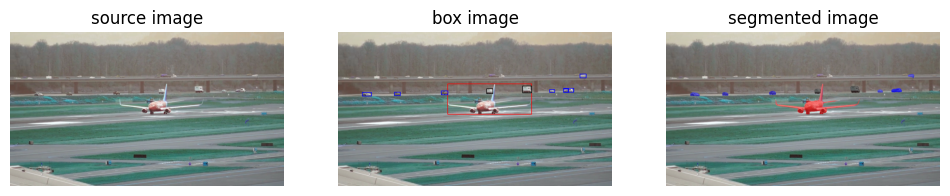


0: 384x640 12 cars, 2 airplanes, 2 trucks, 33.5ms
Speed: 0.6ms preprocess, 33.5ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 509.3562,  240.9689,  904.9863,  385.8798],
        [ 862.6481,  252.6451,  904.4710,  285.5902],
        [ 988.0728,  269.5884, 1013.2332,  283.9786],
        [ 113.2452,  282.6093,  156.0409,  299.0155],
        [ 262.1747,  281.6080,  290.8989,  297.3355],
        [ 482.3381,  277.0360,  512.9996,  292.6832],
        [1053.5330,  266.7032, 1080.5012,  281.0282],
        [1075.8451,  264.5221, 1099.4921,  280.2948],
        [ 694.1489,  265.2283,  723.2136,  289.6589],
        [1131.3157,  198.0168, 1159.2615,  215.8421],
        [1053.6025,  265.8123, 1093.1450,  281.8442]], device='cuda:0')


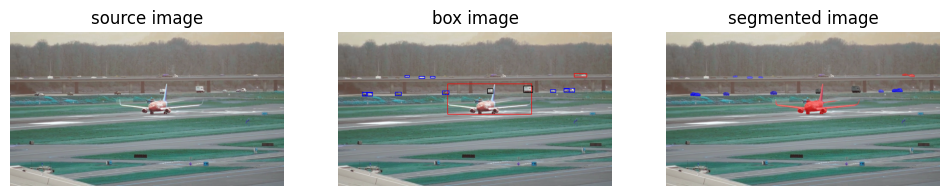


0: 384x640 9 cars, 2 airplanes, 2 trucks, 31.2ms
Speed: 0.6ms preprocess, 31.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 509.7286,  240.6998,  904.7913,  385.7356],
        [ 866.8617,  252.0119,  909.8141,  285.4904],
        [ 992.3256,  270.2896, 1016.6567,  283.8636],
        [ 267.3076,  281.3265,  295.1624,  296.9921],
        [ 487.0861,  277.3713,  517.6527,  291.7642],
        [ 698.9703,  265.1122,  724.3036,  289.7732],
        [ 113.2923,  282.3761,  161.6071,  299.5825],
        [ 311.4117,  204.1079,  332.7703,  210.8033],
        [ 377.9953,  207.4020,  405.5220,  217.6418],
        [1101.9070,  194.7086, 1198.7065,  211.1378],
        [ 135.1321,  284.4917,  161.5737,  298.9650],
        [ 431.4630,  207.0844,  454.1010,  215.2129],
        [1079.5132,  264.0655, 1103.8926,  280.7529],
        [1056.5951,  264.1870, 1103.7081,  281.5745],
        [1056.6023,  266.4797, 1083.4714,  280.7733],
        [ 113.0942,  282.4431,  138.0496,  298.9277]], device='cuda:0')


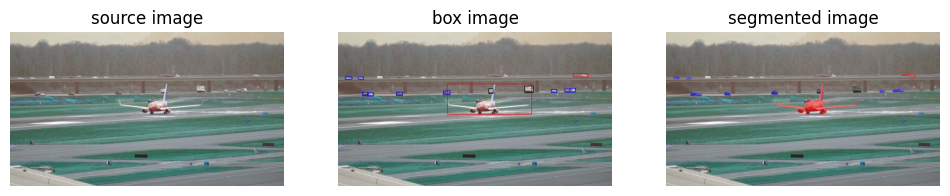


0: 384x640 9 cars, 1 airplane, 1 truck, 32.0ms
Speed: 0.9ms preprocess, 32.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 509.3352,  240.5886,  904.5664,  385.6571],
        [ 872.3104,  251.8085,  912.8145,  284.6101],
        [ 996.9729,  269.5729, 1021.2991,  283.9051],
        [ 272.5896,  281.5884,  300.0915,  296.7984],
        [ 138.6387,  285.8867,  165.9310,  298.2055],
        [ 113.8461,  282.3836,  141.8050,  298.1904],
        [1084.6548,  264.1815, 1108.5732,  280.0175],
        [ 491.6409,  277.2088,  522.0499,  291.9966],
        [1059.7305,  266.5916, 1085.0222,  280.6835],
        [ 704.2357,  265.6518,  725.3583,  289.1349],
        [  95.0936,  211.4209,  119.2150,  219.7995],
        [1099.5239,  194.7292, 1205.6858,  211.4476],
        [  31.4496,  208.9523,   65.4458,  220.1264]], device='cuda:0')


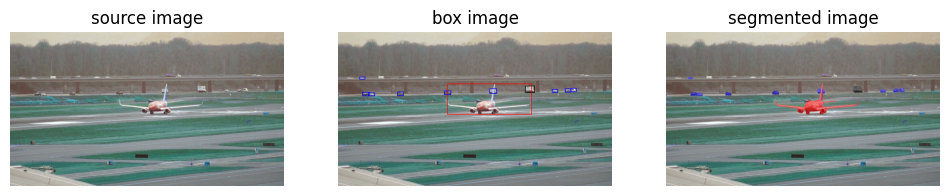


0: 384x640 8 cars, 1 airplane, 1 truck, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 509.1818,  239.2772,  905.5759,  385.6474],
        [ 876.3652,  251.3680,  918.0504,  284.6267],
        [1000.6869,  268.5564, 1025.4901,  283.6320],
        [ 278.2172,  280.2825,  305.3532,  296.6525],
        [ 143.7079,  284.7934,  170.6998,  298.6786],
        [ 114.2189,  281.7231,  146.4214,  298.6033],
        [1061.8303,  265.7949, 1086.5750,  280.5896],
        [1089.3694,  263.1868, 1113.6426,  280.2094],
        [ 496.2982,  277.0503,  526.7065,  292.0195],
        [ 100.7900,  211.2446,  127.0270,  220.6738],
        [ 708.2712,  264.5873,  740.5140,  288.9972]], device='cuda:0')


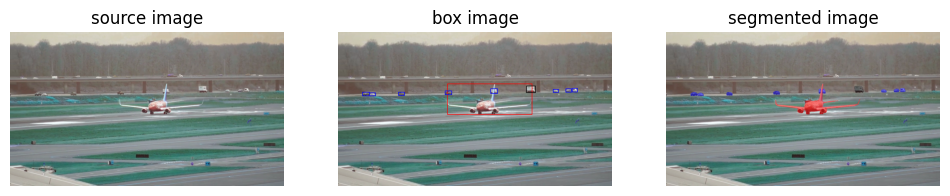


0: 384x640 10 cars, 1 airplane, 1 truck, 31.9ms
Speed: 0.6ms preprocess, 31.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 508.6202,  239.1408,  905.8362,  385.9073],
        [ 880.5133,  251.6706,  923.3647,  284.4470],
        [1004.6650,  268.4200, 1030.1952,  283.6094],
        [ 147.3811,  284.4973,  175.7398,  299.0701],
        [ 282.8052,  280.5616,  309.6804,  296.7079],
        [ 114.6057,  281.9078,  147.3829,  298.9626],
        [1064.7180,  266.1817, 1091.1233,  280.8160],
        [ 501.5862,  277.3383,  531.2742,  292.2161],
        [1093.3142,  262.9981, 1118.0442,  280.4713],
        [ 711.4922,  264.0860,  746.1084,  288.8819]], device='cuda:0')


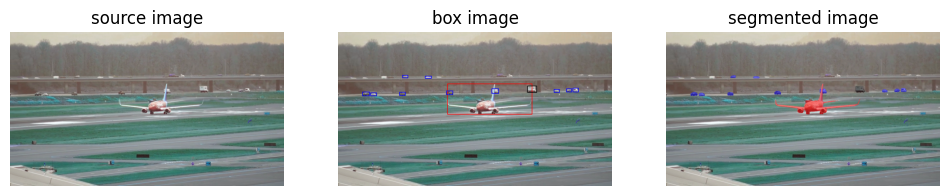


0: 384x640 1 person, 10 cars, 1 airplane, 1 truck, 31.4ms
Speed: 0.6ms preprocess, 31.4ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 509.4109,  238.6398,  905.4614,  385.7435],
        [ 884.3788,  251.3251,  927.6364,  284.1857],
        [1008.7079,  268.5936, 1033.5338,  283.1235],
        [ 151.5547,  283.9496,  180.0759,  298.4203],
        [ 114.9986,  281.8412,  146.9089,  298.3573],
        [ 287.6076,  281.3148,  314.2712,  296.4876],
        [1067.0579,  265.6765, 1092.4485,  280.7278],
        [1097.0339,  262.3521, 1122.1511,  280.8062],
        [ 505.6544,  276.4670,  536.1578,  292.2101],
        [ 301.1752,  203.0932,  326.1357,  214.5181],
        [ 717.9060,  263.9566,  750.3372,  287.7100],
        [ 407.6422,  207.4396,  436.9833,  217.1314]], device='cuda:0')


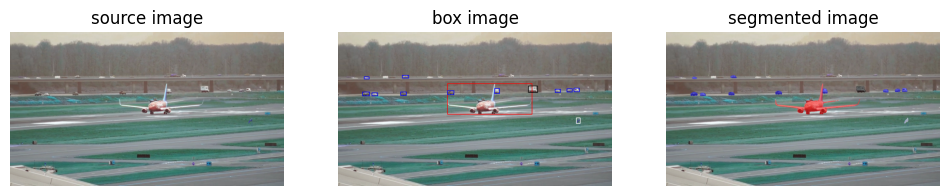


0: 384x640 9 cars, 1 airplane, 2 trucks, 30.9ms
Speed: 0.7ms preprocess, 30.9ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 508.3233,  239.2026,  905.9627,  386.0159],
        [ 159.3657,  283.7930,  185.3589,  298.3256],
        [ 115.0762,  281.6198,  147.7516,  298.2482],
        [ 889.8860,  251.8306,  932.8425,  284.0444],
        [1014.2603,  268.2369, 1038.6416,  283.2829],
        [1069.7150,  265.8373, 1094.2145,  280.7169],
        [ 292.8960,  280.9176,  319.5928,  296.3009],
        [ 511.2081,  275.5668,  541.3339,  292.2104],
        [1102.9634,  262.3751, 1127.5293,  281.1391],
        [ 731.8364,  264.4738,  754.9255,  287.7113],
        [ 301.2101,  202.2445,  330.2011,  214.7102],
        [ 121.5268,  209.9884,  145.9592,  219.7401],
        [1112.4390,  400.9485, 1132.4482,  428.1955]], device='cuda:0')


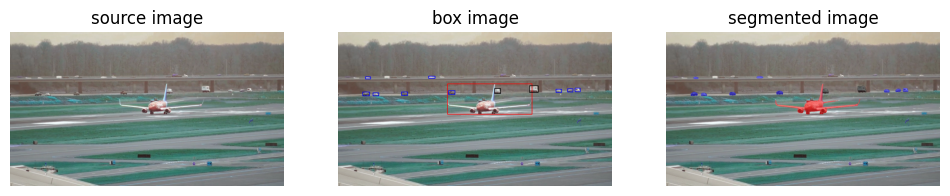


0: 384x640 1 person, 11 cars, 1 airplane, 1 truck, 30.2ms
Speed: 0.6ms preprocess, 30.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 509.6908,  239.9087,  906.2106,  385.9843],
        [ 894.6523,  251.0134,  935.6331,  283.5895],
        [1018.2604,  267.8478, 1042.8546,  282.4865],
        [ 296.8668,  280.6035,  324.1736,  296.4306],
        [ 115.4403,  281.2205,  148.6173,  298.4133],
        [1072.2200,  265.7679, 1097.0430,  280.4106],
        [ 163.6199,  283.5185,  190.4755,  298.5239],
        [ 515.6422,  275.2802,  546.0382,  292.3127],
        [1107.2688,  262.0504, 1130.8860,  280.8060],
        [ 732.1522,  264.2026,  760.5492,  288.5329],
        [ 127.9797,  210.4189,  152.5721,  219.2964],
        [ 422.9801,  207.2014,  452.8134,  217.3632]], device='cuda:0')


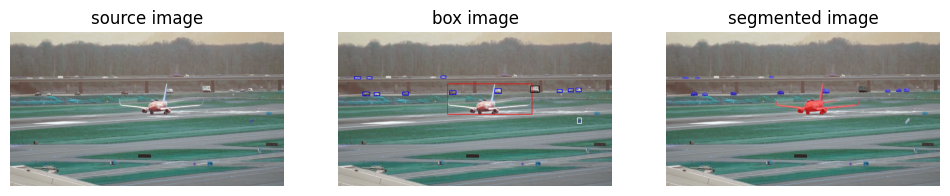


0: 384x640 10 cars, 1 airplane, 2 trucks, 31.2ms
Speed: 0.9ms preprocess, 31.2ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 506.0353,  240.0686,  907.7101,  386.2827],
        [ 899.8705,  252.0678,  940.1761,  282.6096],
        [1023.7844,  268.5045, 1047.3430,  282.8129],
        [ 302.4325,  281.0073,  329.5851,  296.3979],
        [ 115.7560,  280.9738,  148.6475,  298.2983],
        [ 168.5242,  283.0782,  194.4412,  298.8744],
        [1075.2382,  266.0775, 1099.4891,  280.4598],
        [ 520.1110,  275.4677,  550.9149,  292.3878],
        [ 134.5130,  210.1595,  160.2327,  220.1819],
        [ 732.1583,  264.5955,  764.0820,  288.4140],
        [1111.6846,  261.7135, 1135.7124,  280.5951],
        [  74.3549,  209.0070,  107.0690,  220.2187],
        [1118.6196,  400.4022, 1137.8828,  427.9278],
        [ 479.2355,  204.8977,  503.9412,  214.1485]], device='cuda:0')


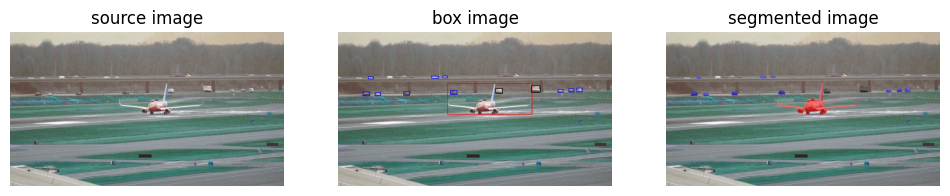


0: 384x640 8 cars, 1 airplane, 3 trucks, 29.7ms
Speed: 0.6ms preprocess, 29.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 509.0452,  240.1929,  907.9717,  386.3242],
        [ 116.3598,  281.0474,  149.0287,  298.2945],
        [ 173.6739,  283.5318,  199.9864,  298.7199],
        [ 904.0646,  251.6495,  944.9374,  283.1426],
        [1027.7178,  268.3284, 1051.1069,  281.6992],
        [1078.1129,  265.7076, 1102.6334,  280.5600],
        [ 307.0878,  280.6729,  333.8605,  296.3056],
        [ 525.3726,  275.4948,  555.6889,  292.1432],
        [ 736.6580,  263.8798,  768.3254,  288.4446],
        [1115.6287,  261.7867, 1139.9929,  281.0842],
        [ 141.5332,  209.4239,  165.2538,  219.6164],
        [ 437.9959,  206.8848,  469.0178,  217.0789],
        [ 489.8851,  205.9313,  511.6015,  214.0767]], device='cuda:0')


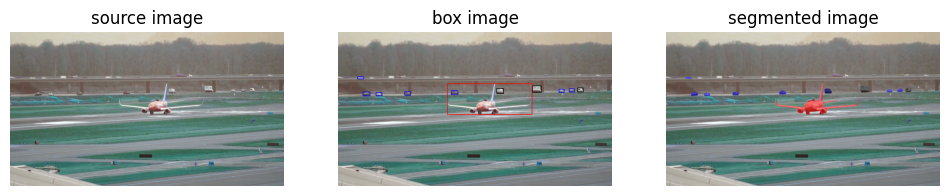


0: 384x640 11 cars, 1 airplane, 2 trucks, 30.2ms
Speed: 0.6ms preprocess, 30.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 506.8803,  240.1575,  907.7749,  386.5096],
        [ 116.9517,  281.9501,  149.4201,  298.4393],
        [1032.1869,  268.3011, 1055.4930,  282.3779],
        [ 909.4609,  252.2542,  948.4764,  283.4005],
        [ 177.1774,  283.3392,  203.9956,  298.8248],
        [ 311.3801,  280.4341,  339.1266,  296.3351],
        [1081.1410,  265.9601, 1104.5983,  280.5670],
        [ 529.5087,  274.4335,  560.3351,  292.3878],
        [ 741.5114,  264.2192,  772.4757,  288.4807],
        [  90.2348,  209.4920,  120.8460,  219.8487],
        [ 741.5328,  264.0806,  772.5158,  288.3794],
        [1120.4316,  261.6259, 1145.6660,  281.2308]], device='cuda:0')


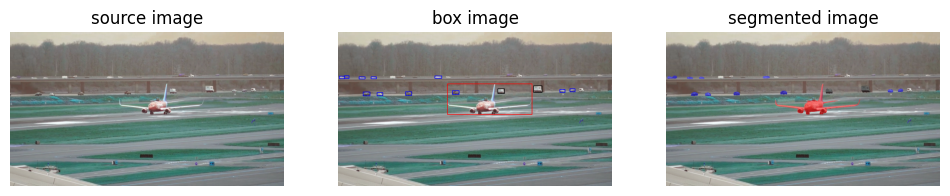


0: 384x640 10 cars, 1 airplane, 2 trucks, 29.3ms
Speed: 0.6ms preprocess, 29.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 508.0774,  240.5402,  907.7451,  386.5584],
        [ 117.8261,  282.4741,  148.5147,  298.2525],
        [ 913.0132,  251.4922,  954.4778,  283.1090],
        [1035.4607,  267.6391, 1059.9314,  282.0930],
        [ 183.0544,  283.6018,  208.8562,  298.7691],
        [ 316.8494,  280.6483,  343.4451,  296.0590],
        [ 746.8744,  264.6366,  777.8541,  288.1593],
        [1084.1917,  266.0370, 1107.6377,  280.5165],
        [ 534.0847,  274.6474,  565.4941,  292.4164],
        [  97.4019,  210.1915,  128.6281,  219.7197],
        [ 153.7624,  210.0174,  179.3475,  219.4185],
        [ 452.3842,  205.1036,  485.5784,  217.1816],
        [  30.2455,  204.4705,   52.0407,  216.6974],
        [   6.5498,  207.2267,   32.1071,  217.7399]], device='cuda:0')


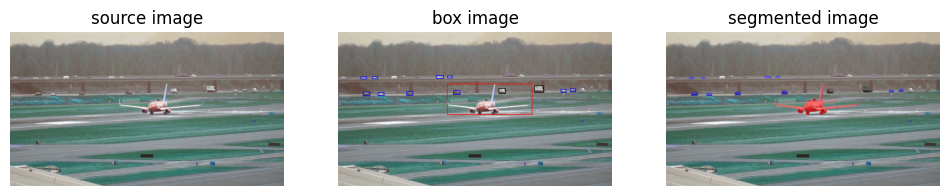


0: 384x640 8 cars, 1 airplane, 2 trucks, 63.7ms
Speed: 0.6ms preprocess, 63.7ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 508.6365,  240.5258,  907.5784,  386.4973],
        [ 117.5546,  281.9585,  149.9866,  298.2002],
        [ 917.7134,  250.9658,  959.2166,  283.2162],
        [1041.5878,  268.4146, 1064.6239,  282.1299],
        [ 187.7229,  283.2884,  215.0887,  298.6634],
        [ 751.3064,  264.5306,  782.1174,  288.4124],
        [1086.1289,  265.8715, 1110.8987,  280.2336],
        [ 322.0944,  279.9891,  349.6371,  296.5267],
        [ 540.0292,  274.7671,  570.0280,  291.8982],
        [ 160.3667,  209.5813,  186.5168,  218.6876],
        [ 459.6886,  203.9335,  493.8888,  216.2026],
        [ 510.9283,  205.0158,  534.3141,  213.8687],
        [ 106.8527,  209.5335,  134.2294,  219.2649]], device='cuda:0')


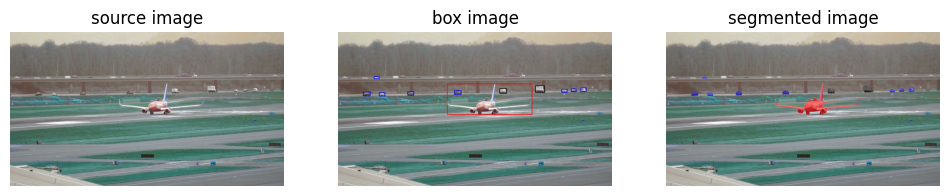


0: 384x640 1 person, 8 cars, 1 airplane, 2 trucks, 36.0ms
Speed: 0.6ms preprocess, 36.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 508.9608,  240.5139,  907.4542,  386.5374],
        [ 118.4010,  282.3207,  150.0064,  297.9678],
        [ 922.7999,  251.9554,  963.7076,  283.5853],
        [1044.9985,  267.5073, 1070.5581,  282.1397],
        [ 326.4676,  279.3222,  353.7608,  296.1021],
        [ 192.4160,  283.1486,  219.1567,  299.0427],
        [ 755.9850,  264.1715,  788.2356,  287.9675],
        [1089.3956,  265.6432, 1113.2941,  280.1791],
        [ 544.1310,  274.2262,  575.2797,  291.2021],
        [ 168.6137,  209.2363,  192.9644,  218.9009],
        [1134.2606,  261.3708, 1158.5587,  280.7102]], device='cuda:0')


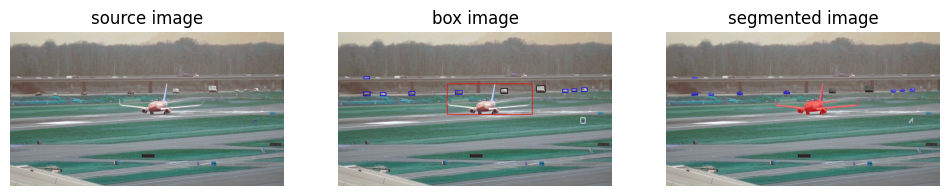


0: 384x640 7 cars, 2 airplanes, 2 trucks, 29.5ms
Speed: 0.6ms preprocess, 29.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 509.2300,  240.5637,  907.6880,  386.4991],
        [ 118.9768,  282.3421,  150.4693,  298.0025],
        [ 927.4692,  251.0091,  969.3346,  283.5188],
        [1049.1982,  267.7543, 1074.1431,  282.3911],
        [ 197.0545,  283.2643,  224.1327,  298.6521],
        [ 760.4973,  264.0577,  793.0066,  288.2037],
        [1092.2202,  265.6802, 1115.6699,  280.3330],
        [ 548.6584,  274.3055,  580.5089,  291.2197],
        [ 330.4842,  279.4749,  359.3761,  296.0300],
        [1138.6482,  261.5067, 1163.3860,  280.9580],
        [1133.8823,  399.8018, 1155.3362,  426.9169],
        [ 121.1426,  209.8965,  148.9536,  219.4420]], device='cuda:0')


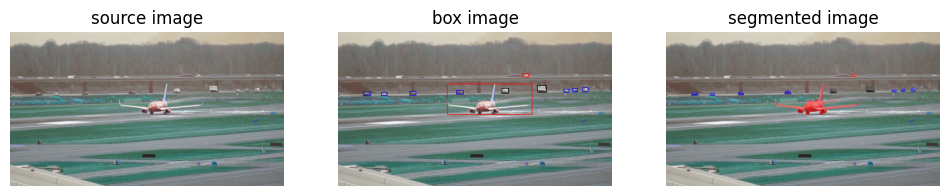


0: 384x640 8 cars, 1 airplane, 2 trucks, 35.2ms
Speed: 0.6ms preprocess, 35.2ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 509.1176,  240.7511,  907.5898,  386.5436],
        [ 931.8043,  250.1732,  975.2758,  283.2986],
        [ 119.0488,  281.8348,  151.5417,  298.1509],
        [1054.2397,  267.8646, 1079.6807,  282.1240],
        [ 201.0512,  283.1704,  229.2371,  298.5291],
        [ 765.8076,  263.9778,  797.1262,  287.4917],
        [ 336.2446,  278.8208,  363.9384,  295.1558],
        [1095.5518,  264.8569, 1119.0220,  279.8871],
        [ 553.4767,  274.0951,  584.4794,  290.7213],
        [1143.5435,  261.0042, 1167.9321,  279.5231],
        [ 860.4578,  193.5184,  890.5449,  210.8895]], device='cuda:0')


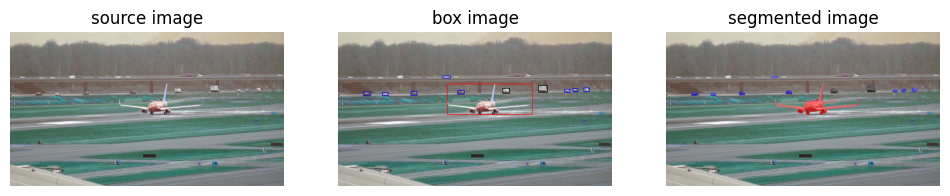


0: 384x640 7 cars, 1 airplane, 2 trucks, 34.0ms
Speed: 0.6ms preprocess, 34.0ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 508.7768,  241.2661,  907.6842,  386.5487],
        [ 937.1614,  250.2385,  978.8254,  283.0635],
        [1058.8947,  268.1901, 1083.2462,  282.0151],
        [ 118.7496,  281.3220,  152.5305,  298.5163],
        [ 207.0021,  282.7296,  234.4645,  298.0726],
        [1097.7559,  265.0747, 1122.5151,  279.6208],
        [ 770.2039,  263.9468,  802.0161,  287.3259],
        [ 557.7596,  273.7695,  590.2636,  290.3222],
        [ 341.2252,  279.0918,  369.4227,  295.0603],
        [1147.6814,  261.2614, 1172.5720,  279.6235],
        [ 490.1264,  205.6521,  526.2822,  215.8300]], device='cuda:0')


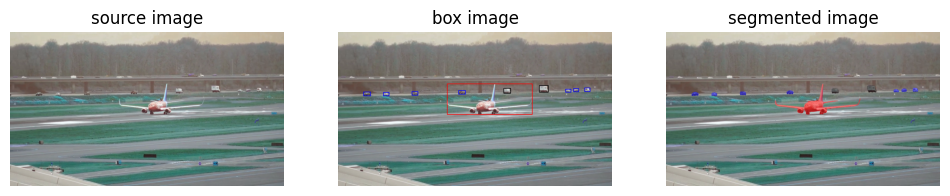


0: 384x640 9 cars, 1 airplane, 3 trucks, 32.9ms
Speed: 0.6ms preprocess, 32.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 508.8132,  241.3195,  907.9033,  386.5198],
        [ 941.2497,  250.0681,  982.3854,  283.1591],
        [1063.6550,  268.2410, 1087.5881,  281.2153],
        [1100.8160,  265.1093, 1124.4098,  279.4908],
        [ 119.7518,  281.2631,  152.7193,  298.5396],
        [ 212.3575,  283.1994,  238.2264,  297.2455],
        [ 774.9839,  263.7343,  805.6971,  287.3835],
        [ 564.0433,  274.5464,  594.2289,  290.4843],
        [1153.1321,  261.6414, 1177.0022,  279.5906],
        [ 346.3647,  278.0108,  374.0885,  295.0738]], device='cuda:0')


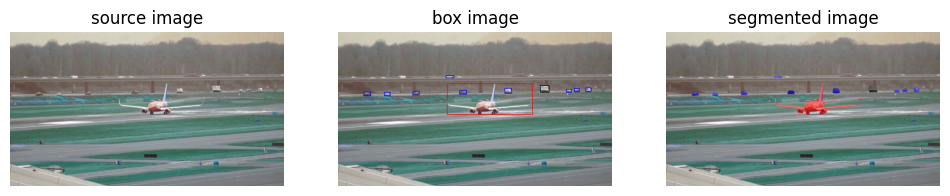


0: 384x640 1 person, 8 cars, 1 airplane, 2 trucks, 28.9ms
Speed: 0.5ms preprocess, 28.9ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 508.3482,  240.8075,  907.6144,  386.7802],
        [ 945.4286,  250.1458,  987.5822,  282.6196],
        [ 120.2808,  281.6624,  152.6505,  298.1534],
        [1067.3507,  267.7380, 1091.7592,  281.6901],
        [1103.8446,  265.0861, 1127.8263,  279.4536],
        [ 216.5515,  282.5362,  243.7915,  297.8185],
        [ 779.4540,  263.9849,  810.9803,  286.8693],
        [1157.2539,  261.2421, 1181.3655,  279.3455],
        [ 350.7482,  277.7134,  378.8179,  294.7549],
        [ 779.6262,  264.0191,  811.0121,  286.9481],
        [ 568.0599,  273.4138,  600.4440,  290.7103],
        [ 568.5835,  273.0891,  600.7505,  290.3878],
        [ 504.7276,  204.7021,  541.5275,  215.5197]], device='cuda:0')


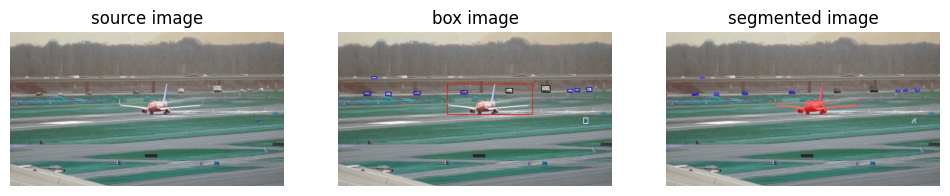


0: 384x640 1 person, 7 cars, 1 airplane, 2 trucks, 29.0ms
Speed: 0.6ms preprocess, 29.0ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 507.4849,  241.3442,  909.4376,  386.6746],
        [ 120.7419,  281.3852,  152.6328,  298.1531],
        [ 950.1860,  250.1010,  991.6698,  282.5454],
        [1072.5000,  268.4157, 1095.9360,  281.4149],
        [ 222.3599,  282.2844,  247.9973,  297.1232],
        [1106.2654,  264.8023, 1130.5447,  279.0004],
        [ 784.7761,  264.1505,  815.5437,  286.6317],
        [ 356.0192,  276.1010,  383.9578,  294.4761],
        [ 574.3219,  273.0095,  604.3126,  289.7562],
        [1161.1470,  261.3612, 1185.8711,  278.9928],
        [ 157.0850,  209.4819,  183.4069,  218.0270],
        [1146.9420,  400.1281, 1168.9601,  427.5977]], device='cuda:0')


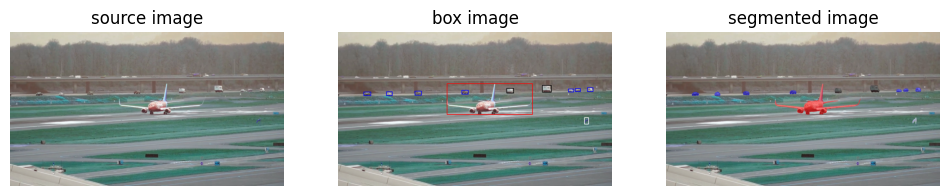


0: 384x640 7 cars, 1 airplane, 2 trucks, 29.4ms
Speed: 0.6ms preprocess, 29.4ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 506.5825,  240.9695,  912.0940,  386.7052],
        [ 121.4266,  281.6491,  152.4255,  297.9299],
        [ 954.5552,  249.3264,  996.5887,  282.6815],
        [ 789.3165,  263.1852,  819.4987,  286.3985],
        [1076.2395,  267.9834, 1100.4709,  281.5979],
        [ 578.2185,  272.4403,  607.8975,  289.8828],
        [1110.0259,  264.6806, 1132.3826,  279.1185],
        [1150.0183,  398.9132, 1172.1516,  427.2273],
        [ 360.2090,  276.3408,  389.8683,  295.1549],
        [ 226.6483,  276.2411,  253.0329,  297.0963],
        [1166.7156,  261.2065, 1190.7122,  278.9923]], device='cuda:0')


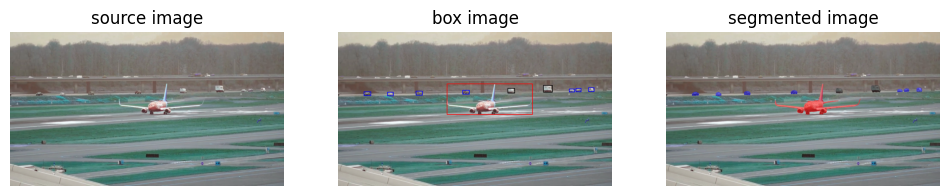


0: 384x640 1 person, 8 cars, 1 airplane, 2 trucks, 1 boat, 28.8ms
Speed: 2.9ms preprocess, 28.8ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 506.2916,  240.8831,  911.6673,  386.5417],
        [ 121.4472,  281.2465,  153.4841,  297.8913],
        [ 959.4368,  249.6297, 1001.1010,  282.5224],
        [1081.0103,  267.7297, 1105.5156,  281.1414],
        [1112.6426,  264.5276, 1135.4937,  278.7914],
        [ 793.4858,  262.3725,  825.5205,  286.8124],
        [ 583.1963,  272.4301,  613.6169,  290.0297],
        [ 365.5744,  277.5090,  393.1964,  294.5065],
        [ 231.7581,  280.7717,  258.1717,  297.0834],
        [1171.1880,  260.7637, 1195.2720,  279.1972]], device='cuda:0')


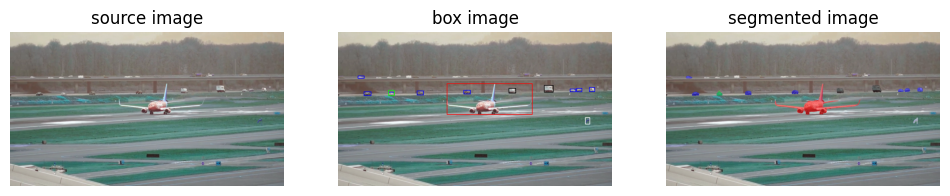


0: 384x640 6 cars, 3 airplanes, 3 trucks, 30.0ms
Speed: 0.6ms preprocess, 30.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 505.9785,  240.7730,  909.1610,  386.5889],
        [ 121.8793,  281.4175,  153.9442,  297.7358],
        [ 964.2616,  249.6224, 1005.3993,  282.4475],
        [1115.2100,  264.2047, 1139.1584,  279.0167],
        [ 798.3258,  262.9360,  829.3864,  286.3255],
        [ 588.2946,  272.7224,  617.9823,  290.0892],
        [1083.8182,  266.6567, 1110.4440,  280.8991],
        [ 369.8365,  275.5467,  398.8477,  294.9595],
        [1175.9862,  260.6733, 1199.6283,  278.6805],
        [ 236.3338,  281.1510,  261.9953,  296.7618],
        [1154.8936,  399.7501, 1177.5605,  426.7160],
        [  93.9265,  205.7219,  125.8128,  216.6256],
        [ 236.2044,  268.7853,  261.8891,  296.6119]], device='cuda:0')


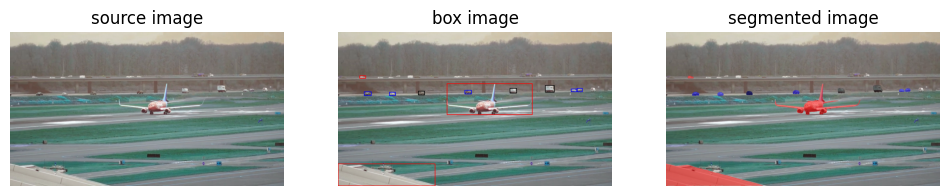


0: 384x640 1 person, 5 cars, 2 airplanes, 3 trucks, 29.9ms
Speed: 0.6ms preprocess, 29.9ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


tensor([[ 504.5261,  240.1256,  908.8817,  386.9928],
        [ 122.0922,  281.4614,  154.3158,  297.6318],
        [ 968.6873,  249.0876, 1010.3077,  282.4045],
        [ 240.5388,  280.7469,  268.0613,  297.3176],
        [ 803.9319,  263.1054,  834.5403,  286.7095],
        [1117.5767,  264.4615, 1141.9429,  279.1643],
        [1088.5669,  266.8273, 1115.7466,  280.6550],
        [ 593.2131,  272.4352,  623.5208,  290.1521],
        [ 375.3122,  276.7746,  403.8257,  294.2597],
        [ 102.3263,  204.7157,  131.1293,  216.7416],
        [ 375.2085,  275.8480,  404.0480,  294.5056],
        [   1.1902,  614.8190,  449.3376,  715.1158]], device='cuda:0')


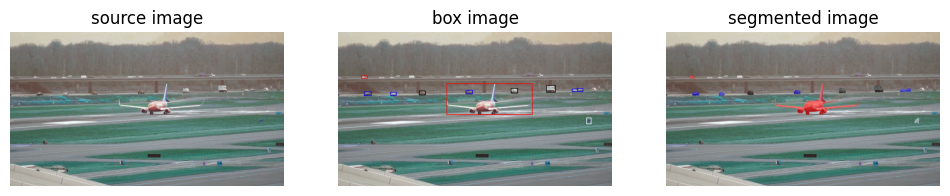

In [276]:
VIDEO_SOURCE = '/content/airplane2.mp4'
VIDEO_DESTINATION = '/content/weights/result2.avi'

# Video kaynağını aç
cap = cv2.VideoCapture(VIDEO_SOURCE)

# Video kaydedicisini ayarla
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fourcc = cv2.VideoWriter_fourcc(*'XVID')
FPS = 30.0
out = cv2.VideoWriter(VIDEO_DESTINATION, fourcc, FPS, (width, height))

while True:
    # Frame oku
    ret, frame = cap.read()

    # Okuma başarısızsa video bitti
    if not ret:
        break

    # Girdi frame'ini SuperAnnotate'e uygun formata getir
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = yolo_model.predict(source=frame)
    print(result.boxes.xyxy)
    boxes_class_name = np.array([])
    for r in results:
        for c in r.boxes.cls:
            boxes_class_name = np.append(boxes_class_name,yolo_model.names[int(c)])
    boxes_class_name

    k = 0
    result_np_son = np.array([])
    result_class = np.array([])
    result_score = np.array([])
    for result in results:
        result_np = np.array(result.boxes.data.cpu())

    for i in result_np:
        result_np_son = np.append(result_np_son,i[:][:-2])
        result_class = np.append(result_class,i[:][-1:])
        result_score = np.append(result_score,i[:][-2:-1])
        k += 1


    boxes = result_np_son.reshape((k,4))
    boxes_class = result_class.reshape((k,))
    boxes_score = result_score.reshape((k,))


    segmented_image = frame.copy()
    box_image = frame.copy()
    boxes_class_value = {'0':sv.Color.white(),
                         '1':sv.Color.blue(), 
                         '2':sv.Color.blue(),
                         '3':sv.Color.blue(),
                         '4':sv.Color.red(),
                         '5':sv.Color.blue(),
                         '7':sv.Color.black(),
                         '8':sv.Color.green(),
                         '9':sv.Color.blue(),
                         '37':sv.Color.blue()}
    mask_predictor.set_image(frame)

    boxes = result.boxes.xyxy
    if len(boxes) != 0:
      masks, scores, logits = mask_predictor.predict_torch(
          point_coords = None,
          point_labels = None,
          boxes = boxes / 1.25,
          multimask_output=True
      )

      masks = masks.cpu().numpy()

      i = 0
      for box in boxes.cpu().numpy():

          box_annotator = sv.BoxAnnotator(color= boxes_class_value[str(int(boxes_class[i]))], text_padding=10)
          mask_annotator = sv.MaskAnnotator(color= boxes_class_value[str(int(boxes_class[i]))])

          detections = sv.Detections(
              xyxy=sv.mask_to_xyxy(masks=masks[i]),
              mask=masks[i]
          )
          
          detections = detections[detections.area == np.max(detections.area)]
          box_image = box_annotator.annotate(scene=box_image, detections=detections, skip_label=True)
          segmented_image = mask_annotator.annotate(scene=segmented_image, detections=detections)
          i += 1

      sv.plot_images_grid(
            images=[frame,box_image, segmented_image],
            grid_size=(1, 3),
            titles=['source image','box image','segmented image']    
      )      

    # Video kaydediciye yaz
    out.write(cv2.cvtColor(segmented_image, cv2.COLOR_RGB2BGR))

# Video kaynak ve kaydediciyi serbest bırak
cap.release()